In [2]:
import io
import tempfile
from anndata import AnnData
import muon as mu
import numpy as np
import requests
import os
import scanpy as sc
import scvi
import seaborn as sns
import torch
import pandas as pd
import sys
import scrublet as scr
import skimage
import pybiomart
from bioservices import BioMart
import rdata
import matplotlib.pyplot as plt
from adjustText import adjust_text
from scipy.stats import beta
import leidenalg
import igraph
import tqdm
import time
import gc
import polars as pl
import pyarrow

In [ ]:
#import rpy2.robjects.packages as rpackages
#from rpy2.robjects.vectors import StrVector
#import rpy2.robjects as robjects

# Select repositories (CRAN mirror)
#utils = rpackages.importr('utils')
#utils.chooseCRANmirror(ind=1)  # Use the first mirror

# Install BiocManager if not already installed
#if not rpackages.isinstalled('BiocManager'):
#    utils.install_packages(StrVector(['BiocManager']))

# Install SoupX via BiocManager
#robjects.r('BiocManager::install("SoupX", ask=FALSE, update=FALSE)')

In [ ]:
if not rpackages.isinstalled('SoupX'):
    robjects.r('BiocManager::install("SoupX", ask=FALSE, update=FALSE)')

In [6]:
from Bio import SeqIO

# Show the first 5 records in the FASTA file
for i, record in enumerate(SeqIO.parse("PBMC_FEB_28_2025_transcriptome.fa", "fasta")):
    print(f">{record.description}\n{record.seq[:80]}...\n")
    if i >= 4:
        break 

>ENST00000832824
CGCAGAGACGGGTAGAACCTCAGTAATCCGAAAAGCCGGGATCGACCGCCCCTTGCTTGCAGCCGGGCACTACAGGACCC...

>ENST00000832825
GAGACGGGTAGAACCTCAGTAATCCGAAAAGCCGGGATCGACCGCCCCTTGCTTGCAGCCGGGCACTACAGGACCCGCTT...

>ENST00000832826
CCTGCTGGCAGCTGGGGACACTGCCGGGCCCTCTTGCTCCAACAGTACTGGCGGATTATAGGGAAACACCCGGAGCATAT...

>ENST00000832827
CTGCTGGCAGCTGGGGACACTGCCGGGCCCTCTTGCTCCAACAGTACTGGCGGATTATAGGGAAACACCCGGAGCATATG...

>ENST00000832828
GACACTGCCGGGCCCTCTTGCTCCAACAGTACTGGCGGATTATAGGGAAACACCCGGAGCATATGCTGTTTGGTCTCAGT...



In [2]:
from Bio import SeqIO; [print(f">{r.description}\n{r.seq}") for r in SeqIO.parse("PBMC_FEB_28_2025_transcriptome.fa", "fasta") if r.id.startswith("BambuTx")]

>BambuTx109
ACTGAAAAATGAGCCAGGTGTGGTGGCACACGCTACGCCTGTAGGTCCCAGCTACGCGGGAGGCTGAGGTGGGAAGATCACTTGTGCCCAGGAGTTCGAGGTTGCAGTGAGCTATGATCGCTCCACTGCACTCCAGCCTGGGCAACAGAAGAAGACTCTGTCTCAAAACAACAACAACAAAATTGTCAACCAAGAACCACGTATCCAGCAAACTTTCCTTCAAAGATGAGGGAGAAATGAGGATATTCTCAGATAAACAAAAGCAGAGGGAGTTCATTACTACTAGACCTAGACCTGCCTTGAAGAATAAGCTCCAGGGAGTTGTGTGGGGTGTAAGGAAAGGACGCGAGACAGAAACCGGAAGCTGGGTGAAGAAATAAAGATCTCCATTAAGAGACGAGGTCTCCCTGTGTTGCCCAGGCTGGTCTTGAACTCCTGGGCTGAAGTGATCTGCCTGCCTCGGCCTCCCAAAGTGCTGGGATTACAGGCGTGAGCTGCCGCGTCCGGCCAATATGAACATTTCTCATCAGCGGCCCTCCTCAGAATAGATTTTGGGCTCACCTGCGACATTTGGAAGTACAAAAGAACTTCACCGAAGAAGCGTTGTTCTAATGGAAAAATGAGGGCAAAGAAATTAAATCTCCTTTAAGAAAACCACTTACTTAAAAAATATGGCTTACA
>BambuTx1
GTTCCACTCGCTGGCGTCCGGGCCGCTGGTGATCTCCGGTAGCACTCGGGCCGGCGGACAGTGAGGGCGCGTGGAGACGGAGTTTCACCATGTTGGCAAGGCTAGTCTCAAACTCCTGACTTCAAGTGATTCGCCCACCTCGGCCTCTCAAAGTGCTGGGATTACAGGCATGAGCCACCGTGTCCGGCCCCACTACATTCTTAAAGAAGCAATAAATTGACCTTGTTTAAATACA
>BambuTx2
CCTTTGCTTTTACAAGCTTCAGAGCTAAGAAGATGGATCTCTCTTCGGCC

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [8]:
from Bio import SeqIO

cmc1_transcripts = {
    "ENST00000466830",
    "ENST00000423894",
    "ENST00000334841",
    "ENST00000418849",
    "ENST00000468330",
    "ENST00000482499",
    "ENST00000469102",
    "BambuTx55"
}

with open("CMC1_transcripts.fa", "w") as out_f:
    for r in SeqIO.parse("PBMC_FEB_28_2025_transcriptome.fa", "fasta"):
        if r.id.split(".")[0] in cmc1_transcripts:
            SeqIO.write(r, out_f, "fasta")

In [11]:
import rpy2.robjects as robjects
from rpy2.robjects import pandas2ri
from rpy2.robjects.packages import importr
from rpy2.robjects.vectors import StrVector

pandas2ri.activate()

# Import SoupX and Seurat (if needed)
soupX = importr("SoupX")

# Load matrix and metadata
# Suppose you have raw counts at 'raw_matrix_dir' (e.g., filtered_feature_bc_matrix)
raw_matrix_dir = "/path/to/filtered_feature_bc_matrix"  # Adjust this path
sc = soupX.load10X(raw_matrix_dir)

# Add cell type annotations from Python (assuming you have a DataFrame `cell_types`)
import pandas as pd
cell_types = pd.read_csv("cell_type_annotations.csv")  # must contain 'barcode' and 'gen_cell_type'

# Send it to R
robjects.globalenv['cell_types'] = pandas2ri.py2rpy(cell_types)

# Add clustering
robjects.r('''
library(SoupX)

# Assume 'sc' and 'cell_types' are already in the environment
cellTypes <- setNames(as.character(cell_types$gen_cell_type), cell_types$barcode)
sc <- setClusters(sc, cellTypes)

# Estimate contamination and adjust
sc <- autoEstCont(sc)
corrected_counts <- adjustCounts(sc)
''')

# You can optionally return corrected counts to Python:
corrected = robjects.r('corrected_counts')

R[write to console]: 'getOption("repos")' replaces Bioconductor standard repositories, see
'help("repositories", package = "BiocManager")' for details.
Replacement repositories:
    CRAN: https://cloud.r-project.org

R[write to console]: Bioconductor version 3.20 (BiocManager 1.30.25), R 4.4.3 (2025-02-28)

R[write to console]: Installing package(s) 'SoupX'

R[write to console]: Warning in install.packages(...) :
R[write to console]: 
 
R[write to console]:  'lib = "/usr/local/lib/R/site-library"' is not writable



Would you like to use a personal library instead? (yes/No/cancel)  yes
Would you like to create a personal library
‘/home/phdo222/R/x86_64-pc-linux-gnu-library/4.4’
to install packages into? (yes/No/cancel)  yes


R[write to console]: trying URL 'https://cloud.r-project.org/src/contrib/SoupX_1.6.2.tar.gz'

R[write to console]: Content type 'application/x-gzip'
R[write to console]:  length 4962415 bytes (4.7 MB)

R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to console]: =
R[write to conso

OpenBLAS : Program is Terminated. Because you tried to allocate too many memory regions.
This library was built to support a maximum of 128 threads - either rebuild OpenBLAS
with a larger NUM_THREADS value or set the environment variable OPENBLAS_NUM_THREADS to
a sufficiently small number. This error typically occurs when the software that relies on
OpenBLAS calls BLAS functions from many threads in parallel, or when your computer has more
cpu cores than what OpenBLAS was configured to handle.
OpenBLAS : Program is Terminated. Because you tried to allocate too many memory regions.
This library was built to support a maximum of 128 threads - either rebuild OpenBLAS
with a larger NUM_THREADS value or set the environment variable OPENBLAS_NUM_THREADS to
a sufficiently small number. This error typically occurs when the software that relies on
OpenBLAS calls BLAS functions from many threads in parallel, or when your computer has more
cpu cores than what OpenBLAS was configured to handle.
Op

* installing *source* package ‘SoupX’ ...
** package ‘SoupX’ successfully unpacked and MD5 sums checked
** using staged installation
** R
** data
*** moving datasets to lazyload DB
** inst
** byte-compile and prepare package for lazy loading
** help
*** installing help indices
** building package indices
** installing vignettes
** testing if installed package can be loaded from temporary location
** testing if installed package can be loaded from final location
** testing if installed package keeps a record of temporary installation path
* DONE (SoupX)
R[write to console]: 

R[write to console]: 
R[write to console]: The downloaded source packages are in
	‘/tmp/RtmpD9RaAD/downloaded_packages’
R[write to console]: 
R[write to console]: 

R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: 
R[write to console]: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
R[write to console]: 
 
R[write to console]:  libra

In [2]:
# Load the mdata object from the file
output_dir = 'Intermediate_Files/Clustering_05012025'

from scanpy import read_h5ad
adata_g_filtered = read_h5ad(os.path.join(output_dir, "PBMC_gene_AutoZI_denoised_05032025.h5mu"))
adata_i_filtered = read_h5ad(os.path.join(output_dir, "PBMC_iso_AutoZI_denoised_05032025.h5mu"))

In [3]:
def relabel_clusters_by_size(adata, cluster_key):
    # Get the cluster labels
    cluster_labels = adata.obs[cluster_key]
    
    # Count the size of each cluster
    cluster_sizes = cluster_labels.value_counts()
    
    # Sort clusters by size (largest first)
    sorted_clusters = cluster_sizes.index[np.argsort(-cluster_sizes.values)]
    
    # Create a mapping from old cluster labels to new ones
    new_labels_map = {old_label: new_label for new_label, old_label in enumerate(sorted_clusters)}
    
    # Apply the new labels
    adata.obs[cluster_key] = cluster_labels.map(new_labels_map).astype('category')
    
    return adata

In [4]:
# Function to plot UMAP with labels reflecting cluster sizes
def plot_umap_with_labels_g(adata, resolutions, use_rep_key=None):
    """
    Plots UMAP with cluster labels and prints what 'use_rep' is assigned to.

    Parameters:
    - adata: AnnData object
    - resolutions: List of resolution values to plot
    - use_rep_key: The key to use for coloring clusters (defaults to '20lat_1e2' if not provided)
    """

    print(f"Using representation: {use_rep_key}")  # Print assigned representation

    vibrant_palette = plt.get_cmap('tab20').colors  # Set color palette

    for res in resolutions:
        # Plot UMAP with cluster labels
        sc.pl.umap(
            adata,
            color=f'{res}_{use_rep_key}',
            title=f'UMAP with Clusters (Gene-Level, {use_rep_key}, Res={res})',
            frameon=True,
            palette=vibrant_palette,
            legend_loc='on data',
            legend_fontsize=10,
            legend_fontoutline=2,
        )

# Function to plot UMAP with labels reflecting cluster sizes
def plot_umap_with_labels_i(adata, resolutions, use_rep_key=None):
    """
    Plots UMAP with cluster labels and prints what 'use_rep' is assigned to.

    Parameters:
    - adata: AnnData object
    - resolutions: List of resolution values to plot
    - use_rep_key: The key to use for coloring clusters (defaults to '20lat_1e2' if not provided)
    """

    print(f"Using representation: {use_rep_key}")  # Print assigned representation

    vibrant_palette = plt.get_cmap('tab20').colors  # Set color palette

    for res in resolutions:
        # Plot UMAP with cluster labels
        sc.pl.umap(
            adata,
            color=f'{res}_{use_rep_key}',
            title=f'UMAP with Clusters (Isoform-Level, {use_rep_key}, Res={res})',
            frameon=True,
            palette=vibrant_palette,
            legend_loc='on data',
            legend_fontsize=10,
            legend_fontoutline=2,
        )

In [5]:
adata_g_filtered.X = adata_g_filtered.layers["log_denoised"]
adata_i_filtered.X = adata_i_filtered.layers["log_denoised"]

In [6]:
import re

rbc_pattern = re.compile(r'^HB[A-Z0-9]+')
rbc_genes_all = [gene for gene in adata_g_filtered.var_names if rbc_pattern.match(gene)]
print(f"Found {len(rbc_genes_all)} RBC-related genes")
print(rbc_genes_all)

rbc_isoforms_all = [gene for gene in adata_i_filtered.var_names if rbc_pattern.match(gene)]
print(f"Found {len(rbc_isoforms_all)} RBC-related genes")
print(rbc_isoforms_all)

Found 10 RBC-related genes
['HBQ1:ENSG00000086506', 'HBP1:ENSG00000105856', 'HBS1L:ENSG00000112339', 'HBEGF:ENSG00000113070', 'HBA2:ENSG00000188536', 'HBG2:ENSG00000196565', 'HBA1:ENSG00000206172', 'HBG1:ENSG00000213934', 'HBD:ENSG00000223609', 'HBB:ENSG00000244734']
Found 25 RBC-related genes
['HBQ1:ENSG00000086506:ENST00000199708', 'HBP1:ENSG00000105856:ENST00000222574', 'HBP1:ENSG00000105856:ENST00000463202', 'HBP1:ENSG00000105856:ENST00000468116', 'HBP1:ENSG00000105856:ENST00000468410', 'HBP1:ENSG00000105856:ENST00000478930', 'HBP1:ENSG00000105856:ENST00000479011', 'HBP1:ENSG00000105856:ENST00000483809', 'HBP1:ENSG00000105856:ENST00000485846', 'HBP1:ENSG00000105856:ENST00000498408', 'HBP1:ENSG00000105856:ENST00000607681', 'HBS1L:ENSG00000112339:ENST00000367822', 'HBS1L:ENSG00000112339:ENST00000367837', 'HBS1L:ENSG00000112339:ENST00000527005', 'HBEGF:ENSG00000113070:ENST00000230990', 'HBA2:ENSG00000188536:ENST00000251595', 'HBA2:ENSG00000188536:ENST00000397806', 'HBA2:ENSG0000018853

In [7]:
# Calculate RBC score before regressing out effect of ambient RBC RNA

# RBC score represents the total expression of all RBC genes (sum of counts per cell).
# Higher RBC score indicates more ambient RNA contamination from red blood cells.
# After regression, lower RBC score suggests successful removal of RBC ambient effects.
adata_g_filtered.obs['rbc_score'] = np.ravel(adata_g_filtered[:, rbc_genes_all].X.sum(axis=1))
adata_i_filtered.obs['rbc_score'] = np.ravel(adata_i_filtered[:, rbc_isoforms_all].X.sum(axis=1))

In [8]:
sc.pp.regress_out(adata_g_filtered, ['rbc_score'])
sc.pp.regress_out(adata_i_filtered, ['rbc_score'])

OpenBLAS warning: precompiled NUM_THREADS exceeded, adding auxiliary array for thread metadata.
To avoid this warning, please rebuild your copy of OpenBLAS with a larger NUM_THREADS setting
or set the environment variable OPENBLAS_NUM_THREADS to 64 or lower


In [17]:
sc.pp.scale(adata_g_filtered
            #, max_value = 10
           )
sc.pp.scale(adata_i_filtered
            #, max_value = 10
           )

In [18]:
# Run PCA on log-transformed data
sc.pp.pca(adata_g_filtered)

# Compute UMAP
sc.pp.neighbors(adata_g_filtered, n_neighbors = 20, use_rep= 'X_AutoZI')
sc.tl.umap(adata_g_filtered)

In [20]:
# Run PCA on log-transformed data
sc.pp.pca(adata_i_filtered)

# Compute UMAP
sc.pp.neighbors(adata_i_filtered, n_neighbors = 20, use_rep= 'X_AutoZI')
sc.tl.umap(adata_i_filtered)

In [21]:
# Perform Leiden clustering at multiple resolutions
resolutions = [0.1, 0.5]
for res in resolutions:
    sc.tl.leiden(adata_g_filtered, resolution=res, key_added=f'{res}_log_AutoZI', flavor = "igraph", n_iterations=2)
    sc.tl.leiden(adata_i_filtered, resolution=res, key_added=f'{res}_log_AutoZI', flavor = "igraph", n_iterations=2)

In [22]:
# Relabel clusters by size
resolutions = ['0.1_log_AutoZI', '0.5_log_AutoZI']
for cluster_key in resolutions:
    adata_g_filtered = relabel_clusters_by_size(adata_g_filtered, cluster_key)
    adata_i_filtered = relabel_clusters_by_size(adata_i_filtered, cluster_key)

Using representation: log_AutoZI


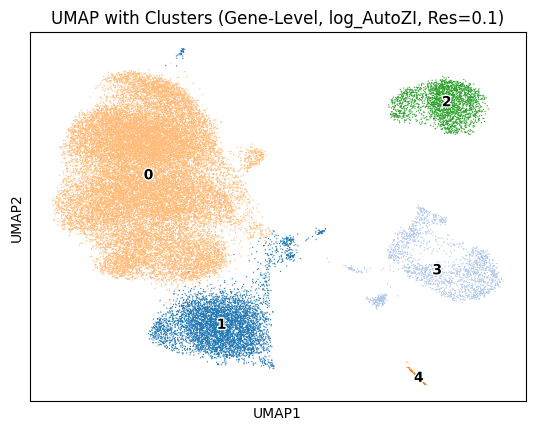

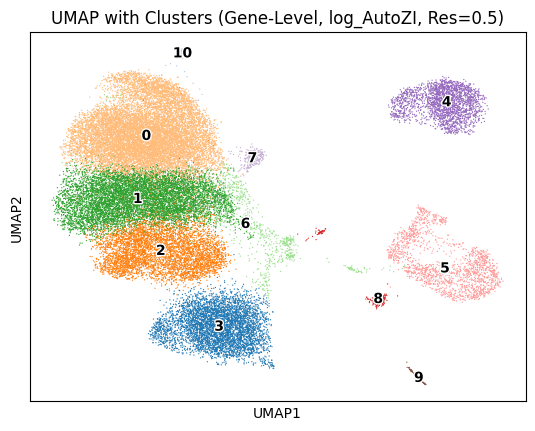

In [23]:
# Call the functions
plot_umap_with_labels_g(adata_g_filtered, resolutions=[
    0.1, 0.5,
], use_rep_key= 'log_AutoZI')

Using representation: log_AutoZI


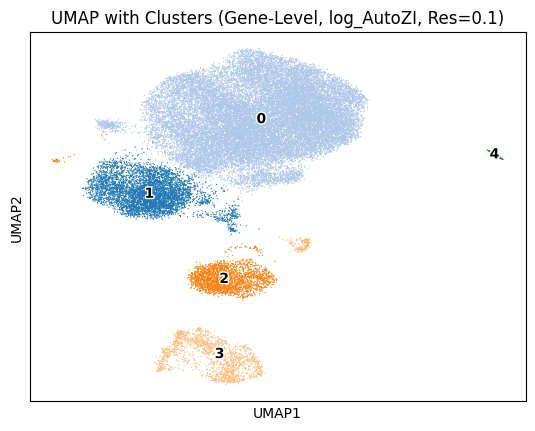

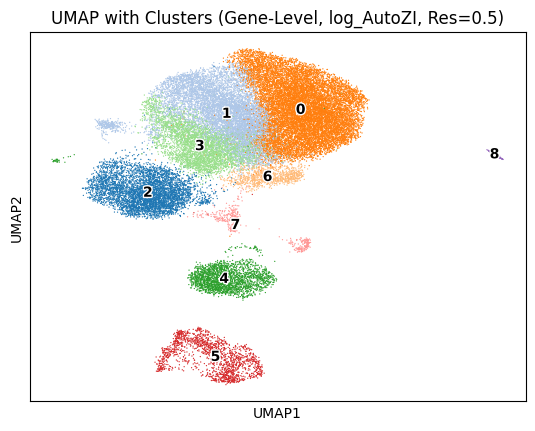

In [24]:
# Call the functions
plot_umap_with_labels_g(adata_i_filtered, resolutions=[
    0.1, 0.5,
], use_rep_key= 'log_AutoZI')

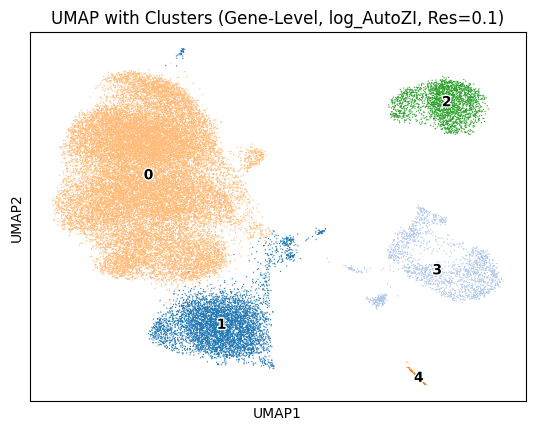

In [37]:
sc.settings.figdir = "Intermediate_Files/Paper_Figs/UMAPs"

# Only use the desired resolution
resolutions = ['0.1_log_AutoZI']

# Relabel for that resolution
cluster_key = resolutions[0]
adata_g_filtered = relabel_clusters_by_size(adata_g_filtered, cluster_key)

# Plot UMAP and save to PDF
sc.pl.umap(
    adata_g_filtered,
    color='0.1_log_AutoZI',
    title=f'UMAP with Clusters (Gene-Level, log_AutoZI, Res=0.1)',
    frameon=True,
    palette=plt.get_cmap('tab20').colors,
    legend_loc='on data',
    legend_fontsize=10,
    legend_fontoutline=2,
    #save="_0.1_log_autoZI_gene.pdf"
)

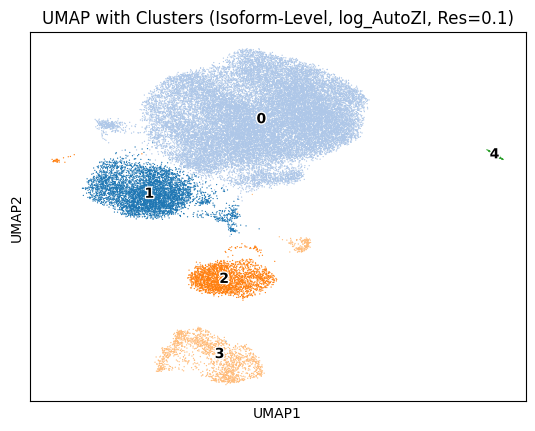

In [38]:
sc.settings.figdir = "Intermediate_Files/Paper_Figs/UMAPs"

# Only use the desired resolution
resolutions = ['0.1_log_AutoZI']

# Relabel for that resolution
cluster_key = resolutions[0]
adata_i_filtered = relabel_clusters_by_size(adata_i_filtered, cluster_key)

# Plot UMAP and save to PDF
sc.pl.umap(
    adata_i_filtered,
    color='0.1_log_AutoZI',
    title=f'UMAP with Clusters (Isoform-Level, log_AutoZI, Res=0.1)',
    frameon=True,
    palette=plt.get_cmap('tab20').colors,
    legend_loc='on data',
    legend_fontsize=10,
    legend_fontoutline=2,
    #save="_0.1_log_autoZI_iso.pdf"
)

In [29]:
# For example, suppose you want to merge clusters '0' and '1' into "Merged_A",
# '2' and '3' into "Merged_B", and keep others as-is.
celltype_names = {
    "0": "TCells",
    "1": "NK Cells",
    "2": "BCells",
    "3": "Monocyte-derived",
    "4": "Megakaryocytes"
}

# Create a new observation column with the merged cluster assignments.
adata_g_filtered.obs['gen_cell_type'] = adata_g_filtered.obs['0.1_log_AutoZI'].astype(str).replace(celltype_names)

# Optionally, you can verify the result:
print(adata_g_filtered.obs['gen_cell_type'].value_counts())

gen_cell_type
TCells              26919
NK Cells             5256
BCells               2310
Monocyte-derived     1882
Megakaryocytes         96
Name: count, dtype: int64


In [30]:
# For example, suppose you want to merge clusters '0' and '1' into "Merged_A",
# '2' and '3' into "Merged_B", and keep others as-is.
celltype_names = {
    "0": "TCells",
    "1": "NK Cells",
    "2": "BCells",
    "3": "Monocyte-derived",
    "4": "Megakaryocytes"
}

# Create a new observation column with the merged cluster assignments.
adata_i_filtered.obs['gen_cell_type'] = adata_i_filtered.obs['0.1_log_AutoZI'].astype(str).replace(celltype_names)

# Optionally, you can verify the result:
print(adata_i_filtered.obs['gen_cell_type'].value_counts())

gen_cell_type
TCells              26486
NK Cells             5059
BCells               2332
Monocyte-derived     1754
Megakaryocytes        101
Name: count, dtype: int64


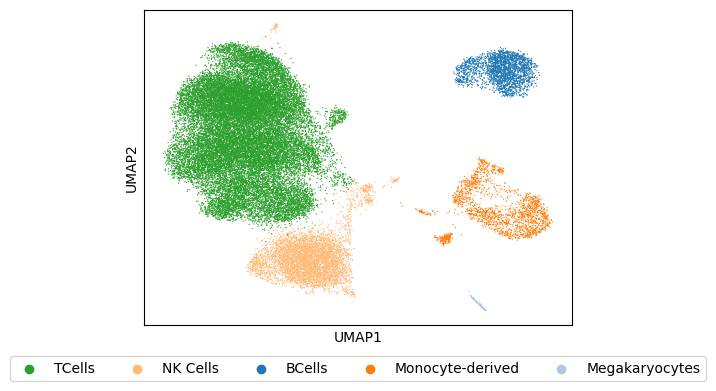

In [28]:
sc.settings.figdir = "Intermediate_Files/Paper_Figs/UMAPs"
# Only use the desired resolution
resolutions = ['0.1_log_AutoZI']

import matplotlib.pyplot as plt
import scanpy as sc


# Define desired order
legend_order = ["TCells", "NK Cells", "BCells", "Monocyte-derived", "Megakaryocytes"]

# Plot UMAP without saving yet
sc.pl.umap(
    adata_g_filtered,
    color='gen_cell_type',
    title='',  # No title for publication version
    frameon=True,
    palette=plt.get_cmap('tab20').colors,
    legend_loc='lower center',
    legend_fontsize=10,
    legend_fontoutline=1,
    show=False  # Important: allow to edit figure after plotting
)

# Adjust figure
fig = plt.gcf()
fig.set_size_inches(6.5, 4)

# Get legend and reorder
ax = plt.gca()
handles, labels = ax.get_legend_handles_labels()

# Build a new legend with desired order
order = [labels.index(l) for l in legend_order if l in labels]
ordered_handles = [handles[i] for i in order]
ordered_labels = [labels[i] for i in order]

# Remove old legend
ax.get_legend().remove()

# Add new ordered legend
ax.legend(ordered_handles, ordered_labels,
          loc='lower center',
          bbox_to_anchor=(0.5, -0.2),  # Centered below, negative y pushes down
          fontsize=10,
          frameon=True,
          ncol=5)  # vertical layout

plt.tight_layout()

# Save manually
plt.savefig("Intermediate_Files/Paper_Figs/UMAPs/UMAP_0.1_log_autoZI_gene_celltypes.pdf",
            dpi=600, transparent=True, bbox_inches="tight")

plt.show()

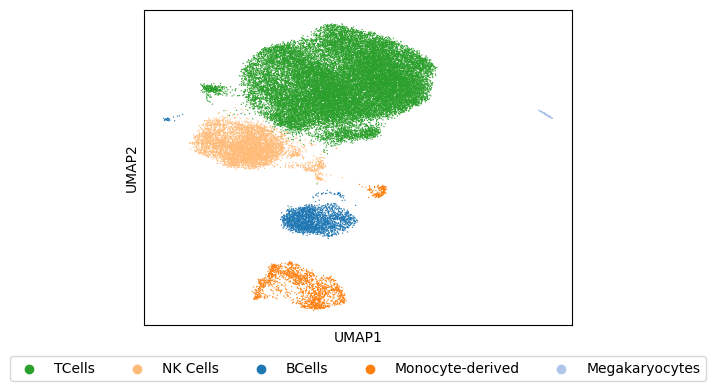

In [29]:
sc.settings.figdir = "Intermediate_Files/Paper_Figs/UMAPs"
# Only use the desired resolution
resolutions = ['0.1_log_AutoZI']

import matplotlib.pyplot as plt
import scanpy as sc


# Define desired order
legend_order = ["TCells", "NK Cells", "BCells", "Monocyte-derived", "Megakaryocytes"]

# Plot UMAP without saving yet
sc.pl.umap(
    adata_i_filtered,
    color='gen_cell_type',
    title='',  # No title for publication version
    frameon=True,
    palette=plt.get_cmap('tab20').colors,
    legend_loc='lower center',
    legend_fontsize=10,
    legend_fontoutline=1,
    show=False  # Important: allow to edit figure after plotting
)

# Adjust figure
fig = plt.gcf()
fig.set_size_inches(6.5, 4)

# Get legend and reorder
ax = plt.gca()
handles, labels = ax.get_legend_handles_labels()

# Build a new legend with desired order
order = [labels.index(l) for l in legend_order if l in labels]
ordered_handles = [handles[i] for i in order]
ordered_labels = [labels[i] for i in order]

# Remove old legend
ax.get_legend().remove()

# Add new ordered legend
ax.legend(ordered_handles, ordered_labels,
          loc='lower center',
          bbox_to_anchor=(0.5, -0.2),  # Centered below, negative y pushes down
          fontsize=10,
          frameon=True,
          ncol=5)  # vertical layout

plt.tight_layout()

# Save manually
plt.savefig("Intermediate_Files/Paper_Figs/UMAPs/UMAP_0.1_log_autoZI_isoform_celltypes.pdf",
            dpi=600, transparent=True, bbox_inches="tight")

plt.show()

In [3]:
# Load the mdata object from the file
output_dir = 'Intermediate_Files/Clustering_05012025'

from scanpy import read_h5ad
adata_g_filtered = read_h5ad(os.path.join(output_dir, "PBMC_gene_AutoZI_clustered_celltypes_reannotated_AutoZILatent_05112025.h5mu"))
adata_i_filtered = read_h5ad(os.path.join(output_dir, "PBMC_iso_AutoZI_clustered_celltypes_reannotated_AutoZILatent_05112025.h5mu"))

In [4]:
import scanpy as sc
adata_i_filtered.obs[["gen_cell_type"]].to_csv("design_matrix.tsv", sep="\t", index=True)

In [ ]:
import pandas as pd

# Pull barcodes and gen_cell_type labels
barcodes = adata_g_filtered.obs_names.to_series()
cell_types = adata_g_filtered.obs["gen_cell_type"]

# Create dataframe to pass to R
cell_type_df = pd.DataFrame({
    "barcode": barcodes.values,
    "gen_cell_type": cell_types.values
})

In [4]:
# Function to find matching genes in var_names (combined_ID format)
def find_matching_genes(prefixes, gene_list):
    return [gene for gene in gene_list if any(gene.startswith(prefix) for prefix in prefixes)]

In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# ---- Define marker genes
marker_genes = {
    "TCells": ["CD3D:", "CD3E:", "CD3G:"],
    "Cytotoxic": ["CD8A:", "CD8B:", "GATA3:", "KLRB1:", "CCL5:"],
    "CD4+ Effector": ["CD4:", "IL2RA:", "GATA3:", "AHR:"],
    "Memory": ["CCR7:", "SELL:", "TCF7:"],
    "Natural Killer": ["GZMB:", "KLRD1:", "NCAM1:", "ITGAM:", "CD226:", "FCGR3A:", "IL2RB:"],
    "BCell": ["CD22:", "CD79A:", "MS4A1:", "CD19:"],
    "Monocyte-derived": ["FCGR2A:", "CLEC7A:", "FCGR3A:", "CD33:", "LILRB4:"],
    "Megakaryocyte": ["ITGA2B:", "MPL:"]
}

/tmp/ipykernel_3636104/2009501318.py:30: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()
/tmp/ipykernel_3636104/2009501318.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = g_expr.groupby(g_expr.index).mean()


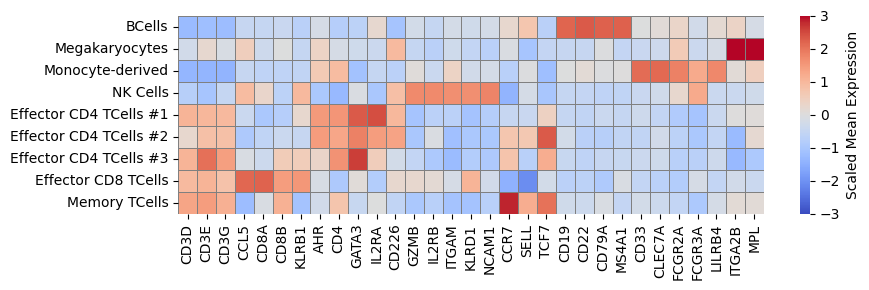

In [6]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups you want
marker_groups_to_include = ["TCells", "Cytotoxic", "CD4+ Effector", "Natural Killer", "Memory","BCell", "Monocyte-derived", "Megakaryocyte"]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_genes = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_g_filtered.var_names)
    matched_genes.extend(matches)
    for gene in matches:
        gene_to_group[gene] = group

# Clean matched gene names to just GeneName
clean_gene_names = [g.split(":")[0] for g in matched_genes]

# Get expression matrix
g_expr = pd.DataFrame(adata_g_filtered[:, matched_genes].X.toarray(), 
                      columns=clean_gene_names,
                      index=adata_g_filtered.obs["gen_cell_type_reannotated"])

# Collapse duplicates (if same gene appears more than once)
g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()

# Mean expression per cell type
mean_expr = g_expr.groupby(g_expr.index).mean()

# Z-score normalization
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.sort_index().fillna(0)

# Reorder columns by marker group
group_order = marker_groups_to_include  # Desired group order
gene_group_df = pd.DataFrame({
    "gene": [g.split(":")[0] for g in matched_genes],
    "group": [gene_to_group[g] for g in matched_genes]
}).drop_duplicates()

# Sort gene names by group order then alphabetically
gene_group_df["group_rank"] = gene_group_df["group"].apply(lambda x: group_order.index(x))
gene_group_df = gene_group_df.sort_values(["group_rank", "gene"])

sorted_genes = gene_group_df["gene"].tolist()
sorted_genes = [g for g in sorted_genes if g in plot_df.columns]  # Ensure match

# Reorder plot_df
plot_df = plot_df[sorted_genes]

# Plot
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))

sns.heatmap(plot_df, cmap="coolwarm", linewidths=0.5, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False,
            norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/Markers/subcelltype_marker_all_heatmap.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_4007407/3358119250.py:31: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()


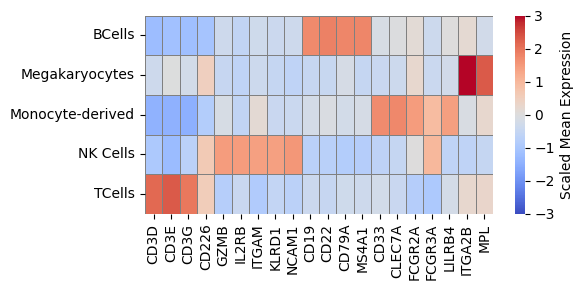

In [31]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups you want
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_genes = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_g_filtered.var_names)
    matched_genes.extend(matches)
    for gene in matches:
        gene_to_group[gene] = group

# Clean matched gene names to just GeneName
clean_gene_names = [g.split(":")[0] for g in matched_genes]

# Get expression matrix
g_expr = pd.DataFrame(adata_g_filtered[:, matched_genes].X.toarray(), 
                      columns=clean_gene_names,
                      index=adata_g_filtered.obs["gen_cell_type"])

# Collapse duplicates (if same gene appears more than once)
g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()

# Mean expression per cell type
mean_expr = g_expr.groupby(g_expr.index).mean()

# Z-score normalization
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.sort_index().fillna(0)

# Reorder columns by marker group
group_order = marker_groups_to_include  # Desired group order
gene_group_df = pd.DataFrame({
    "gene": [g.split(":")[0] for g in matched_genes],
    "group": [gene_to_group[g] for g in matched_genes]
}).drop_duplicates()

# Sort gene names by group order then alphabetically
gene_group_df["group_rank"] = gene_group_df["group"].apply(lambda x: group_order.index(x))
gene_group_df = gene_group_df.sort_values(["group_rank", "gene"])

sorted_genes = gene_group_df["gene"].tolist()
sorted_genes = [g for g in sorted_genes if g in plot_df.columns]  # Ensure match

# Reorder plot_df
plot_df = plot_df[sorted_genes]

# Plot
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))

sns.heatmap(plot_df, cmap="coolwarm", linewidths=0.5, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False,
            norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()

#plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_all_heatmap.pdf",
#            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_4007407/393887239.py:36: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  df_gene = df_iso.groupby(df_iso.columns, axis=1).mean()


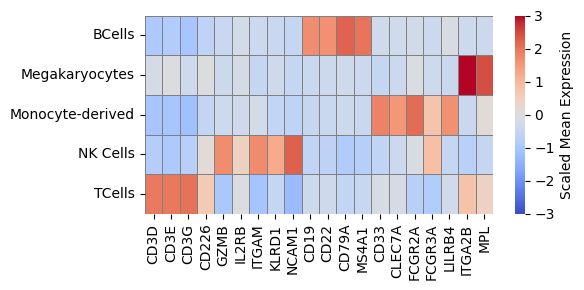

In [32]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups to include and maintain order
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# Build gene → group mapping and find matching isoforms
gene_to_group = {}
matched_isoforms = []   

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for iso in matches:
        gene_name = iso.split(":")[0]
        gene_to_group[gene_name] = group

# Map isoform to gene name
isoform_to_gene = {iso: iso.split(":")[0] for iso in matched_isoforms}
gene_names = [isoform_to_gene[iso] for iso in matched_isoforms]

# Extract expression matrix
X = adata_i_filtered[:, matched_isoforms].X
if hasattr(X, "toarray"):
    X = X.toarray()

# Build DataFrame (index: cell type, columns: gene names)
df_iso = pd.DataFrame(X, columns=gene_names, index=adata_i_filtered.obs["gen_cell_type"])

# Collapse isoforms to genes (mean expression)
df_gene = df_iso.groupby(df_iso.columns, axis=1).mean()

# Mean expression across cell types
mean_expr = df_gene.groupby(df_gene.index).mean()

# Z-score scaling across cell types (row-wise)
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.sort_index().fillna(0)

# Sort gene columns by marker group
ordered_genes = []
for group in marker_groups_to_include:
    genes_in_group = [g for g in plot_df.columns if gene_to_group.get(g) == group]
    ordered_genes.extend(sorted(genes_in_group))  # Optional: sort within group

plot_df = plot_df[ordered_genes]

# Plot
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))

sns.heatmap(plot_df, cmap="coolwarm", linewidths=0.5, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False, norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(rotation=90)
plt.yticks(rotation=0)

plt.tight_layout()
#plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_collapsedBYgene_isoform_heatmap_sorted.pdf",
#            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_3790678/418053669.py:38: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  df_gene = df_iso.groupby(df_iso.columns, axis=1).mean()
/tmp/ipykernel_3790678/418053669.py:41: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = df_gene.groupby(df_gene.index).mean()


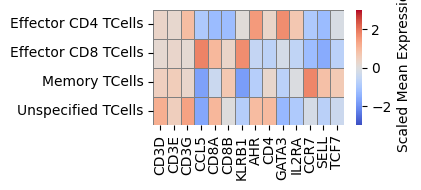

In [8]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups
marker_groups_to_include = [
    "TCells", "Cytotoxic", "CD4+ Effector", "Memory"
]

# Build isoform -> group mapping
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for iso in matches:
        gene_name = iso.split(":")[0]
        gene_to_group[gene_name] = group

# Map isoform to gene name
isoform_to_gene = {iso: iso.split(":")[0] for iso in matched_isoforms}
gene_names = [isoform_to_gene[iso] for iso in matched_isoforms]

    # Extract expression matrix
X = adata_i_filtered[:, matched_isoforms].X
if hasattr(X, "toarray"):
    X = X.toarray()

# Build DataFrame (index: cell type, columns: gene names)
df_iso = pd.DataFrame(X, columns=gene_names, index=adata_i_filtered.obs["gen_cell_type_reannotated"])

# Collapse isoforms to genes (mean expression)
df_gene = df_iso.groupby(df_iso.columns, axis=1).mean()

# Mean expression across cell types
mean_expr = df_gene.groupby(df_gene.index).mean()

# Z-score scaling across cell types (row-wise)
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.sort_index().fillna(0)

# Restrict to T-cell clusters only
tcell_order = [
    "Effector CD4 TCells", "Effector CD8 TCells",
    "Memory TCells", "Unspecified TCells"]
plot_df = scaled_expr.reindex(index=tcell_order)

# Sort gene columns by marker group
ordered_genes = []
for group in marker_groups_to_include:
    genes_in_group = [g for g in plot_df.columns if gene_to_group.get(g) == group]
    ordered_genes.extend(sorted(genes_in_group))  # Optional: sort within grou
plot_df = plot_df[ordered_genes]

# Plot
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)
plt.figure(figsize=(len(plot_df.columns) * 0.3, 2))

sns.heatmap(plot_df, cmap="coolwarm", linewidths=0.5, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False, norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(rotation=90)
plt.yticks(rotation=0)

plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/Markers/subcelltype_marker_collapsedBYgene_isoform_heatmap_TCellsOnly.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_3790678/13903526.py:35: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()
/tmp/ipykernel_3790678/13903526.py:38: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = g_expr.groupby(g_expr.index).mean()


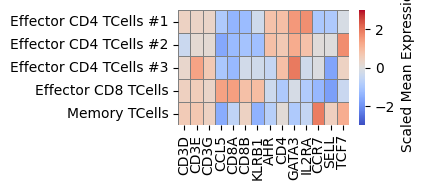

In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups you want
marker_groups_to_include = [
    "TCells", "Cytotoxic", "CD4+ Effector", "Memory"
]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_genes = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_g_filtered.var_names)
    matched_genes.extend(matches)
    for gene in matches:
        gene_to_group[gene.split(":")[0]] = group  # map base gene name to group

# Clean gene names to just GeneName
clean_gene_names = [g.split(":")[0] for g in matched_genes]

#Extract expression matrix
g_expr = pd.DataFrame(
    adata_g_filtered[:, matched_genes].X.toarray(),
    columns=clean_gene_names,
    index=adata_g_filtered.obs["gen_cell_type_reannotated"]
)

# Collapse duplicates (if same gene appears more than once)
g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()

# Mean expression per cell type
mean_expr = g_expr.groupby(g_expr.index).mean()

# Z-score normalization
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.sort_index().fillna(0)

# Restrict to T-cell clusters only
tcell_order = [
    "Effector CD4 TCells #1", "Effector CD4 TCells #2", "Effector CD4 TCells #3", "Effector CD8 TCells", "Memory TCells"]
plot_df = scaled_expr.reindex(index=tcell_order)

# Sort gene columns by marker group
ordered_genes = []
for group in marker_groups_to_include:
    genes_in_group = [g for g in plot_df.columns if gene_to_group.get(g) == group]
    ordered_genes.extend(sorted(genes_in_group))  # optional: sort within group
plot_df = plot_df[ordered_genes]

# Plot
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)
plt.figure(figsize=(len(plot_df.columns) * 0.3, 2))

sns.heatmap(plot_df, cmap="coolwarm", linewidths=0.5, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False, norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(rotation=90)
plt.yticks(rotation=0)

plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/Markers/subcelltype_marker_collapsedBYgene_gene_heatmap_TCellsOnly.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups you want
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_genes = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_g_filtered.var_names)
    matched_genes.extend(matches)
    for gene in matches:
        gene_to_group[gene] = group

# Clean matched gene names to just GeneName
clean_gene_names = [g.split(":")[0] for g in matched_genes]

# Get expression matrix
g_expr = pd.DataFrame(adata_g_filtered[:, matched_genes].X.toarray(), 
                      columns=clean_gene_names,
                      index=adata_g_filtered.obs["gen_cell_type"])

# Collapse duplicates (if same gene appears more than once)
g_expr = g_expr.groupby(g_expr.columns, axis=1).mean()

# Mean expression per cell type
mean_expr = g_expr.groupby(g_expr.index).mean()

# Z-score normalization
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.sort_index().fillna(0)

# Reorder columns by marker group
group_order = marker_groups_to_include  # Desired group order
gene_group_df = pd.DataFrame({
    "gene": [g.split(":")[0] for g in matched_genes],
    "group": [gene_to_group[g] for g in matched_genes]
}).drop_duplicates()

# Sort gene names by group order then alphabetically
gene_group_df["group_rank"] = gene_group_df["group"].apply(lambda x: group_order.index(x))
gene_group_df = gene_group_df.sort_values(["group_rank", "gene"])

sorted_genes = gene_group_df["gene"].tolist()
sorted_genes = [g for g in sorted_genes if g in plot_df.columns]  # Ensure match

# Reorder plot_df
plot_df = plot_df[sorted_genes]

# Plot
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))

sns.heatmap(plot_df, cmap="coolwarm", linewidths=0.5, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False,
            norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_all_heatmap.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

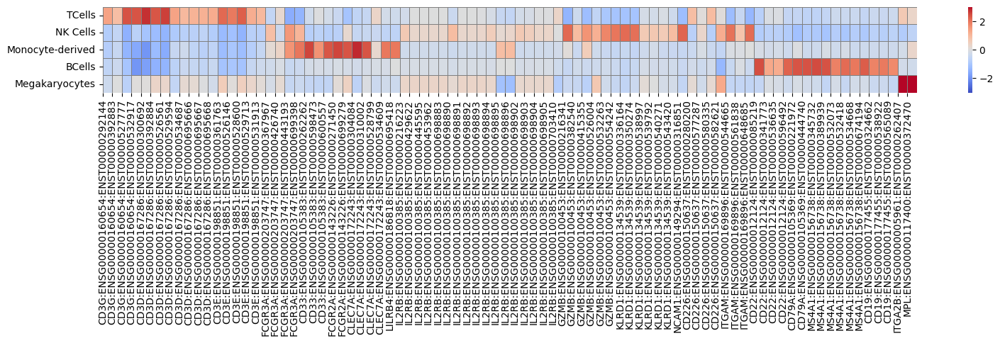

In [33]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups you want
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue  # skip unwanted groups
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for isoform in matches:
        gene_to_group[isoform] = group

# Get expression matrix for matched isoforms
iso_expr = pd.DataFrame(adata_i_filtered[:, matched_isoforms].X.toarray(), 
                        columns=matched_isoforms, 
                        index=adata_i_filtered.obs["gen_cell_type"])

# Calculate mean expression per cluster
mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()

# Scale expression (z-score per isoform)
scaled_expr_iso = (mean_expr_iso - mean_expr_iso.mean(axis=1).values[:, None]) / mean_expr_iso.std(axis=1).values[:, None]

plot_df_iso = scaled_expr_iso.copy()
celltype_order = ["TCells", "NK Cells", "Monocyte-derived", "BCells", "Megakaryocytes"]
plot_df_iso = plot_df_iso.loc[celltype_order]
plot_df_iso = plot_df_iso.fillna(0)

from matplotlib.colors import TwoSlopeNorm

# Normalize: vmin/vmax
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

# Remove duplicated isoform columns
plot_df_iso = plot_df_iso.loc[:, ~plot_df_iso.columns.duplicated()]

# Sort isoform columns by their marker group
isoform_to_group = {iso: gene_to_group[iso] for iso in plot_df_iso.columns if iso in gene_to_group}
group_rank = {group: i for i, group in enumerate(celltype_order)}
ordered_cols = sorted(plot_df_iso.columns, key=lambda x: group_rank.get(isoform_to_group.get(x, ""), 999))
plot_df_iso = plot_df_iso[ordered_cols]

plt.figure(figsize=(16, 5))
sns.heatmap(plot_df_iso, cmap="coolwarm", linewidths=0.7, linecolor='gray',
            cbar_kws={"label": ""}, square=False,
            norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(ticks=np.arange(plot_df_iso.shape[1]), labels=plot_df_iso.columns, rotation=90)
plt.yticks(rotation=0)

plt.tight_layout()
#plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_heatmap.pdf",
#            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_3648124/3937123887.py:32: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = iso_expr.groupby(iso_expr.index).mean()


ValueError: The number of FixedLocator locations (70), usually from a call to set_ticks, does not match the number of labels (64).

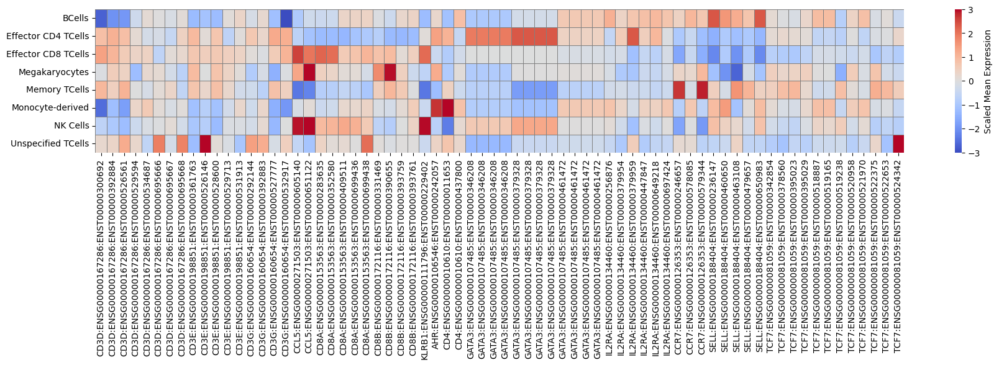

In [70]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups
marker_groups_to_include = [
    "TCells", "Cytotoxic", "CD4+ Effector", "Memory"
]

# Build isoform -> group mapping
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for isoform in matches:
        gene_to_group[isoform] = group

# Get expression matrix
iso_expr = pd.DataFrame(
    adata_i_filtered[:, matched_isoforms].X.toarray(),
    columns=matched_isoforms,
    index=adata_i_filtered.obs["gen_cell_type_reannotated"]
)

# Compute mean per cell type
mean_expr = iso_expr.groupby(iso_expr.index).mean()

# Z-score scaling across rows (cell types)
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
plot_df = scaled_expr.fillna(0).sort_index()

# Clean labels: gene:transcript or fallback
labels = []
for isoform in plot_df.columns:
    parts = isoform.split(":")
    if len(parts) == 3:
        gene = parts[0]
        tx = parts[2]
        label = f"{gene}:{tx[-4:]}"  # shorten transcript ID
    else:
        label = isoform[-8:]
    labels.append(label)

# Organize by group → gene → isoform
isoform_meta = pd.DataFrame({
    "isoform": plot_df.columns,
    "group": [gene_to_group[i] for i in plot_df.columns],
    "gene": [i.split(":")[0] for i in plot_df.columns]
})
isoform_meta["group_rank"] = isoform_meta["group"].apply(lambda x: marker_groups_to_include.index(x))
isoform_meta = isoform_meta.sort_values(["group_rank", "gene", "isoform"])
plot_df = plot_df[isoform_meta["isoform"]]

# Plot
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

sns.heatmap(
    plot_df,
    cmap="coolwarm",
    linewidths=0.5,
    linecolor='gray',
    cbar_kws={"label": "Scaled Mean Expression"},
    square=False,
    norm=norm
)

plt.xlabel("")
plt.ylabel("")
plt.xticks(ticks=np.arange(len(plot_df.columns)) + 0.5, labels=labels, rotation=90, fontsize=6)
plt.yticks(rotation=0)
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/Markers/subcelltype_marker_isoform_heatmap.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_3696852/320738915.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = iso_expr.groupby(iso_expr.index).mean()


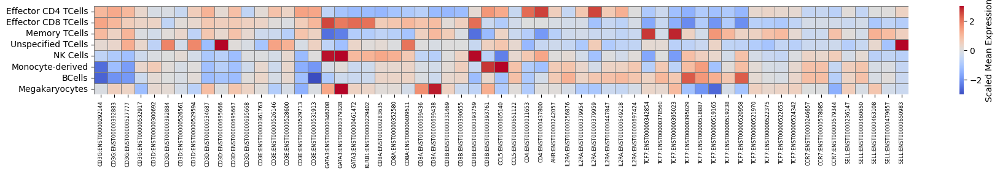

In [6]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups
marker_groups_to_include = [
    "TCells", "Cytotoxic", "CD4+ Effector", "Memory"
]

# Build isoform -> group mapping
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for isoform in matches:
        gene_to_group[isoform] = group

# Deduplicate isoforms while preserving order
unique_isoforms = list(dict.fromkeys(matched_isoforms))
# Update gene_to_group to only include unique isoforms
gene_to_group = {iso: gene_to_group[iso] for iso in unique_isoforms}

# Get expression matrix for unique isoforms
iso_expr = pd.DataFrame(
    adata_i_filtered[:, unique_isoforms].X.toarray(),
    columns=unique_isoforms,
    index=adata_i_filtered.obs["gen_cell_type_reannotated"]
)

# Compute mean per cell type
mean_expr = iso_expr.groupby(iso_expr.index).mean()

# Z-score scaling across rows (cell types)
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
desired_order = [
    "Effector CD4 TCells", "Effector CD8 TCells", "Memory TCells", "Unspecified TCells",
    "NK Cells", "Monocyte-derived", "BCells", "Megakaryocytes"
]

plot_df = scaled_expr.fillna(0).reindex(index=desired_order)

# Clean labels: full gene:transcript ID
labels = []
for isoform in plot_df.columns:
    parts = isoform.split(":")
    if len(parts) == 3:
        gene = parts[0]
        tx = parts[2]
        label = f"{gene}:{tx}"  # full ENST ID
    else:
        label = isoform  # fallback to full string
    labels.append(label)

# Organize by group → gene → isoform
isoform_meta = pd.DataFrame({
    "isoform": plot_df.columns,
    "group": [gene_to_group[i] for i in plot_df.columns],
    "gene": [i.split(":")[0] for i in plot_df.columns]
})
isoform_meta["group_rank"] = isoform_meta["group"].apply(lambda x: marker_groups_to_include.index(x))
isoform_meta = isoform_meta.sort_values(["group_rank", "gene", "isoform"])
plot_df = plot_df[isoform_meta["isoform"]]
labels = [labels[plot_df.columns.get_loc(col)] for col in plot_df.columns]  # re-sort labels

# Plot
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

sns.heatmap(
    plot_df,
    cmap="coolwarm",
    linewidths=0.5,
    linecolor='gray',
    cbar_kws={"label": "Scaled Mean Expression"},
    square=False,
    norm=norm
)

plt.xlabel("")
plt.ylabel("")
plt.xticks(ticks=np.arange(len(plot_df.columns)) + 0.5, labels=labels, rotation=90, fontsize=6)
plt.yticks(rotation=0)
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/Markers/subcelltype_marker_isoform_heatmap.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_3696852/390571521.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = iso_expr.groupby(iso_expr.index).mean()


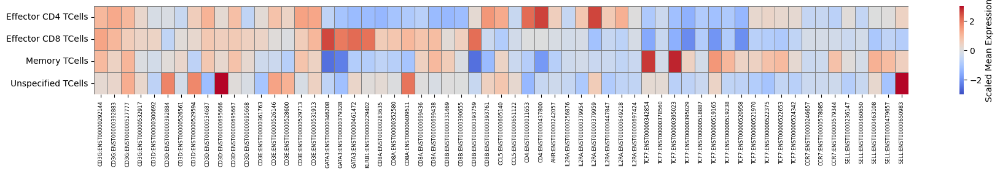

In [7]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups
marker_groups_to_include = [
    "TCells", "Cytotoxic", "CD4+ Effector", "Memory"
]

# Build isoform -> group mapping
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for isoform in matches:
        gene_to_group[isoform] = group

# Deduplicate isoforms while preserving order
unique_isoforms = list(dict.fromkeys(matched_isoforms))
# Update gene_to_group to only include unique isoforms
gene_to_group = {iso: gene_to_group[iso] for iso in unique_isoforms}

# Get expression matrix for unique isoforms
iso_expr = pd.DataFrame(
    adata_i_filtered[:, unique_isoforms].X.toarray(),
    columns=unique_isoforms,
    index=adata_i_filtered.obs["gen_cell_type_reannotated"]
)

# Compute mean per cell type
mean_expr = iso_expr.groupby(iso_expr.index).mean()

# Z-score scaling across rows (cell types)
scaled_expr = (mean_expr - mean_expr.mean(axis=1).values[:, None]) / mean_expr.std(axis=1).values[:, None]
scaled_expr = scaled_expr.fillna(0)

# Restrict to T-cell clusters only
tcell_order = [
    "Effector CD4 TCells", "Effector CD8 TCells",
    "Memory TCells", "Unspecified TCells"
]
plot_df = scaled_expr.reindex(index=tcell_order)

# Clean labels: full gene:transcript ID
labels = []
for isoform in plot_df.columns:
    parts = isoform.split(":")
    if len(parts) == 3:
        gene = parts[0]
        tx = parts[2]
        label = f"{gene}:{tx}"  # full ENST ID
    else:
        label = isoform  # fallback to full string
    labels.append(label)

# Organize by group → gene → isoform
isoform_meta = pd.DataFrame({
    "isoform": plot_df.columns,
    "group": [gene_to_group[i] for i in plot_df.columns],
    "gene": [i.split(":")[0] for i in plot_df.columns]
})
isoform_meta["group_rank"] = isoform_meta["group"].apply(lambda x: marker_groups_to_include.index(x))
isoform_meta = isoform_meta.sort_values(["group_rank", "gene", "isoform"])
plot_df = plot_df[isoform_meta["isoform"]]
labels = [labels[plot_df.columns.get_loc(col)] for col in plot_df.columns]  # re-sort labels

# Plot
plt.figure(figsize=(len(plot_df.columns) * 0.3, 3))
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

sns.heatmap(
    plot_df,
    cmap="coolwarm",
    linewidths=0.5,
    linecolor='gray',
    cbar_kws={"label": "Scaled Mean Expression"},
    square=False,
    norm=norm
)

plt.xlabel("")
plt.ylabel("")
plt.xticks(ticks=np.arange(len(plot_df.columns)) + 0.5, labels=labels, rotation=90, fontsize=6)
plt.yticks(rotation=0)
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/Markers/tcell_marker_isoform_heatmap.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_4001701/2407470216.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()


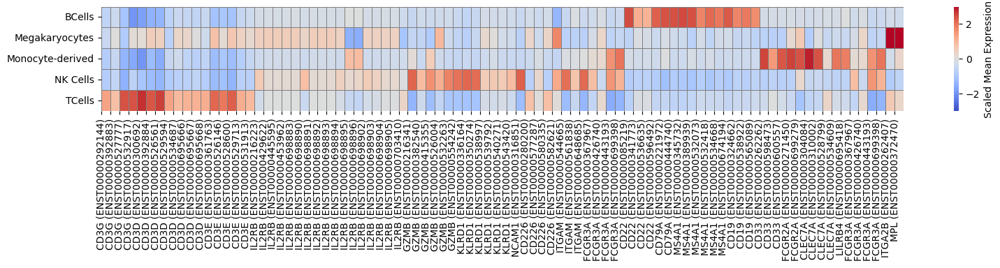

In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups you want
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend(matches)
    for isoform in matches:
        gene_to_group[isoform] = group

# Create cleaned names for plotting: GENENAME (ENSTxxxx)
def format_name(x):
    parts = x.split(":")
    return f"{parts[0]} ({parts[-1]})" if len(parts) >= 3 else x

clean_names = [format_name(x) for x in matched_isoforms]

# Get expression matrix for matched isoforms
iso_expr = pd.DataFrame(adata_i_filtered[:, matched_isoforms].X.toarray(), 
                        columns=clean_names, 
                        index=adata_i_filtered.obs["gen_cell_type"])

# Calculate mean expression per cluster
mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()

# Scale expression (z-score per isoform)
scaled_expr_iso = (mean_expr_iso - mean_expr_iso.mean(axis=1).values[:, None]) / mean_expr_iso.std(axis=1).values[:, None]

plot_df_iso = scaled_expr_iso.copy().sort_index().fillna(0)

# Normalize color scale
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

# Plot
plt.figure(figsize=(16, 4))
sns.heatmap(plot_df_iso, cmap="coolwarm", linewidths=0.7, linecolor='gray',
            cbar_kws={"label": "Scaled Mean Expression"}, square=False,
            norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(ticks=np.arange(plot_df_iso.shape[1]), labels=plot_df_iso.columns, rotation=90)
plt.yticks(rotation=0)

plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_heatmap_cleanednames.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_4001701/1855145895.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()


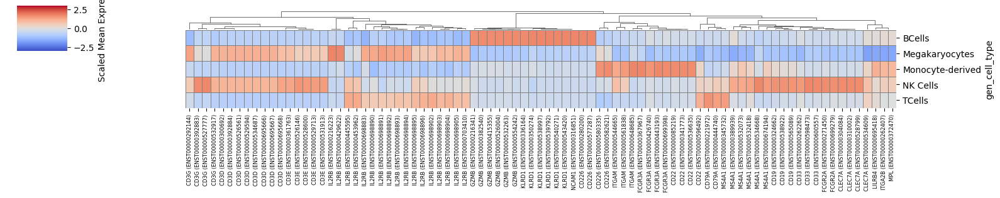

In [26]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define marker groups
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend([m for m in matches if m not in matched_isoforms])
    for isoform in matches:
        gene_to_group[isoform] = group

def format_name(x):
    parts = x.split(":")
    return f"{parts[0]} ({parts[-1]})" if len(parts) >= 3 else x

clean_names = [format_name(x) for x in matched_isoforms]

# Extract expression
iso_expr = pd.DataFrame(adata_i_filtered[:, matched_isoforms].X.toarray(), 
                        columns=clean_names, 
                        index=adata_i_filtered.obs["gen_cell_type"])

# Aggregate mean expression per cell type
mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()

# Z-score per gene (across cell types, so axis=0)
scaled_expr_iso = (mean_expr_iso - mean_expr_iso.mean()) / mean_expr_iso.std()

# Replace NaNs with 0
plot_df_iso = scaled_expr_iso.fillna(0)

# Normalize color scale
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

# Clustered heatmap with dendrogram on columns (isoforms)
g = sns.clustermap(plot_df_iso, cmap="coolwarm", linewidths=0.7, linecolor='gray',
                   figsize=(16, 4), col_cluster=True, row_cluster=False, 
                   cbar_kws={"label": "Scaled Mean Expression"},
                   norm=norm)

# Fix missing x labels
g.ax_heatmap.set_xticks(np.arange(len(plot_df_iso.columns)) + 0.5)
g.ax_heatmap.set_xticklabels(plot_df_iso.columns, rotation=90, ha='center')
g.ax_heatmap.tick_params(axis='x', labelsize=6)

g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0)

plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_clustermap_dendrogram.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

/tmp/ipykernel_534167/958897654.py:44: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()


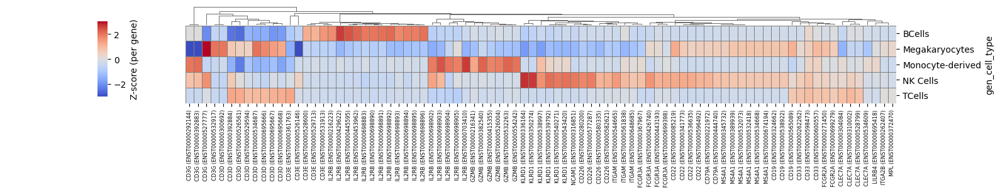

In [16]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from collections import defaultdict
import re

# --- SETTINGS ---
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# --- FORMAT CLEANED ISOFORM LABELS ---
def format_name(x):
    parts = x.split(":")
    return f"{parts[0]} ({parts[-1]})" if len(parts) >= 3 else x

def get_gene_name(label):
    match = re.match(r"^(.+?) \(", label)
    return match.group(1) if match else label

# --- MATCH ISOFORMS ---
matched_isoforms = []
gene_to_group = {}

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend([m for m in matches if m not in matched_isoforms])  # Deduplicate
    for isoform in matches:
        gene_to_group[isoform] = group

# --- FORMAT COLUMN NAMES ---
clean_names = [format_name(x) for x in matched_isoforms]

# --- EXTRACT EXPRESSION FROM log_denoised LAYER ---
iso_expr = pd.DataFrame(
    adata_i_filtered[:, matched_isoforms].layers["log_denoised"],
    columns=clean_names,
    index=adata_i_filtered.obs["gen_cell_type"]
)

# --- CALCULATE MEAN EXPRESSION PER CELL TYPE ---
mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()
plot_df_iso = mean_expr_iso.copy().sort_index().fillna(0)

# --- REMOVE DUPLICATE COLUMNS ---
plot_df_iso = plot_df_iso.loc[:, ~plot_df_iso.columns.duplicated()]

# --- MAP ISOFORMS TO GENES ---
isoform_to_gene = {name: get_gene_name(name) for name in plot_df_iso.columns}
gene_to_isoforms = defaultdict(list)
for iso, gene in isoform_to_gene.items():
    gene_to_isoforms[gene].append(iso)

# --- GENE-WISE Z-SCORING ACROSS ISOFORMS ---
scaled_by_gene = pd.DataFrame(index=plot_df_iso.index)

for gene, isoforms in gene_to_isoforms.items():
    data = plot_df_iso[isoforms]
    all_values = data.values.flatten()
    mean = all_values.mean()
    std = all_values.std()
    scaled = (data - mean) / std
    scaled_by_gene = pd.concat([scaled_by_gene, scaled], axis=1)

# Replace non-finite values (inf, NaN) with 0 for clustering
scaled_by_gene = scaled_by_gene.replace([np.inf, -np.inf], np.nan).fillna(0)

# --- COLOR SCALE ---
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

# --- CLUSTERMAP ---
g = sns.clustermap(scaled_by_gene, cmap="coolwarm", linewidths=0.7, linecolor='gray',
                   figsize=(16, 4), col_cluster=True, row_cluster=False, 
                   cbar_kws={"label": "Z-score (per gene)"},
                   norm=norm)

# --- COLORBAR POSITIONING ---
g.cax.set_position([.1, .6, .01, .3])
g.cax.xaxis.set_label_position('bottom')
g.cax.xaxis.tick_bottom()

# --- X/Y LABEL FIXES ---
g.ax_heatmap.set_xticks(np.arange(len(scaled_by_gene.columns)) + 0.5)
g.ax_heatmap.set_xticklabels(scaled_by_gene.columns, rotation=90, ha='center')
g.ax_heatmap.tick_params(axis='x', labelsize=6)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0)

# --- SAVE FIGURE ---
plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_by_gene_clustermap.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()


In [12]:
isoforms = find_matching_genes(["CD3E", "CD3G"], adata_i_filtered.var_names)
clean = [format_name(x) for x in isoforms]

df = pd.DataFrame(
    adata_i_filtered[:, isoforms].layers["log_denoised"],
    columns=clean,
    index=adata_i_filtered.obs["gen_cell_type"]
)
print(df.groupby(df.index).mean().loc["NK Cells"])

CD3G (ENST00000292144)   -0.235414
CD3G (ENST00000392883)   -0.034777
CD3G (ENST00000527777)   -0.748949
CD3G (ENST00000532917)   -0.132892
CD3E (ENST00000361763)   -0.600110
CD3E (ENST00000526146)   -0.492769
CD3E (ENST00000528600)   -0.711344
CD3E (ENST00000529713)   -0.162248
CD3E (ENST00000531913)   -0.162077
Name: NK Cells, dtype: float32


/tmp/ipykernel_534167/2534639320.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(df.groupby(df.index).mean().loc["NK Cells"])


/tmp/ipykernel_534167/2204649750.py:44: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()


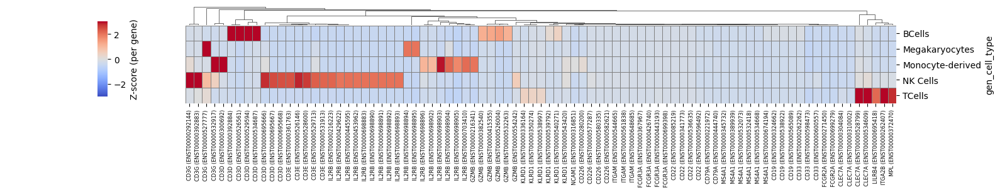

In [8]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from collections import defaultdict
import re

# --- SETTINGS ---
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived", "Megakaryocyte"]

# --- FORMAT CLEANED ISOFORM LABELS ---
def format_name(x):
    parts = x.split(":")
    return f"{parts[0]} ({parts[-1]})" if len(parts) >= 3 else x

def get_gene_name(label):
    match = re.match(r"^(.+?) \(", label)
    return match.group(1) if match else label

# --- MATCH ISOFORMS ---
matched_isoforms = []
gene_to_group = {}

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue
    matches = find_matching_genes(genes, adata_i_filtered.var_names)
    matched_isoforms.extend([m for m in matches if m not in matched_isoforms])  # Deduplicate
    for isoform in matches:
        gene_to_group[isoform] = group

# --- FORMAT COLUMN NAMES ---
clean_names = [format_name(x) for x in matched_isoforms]

# --- EXTRACT EXPRESSION FROM log_denoised LAYER ---
iso_expr = pd.DataFrame(
    adata_i_filtered[:, matched_isoforms].layers["counts"],
    columns=clean_names,
    index=adata_i_filtered.obs["gen_cell_type"]
)

# --- CALCULATE MEAN EXPRESSION PER CELL TYPE ---
mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()
plot_df_iso = mean_expr_iso.copy().sort_index().fillna(0)

# --- REMOVE DUPLICATE COLUMNS ---
plot_df_iso = plot_df_iso.loc[:, ~plot_df_iso.columns.duplicated()]

# --- MAP ISOFORMS TO GENES ---
isoform_to_gene = {name: get_gene_name(name) for name in plot_df_iso.columns}
gene_to_isoforms = defaultdict(list)
for iso, gene in isoform_to_gene.items():
    gene_to_isoforms[gene].append(iso)

# --- GENE-WISE Z-SCORING ACROSS ISOFORMS ---
scaled_by_gene = pd.DataFrame(index=plot_df_iso.index)

for gene, isoforms in gene_to_isoforms.items():
    data = plot_df_iso[isoforms]
    all_values = data.values.flatten()
    mean = all_values.mean()
    std = all_values.std()
    scaled = (data - mean) / std
    scaled_by_gene = pd.concat([scaled_by_gene, scaled], axis=1)

# --- COLOR SCALE ---
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

# --- CLUSTERMAP ---
g = sns.clustermap(scaled_by_gene, cmap="coolwarm", linewidths=0.7, linecolor='gray',
                   figsize=(16, 4), col_cluster=True, row_cluster=False, 
                   cbar_kws={"label": "Z-score (per gene)"},
                   norm=norm)

# --- COLORBAR POSITIONING ---
g.cax.set_position([.1, .6, .01, .3])
g.cax.xaxis.set_label_position('bottom')
g.cax.xaxis.tick_bottom()

# --- X/Y LABEL FIXES ---
g.ax_heatmap.set_xticks(np.arange(len(scaled_by_gene.columns)) + 0.5)
g.ax_heatmap.set_xticklabels(scaled_by_gene.columns, rotation=90, ha='center')
g.ax_heatmap.tick_params(axis='x', labelsize=6)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0)

# --- SAVE FIGURE ---
plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_by_gene_raw.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()


In [34]:
import pandas as pd

# Pull barcodes and gen_cell_type labels
barcodes = adata_g_filtered.obs_names.to_series()
cell_types = adata_g_filtered.obs["gen_cell_type"]

# Create dataframe to pass to R
cell_type_df = pd.DataFrame({
    "barcode": barcodes.values,
    "gen_cell_type": cell_types.values
})

In [38]:
from pathlib import Path
export_path = Path("soupX_input")
export_path.mkdir(parents=True, exist_ok=True)

In [110]:
# Get isoforms used in heatmap in correct order
isoforms_in_order = plot_df_iso.columns.tolist()

# Split GENENAME:ENSGID:ENSTID → gene_name, ensg_id, transcript_id
split_isoforms = [s.split(":") for s in isoforms_in_order]
df_names = pd.DataFrame(split_isoforms, columns=["gene_name", "ensg_id", "transcript_id"])

# Add column for clean label
df_names["isoform_full"] = isoforms_in_order  # keep original order reference

# Generate output following order
output_lines = []
current_gene = None

for _, row in df_names.iterrows():
    gene = row["gene_name"]
    transcript = row["transcript_id"]

    if gene != current_gene:
        # New gene
        if current_gene is not None:
            output_lines.append("")  # blank line between genes
        output_lines.append(f"{gene}:")
        current_gene = gene

    output_lines.append(f"{transcript}")

# Join into string
output_text = "\n".join(output_lines)

# Print
print(output_text)

# Optional: save to file
#with open("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_list.txt", "w") as f:
#    f.write(output_text)

CD3G:
ENST00000292144
ENST00000392883
ENST00000527777
ENST00000532917

CD3D:
ENST00000300692
ENST00000392884
ENST00000526561
ENST00000529594
ENST00000534687
ENST00000695666
ENST00000695667
ENST00000695668

CD3E:
ENST00000361763
ENST00000526146
ENST00000528600
ENST00000529713
ENST00000531913

IL2RB:
ENST00000216223
ENST00000429622
ENST00000445595
ENST00000453962
ENST00000698883
ENST00000698890
ENST00000698891
ENST00000698892
ENST00000698893
ENST00000698894
ENST00000698895
ENST00000698896
ENST00000698902
ENST00000698903
ENST00000698904
ENST00000698905
ENST00000703410

GZMB:
ENST00000216341
ENST00000382540
ENST00000415355
ENST00000526004
ENST00000532263
ENST00000554242

KLRD1:
ENST00000336164
ENST00000350274
ENST00000538997
ENST00000539792
ENST00000540271
ENST00000543420

NCAM1:
ENST00000316851

CD226:
ENST00000280200
ENST00000577287
ENST00000580335
ENST00000582621

ITGAM:
ENST00000544665
ENST00000561838
ENST00000648685

FCGR3A:
ENST00000367967
ENST00000426740
ENST00000443193
ENST00000699

In [64]:
#PTPRCAP = CD45
TCell_Markers = ["CD4:", "CD3D:", "CD3E:", "CD3G:","CD8A:", "CD8B:", "PTPRCAP:"]
#Naive_TCell = ["PTPRCAP:", "TCF7:", "FOXP1", "LEF1:", "PECAM1:"]
Memory_TCell = ["CCR7:", "SELL", "TCF7:",
                #"CCR5:", "HLA-DRB1:", "HLA-DRA:", "ITGAE:",  "IL7R:", 
               ]
CD8_TCell = ["CD8A:", "CD8B:", "KLRB1:", "GATA3:", "CCL5",
             #"CXCR3:", "PTGDR2:",  "IRF4:", "RORC:", 
            ]
#Central_Memory_TCell = ["CCR5:", "IL7RA:", "EOMES:", "PRDM1:", "IL7R:", "SELL", "CCR7:"]
#Effector_Memory_TCell = ["CCR5:", "HLA-DRB1:", "HLA-DRA:", "ITGAL:", "GZMA:", "PRDM1:", "SELL"]
#Reg_TCell = ["FOXP3:", "IL2RA:", "CTLA4:", "STAT5A"]
#Th1_TCell = ["CXCR3:", "IFNG:", "TNF:", "STAT4:"]
CD4_Effector = ["CD4:", "AHR:", "GATA3", "IL2RA",
               #"CXCR3:", "TNF:", "STAT4:", "IL17A:", "IL13:", "IL25:", "FOXO4:",
               ]

In [65]:
# Get gene matches for gene-level data
TCell_genes_1 = find_matching_genes(TCell_Markers, adata_g_filtered.var_names)
print(f"Matched {len(TCell_genes_1)} gene-level IDs for T-Cells: {TCell_genes_1}")
TCell_genes_2 = find_matching_genes(Memory_TCell, adata_g_filtered.var_names)
print(f"Matched {len(TCell_genes_2)} gene-level IDs for Memory T-Cells: {TCell_genes_2}")
TCell_genes_3 = find_matching_genes(CD8_TCell, adata_g_filtered.var_names)
print(f"Matched {len(TCell_genes_3)} gene-level IDs for CD8+ T-Cells: {TCell_genes_3}")
TCell_genes_4 = find_matching_genes(CD4_Effector, adata_g_filtered.var_names)
print(f"Matched {len(TCell_genes_4)} gene-level IDs for Helper T-Cells: {TCell_genes_4}")


Matched 7 gene-level IDs for T-Cells: ['CD4:ENSG00000010610', 'CD8A:ENSG00000153563', 'CD3G:ENSG00000160654', 'CD3D:ENSG00000167286', 'CD8B:ENSG00000172116', 'CD3E:ENSG00000198851', 'PTPRCAP:ENSG00000213402']
Matched 3 gene-level IDs for Memory T-Cells: ['TCF7:ENSG00000081059', 'CCR7:ENSG00000126353', 'SELL:ENSG00000188404']
Matched 5 gene-level IDs for CD8+ T-Cells: ['GATA3:ENSG00000107485', 'KLRB1:ENSG00000111796', 'CD8A:ENSG00000153563', 'CD8B:ENSG00000172116', 'CCL5:ENSG00000271503']
Matched 5 gene-level IDs for Helper T-Cells: ['CD4:ENSG00000010610', 'AHR:ENSG00000106546', 'GATA3:ENSG00000107485', 'IL2RA:ENSG00000134460', 'GATA3-AS1:ENSG00000197308']


In [66]:
# Get gene matches for isoform-level data
TCell_isos_1 = find_matching_genes(TCell_Markers, adata_i_filtered.var_names)
print(f"Matched {len(TCell_isos_1)} isoform-level IDs for T-Cells: {TCell_isos_1}")
TCell_isos_2 = find_matching_genes(Memory_TCell, adata_i_filtered.var_names)
print(f"Matched {len(TCell_isos_2)} isoform-level IDs for Memory T-Cells: {TCell_isos_2}")
TCell_isos_3 = find_matching_genes(CD8_TCell, adata_i_filtered.var_names)
print(f"Matched {len(TCell_isos_3)} isoform-level IDs for CD8+ T-Cells: {TCell_isos_3}")
TCell_isos_4 = find_matching_genes(CD4_Effector, adata_i_filtered.var_names)
print(f"Matched {len(TCell_isos_4)} isoform-level IDs for Helper T-Cells: {TCell_isos_4}")

Matched 29 isoform-level IDs for T-Cells: ['CD4:ENSG00000010610:ENST00000011653', 'CD4:ENSG00000010610:ENST00000437800', 'CD8A:ENSG00000153563:ENST00000283635', 'CD8A:ENSG00000153563:ENST00000352580', 'CD8A:ENSG00000153563:ENST00000409511', 'CD8A:ENSG00000153563:ENST00000699436', 'CD8A:ENSG00000153563:ENST00000699438', 'CD3G:ENSG00000160654:ENST00000292144', 'CD3G:ENSG00000160654:ENST00000392883', 'CD3G:ENSG00000160654:ENST00000527777', 'CD3G:ENSG00000160654:ENST00000532917', 'CD3D:ENSG00000167286:ENST00000300692', 'CD3D:ENSG00000167286:ENST00000392884', 'CD3D:ENSG00000167286:ENST00000526561', 'CD3D:ENSG00000167286:ENST00000529594', 'CD3D:ENSG00000167286:ENST00000534687', 'CD3D:ENSG00000167286:ENST00000695666', 'CD3D:ENSG00000167286:ENST00000695667', 'CD3D:ENSG00000167286:ENST00000695668', 'CD8B:ENSG00000172116:ENST00000331469', 'CD8B:ENSG00000172116:ENST00000390655', 'CD8B:ENSG00000172116:ENST00000393759', 'CD8B:ENSG00000172116:ENST00000393761', 'CD3E:ENSG00000198851:ENST00000361763',

T-Cell Markers
CD4:ENSG00000010610: 192 cells above 99th percentile (vmax = 2.71)


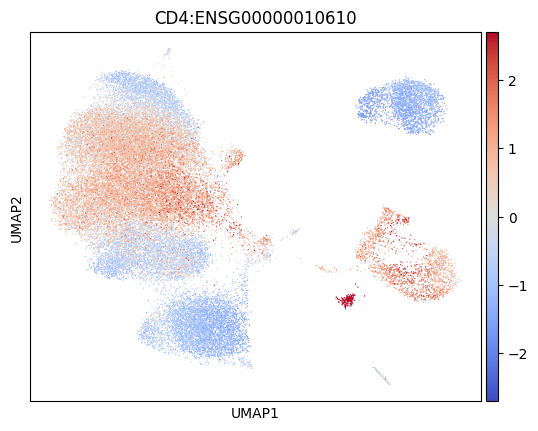

CD8A:ENSG00000153563: 154 cells above 99th percentile (vmax = 3.15)


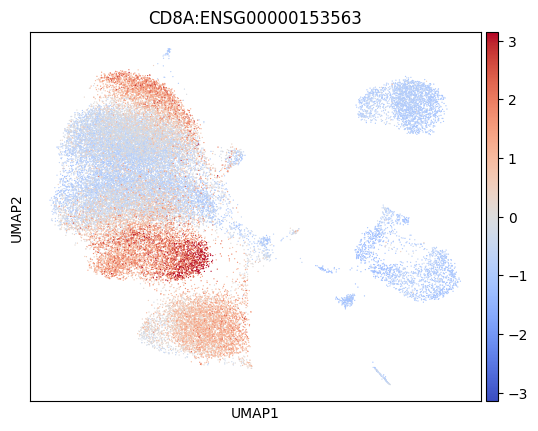

CD3G:ENSG00000160654: 238 cells above 99th percentile (vmax = 1.84)


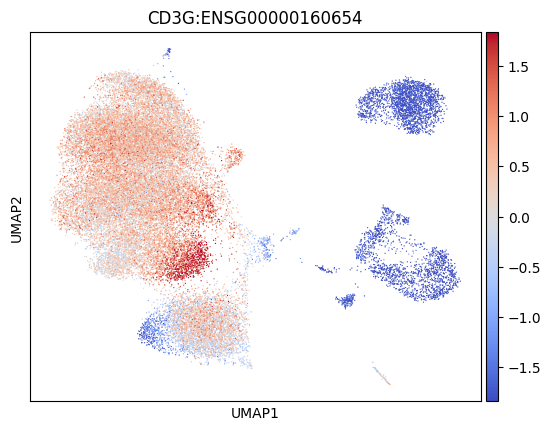

CD3D:ENSG00000167286: 246 cells above 99th percentile (vmax = 1.60)


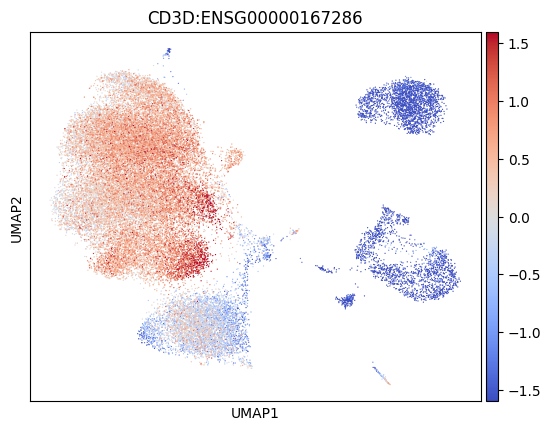

CD8B:ENSG00000172116: 144 cells above 99th percentile (vmax = 3.19)


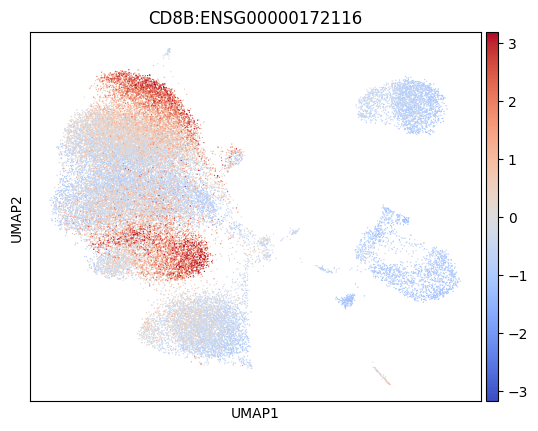

CD3E:ENSG00000198851: 259 cells above 99th percentile (vmax = 1.46)


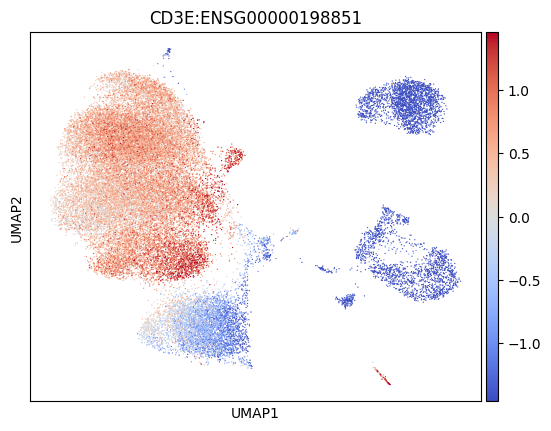

PTPRCAP:ENSG00000213402: 180 cells above 99th percentile (vmax = 2.11)


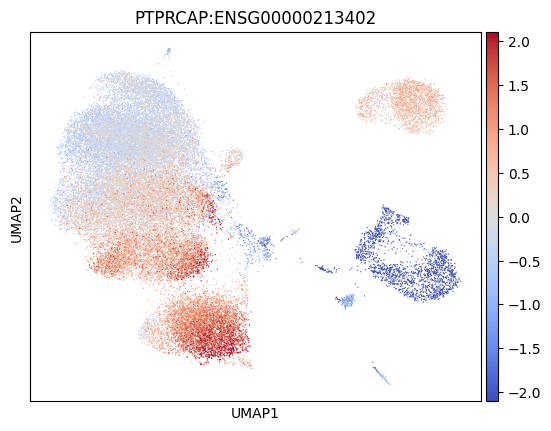

In [25]:
import scanpy as sc
from matplotlib.colors import TwoSlopeNorm
import matplotlib.pyplot as plt

# Define output directory
marker_root = "Intermediate_Files/Paper_Figs/Markers/By_Gene"
group_name = "TCell"
output_dir = os.path.join(marker_root, f"Gene_{group_name}_Markers")
os.makedirs(output_dir, exist_ok=True)
sc.settings.figdir = output_dir

print("T-Cell Markers")

for gene in TCell_genes_1:
    safe_gene_name = gene.replace(":", "_")

    # Get expression vector
    expr = adata_g_filtered[:, gene].X

    # Convert sparse to dense if needed
    if hasattr(expr, "toarray"):
        expr = expr.toarray().flatten()
    else:
        expr = np.ravel(expr)

    # Exclude 0s if you want to scale based only on expressing cells
    expr_nonzero = expr[expr > 0]

    # Calculate 99th percentile for vmax
    vmax_val = np.percentile(expr_nonzero, 99) if len(expr_nonzero) > 0 else 1.0

    # Count how many cells exceed the 95th percentile
    num_above_vmax = np.sum(expr > vmax_val)
    print(f"{gene}: {num_above_vmax} cells above 99th percentile (vmax = {vmax_val:.2f})")

    # Calculate symmetric range for scaling around zero
    vmax_val = np.percentile(expr_nonzero, 99)
    norm = TwoSlopeNorm(vmin=-vmax_val, vcenter=0, vmax=vmax_val)
    
    sc.pl.umap(
        adata_g_filtered,
        color=gene,
        use_raw=False,
        title=f"{gene}",
        cmap="coolwarm",       # Sequential colormap with centered norm
        save=f"{safe_gene_name}.pdf",
        show=True,
        norm=norm             # << This handles vmin, vmax, and vcenter
    )

Memory T-Cell Markers
TCF7:ENSG00000081059: 206 cells above 99th percentile (vmax = 2.31)


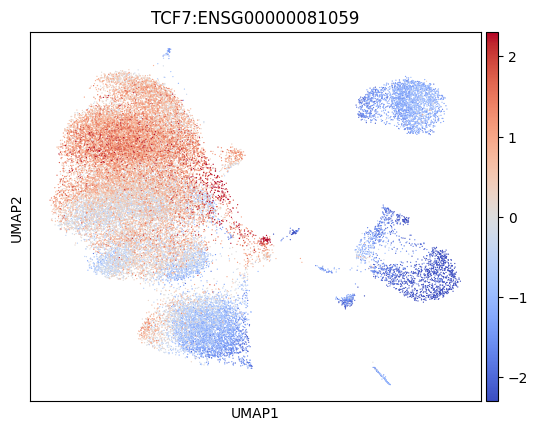

CCR7:ENSG00000126353: 185 cells above 99th percentile (vmax = 2.14)


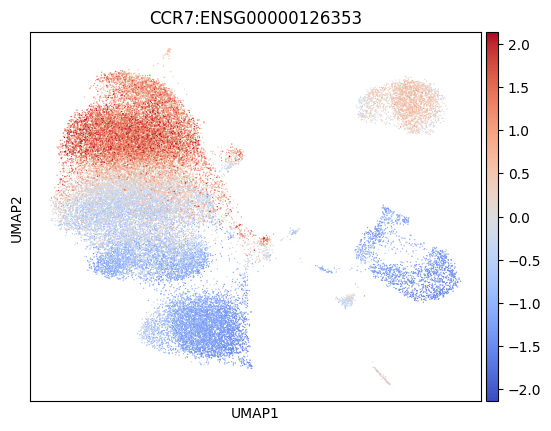

SELL:ENSG00000188404: 185 cells above 99th percentile (vmax = 2.88)


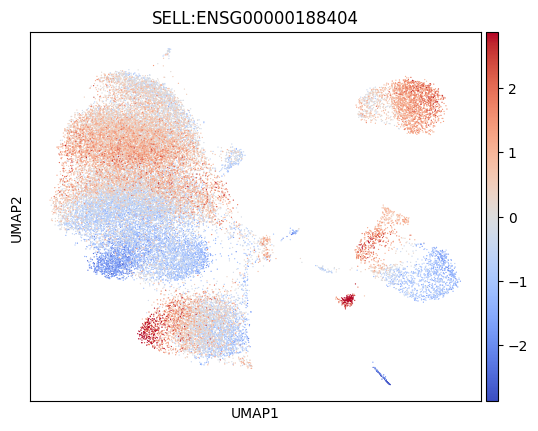

In [26]:
import scanpy as sc
from matplotlib.colors import TwoSlopeNorm
import matplotlib.pyplot as plt

# Define output directory
marker_root = "Intermediate_Files/Paper_Figs/Markers/By_Gene"
group_name = "Memory_TCell"
output_dir = os.path.join(marker_root, f"Gene_{group_name}_Markers")
os.makedirs(output_dir, exist_ok=True)
sc.settings.figdir = output_dir

print("Memory T-Cell Markers")

for gene in TCell_genes_2:
    safe_gene_name = gene.replace(":", "_")

    # Get expression vector
    expr = adata_g_filtered[:, gene].X

    # Convert sparse to dense if needed
    if hasattr(expr, "toarray"):
        expr = expr.toarray().flatten()
    else:
        expr = np.ravel(expr)

    # Exclude 0s if you want to scale based only on expressing cells
    expr_nonzero = expr[expr > 0]

    # Calculate 99th percentile for vmax
    vmax_val = np.percentile(expr_nonzero, 99) if len(expr_nonzero) > 0 else 1.0

    # Count how many cells exceed the 95th percentile
    num_above_vmax = np.sum(expr > vmax_val)
    print(f"{gene}: {num_above_vmax} cells above 99th percentile (vmax = {vmax_val:.2f})")

    # Calculate symmetric range for scaling around zero
    vmax_val = np.percentile(expr_nonzero, 99)
    norm = TwoSlopeNorm(vmin=-vmax_val, vcenter=0, vmax=vmax_val)
    
    sc.pl.umap(
        adata_g_filtered,
        color=gene,
        use_raw=False,
        title=f"{gene}",
        cmap="coolwarm",       # Sequential colormap with centered norm
        save=f"{safe_gene_name}.pdf",
        show=True,
        norm=norm             # << This handles vmin, vmax, and vcenter
    )

CD8+ T-Cell Markers
GATA3:ENSG00000107485: 173 cells above 99th percentile (vmax = 3.01)


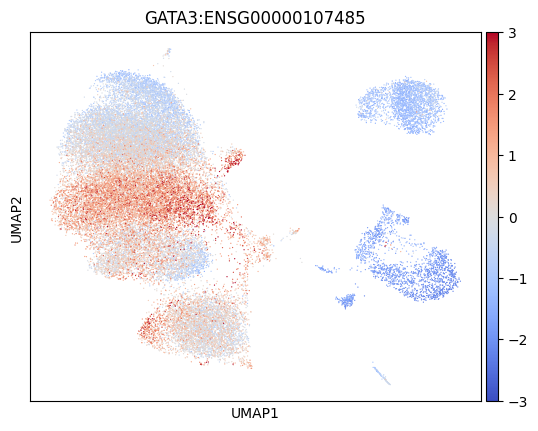

KLRB1:ENSG00000111796: 163 cells above 99th percentile (vmax = 2.56)


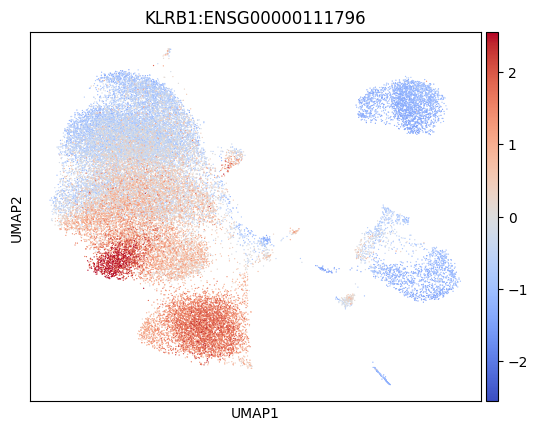

CD8A:ENSG00000153563: 154 cells above 99th percentile (vmax = 3.15)


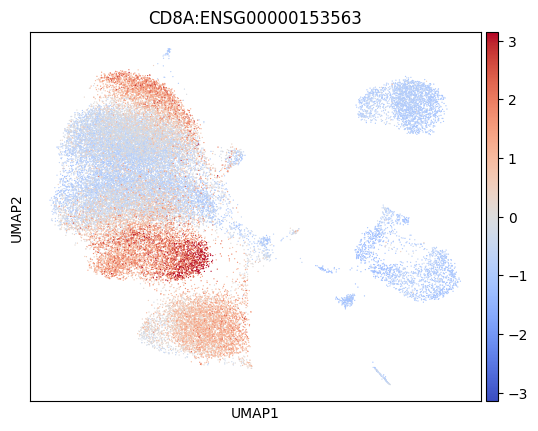

CD8B:ENSG00000172116: 144 cells above 99th percentile (vmax = 3.19)


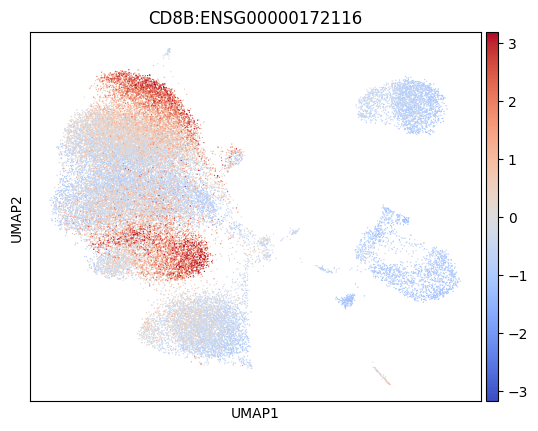

CCL5:ENSG00000271503: 144 cells above 99th percentile (vmax = 2.33)


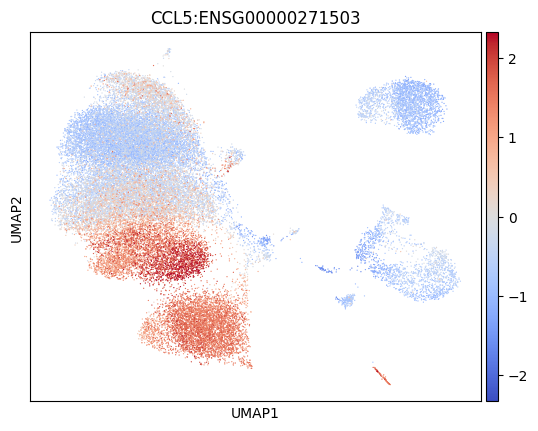

In [27]:
import scanpy as sc
from matplotlib.colors import TwoSlopeNorm
import matplotlib.pyplot as plt

# Define output directory
marker_root = "Intermediate_Files/Paper_Figs/Markers/By_Gene"
group_name = "CD8_TCell"
output_dir = os.path.join(marker_root, f"Gene_{group_name}_Markers")
os.makedirs(output_dir, exist_ok=True)
sc.settings.figdir = output_dir

print("CD8+ T-Cell Markers")

for gene in TCell_genes_3:
    safe_gene_name = gene.replace(":", "_")

    # Get expression vector
    expr = adata_g_filtered[:, gene].X

    # Convert sparse to dense if needed
    if hasattr(expr, "toarray"):
        expr = expr.toarray().flatten()
    else:
        expr = np.ravel(expr)

    # Exclude 0s if you want to scale based only on expressing cells
    expr_nonzero = expr[expr > 0]

    # Calculate 99th percentile for vmax
    vmax_val = np.percentile(expr_nonzero, 99) if len(expr_nonzero) > 0 else 1.0

    # Count how many cells exceed the 95th percentile
    num_above_vmax = np.sum(expr > vmax_val)
    print(f"{gene}: {num_above_vmax} cells above 99th percentile (vmax = {vmax_val:.2f})")

    # Calculate symmetric range for scaling around zero
    vmax_val = np.percentile(expr_nonzero, 99)
    norm = TwoSlopeNorm(vmin=-vmax_val, vcenter=0, vmax=vmax_val)
    
    sc.pl.umap(
        adata_g_filtered,
        color=gene,
        use_raw=False,
        title=f"{gene}",
        cmap="coolwarm",       # Sequential colormap with centered norm
        save=f"{safe_gene_name}.pdf",
        show=True,
        norm=norm             # << This handles vmin, vmax, and vcenter
    )

CD4+ Effector T-Cell Markers
CD4:ENSG00000010610: 192 cells above 99th percentile (vmax = 2.71)


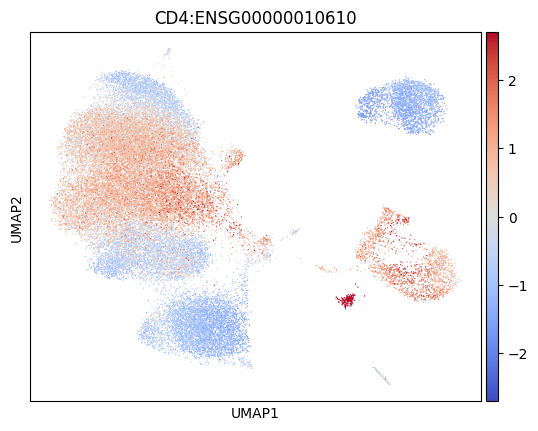

AHR:ENSG00000106546: 146 cells above 99th percentile (vmax = 5.01)


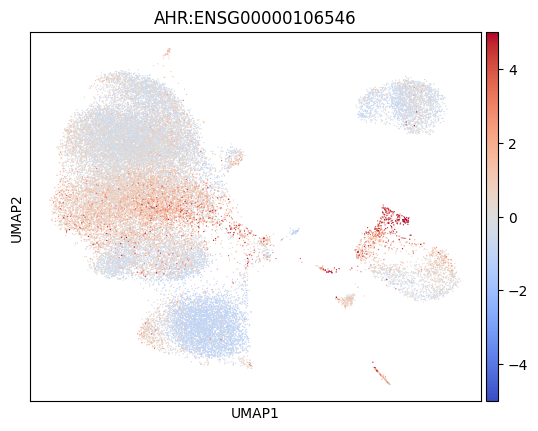

GATA3:ENSG00000107485: 173 cells above 99th percentile (vmax = 3.01)


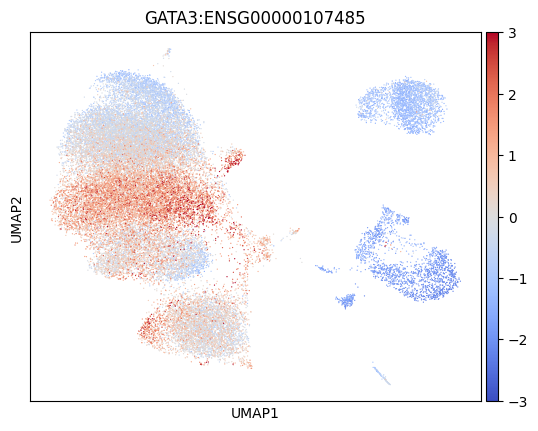

IL2RA:ENSG00000134460: 134 cells above 99th percentile (vmax = 5.15)


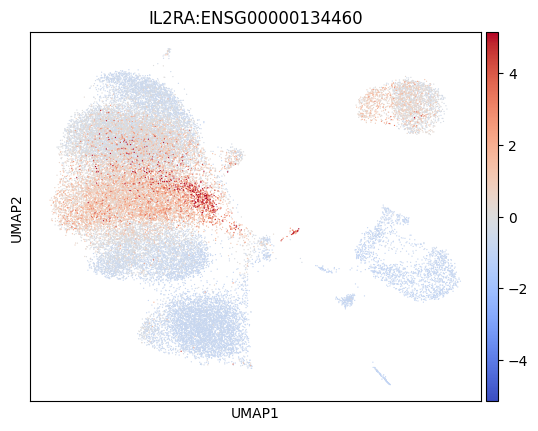

GATA3-AS1:ENSG00000197308: 113 cells above 99th percentile (vmax = 6.42)


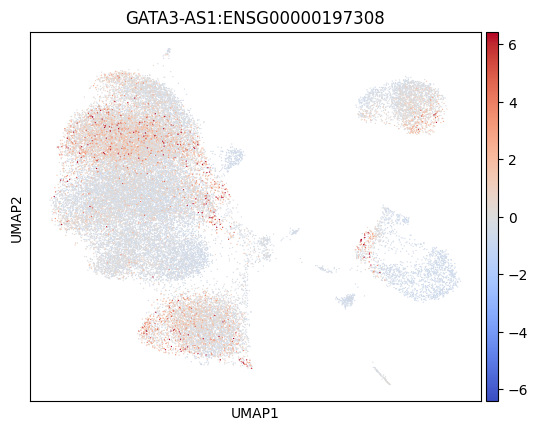

In [28]:
import scanpy as sc
from matplotlib.colors import TwoSlopeNorm
import matplotlib.pyplot as plt

# Define output directory
marker_root = "Intermediate_Files/Paper_Figs/Markers/By_Gene"
group_name = "CD4_Effector_TCell"
output_dir = os.path.join(marker_root, f"Gene_{group_name}_Markers")
os.makedirs(output_dir, exist_ok=True)
sc.settings.figdir = output_dir

print("CD4+ Effector T-Cell Markers")

for gene in TCell_genes_4:
    safe_gene_name = gene.replace(":", "_")

    # Get expression vector
    expr = adata_g_filtered[:, gene].X

    # Convert sparse to dense if needed
    if hasattr(expr, "toarray"):
        expr = expr.toarray().flatten()
    else:
        expr = np.ravel(expr)

    # Exclude 0s if you want to scale based only on expressing cells
    expr_nonzero = expr[expr > 0]

    # Calculate 99th percentile for vmax
    vmax_val = np.percentile(expr_nonzero, 99) if len(expr_nonzero) > 0 else 1.0

    # Count how many cells exceed the 95th percentile
    num_above_vmax = np.sum(expr > vmax_val)
    print(f"{gene}: {num_above_vmax} cells above 99th percentile (vmax = {vmax_val:.2f})")

    # Calculate symmetric range for scaling around zero
    vmax_val = np.percentile(expr_nonzero, 99)
    norm = TwoSlopeNorm(vmin=-vmax_val, vcenter=0, vmax=vmax_val)
    
    sc.pl.umap(
        adata_g_filtered,
        color=gene,
        use_raw=False,
        title=f"{gene}",
        cmap="coolwarm",       # Sequential colormap with centered norm
        save=f"{safe_gene_name}.pdf",
        show=True,
        norm=norm             # << This handles vmin, vmax, and vcenter
    )

In [55]:
adata_i_filtered.obs

,cell_ids,sample,n_isoforms_by_counts,log1p_n_genes_by_counts,total_counts_isoforms,log1p_total_counts_isoforms,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_hb,...,0.76_log_AutoZI,0.8_log_AutoZI,0.84_log_AutoZI,0.86_log_AutoZI,0.9_log_AutoZI,0.94_log_AutoZI,0.96_log_AutoZI,1.0_log_AutoZI,gen_cell_type,gen_cell_type_reannotated
PBMC1_AAAAAAAAAACACAAA_filtered_mapq_10,PBMC1_AAAAAAAAAACACAAA_filtered_mapq_10,PBMC1,2047,7.624619,3894.89970,8.267680,303.0,5.717028,7.779404,1.0,...,4,4,4,4,4,3,4,2,NK Cells,NK Cells
PBMC1_AAAAAAACATATAGGC_filtered_mapq_10,PBMC1_AAAAAAACATATAGGC_filtered_mapq_10,PBMC1,1229,7.114769,3248.66635,8.086308,129.0,4.867534,3.970860,2.0,...,2,3,3,2,2,2,2,3,TCells,Effector CD4 TCells
PBMC1_AAAAAAAGCATGCCGG_filtered_mapq_10,PBMC1_AAAAAAAGCATGCCGG_filtered_mapq_10,PBMC1,432,6.070738,512.00010,6.240276,20.0,3.044522,3.906249,0.0,...,1,0,0,1,1,1,5,5,TCells,Memory TCells
PBMC1_AAAAAAATCAATACTG_filtered_mapq_10,PBMC1_AAAAAAATCAATACTG_filtered_mapq_10,PBMC1,2855,7.957177,7141.66601,8.873841,590.0,6.381816,8.261378,0.0,...,6,7,7,7,7,7,7,7,Monocyte-derived,Monocyte-derived
PBMC1_AAAAAACAAACACAGC_filtered_mapq_10,PBMC1_AAAAAACAAACACAGC_filtered_mapq_10,PBMC1,1803,7.497762,5489.90894,8.610849,320.0,5.771441,5.828876,0.0,...,0,1,1,0,0,0,0,8,TCells,Effector CD4 TCells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PBMC2_CCTTCCTGATATATCA_filtered_mapq_10,PBMC2_CCTTCCTGATATATCA_filtered_mapq_10,PBMC2,798,6.683361,1156.83295,7.054305,104.0,4.653960,8.990062,0.0,...,5,5,5,5,6,6,6,6,BCells,BCells
PBMC2_CCTTCCTTACCCAGAA_filtered_mapq_10,PBMC2_CCTTCCTTACCCAGAA_filtered_mapq_10,PBMC2,985,6.893656,1106.74965,7.010086,81.0,4.406719,7.318728,0.0,...,4,4,4,4,4,3,4,2,NK Cells,NK Cells
PBMC2_CCTTCCTTATTTCAGG_filtered_mapq_10,PBMC2_CCTTCCTTATTTCAGG_filtered_mapq_10,PBMC2,967,6.875232,1768.99980,7.478735,77.0,4.356709,4.352742,0.0,...,2,3,3,2,2,2,2,3,TCells,Effector CD4 TCells
PBMC2_CCTTCCTTCCACATTG_filtered_mapq_10,PBMC2_CCTTCCTTCCACATTG_filtered_mapq_10,PBMC2,504,6.224558,938.99990,6.845880,68.0,4.234107,7.241747,1.0,...,1,0,0,1,1,1,1,0,TCells,Memory TCells


In [57]:
adata_TCell_i = adata_i_filtered[adata_i_filtered.obs["gen_cell_type"] == "TCells"].copy()

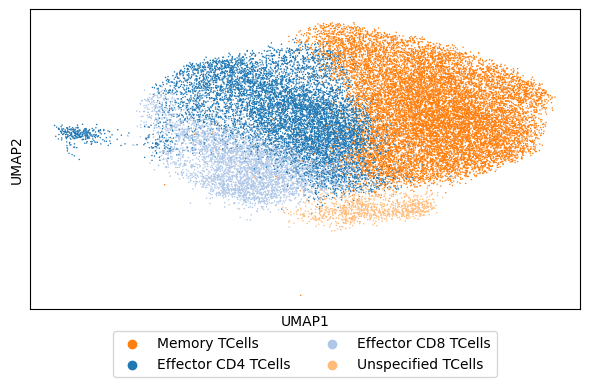

In [60]:
import matplotlib.pyplot as plt
import scanpy as sc


# Define desired order
legend_order = ["Memory TCells", "Effector CD4 TCells", "Effector CD8 TCells", "Unspecified TCells"]

# Plot UMAP without saving yet
sc.pl.umap(
    adata_TCell_i,
    color='gen_cell_type_reannotated',
    title='',  # No title for publication version
    frameon=True,
    palette=plt.get_cmap('tab20').colors,
    legend_loc='lower right',
    legend_fontsize=10,
    legend_fontoutline=1,
    show=False  # Important: allow to edit figure after plotting
)

# Adjust figure
fig = plt.gcf()
fig.set_size_inches(6, 4)

# Get legend and reorder
ax = plt.gca()
handles, labels = ax.get_legend_handles_labels()

# Build a new legend with desired order
order = [labels.index(l) for l in legend_order if l in labels]
ordered_handles = [handles[i] for i in order]
ordered_labels = [labels[i] for i in order]

# Remove old legend
ax.get_legend().remove()

# Add new ordered legend
ax.legend(ordered_handles, ordered_labels,
          loc='lower center',
          bbox_to_anchor=(0.5, -0.25),  # Centered below, negative y pushes down
          fontsize=10,
          frameon=True,
          ncol=2)  # vertical layout

plt.tight_layout()

# Save manually
plt.savefig("Intermediate_Files/Clustering_05012025/Figures/UMAP/UMAP_0.1_log_autoZI_isoform_subcelltypes_TCellOnly.pdf",
            dpi=600, transparent=True, bbox_inches="tight")

plt.show()

In [ ]:
import matplotlib.pyplot as plt
import scanpy as sc


# Define desired order
legend_order = ["Memory TCells", "Effector CD4 TCells", "Effector CD8 TCells", "Unspecified TCells", "NK Cells", "BCells", "Monocyte-derived", "Megakaryocytes"]

# Plot UMAP without saving yet
sc.pl.umap(
    adata_i_filtered,
    color='gen_cell_type_reannotated',
    title='',  # No title for publication version
    frameon=True,
    palette=plt.get_cmap('tab20').colors,
    legend_loc='lower right',
    legend_fontsize=10,
    legend_fontoutline=1,
    show=False  # Important: allow to edit figure after plotting
)

# Adjust figure
fig = plt.gcf()
fig.set_size_inches(6, 4)

# Get legend and reorder
ax = plt.gca()
handles, labels = ax.get_legend_handles_labels()

# Build a new legend with desired order
order = [labels.index(l) for l in legend_order if l in labels]
ordered_handles = [handles[i] for i in order]
ordered_labels = [labels[i] for i in order]

# Remove old legend
ax.get_legend().remove()

# Add new ordered legend
ax.legend(ordered_handles, ordered_labels,
          loc='lower center',
          bbox_to_anchor=(0.5, -0.25),  # Centered below, negative y pushes down
          fontsize=10,
          frameon=True,
          ncol=3)  # vertical layout

plt.tight_layout()

# Save manually
plt.savefig("Intermediate_Files/Clustering_05012025/Figures/UMAP/UMAP_0.1_log_autoZI_isoform_subcelltypes.pdf",
            dpi=600, transparent=True, bbox_inches="tight")

plt.show()

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load GTF cleanly
gtf_file = "Homo_sapiens.GRCh38.113.gtf"

gtf = pd.read_csv(
    gtf_file, 
    sep="\t", 
    comment="#", 
    header=None, 
    names=["chrom", "source", "feature", "start", "end", "score", "strand", "frame", "attribute"],
    dtype=str
)

# Parse attributes
gtf["transcript_id"] = gtf["attribute"].str.extract('transcript_id "([^"]+)"')
gtf["gene_id"] = gtf["attribute"].str.extract('gene_id "([^"]+)"')
gtf["gene_name"] = gtf["attribute"].str.extract('gene_name "([^"]+)"')

# Build mapping transcript_id -> gene_name (or gene_id fallback)
gtf_mapping = gtf.drop_duplicates("transcript_id").set_index("transcript_id")["gene_name"].fillna(gtf["gene_id"])

# Build isoform dataframe
isoform_df = pd.DataFrame(adata_i_filtered.var.index)
isoform_df.columns = ["transcript_id"]

# Determine new isoforms
isoform_df["is_new_isoform"] = isoform_df["transcript_id"].str.contains("BambuTx")

# Add gene names
isoform_df["gene_name"] = isoform_df["transcript_id"].map(gtf_mapping)

# Make clean names
isoform_df["clean_name"] = np.where(
    isoform_df["gene_name"].notnull(),
    isoform_df["gene_name"] + ":" + isoform_df["transcript_id"],
    isoform_df["transcript_id"]
)

# Only new isoforms
new_isoform_df = isoform_df[isoform_df["is_new_isoform"]].copy()

# Get integer index for new isoforms (important fix!)
new_isoform_indices = new_isoform_df.index.to_numpy()

# Extract expression
X = adata_i_filtered.X
if hasattr(X, "toarray"):
    X = X.toarray()

In [4]:
# Subset expression
new_isoform_expr = X[:, new_isoform_indices]

# Build dataframe with correct names (FIXED)
df = pd.DataFrame(new_isoform_expr, 
                  columns=new_isoform_df["clean_name"].values, 
                  index=adata_i_filtered.obs_names)

# Add cell type
df["cell_type"] = adata_i_filtered.obs["gen_cell_type_reannotated"].values

In [5]:
# Melt
df_long = df.melt(id_vars="cell_type", var_name="isoform", value_name="expression")
df_long["expressed"] = df_long["expression"] > 0

# Calculate % of cells expressing
summary = df_long.groupby(["cell_type", "isoform"])["expressed"].mean().unstack(fill_value=0) * 100

# Sort isoforms alphabetically
summary = summary[sorted(summary.columns)]

/tmp/ipykernel_1089799/2803979613.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_long.groupby(["cell_type", "isoform"])["expressed"].mean().unstack(fill_value=0) * 100


In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# --- (same up to df_long and summary) ---

# Classify isoforms based on transcript ID
new_isoform_df["is_novel_gene"] = new_isoform_df["transcript_id"].str.startswith("Bambu")

# Add classification to melted dataframe
df_long["is_novel_gene"] = df_long["isoform"].map(
    new_isoform_df.set_index("clean_name")["is_novel_gene"]
)

# Add clean_name mapping
df_long["clean_name"] = df_long["isoform"]

# Split data
df_known = df_long[df_long["is_novel_gene"] == False]  # ENSG → known gene
df_novel = df_long[df_long["is_novel_gene"] == True]   # Bambu → novel gene

/tmp/ipykernel_3696852/1844551869.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expressed"].mean().unstack(fill_value=0) * 100


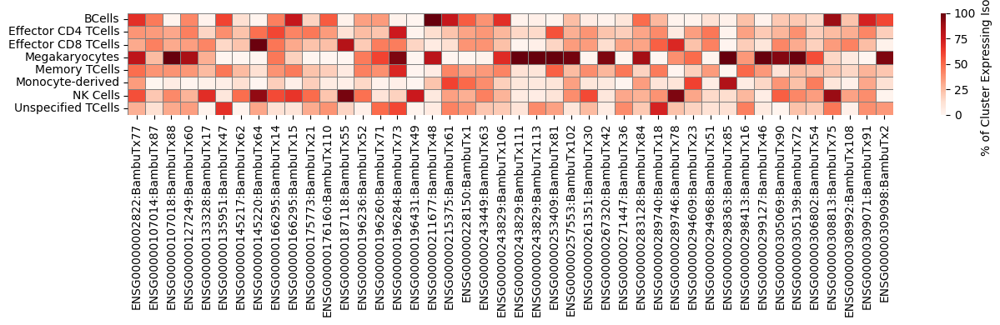

/tmp/ipykernel_3696852/1844551869.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expressed"].mean().unstack(fill_value=0) * 100


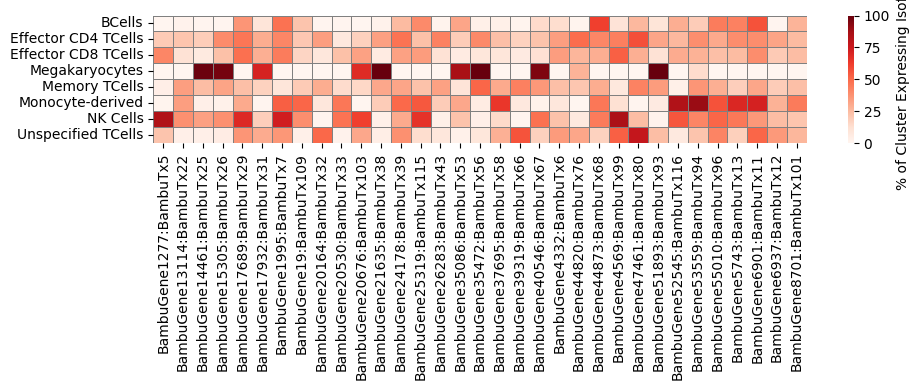

In [ ]:
# Function to make heatmap sorted by clean_name
def plot_heatmap(df_subset, filename):
    summary = df_subset.groupby(["cell_type", "clean_name"])["expressed"].mean().unstack(fill_value=0) * 100

    # Sort isoforms alphabetically by clean_name
    summary = summary[sorted(summary.columns)]

    plt.figure(figsize=(len(summary.columns) * 0.3, 4))
    ax = sns.heatmap(summary, cmap="Reds", linewidths=0.5, linecolor='gray',
                cbar_kws={"label": "% of Cluster Expressing Isoform"}, square=False, 
               yticklabels=True)
    # Fix ytick labels rotation and alignment (this is what makes them show properly)
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right', fontsize=10)

    plt.xlabel("")
    plt.ylabel("")
    plt.xticks(rotation=90)
    plt.tight_layout()

    plt.savefig(filename, dpi=600, transparent=True, bbox_inches="tight")
    plt.show()

# Plot known genes isoforms
plot_heatmap(df_known, 
             "Intermediate_Files/Paper_Figs/new_isoform_known_subcelltype_heatmap.pdf")

# Plot novel genes isoforms
plot_heatmap(df_novel, 
             "Intermediate_Files/Paper_Figs/new_isoform_novel_subcelltype_heatmap.pdf")

/tmp/ipykernel_3696852/431683484.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)


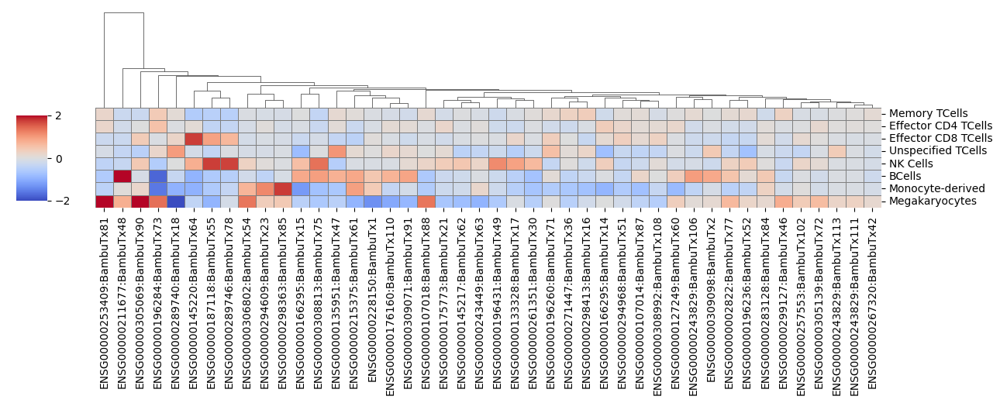

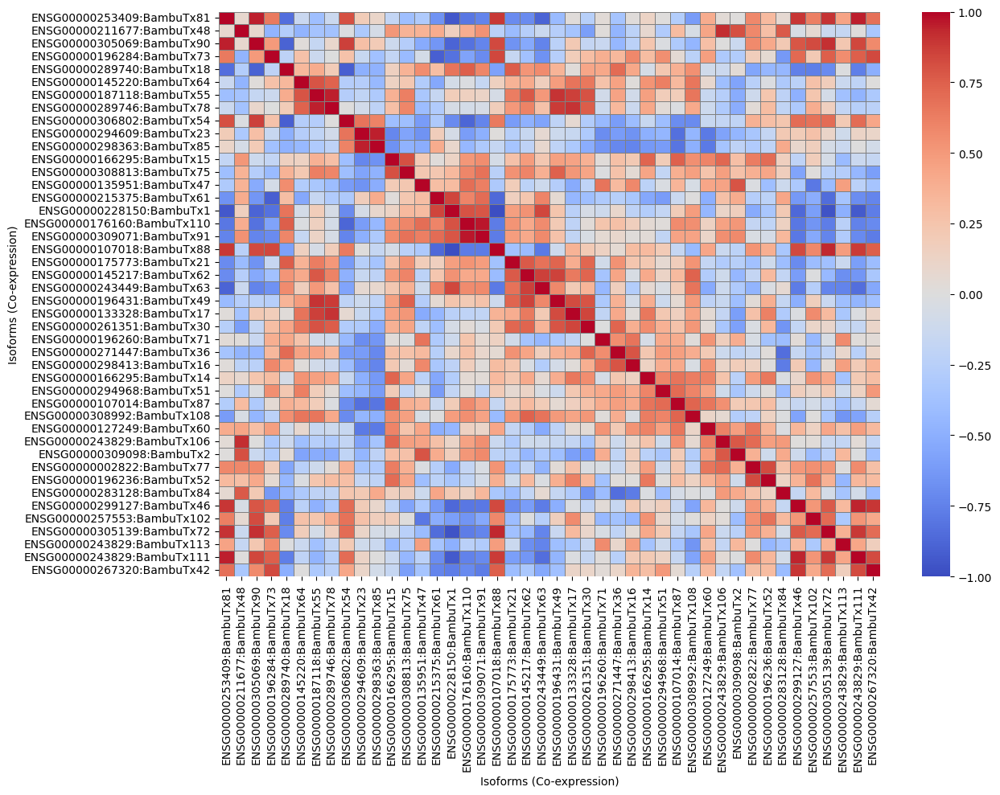

/tmp/ipykernel_3696852/431683484.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)


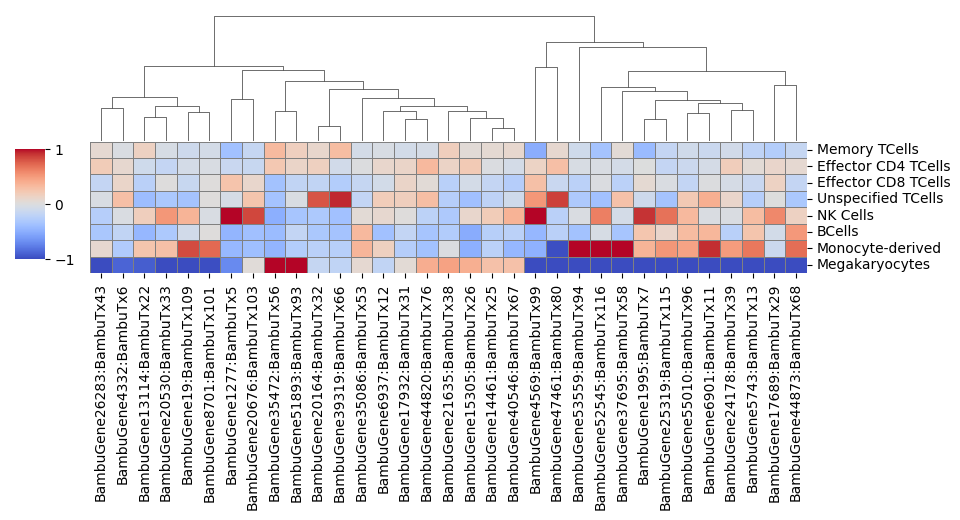

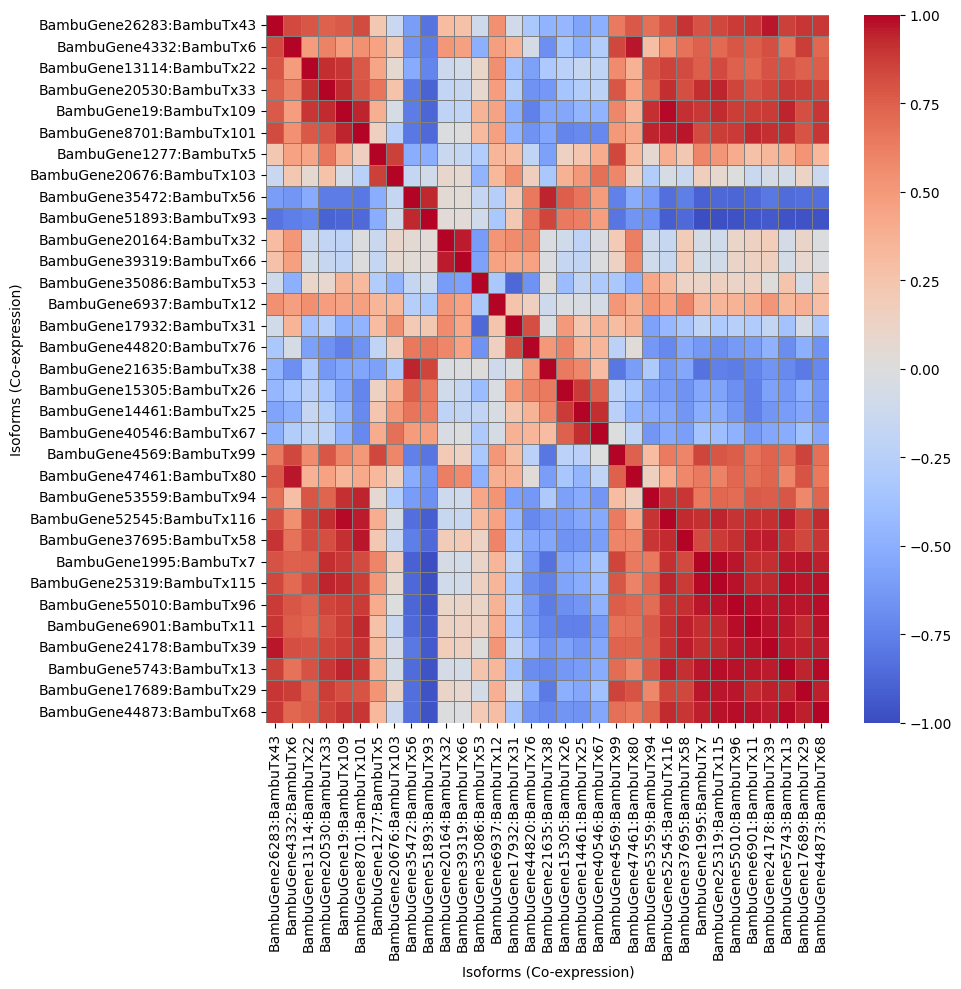

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_clustermap_with_coexpression(df_subset, filename, vmax):
    # Prepare summary matrix
    # Custom cell type order
    celltype_order = [
        "Memory TCells", "Effector CD4 TCells", "Effector CD8 TCells", "Unspecified TCells",
        "NK Cells", "BCells", "Monocyte-derived", "Megakaryocytes"
    ]

    summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)
    summary = summary.reindex(index=celltype_order)  # apply custom order
    summary = summary[sorted(summary.columns)]       # still sort isoforms alphabetically
    summary = summary[sorted(summary.columns)]

    # --- Clustermap (this time DO NOT skip the plot, because we WANT dendrogram)
    g = sns.clustermap(summary, cmap="coolwarm",
                       linewidths=0.5, linecolor='gray',
                       vmin=-vmax, vmax=vmax, center=0,
                       figsize=(len(summary.columns) * 0.3, 5.5),
                       row_cluster=False, col_cluster=True,
                       cbar_kws={"label": ""},
                       dendrogram_ratio=(0.1, 0.5),
                       cbar_pos=(0.02, 0.52, 0.03, 0.2))

    # Fix x and y labels
    g.ax_heatmap.set_xlabel("")
    g.ax_heatmap.set_ylabel("", labelpad=20)
    g.ax_heatmap.yaxis.set_label_position("left")  # Ensure it is on left (not top)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=90)
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0, ha='right', va = 'center', fontsize=10)

    # After clustermap and after setting labels:

    # Pull yticklabels
    yticklabels = g.ax_heatmap.get_yticklabels()

    # Loop through and manually shift them down slightly
    for label in yticklabels:
        label.set_rotation(0)       # no rotation
        label.set_horizontalalignment('left')
    
    # Shift downward (this fixes the "too high / inside heatmap" issue)
        pos = label.get_position()
        label.set_position((pos[0], pos[1] - 0.3))  # adjust -0.3 → more negative = lower

    # Optional (but recommended) to make sure they render cleanly
    g.ax_heatmap.figure.canvas.draw()

    # --- Now make Isoform Co-expression heatmap separately
    isoform_order = [summary.columns[i] for i in g.dendrogram_col.reordered_ind]
    summary_reordered = summary[isoform_order]
    isoform_corr = summary_reordered.corr()

    # Plot Co-expression
    plt.figure(figsize=(len(summary.columns) * 0.3, 10))
    sns.heatmap(isoform_corr, cmap="coolwarm", linewidths=0.5, linecolor='gray',
                vmin=-1, vmax=1, center=0,
                xticklabels=True, yticklabels=True)

    plt.xlabel("Isoforms (Co-expression)")
    plt.ylabel("Isoforms (Co-expression)")
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()

    # Save both
    g.savefig(filename.replace(".pdf", "_dendrogram.pdf"), dpi=600, transparent=True, bbox_inches="tight")
    plt.savefig(filename.replace(".pdf", "_coexpression.pdf"), dpi=600, transparent=True, bbox_inches="tight")

    plt.show()

# Plot known genes isoforms with co-expression
plot_clustermap_with_coexpression(df_known, 
                "Intermediate_Files/Paper_Figs/new_isoform_known_subcelltype_heatmap_clustered_coexpression.pdf",
                vmax=2)

# Plot novel genes isoforms with co-expression
plot_clustermap_with_coexpression(df_novel, 
                "Intermediate_Files/Paper_Figs/new_isoform_novel_subcelltype_heatmap_clustered_coexpression.pdf",
                vmax=1)

/tmp/ipykernel_1089799/3826495665.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)


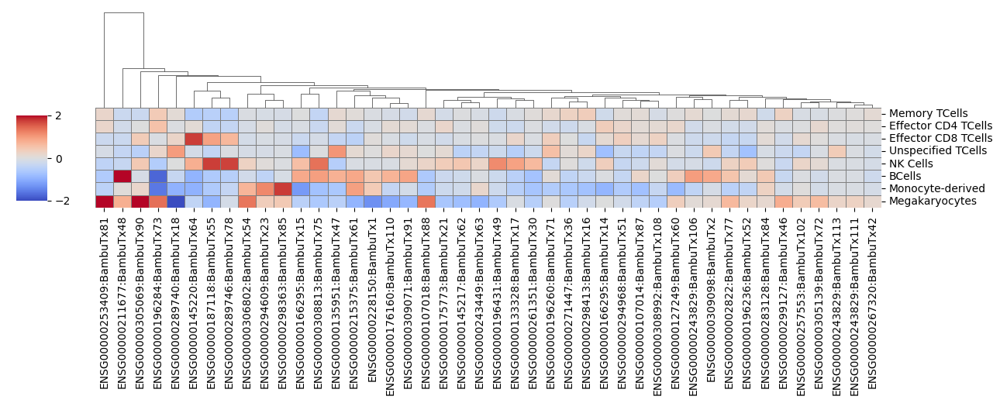

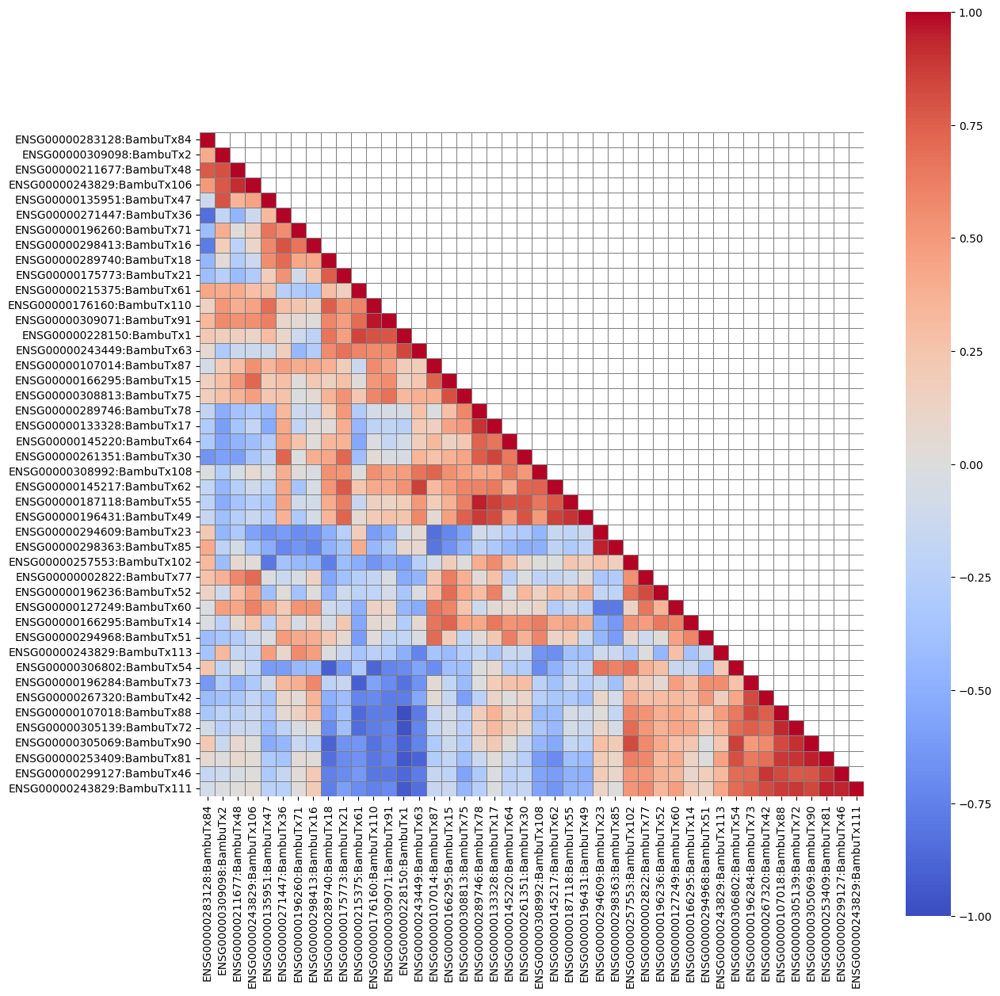

/tmp/ipykernel_1089799/3826495665.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)


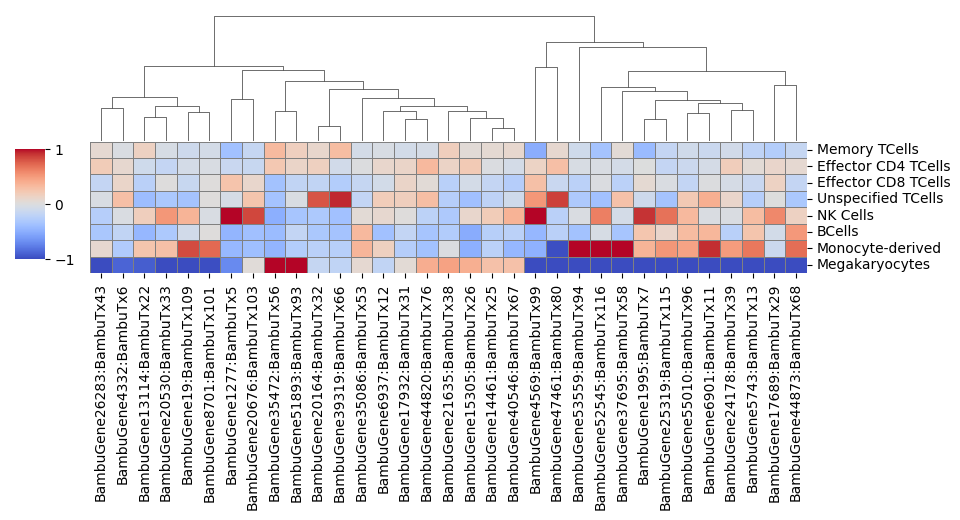

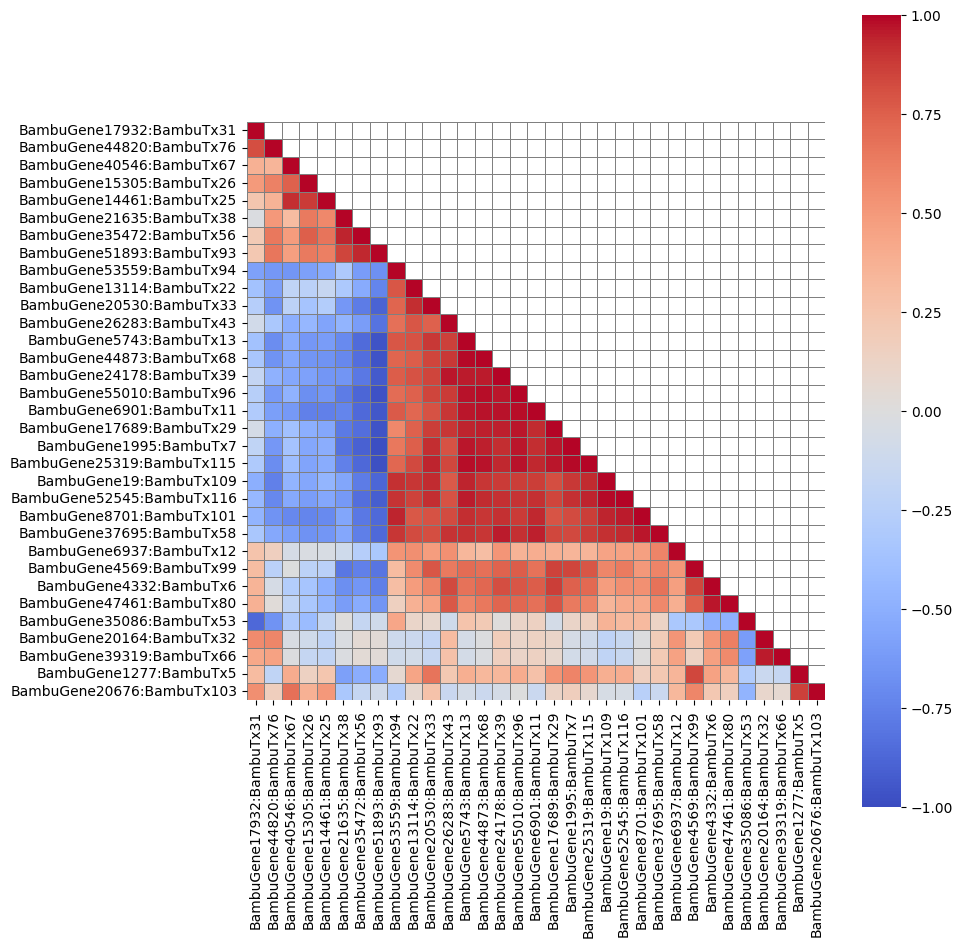

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, leaves_list

def plot_clustermap_with_coexpression(df_subset, filename, vmax):
    # Step 1: Prepare mean expression matrix
    summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)
    summary = summary[sorted(summary.columns)]
    
    # Step 1.5: Reorder rows (cell types) to custom order
    cell_type_order = [
        "Memory TCells",
        "Effector CD4 TCells",
        "Effector CD8 TCells",
        "Unspecified TCells",
        "NK Cells",
        "BCells",
        "Monocyte-derived",
        "Megakaryocytes"
    ]

    summary = summary.reindex(cell_type_order)

    # Step 2: Expression clustermap
    g = sns.clustermap(summary, cmap="coolwarm",
                       linewidths=0.5, linecolor='gray',
                       vmin=-vmax, vmax=vmax, center=0,
                       figsize=(len(summary.columns) * 0.3, 5.5),
                       row_cluster=False, col_cluster=True,
                       cbar_kws={"label": ""},
                       dendrogram_ratio=(0.1, 0.5),
                       cbar_pos=(0.02, 0.52, 0.03, 0.2))

    g.ax_heatmap.set_xlabel("")
    g.ax_heatmap.set_ylabel("", labelpad=20)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=90)
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0, ha='right', va='center', fontsize=10)

    for label in g.ax_heatmap.get_yticklabels():
        label.set_horizontalalignment('left')
        pos = label.get_position()
        label.set_position((pos[0], pos[1] - 0.3))

    g.ax_heatmap.figure.canvas.draw()

    # Step 3: Correlation matrix
    summary_reordered = summary[[summary.columns[i] for i in g.dendrogram_col.reordered_ind]]
    corr = summary_reordered.corr()

    # Step 4: Cluster the correlation matrix manually
    d = pdist(corr)
    linkage_matrix = linkage(d, method='average')
    idx = leaves_list(linkage_matrix)
    corr = corr.iloc[idx, :].iloc[:, idx]

    # Step 5: Apply mask for upper triangle (excluding diagonal)
    mask = np.triu(np.ones_like(corr, dtype=bool), k=1)
    
    # Set masked values to NaN to fully crop out upper triangle
    corr_masked = corr.copy()
    corr_masked[mask] = np.nan
    
    # Step 6: Plot lower triangle heatmap
    figsize = len(corr.columns) * 0.3
    plt.figure(figsize=(figsize, figsize))
    
    sns.heatmap(
        corr_masked,
        cmap="coolwarm",
        linewidths=0.5,
        linecolor="gray",
        vmin=-1,
        vmax=1,
        center=0,
        xticklabels=True,
        yticklabels=True,
        square=True
    )
    
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.title("")
    plt.xlabel("")
    plt.ylabel("")
    plt.tight_layout()

    # Save both figures
    g.savefig(filename.replace(".pdf", "_dendrogram.pdf"), dpi=600, transparent=True, bbox_inches="tight")
    plt.savefig(filename.replace(".pdf", "_coexpression.pdf"), dpi=600, transparent=True, bbox_inches="tight")
    plt.show()
    
plot_clustermap_with_coexpression(df_known, 
    "Intermediate_Files/Clustering_05012025/Figures/Bambu_Genes/Summary_Plots/new_isoform_known_subcelltype_heatmap_clustered_coexpression.pdf",
    vmax=2)

plot_clustermap_with_coexpression(df_novel, 
    "Intermediate_Files/Clustering_05012025/Figures/Bambu_Genes/Summary_Plots/new_isoform_novel_subcelltype_heatmap_clustered_coexpression.pdf",
    vmax=1)

/tmp/ipykernel_3742185/593474514.py:15: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  expr_by_celltype = expr_df.groupby(expr_df.index).mean().T
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


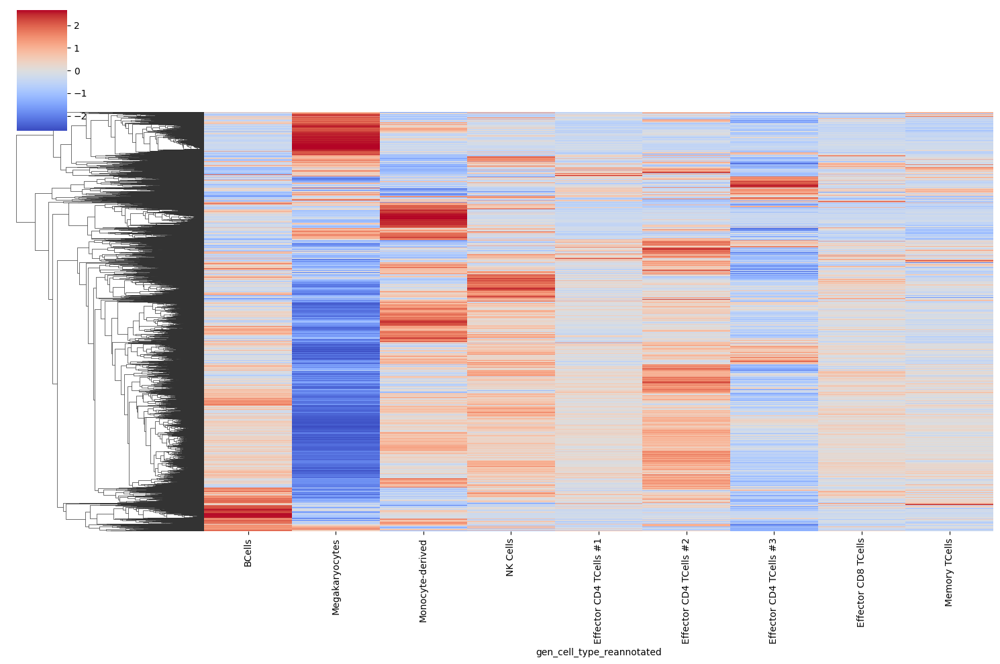

In [11]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from scipy.spatial.distance import pdist, squareform

# Get expression matrix (genes x cell types)
X = adata_g_filtered.X.toarray() if hasattr(adata_g_filtered.X, "toarray") else adata_g_filtered.X
expr_df = pd.DataFrame(X, 
                       columns=adata_g_filtered.var_names,
                       index=adata_g_filtered.obs["gen_cell_type_reannotated"])

# Collapse to mean per cell type (genes x cell types)
expr_by_celltype = expr_df.groupby(expr_df.index).mean().T

# Z-score genes across cell types (column-wise)
row_means = expr_by_celltype.mean(axis=1).to_numpy().reshape(-1, 1)
row_stds = expr_by_celltype.std(axis=1).to_numpy().reshape(-1, 1)
z_expr = (expr_by_celltype - row_means) / row_stds
z_expr = z_expr.fillna(0)
z_expr = z_expr.fillna(0)

# Compute pairwise distances and cluster
from scipy.spatial.distance import pdist, squareform
from sklearn.cluster import AgglomerativeClustering

dist = pdist(z_expr, metric='correlation')
dist_matrix = squareform(dist)

clustering = AgglomerativeClustering(n_clusters=10, metric='precomputed', linkage='average')
cluster_labels = clustering.fit_predict(dist_matrix)

# Store in DataFrame
clustered_genes = pd.DataFrame({
    "Gene": z_expr.index,
    "Cluster": cluster_labels
})
clustered_genes.to_csv("Intermediate_Files/novel_bambu_cluster_labels.csv", index=False)

# Optional: Heatmap
sns.clustermap(z_expr, cmap="coolwarm", xticklabels=True, yticklabels=False, figsize=(15, 10),
               row_cluster=True, col_cluster=False)
plt.savefig("Intermediate_Files/Paper_Figs/Novel_Bambu_Gene_Clustering_Heatmap.pdf", dpi=600, bbox_inches="tight")
plt.show()

In [54]:
bambu_genes_present = [g for g in z_expr.index if g.startswith("BambuGene")]
print(f"✅ Found {len(bambu_genes_present)} Bambu genes in gene expression matrix.")

✅ Found 38 Bambu genes in gene expression matrix.


In [24]:
import pandas as pd
from mygene import MyGeneInfo
from goatools.obo_parser import GODag
from goatools.associations import read_gaf
from goatools.go_enrichment import GOEnrichmentStudy

# Step 1: Load gene cluster assignments
clustered = pd.read_csv("Intermediate_Files/novel_bambu_cluster_labels.csv")

# Extract Ensembl gene IDs
clustered["ENSG"] = clustered["Gene"].str.extract(r"(ENSG\d+)", expand=False)

# Map Ensembl to UniProt IDs using mygene
mg = MyGeneInfo()
ensembl_ids = clustered["ENSG"].dropna().unique().tolist()
print(f"🔎 Mapping {len(ensembl_ids)} Ensembl IDs to UniProt...")

query = mg.querymany(ensembl_ids, scopes="ensembl.gene", fields="uniprot.Swiss-Prot", species="human", as_dataframe=True)
query = query[~query.index.duplicated(keep='first')]
# Ensure every mapped value is a string (take first if it's a list)
def extract_first(x):
    if isinstance(x, list):
        return x[0]
    return x

ensembl_to_uniprot = query["uniprot.Swiss-Prot"].dropna().map(extract_first).to_dict()

# Add UniProt IDs to cluster table
clustered["UniProt"] = clustered["ENSG"].map(ensembl_to_uniprot)

# Step 2: Load GO annotation files
obodag = GODag("go-basic.obo")
geneid2gos = read_gaf("goa_human.gaf", namespace="BP")  # Biological Process
background_genes = set(geneid2gos.keys())

# Step 3: Identify clusters that contain Bambu genes
clusters_with_bambu = clustered[clustered["Gene"].str.startswith("BambuGene")]["Cluster"].unique()

results = []

for c in clusters_with_bambu:
    cluster_genes = clustered[clustered["Cluster"] == c]
    known_genes = cluster_genes[cluster_genes["Gene"].str.contains("ENSG")]["UniProt"].dropna().tolist()
    study_genes = [g for g in known_genes if g in geneid2gos]

    print(f"🔍 Cluster {c} → {len(known_genes)} known genes → {len(study_genes)} with GO terms")

    if len(study_genes) < 5:
        continue

    goea = GOEnrichmentStudy(
        background_genes, geneid2gos, obodag,
        methods=["fdr_bh"], alpha=0.05, sig_class=None
    )

    results_c = goea.run_study(study_genes)

    # Filter significant terms with FDR < 0.05
    significant = [r for r in results_c if r.p_fdr_bh < 0.05]

    # Sort by enrichment score (or FDR) and keep top 30
    top_terms = sorted(significant, key=lambda x: x.p_fdr_bh)[:30]

    for r in top_terms:
        results.append({
            "Cluster": c,
            "GO ID": r.GO,
            "Term": r.name,
            "P-Value": r.p_uncorrected,
            "FDR": r.p_fdr_bh,
            "Enrichment": r.enrichment,
            "Genes": ";".join(r.study_items)
        })

# Step 4: Save results
if results:
    df = pd.DataFrame(results)
    df.to_csv("Intermediate_Files/Bambu_GOATOOLS_Enrichment.tsv", sep="\t", index=False)
    print(f"✅ Enrichment written with {len(df)} rows.")
else:
    print("⚠️ No enrichment results passed filtering.")

Input sequence provided is already in string format. No operation performed
Input sequence provided is already in string format. No operation performed


🔎 Mapping 19873 Ensembl IDs to UniProt...


11 input query terms found dup hits:	[('ENSG00000215156', 2), ('ENSG00000234162', 2), ('ENSG00000268595', 2), ('ENSG00000275405', 4), ('E
1 input query terms found no hit:	['ENSG00000189144']


go-basic.obo: fmt(1.2) rel(2025-03-16) 43,544 Terms
HMS:0:00:20.551961 969,176 annotations READ: goa_human.gaf 
36411 IDs in loaded association branch, BP
🔍 Cluster 1 → 9666 known genes → 8863 with GO terms

Load  Ontology Enrichment Analysis ...
Propagating term counts up: is_a
100% 36,411 of 36,411 population items found in association

Runing  Ontology Analysis: current study set of 8863 IDs.
100%  8,846 of  8,846 study items found in association
100%  8,846 of  8,863 study items found in population(36411)
Calculating 14,716 uncorrected p-values using fisher_scipy_stats
  14,716 terms are associated with 36,411 of 36,411 population items
  12,560 terms are associated with  8,846 of  8,846 study items
  METHOD fdr_bh:
   4,877 GO terms found significant (< 0.05=alpha) (4827 enriched +  50 purified): statsmodels fdr_bh
   8,846 study items associated with significant GO IDs (enriched)
   3,691 study items associated with significant GO IDs (purified)
🔍 Cluster 4 → 149 known genes → 13

In [25]:
import pandas as pd

# Load data
clusters = pd.read_csv("Intermediate_Files/novel_bambu_cluster_labels.csv")
go_terms = pd.read_csv("Intermediate_Files/Bambu_GOATOOLS_Enrichment.tsv", sep="\t")

# Filter for Bambu genes
bambu_genes = clusters[clusters["Gene"].str.startswith("BambuGene")]

# Merge to assign GO terms by cluster
merged = bambu_genes.merge(go_terms, how="left", left_on="Cluster", right_on="Cluster")

# Save long-format
long_df = merged[["Gene", "Cluster", "GO ID", "Term", "FDR", "Enrichment", "Genes"]]
long_df.to_csv("Intermediate_Files/Bambu_Predicted_Functions_Long.tsv", sep="\t", index=False)

# Build summary per gene
summary_df = long_df.groupby("Gene").agg({
    "Cluster": "first",
    "GO ID": lambda x: "; ".join(x.dropna().unique()),
    "Term": lambda x: "; ".join(x.dropna().unique()),
    "FDR": lambda x: "; ".join(map(lambda v: f"{v:.3g}", x.dropna())),
}).reset_index()

summary_df.to_csv("Intermediate_Files/Bambu_Predicted_Functions_Summary.tsv", sep="\t", index=False)

print("✅ Functional predictions saved:")
print("  • Long format: Bambu_Predicted_Functions_Long.tsv")
print("  • Summary per gene: Bambu_Predicted_Functions_Summary.tsv")

✅ Functional predictions saved:
  • Long format: Bambu_Predicted_Functions_Long.tsv
  • Summary per gene: Bambu_Predicted_Functions_Summary.tsv


/tmp/ipykernel_3742185/903068854.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=term_counts.head(15), y="GO Term", x="Count", palette="viridis")


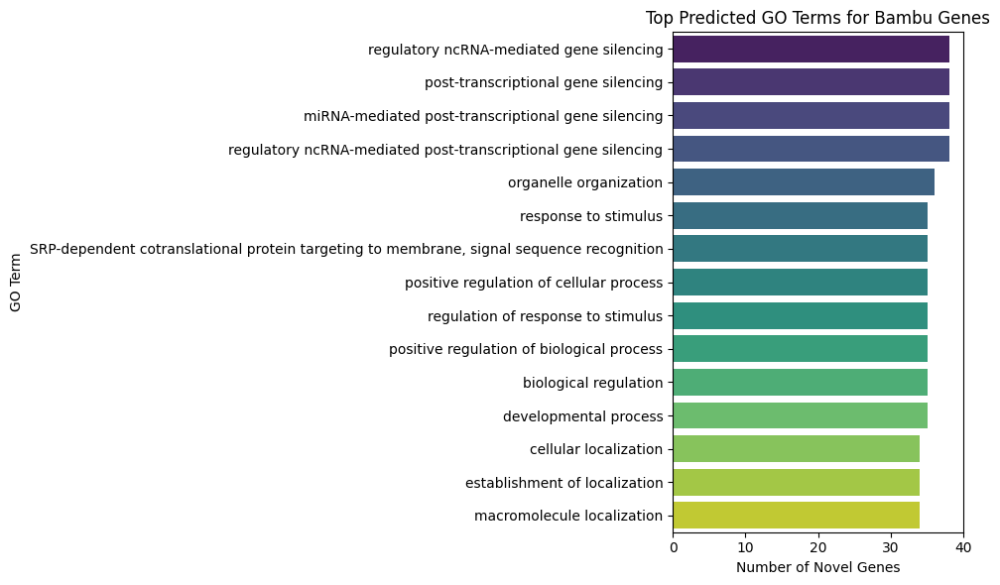

In [27]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load long-format predictions
df = pd.read_csv("Intermediate_Files/Bambu_Predicted_Functions_Long.tsv", sep="\t")

# Count how often each GO term is predicted
term_counts = df[["Gene", "Term"]].drop_duplicates()
term_counts = term_counts["Term"].value_counts().reset_index()
term_counts.columns = ["GO Term", "Count"]

# Plot top 20 terms
plt.figure(figsize=(10, 6))
sns.barplot(data=term_counts.head(15), y="GO Term", x="Count", palette="viridis")
plt.title("Top Predicted GO Terms for Bambu Genes")
plt.xlabel("Number of Novel Genes")
plt.ylabel("GO Term")
plt.xlim(0, 40)  # adjust dynamically or set manually
plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/Bambu_GO_Barplot.pdf", dpi=600)
plt.show()

In [88]:
df = pd.read_csv("Intermediate_Files/Bambu_Predicted_Functions_Long.tsv", sep="\t")
print(df.groupby("Term")["Gene"].nunique().sort_values(ascending=False).head(10))

Term
miRNA-mediated post-transcriptional gene silencing                                          38
post-transcriptional gene silencing                                                         38
regulatory ncRNA-mediated post-transcriptional gene silencing                               38
regulatory ncRNA-mediated gene silencing                                                    38
organelle organization                                                                      36
response to stimulus                                                                        35
developmental process                                                                       35
SRP-dependent cotranslational protein targeting to membrane, signal sequence recognition    35
regulation of response to stimulus                                                          35
biological regulation                                                                       35
Name: Gene, dtype: int64


In [89]:
gene_term_counts = df.groupby("Gene")["Term"].nunique()
print(gene_term_counts.describe())

count    38.000000
mean     29.421053
std       3.568871
min       8.000000
25%      30.000000
50%      30.000000
75%      30.000000
max      30.000000
Name: Term, dtype: float64


In [90]:
df = pd.read_csv("Intermediate_Files/Bambu_Predicted_Functions_Long.tsv", sep="\t")
print("🔍 Unique clusters among Bambu genes:", df["Cluster"].nunique())
print("🔍 GO terms per Bambu gene (top 5):") 
print(df.groupby("Gene")["Term"].nunique().sort_values(ascending=False).head())

🔍 Unique clusters among Bambu genes: 6
🔍 GO terms per Bambu gene (top 5):
Gene
BambuGene1145     30
BambuGene1277     30
BambuGene13114    30
BambuGene13851    30
BambuGene14461    30
Name: Term, dtype: int64


In [11]:
import pandas as pd
from goatools.obo_parser import GODag
from goatools.associations import read_gaf
from goatools.go_enrichment import GOEnrichmentStudy
from mygene import MyGeneInfo

# Step 1: Load your clustered gene table
clustered = pd.read_csv("Intermediate_Files/novel_bambu_cluster_labels.csv")

# Step 2: Define your target genes
target_genes = [
    "TRBV7-4", "IGLC2", "ENSG00000305069", "SUPT3H", "TALAM1", "LYAR", "CMC1", "TARP",
    "ENSG00000306802", "ENSG00000294609", "ANAPC16", "ENSG00000308813", "TSGA10", "MYL5",
    "lnc-NMNAT1-1", "HSF5", "ENSG00000309071", "RLN1", "ZBTB44", "SLC26A1", "C4orf48", "CRYBA4",
    "PLAAT2", "lnc-SNAPC5-1", "SFTA2", "MMP28", "ENSG00000298413", "ENSG00000294968", "RLN2",
    "ENSG00000308992", "ATP13A4", "RPS9P4", "ENSG00000309098", "MAD1L", "XPNPEP3", "RARRES2P11",
    "ENSG00000299127", "lnc-SMARCC2-2", "ENSG00000305139", "lnc-UQCRFS1"
]

# Step 3: Extract matching rows from clustered file
clustered["GeneName"] = clustered["Gene"].str.split(":").str[0]
targets_df = clustered[clustered["GeneName"].isin(target_genes)]

# Step 4: Map ENSG → UniProt
mg = MyGeneInfo()
ensg_ids = clustered["Gene"].str.extract(r"(ENSG\d+)", expand=False).dropna().unique().tolist()
query = mg.querymany(ensg_ids, scopes="ensembl.gene", fields="uniprot.Swiss-Prot", species="human", as_dataframe=True)
query = query[~query.index.duplicated(keep='first')]
ensg_to_uniprot = query["uniprot.Swiss-Prot"].dropna().map(lambda x: x[0] if isinstance(x, list) else x).to_dict()
clustered["ENSG"] = clustered["Gene"].str.extract(r"(ENSG\d+)", expand=False)
clustered["UniProt"] = clustered["ENSG"].map(ensg_to_uniprot)

# Step 5: Load GO annotations
obodag = GODag("go-basic.obo")
geneid2gos = read_gaf("goa_human.gaf", namespace="BP")
background_genes = set(geneid2gos.keys())

# Step 6: Run GO enrichment per gene's cluster
results = []

for gene in target_genes:
    gene_row = targets_df[targets_df["GeneName"] == gene]
    if gene_row.empty:
        continue
    cluster_id = gene_row["Cluster"].values[0]
    cluster_genes = clustered[clustered["Cluster"] == cluster_id]

    known_uniprot = cluster_genes[cluster_genes["Gene"].str.contains("ENSG")]["UniProt"].dropna().tolist()
    known_uniprot = [g for g in known_uniprot if g in geneid2gos]

    if len(known_uniprot) < 5:
        continue

    goea = GOEnrichmentStudy(background_genes, geneid2gos, obodag, methods=["fdr_bh"], alpha=0.05)
    enriched = [r for r in goea.run_study(known_uniprot) if r.p_fdr_bh < 0.05]

    for r in sorted(enriched, key=lambda x: x.p_fdr_bh)[:20]:
        results.append({
            "Gene": gene,
            "Cluster": cluster_id,
            "GO ID": r.GO,
            "Term": r.name,
            "FDR": r.p_fdr_bh,
            "Enrichment": r.enrichment,
            "Genes": ";".join(r.study_items)
        })

# Step 7: Save results
df = pd.DataFrame(results)
df.to_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_GO_Enrichment.tsv", sep="\t", index=False)
print("✅ GO enrichment complete for gene-level targets.")

Input sequence provided is already in string format. No operation performed
Input sequence provided is already in string format. No operation performed
11 input query terms found dup hits:	[('ENSG00000215156', 2), ('ENSG00000234162', 2), ('ENSG00000268595', 2), ('ENSG00000275405', 4), ('E
1 input query terms found no hit:	['ENSG00000189144']


go-basic.obo: fmt(1.2) rel(2025-03-16) 43,544 Terms
HMS:0:00:19.326530 969,176 annotations READ: goa_human.gaf 
36411 IDs in loaded association branch, BP

Load  Ontology Enrichment Analysis ...
Propagating term counts up: is_a
100% 36,411 of 36,411 population items found in association

Runing  Ontology Analysis: current study set of 1847 IDs.
100%  1,833 of  1,833 study items found in association
 99%  1,833 of  1,847 study items found in population(36411)
Calculating 14,716 uncorrected p-values using fisher_scipy_stats
  14,716 terms are associated with 36,411 of 36,411 population items
   8,144 terms are associated with  1,833 of  1,833 study items
  METHOD fdr_bh:
   2,073 GO terms found significant (< 0.05=alpha) (2036 enriched +  37 purified): statsmodels fdr_bh
   1,833 study items associated with significant GO IDs (enriched)
     883 study items associated with significant GO IDs (purified)

Load  Ontology Enrichment Analysis ...
Propagating term counts up: is_a
100% 36,411 o

In [12]:
import pandas as pd

# Load results from your gene-level GO enrichment
enriched = pd.read_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_GO_Enrichment.tsv", sep="\t")

# Save long format directly
long_df = enriched[["Gene", "Cluster", "GO ID", "Term", "FDR", "Enrichment", "Genes"]]
long_df.to_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_PredictedFunctions_Long.tsv", sep="\t", index=False)

# Build summary per gene
summary_df = long_df.groupby("Gene").agg({
    "Cluster": "first",
    "GO ID": lambda x: "; ".join(x.dropna().unique()),
    "Term": lambda x: "; ".join(x.dropna().unique()),
    "FDR": lambda x: "; ".join(map(lambda v: f"{v:.3g}", x.dropna())),
}).reset_index()

summary_df.to_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_PredictedFunctions_Summary.tsv", sep="\t", index=False)

print("✅ Functional predictions saved for target genes:")
print("  • Long format: Bambu_GeneswithNovelTranscripts_PredictedFunctions_Long.tsv")
print("  • Summary:     Bambu_GeneswithNovelTranscripts_PredictedFunctions_Summary.tsv")

✅ Functional predictions saved for target genes:
  • Long format: Bambu_GeneswithNovelTranscripts_PredictedFunctions_Long.tsv
  • Summary:     Bambu_GeneswithNovelTranscripts_PredictedFunctions_Summary.tsv


/tmp/ipykernel_3790678/844359962.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=term_counts.head(15), y="GO Term", x="Count", palette="magma")


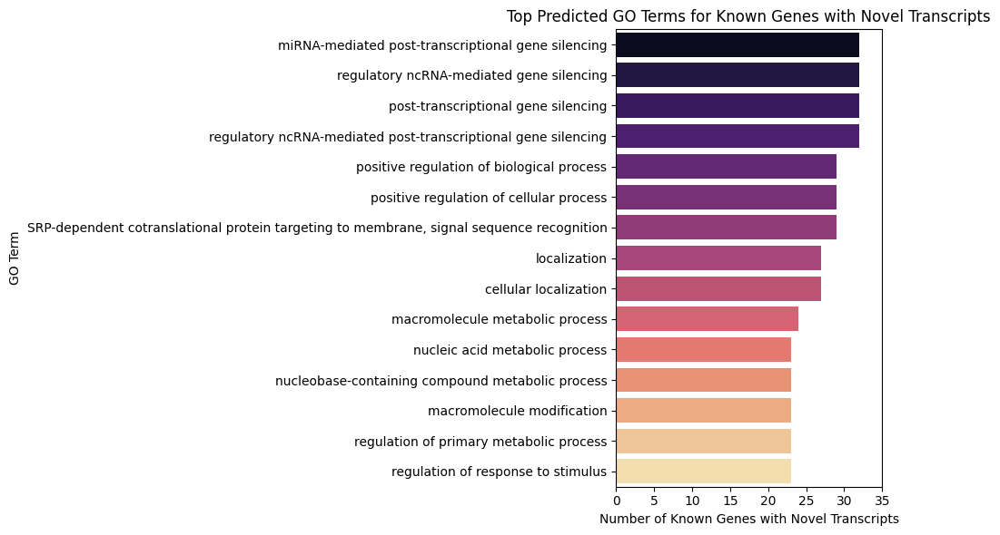

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

# Load long-format predictions
df = pd.read_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_PredictedFunctions_Long.tsv", sep="\t")


# Count how often each GO term is predicted
term_counts = df[["Gene", "Term"]].drop_duplicates()
term_counts = term_counts["Term"].value_counts().reset_index()
term_counts.columns = ["GO Term", "Count"]

# Plot top 15 terms
plt.figure(figsize=(10, 6))
sns.barplot(data=term_counts.head(15), y="GO Term", x="Count", palette="magma")
plt.title("Top Predicted GO Terms for Known Genes with Novel Transcripts")
plt.xlabel("Number of Known Genes with Novel Transcripts")
plt.ylabel("GO Term")
plt.xlim(0,35)  # adjust if needed
plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/Bambu_GeneswithNovelTranscripts_GO_Barplot.pdf", dpi=600)
plt.show()

In [10]:
df = pd.read_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_PredictedFunctions_Long.tsv", sep="\t")
print(df.groupby("Term")["Gene"].nunique().sort_values(ascending=False).head(10))

Term
regulatory ncRNA-mediated gene silencing                                                    32
miRNA-mediated post-transcriptional gene silencing                                          32
regulatory ncRNA-mediated post-transcriptional gene silencing                               32
post-transcriptional gene silencing                                                         32
positive regulation of cellular process                                                     29
SRP-dependent cotranslational protein targeting to membrane, signal sequence recognition    29
positive regulation of biological process                                                   29
localization                                                                                27
cellular localization                                                                       27
macromolecule metabolic process                                                             24
Name: Gene, dtype: int64


In [15]:
df = pd.read_csv("Intermediate_Files/Bambu_GeneswithNovelTranscripts_GO_Enrichment.tsv", sep="\t")
print(df["Cluster"].nunique())

5


In [16]:
print("Unique GO terms:", df["Term"].nunique())

Unique GO terms: 66


In [ ]:
### NOW I want to perform GO enrichment on the isoform level

In [36]:
# ========== Step 0: Parse GTF and identify pseudogenes ==========
gtf_file = "Homo_sapiens.GRCh38.113.gtf"  # Update this as needed

transcript_biotype_dict = {}

with open(gtf_file, 'r') as f:
    for line in f:
        if line.startswith("#"):
            continue
        fields = line.strip().split('\t')
        if fields[2] != "transcript":
            continue
        attr_field = fields[8]
        attr_dict = {}
        for attr in attr_field.strip().split(';'):
            if attr.strip():
                key, value = attr.strip().split(' ', 1)
                attr_dict[key] = value.strip('"')
        transcript_id = attr_dict.get("transcript_id")
        biotype = attr_dict.get("transcript_biotype")
        if transcript_id and biotype:
            transcript_biotype_dict[transcript_id] = biotype

# Convert to DataFrame
transcript_biotype_df = pd.DataFrame(list(transcript_biotype_dict.items()), columns=['transcript_id', 'biotype'])

# Identify pseudogenes
pseudogenes = set(
    transcript_biotype_df.loc[
        transcript_biotype_df['biotype'].str.contains("pseudogene", na=False, case=False),
        'transcript_id'
    ]
)
print(f"Identified {len(pseudogenes)} pseudogenes.")

Identified 15209 pseudogenes.


In [4]:
import pandas as pd
import numpy as np
import requests
from tqdm import tqdm
import re
import seaborn as sns
import matplotlib.pyplot as plt

# ================================
# Step 1: Expression matrix (genes x cell types)
# ================================
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
expr_df = pd.DataFrame(
    X,
    columns=adata_i_filtered.var_names,
    index=adata_i_filtered.obs["gen_cell_type_reannotated"]
)

# ================================
# Step 2: Average expression per gene per cell type
# ================================
expr_avg = expr_df.groupby(expr_df.index, observed=False).mean().T  # genes x cell types

# ================================
# Step 3: Z-score by gene across cell types
# ================================
z_expr = expr_avg.sub(expr_avg.mean(axis=1), axis=0).div(expr_avg.std(axis=1), axis=0).fillna(0)

# ================================
# Step 4: Select top N genes per cell type
# ================================
top_n = 200
cell_types = expr_avg.columns

# Function to extract gene symbol from label
def extract_symbol(label):
    symbol = label.split(":")[0]
    return symbol if re.match(r"^[A-Z][A-Z0-9\-]*$", symbol) else None

# ================================
# g:Profiler API wrapper
# ================================
def query_gprofiler(gene_list):
    url = "https://biit.cs.ut.ee/gprofiler/api/gost/profile/"
    headers = {"Content-Type": "application/json"}
    payload = {
        "organism": "hsapiens",
        "query": gene_list,
        "sources": ["GO:BP", "GO:MF", "GO:CC", "KEGG", "REAC"],
        "user_threshold": 0.05,
        "significance_threshold_method": "fdr"
    }
    try:
        response = requests.post(url, headers=headers, json=payload)
        response.raise_for_status()
        return response.json().get("result", [])
    except Exception as e:
        print(f"⚠️ g:Profiler failed: {e}")
        return []

# ================================
# Step 5: Enrichment by cell type
# ================================
results = []

for cell_type in tqdm(cell_types, desc="Enriching pathways by cell type"):
    ranked_genes = expr_avg[cell_type].sort_values(ascending=False).index
    top_genes = [
        extract_symbol(g)
        for g in ranked_genes[:top_n]
        if extract_symbol(g)
    ]
    if not top_genes:
        print(f"⚠️ Skipping {cell_type}: no valid top genes.")
        continue

    enriched = query_gprofiler(top_genes)
    for e in enriched:
        results.append({
            "Cell_Type": cell_type,
            "Source": e["source"],
            "Term": e["name"],
            "P-value": e["p_value"],
            "FDR": e.get("p_value_fdr", e.get("p_value")),
            "Genes": ",".join(e.get("intersection", [])) if "intersection" in e else ""
        })

# ================================
# Step 6: Save results
# ================================
df_results = pd.DataFrame(results)
output_file = "Intermediate_Files/CellType_Pathway_Enrichment_gProfiler.tsv"
df_results.to_csv(output_file, sep="\t", index=False)
print(f"✅ Analysis complete! Results saved to {output_file}")

Enriching pathways by cell type: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:11<00:00,  1.40s/it]

✅ Analysis complete! Results saved to Intermediate_Files/CellType_Pathway_Enrichment_gProfiler.tsv


/tmp/ipykernel_3152855/3905734897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_summary["Source"] = df_summary["Source"].replace({"REAC": "Reactome", "GO:BP": "GO"})


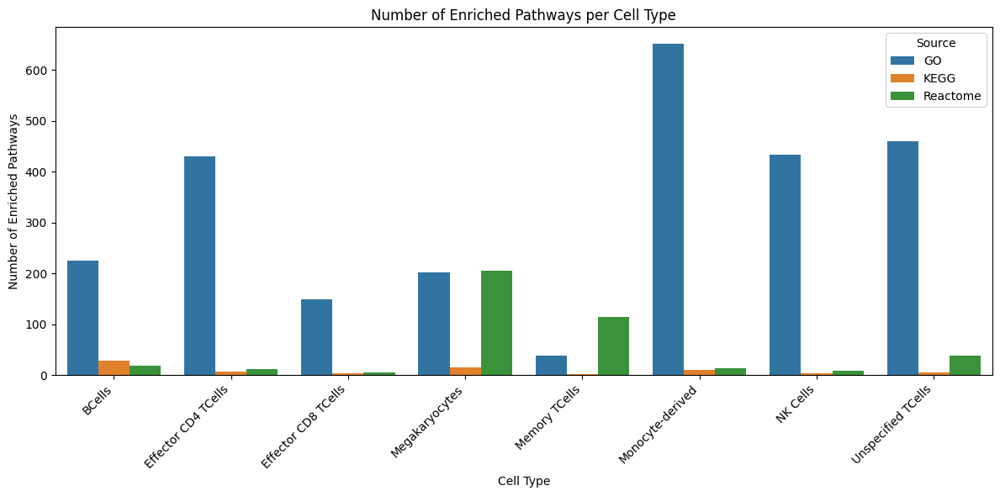

In [5]:
# ================================
# Step 7: Summary Bar Plot
# ================================
df_summary = df_results[df_results["Source"].isin(["REAC", "KEGG", "GO:BP"])]
df_summary["Source"] = df_summary["Source"].replace({"REAC": "Reactome", "GO:BP": "GO"})

summary_counts = (
    df_summary.groupby(["Cell_Type", "Source"])
    .size()
    .reset_index(name="Count")
)

plt.figure(figsize=(12, 6))
sns.barplot(data=summary_counts, x="Cell_Type", y="Count", hue="Source")
plt.title("Number of Enriched Pathways per Cell Type")
plt.xlabel("Cell Type")
plt.ylabel("Number of Enriched Pathways")
plt.xticks(rotation=45, ha='right')
plt.legend(title="Source")
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/enriched_pathways_per_cell_type.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()


🔎 Cell Type: BCells
  - immune response (GO:BP, FDR=1.58e-19)
  - leukocyte activation (GO:BP, FDR=1.58e-19)
  - lymphocyte activation (GO:BP, FDR=1.58e-19)
  - B cell activation (GO:BP, FDR=3.49e-18)
  - immune system process (GO:BP, FDR=5.63e-18)
  - Hematopoietic cell lineage (KEGG, FDR=8.25e-17)
  - MHC class II protein complex (GO:CC, FDR=5.94e-15)
  - MHC protein complex (GO:CC, FDR=1.55e-13)
  - MHC class II protein complex binding (GO:MF, FDR=5.42e-13)
  - Asthma (KEGG, FDR=5.72e-13)
  - Intestinal immune network for IgA production (KEGG, FDR=8.71e-13)
  - Allograft rejection (KEGG, FDR=3.11e-12)
  - cell surface (GO:CC, FDR=7.48e-12)
  - MHC protein complex binding (GO:MF, FDR=7.70e-12)
  - Antigen processing and presentation (KEGG, FDR=6.46e-11)
  - side of membrane (GO:CC, FDR=2.05e-10)
  - antigen binding (GO:MF, FDR=4.34e-10)
  - plasma membrane (GO:CC, FDR=3.78e-09)
  - Adaptive Immune System (REAC, FDR=4.36e-08)
  - Antigen activates B Cell Receptor (BCR) leading to gen

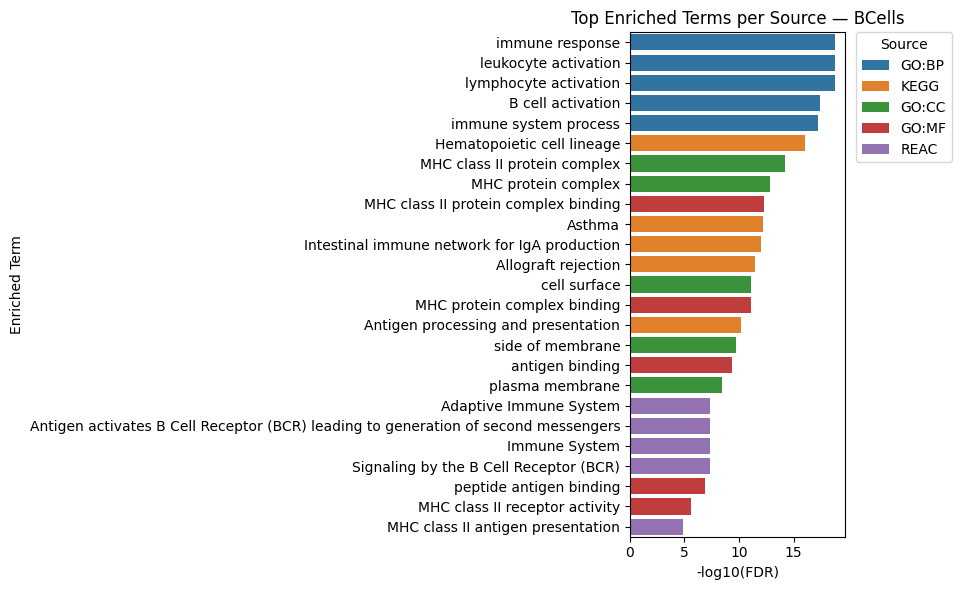


🔎 Cell Type: Effector CD4 TCells
  - cell activation (GO:BP, FDR=6.29e-12)
  - leukocyte activation (GO:BP, FDR=6.29e-12)
  - regulation of immune system process (GO:BP, FDR=8.85e-12)
  - lymphocyte activation (GO:BP, FDR=9.08e-12)
  - immune response (GO:BP, FDR=1.05e-11)
  - cell periphery (GO:CC, FDR=6.11e-08)
  - side of membrane (GO:CC, FDR=1.47e-07)
  - plasma membrane (GO:CC, FDR=1.47e-07)
  - external side of plasma membrane (GO:CC, FDR=6.62e-07)
  - membrane (GO:CC, FDR=4.58e-06)
  - protein binding (GO:MF, FDR=1.24e-05)
  - Cytokine Signaling in Immune system (REAC, FDR=3.52e-05)
  - Cytokine-cytokine receptor interaction (KEGG, FDR=6.78e-05)
  - Interleukin-4 and Interleukin-13 signaling (REAC, FDR=2.57e-04)
  - tumor necrosis factor receptor binding (GO:MF, FDR=2.76e-04)
  - chemokine binding (GO:MF, FDR=2.76e-04)
  - kinase binding (GO:MF, FDR=2.76e-04)
  - Immune System (REAC, FDR=3.44e-04)
  - Signaling by Interleukins (REAC, FDR=6.26e-04)
  - tumor necrosis factor rece

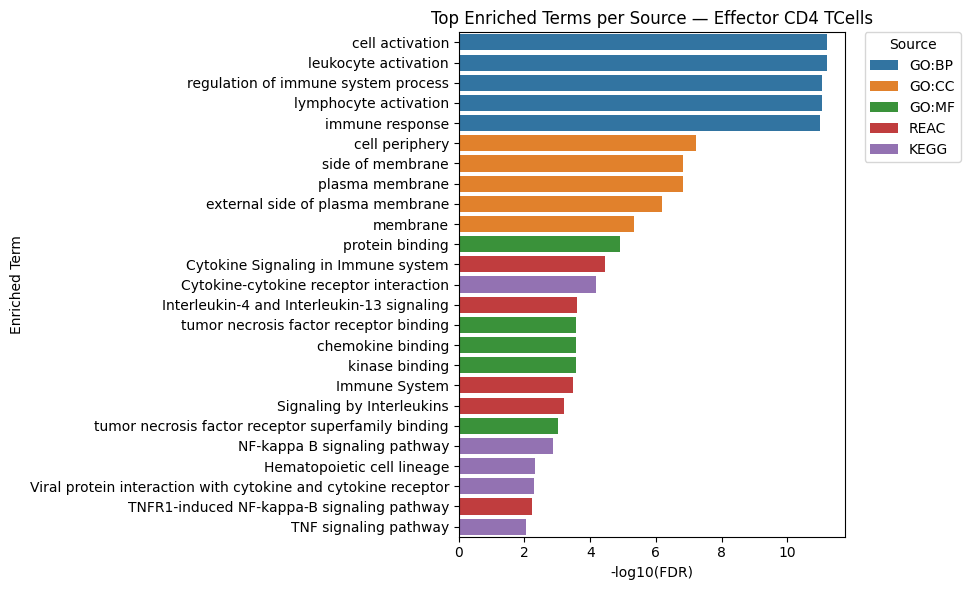


🔎 Cell Type: Effector CD8 TCells
  - cell killing (GO:BP, FDR=1.34e-08)
  - immune response (GO:BP, FDR=1.34e-07)
  - immune system process (GO:BP, FDR=1.84e-07)
  - defense response (GO:BP, FDR=4.39e-07)
  - regulation of immune system process (GO:BP, FDR=6.56e-07)
  - Immunoregulatory interactions between a Lymphoid and a non-Lymphoid cell (REAC, FDR=6.72e-04)
  - external side of plasma membrane (GO:CC, FDR=1.39e-03)
  - lysosome (GO:CC, FDR=2.15e-03)
  - vacuole (GO:CC, FDR=2.15e-03)
  - endoplasmic reticulum protein-containing complex (GO:CC, FDR=2.15e-03)
  - lytic vacuole (GO:CC, FDR=2.15e-03)
  - Immune System (REAC, FDR=3.31e-03)
  - chemokine binding (GO:MF, FDR=8.71e-03)
  - identical protein binding (GO:MF, FDR=8.71e-03)
  - molecular function inhibitor activity (GO:MF, FDR=1.13e-02)
  - G protein-coupled chemoattractant receptor activity (GO:MF, FDR=1.83e-02)
  - protein homodimerization activity (GO:MF, FDR=1.83e-02)
  - SUMOylation of intracellular receptors (REAC, FDR=

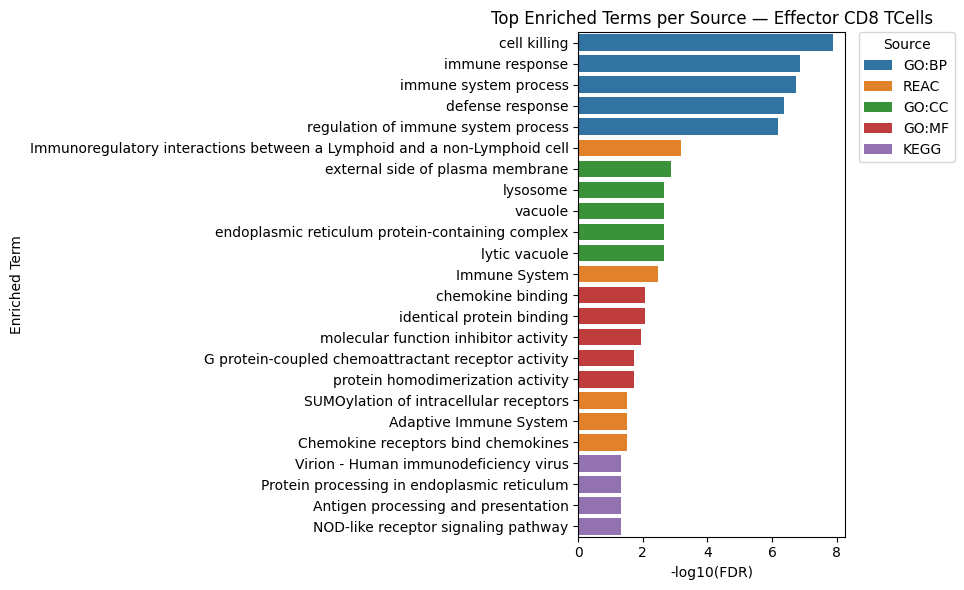


🔎 Cell Type: Megakaryocytes
  - Hemostasis (REAC, FDR=1.16e-17)
  - Platelet activation, signaling and aggregation (REAC, FDR=6.81e-16)
  - platelet alpha granule (GO:CC, FDR=3.33e-14)
  - blood coagulation (GO:BP, FDR=4.88e-13)
  - hemostasis (GO:BP, FDR=4.88e-13)
  - coagulation (GO:BP, FDR=4.88e-13)
  - platelet activation (GO:BP, FDR=4.89e-13)
  - Platelet degranulation  (REAC, FDR=8.16e-12)
  - Response to elevated platelet cytosolic Ca2+ (REAC, FDR=1.10e-11)
  - wound healing (GO:BP, FDR=8.54e-11)
  - RUNX1 regulates genes involved in megakaryocyte differentiation and platelet function (REAC, FDR=9.78e-10)
  - vesicle (GO:CC, FDR=1.23e-09)
  - supramolecular fiber (GO:CC, FDR=1.11e-08)
  - supramolecular polymer (GO:CC, FDR=1.11e-08)
  - platelet alpha granule membrane (GO:CC, FDR=2.33e-08)
  - protein binding (GO:MF, FDR=6.98e-06)
  - structural molecule activity (GO:MF, FDR=6.98e-06)
  - Motor proteins (KEGG, FDR=3.25e-04)
  - Focal adhesion (KEGG, FDR=3.25e-04)
  - Platelet a

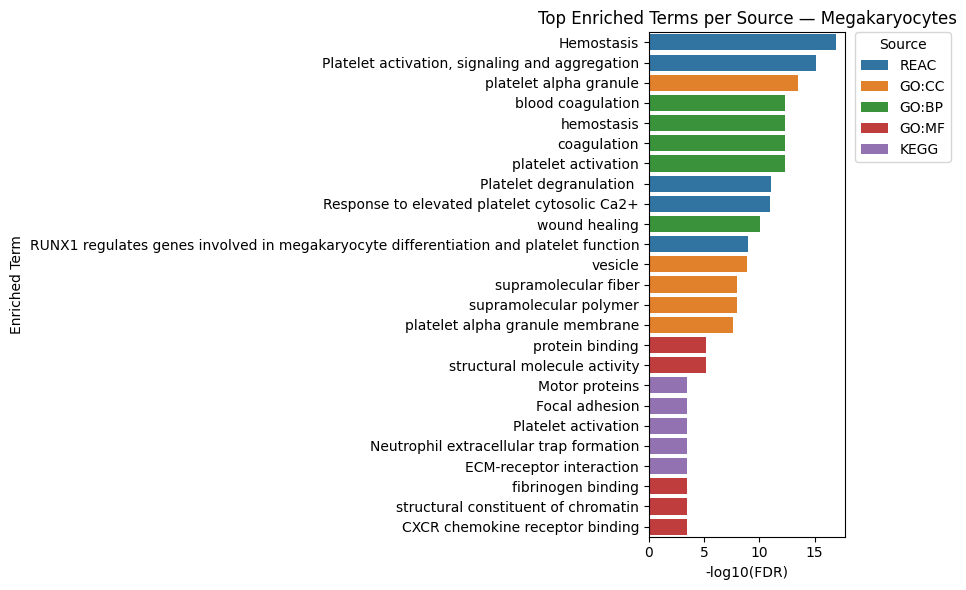


🔎 Cell Type: Memory TCells
  - Eukaryotic Translation Elongation (REAC, FDR=7.93e-110)
  - Viral mRNA Translation (REAC, FDR=1.94e-106)
  - Peptide chain elongation (REAC, FDR=1.94e-106)
  - Eukaryotic Translation Termination (REAC, FDR=5.97e-105)
  - Selenocysteine synthesis (REAC, FDR=5.97e-105)
  - cytosolic ribosome (GO:CC, FDR=4.01e-104)
  - ribosomal subunit (GO:CC, FDR=6.18e-91)
  - cytoplasmic translation (GO:BP, FDR=1.74e-89)
  - Ribosome (KEGG, FDR=1.66e-86)
  - Coronavirus disease - COVID-19 (KEGG, FDR=1.70e-74)
  - structural constituent of ribosome (GO:MF, FDR=3.07e-65)
  - ribosome (GO:CC, FDR=1.36e-62)
  - translation (GO:BP, FDR=6.65e-60)
  - cytosolic large ribosomal subunit (GO:CC, FDR=5.35e-58)
  - cytosolic small ribosomal subunit (GO:CC, FDR=3.21e-50)
  - structural molecule activity (GO:MF, FDR=1.19e-46)
  - RNA binding (GO:MF, FDR=6.51e-24)
  - ribosome biogenesis (GO:BP, FDR=2.60e-23)
  - ribosomal small subunit biogenesis (GO:BP, FDR=2.60e-23)
  - rRNA binding

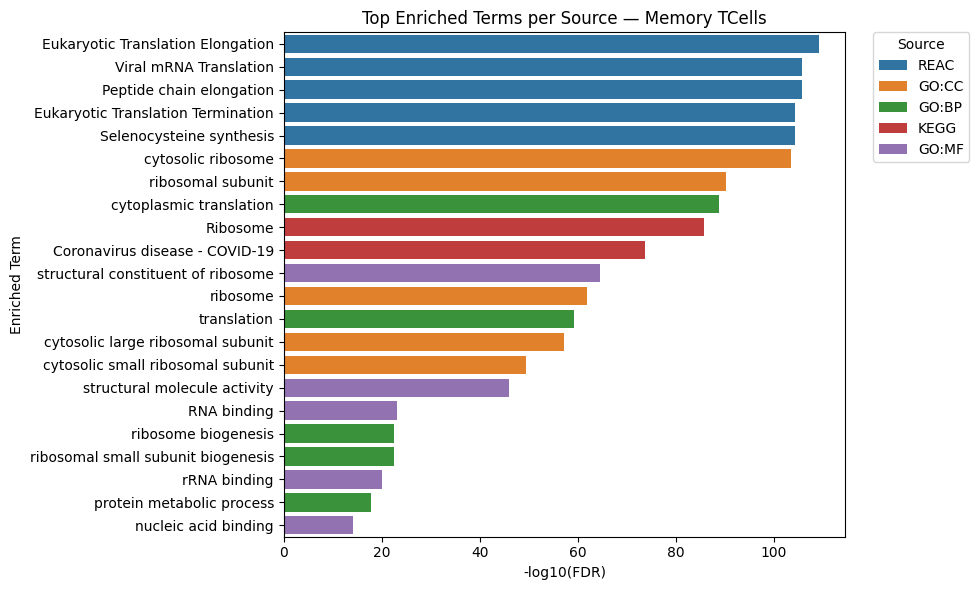


🔎 Cell Type: Monocyte-derived
  - secretory granule (GO:CC, FDR=3.71e-23)
  - secretory vesicle (GO:CC, FDR=2.41e-21)
  - Neutrophil degranulation (REAC, FDR=8.34e-21)
  - cytoplasmic vesicle (GO:CC, FDR=1.66e-18)
  - intracellular vesicle (GO:CC, FDR=1.66e-18)
  - vesicle (GO:CC, FDR=2.04e-18)
  - Innate Immune System (REAC, FDR=5.70e-18)
  - Immune System (REAC, FDR=3.29e-17)
  - immune system process (GO:BP, FDR=2.37e-15)
  - immune response (GO:BP, FDR=6.09e-15)
  - defense response (GO:BP, FDR=5.76e-14)
  - regulation of immune system process (GO:BP, FDR=4.56e-13)
  - regulation of immune response (GO:BP, FDR=1.40e-11)
  - Trafficking and processing of endosomal TLR (REAC, FDR=1.94e-05)
  - Osteoclast differentiation (KEGG, FDR=7.21e-05)
  - Lysosome (KEGG, FDR=7.21e-05)
  - molecular transducer activity (GO:MF, FDR=3.64e-04)
  - signaling receptor activity (GO:MF, FDR=3.64e-04)
  - Adaptive Immune System (REAC, FDR=3.90e-04)
  - pattern recognition receptor activity (GO:MF, FDR=

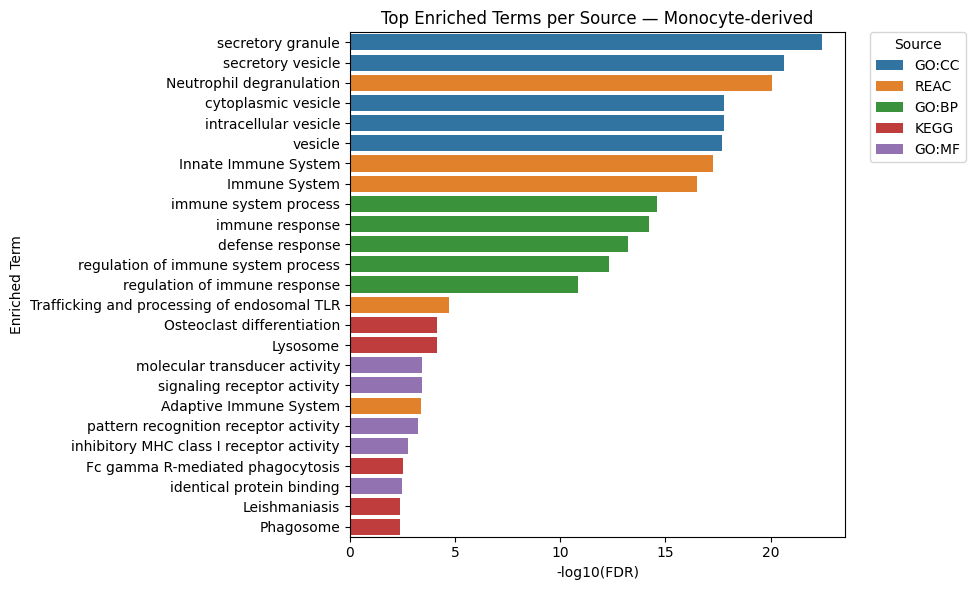


🔎 Cell Type: NK Cells
  - leukocyte activation (GO:BP, FDR=2.19e-14)
  - immune system process (GO:BP, FDR=8.21e-14)
  - cell activation (GO:BP, FDR=8.21e-14)
  - immune response (GO:BP, FDR=8.21e-14)
  - leukocyte mediated immunity (GO:BP, FDR=1.68e-13)
  - Natural killer cell mediated cytotoxicity (KEGG, FDR=6.03e-12)
  - side of membrane (GO:CC, FDR=3.92e-07)
  - external side of plasma membrane (GO:CC, FDR=1.17e-06)
  - cell surface (GO:CC, FDR=6.50e-06)
  - secretory granule membrane (GO:CC, FDR=1.93e-05)
  - plasma membrane (GO:CC, FDR=1.93e-05)
  - Immune System (REAC, FDR=2.25e-05)
  - Immunoregulatory interactions between a Lymphoid and a non-Lymphoid cell (REAC, FDR=1.01e-04)
  - immune receptor activity (GO:MF, FDR=1.93e-04)
  - Graft-versus-host disease (KEGG, FDR=9.03e-04)
  - MHC class Ib receptor activity (GO:MF, FDR=1.25e-03)
  - MHC class I protein complex binding (GO:MF, FDR=1.45e-03)
  - signaling receptor activity (GO:MF, FDR=2.25e-03)
  - molecular transducer acti

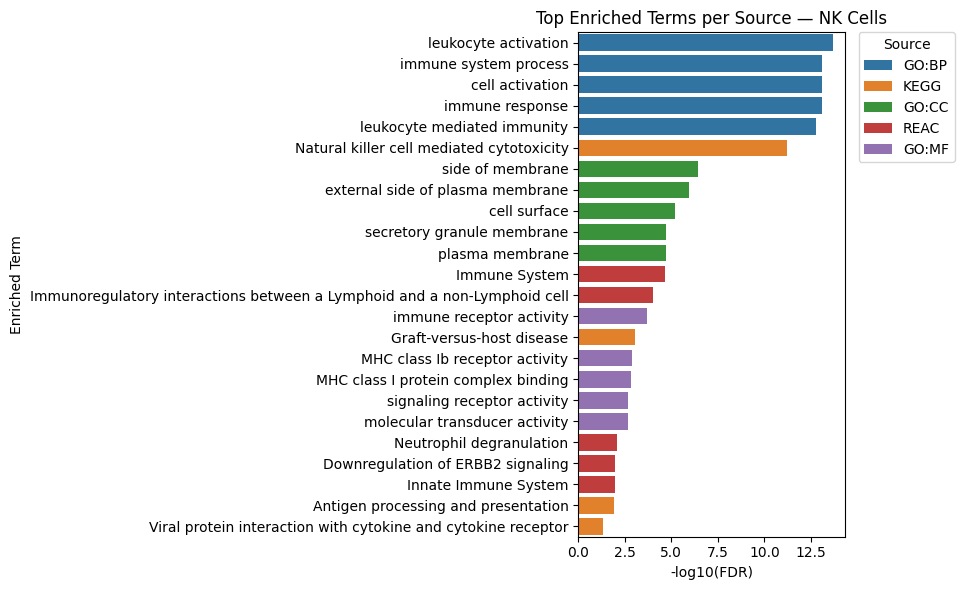


🔎 Cell Type: Unspecified TCells
  - cytosol (GO:CC, FDR=1.62e-17)
  - nucleoplasm (GO:CC, FDR=4.38e-13)
  - cytoplasm (GO:CC, FDR=4.18e-12)
  - organelle lumen (GO:CC, FDR=3.45e-11)
  - nuclear lumen (GO:CC, FDR=3.45e-11)
  - regulation of RNA splicing (GO:BP, FDR=2.68e-08)
  - regulation of mRNA splicing, via spliceosome (GO:BP, FDR=3.23e-08)
  - positive regulation of cellular process (GO:BP, FDR=7.30e-08)
  - regulation of mRNA processing (GO:BP, FDR=1.40e-07)
  - protein binding (GO:MF, FDR=1.47e-07)
  - positive regulation of biological process (GO:BP, FDR=4.71e-07)
  - protein-containing complex binding (GO:MF, FDR=8.09e-06)
  - molecular adaptor activity (GO:MF, FDR=9.28e-06)
  - Processing of Capped Intron-Containing Pre-mRNA (REAC, FDR=2.39e-05)
  - Metabolism of RNA (REAC, FDR=2.39e-05)
  - protein-macromolecule adaptor activity (GO:MF, FDR=2.91e-05)
  - mRNA Splicing - Major Pathway (REAC, FDR=6.03e-05)
  - mRNA Splicing (REAC, FDR=6.87e-05)
  - T cell receptor binding (GO:

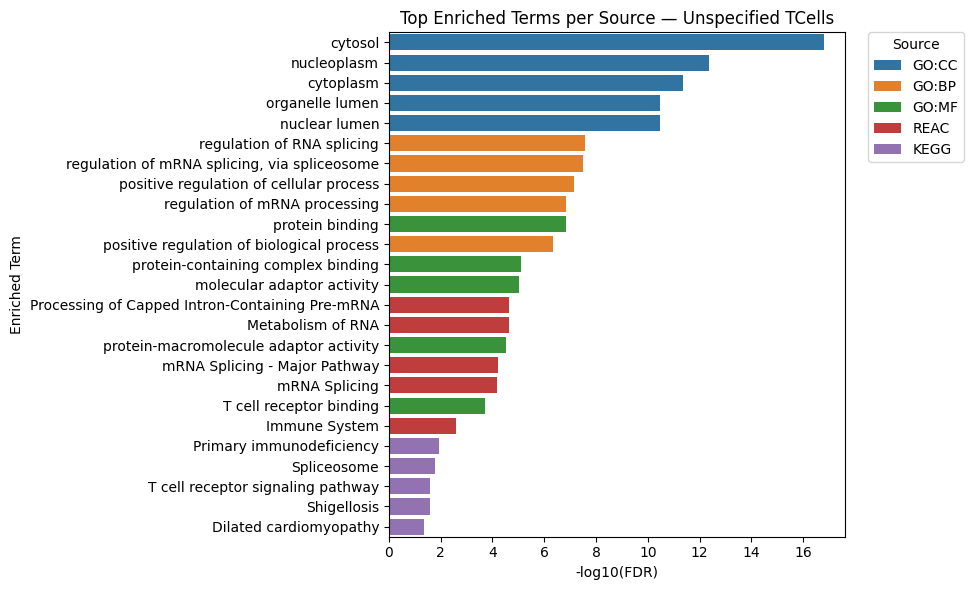

In [10]:
# ================================
# Step 8: Top Terms per Cell Type Plot
# ================================
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))
df_results_filtered = df_results[df_results["Source"].isin(["REAC", "KEGG", "GO:BP", "GO:CC", "GO:MF"])]

for cell_type in df_results_filtered["Cell_Type"].unique():
    subset = df_results_filtered[df_results_filtered["Cell_Type"] == cell_type]
    top_terms = (
        subset.sort_values("FDR")
        .groupby("Source", group_keys=False)
        .head(5)
    )
    term_order = top_terms.sort_values("FDR")["Term"].unique()

    # Print the top terms with their sources and FDRs
    print(f"\n🔎 Cell Type: {cell_type}")
    for idx, row in top_terms.iterrows():
        print(f"  - {row['Term']} ({row['Source']}, FDR={row['FDR']:.2e})")

    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=top_terms,
        y="Term",
        x="-log10(FDR)",
        hue="Source",
        order=term_order
    )
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.title(f"Top Enriched Terms per Source — {cell_type}")
    plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.tight_layout()
    plt.show()

In [9]:
# ================================
# Step 9: Print top terms for each cell type
# ================================
print("\n📊 Top enriched terms per cell type:")
for cell_type in df_results["Cell_Type"].unique():
    subset = df_results[df_results["Cell_Type"] == cell_type]
    # Sort by FDR and take the top 5
    top_terms = subset.sort_values("FDR").head(5)
    print(f"\n🔎 Cell Type: {cell_type}")
    for i, row in top_terms.iterrows():
        term = row["Term"]
        source = row["Source"]
        fdr = row["FDR"]
        print(f"  - {term} ({source}, FDR={fdr:.2e})")


📊 Top enriched terms per cell type:

🔎 Cell Type: BCells
  - immune response (GO:BP, FDR=1.58e-19)
  - leukocyte activation (GO:BP, FDR=1.58e-19)
  - lymphocyte activation (GO:BP, FDR=1.58e-19)
  - B cell activation (GO:BP, FDR=3.49e-18)
  - immune system process (GO:BP, FDR=5.63e-18)

🔎 Cell Type: Effector CD4 TCells
  - cell activation (GO:BP, FDR=6.29e-12)
  - leukocyte activation (GO:BP, FDR=6.29e-12)
  - regulation of immune system process (GO:BP, FDR=8.85e-12)
  - lymphocyte activation (GO:BP, FDR=9.08e-12)
  - immune response (GO:BP, FDR=1.05e-11)

🔎 Cell Type: Effector CD8 TCells
  - cell killing (GO:BP, FDR=1.34e-08)
  - immune response (GO:BP, FDR=1.34e-07)
  - immune system process (GO:BP, FDR=1.84e-07)
  - defense response (GO:BP, FDR=4.39e-07)
  - regulation of immune system process (GO:BP, FDR=6.56e-07)

🔎 Cell Type: Megakaryocytes
  - Hemostasis (REAC, FDR=1.16e-17)
  - Platelet activation, signaling and aggregation (REAC, FDR=6.81e-16)
  - platelet alpha granule (GO:CC

In [14]:
custom_order = [
    "Memory TCells",
    "Effector CD4 TCells",
    "Effector CD8 TCells",
    "Unspecified TCells",
    "NK Cells",
    "BCells",
    "Monocyte-derived",
    "Megakaryocytes"
]
# Reorder columns using the custom order
heatmap_data = heatmap_data[custom_order]

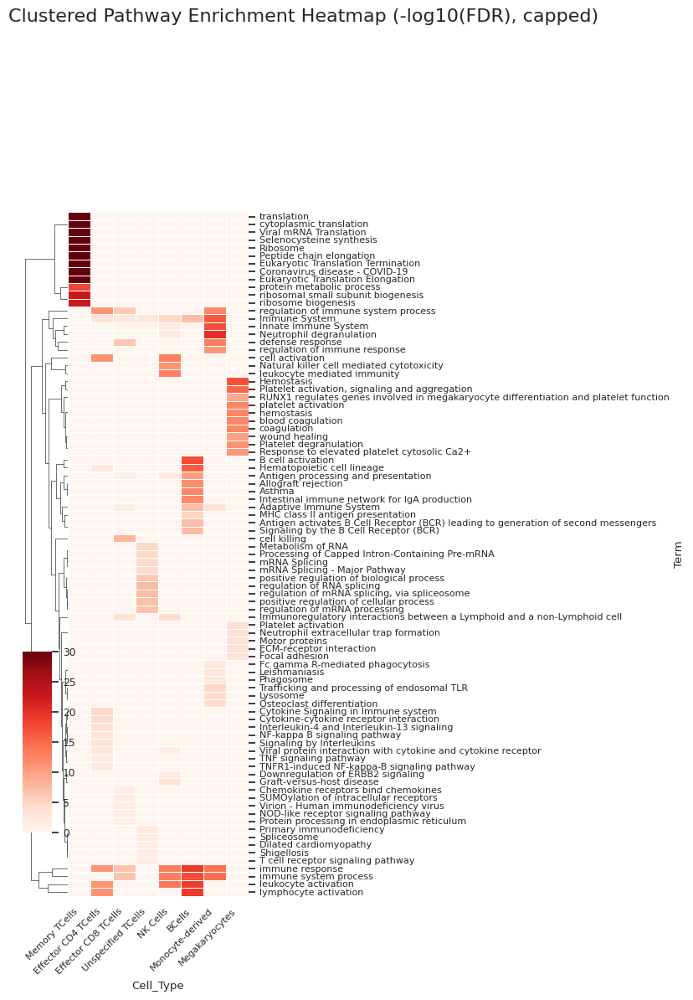

In [57]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Load enrichment results
df_results = pd.read_csv("Intermediate_Files/CellType_Pathway_Enrichment_gProfiler.tsv", sep="\t")

# Calculate -log10(FDR)
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Filter to selected sources
sources = ["GO:BP", "REAC", "KEGG"]
df_results = df_results[df_results["Source"].isin(sources)]

# Select top N pathways per cell type and source
top_n = 5
df_top = df_results.sort_values("FDR").groupby(["Cell_Type", "Source"], group_keys=False).head(top_n)

# Pivot table: Rows=Terms, Columns=Cell Types
heatmap_data = df_top.pivot_table(
    index="Term",
    columns="Cell_Type",
    values="-log10(FDR)",
    fill_value=0
)

# Define custom cell type order
custom_order = [
    "Memory TCells",
    "Effector CD4 TCells",
    "Effector CD8 TCells",
    "Unspecified TCells",
    "NK Cells",
    "BCells",
    "Monocyte-derived",
    "Megakaryocytes"
]

# Reorder columns
heatmap_data = heatmap_data.reindex(columns=custom_order)

# Clip values to cap high significance
cap_value = 30
heatmap_data = heatmap_data.clip(upper=cap_value)

import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib.pyplot as plt
import seaborn as sns

# Generate the clustermap
g = sns.clustermap(
    heatmap_data,
    cmap="Reds",   # using Reds colormap
    figsize=(7, 12),
    row_cluster=True,
    col_cluster=False,
    dendrogram_ratio=(.2, .2),
    cbar_pos=(0.02, 0.2, 0.05, 0.18),
    linewidths=0.5
)

# Extract the reordered row indices from the dendrogram
row_order = g.dendrogram_row.reordered_ind

# Calculate y-tick positions (offset by +0.5 to align with cell centers)
ytick_positions = np.arange(len(row_order)) + 0.55

# Set y-tick labels using the dendrogram order
g.ax_heatmap.set_yticks(ytick_positions)
g.ax_heatmap.set_yticklabels(
    [heatmap_data.index[i] for i in row_order],
    rotation=0,
    fontsize=8,
    va='center'
)

# Fix x-axis labels if needed
g.ax_heatmap.set_xticklabels(
    g.ax_heatmap.get_xticklabels(),
    rotation=45,
    ha='right',
    fontsize=8
)

# Add a centered title
g.fig.suptitle(
    "Clustered Pathway Enrichment Heatmap (-log10(FDR), capped)",
    x=0.5, y=1.02, ha='center', fontsize=16
)

# Save the figure
plt.savefig(
    "Intermediate_Files/Paper_Figs/clustered_heatmap_pathways_per_cell_type_custom_order.pdf",
    dpi=600, transparent=True, bbox_inches="tight"
)

plt.show()

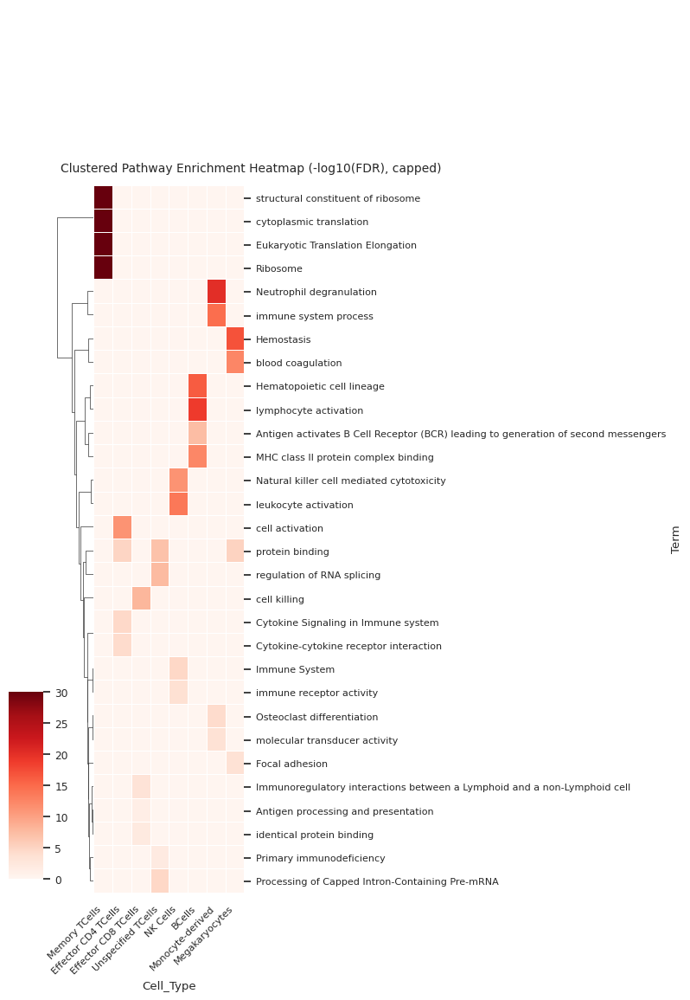

In [78]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Load enrichment results
df_results = pd.read_csv("Intermediate_Files/CellType_Pathway_Enrichment_gProfiler.tsv", sep="\t")

# Calculate -log10(FDR)
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Filter to selected sources
sources = ["GO:BP", "GO:MF", "REAC", "KEGG"]
df_results = df_results[df_results["Source"].isin(sources)]

# Select top N pathways per cell type and source
top_n = 1
df_top = df_results.sort_values("FDR").groupby(["Cell_Type", "Source"], group_keys=False).head(top_n)

# Pivot table: Rows=Terms, Columns=Cell Types
heatmap_data = df_top.pivot_table(
    index="Term",
    columns="Cell_Type",
    values="-log10(FDR)",
    fill_value=0
)

# Define custom cell type order
custom_order = [
    "Memory TCells",
    "Effector CD4 TCells",
    "Effector CD8 TCells",
    "Unspecified TCells",
    "NK Cells",
    "BCells",
    "Monocyte-derived",
    "Megakaryocytes"
]

# Reorder columns
heatmap_data = heatmap_data.reindex(columns=custom_order)

# Clip values to cap high significance
cap_value = 30
heatmap_data = heatmap_data.clip(upper=cap_value)

import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib.pyplot as plt
import seaborn as sns

# Generate the clustermap
g = sns.clustermap(
    heatmap_data,
    cmap="Reds",   # using Reds colormap
    figsize=(8, 12),
    row_cluster=True,
    col_cluster=False,
    dendrogram_ratio=(.2, .2),
    cbar_pos=(-0.05, 0.15, 0.05, 0.18),
    linewidths=0.5
)

# Extract the reordered row indices from the dendrogram
row_order = g.dendrogram_row.reordered_ind

# Calculate y-tick positions (offset by +0.5 to align with cell centers)
ytick_positions = np.arange(len(row_order)) + 0.55

# Set y-tick labels using the dendrogram order
g.ax_heatmap.set_yticks(ytick_positions)
g.ax_heatmap.set_yticklabels(
    [heatmap_data.index[i] for i in row_order],
    rotation=0,
    fontsize=8,
    va='center'
)

# Fix x-axis labels if needed
g.ax_heatmap.set_xticklabels(
    g.ax_heatmap.get_xticklabels(),
    rotation=45,
    ha='right',
    fontsize=8
)

# Add a centered title
g.fig.suptitle(
    "Clustered Pathway Enrichment Heatmap (-log10(FDR), capped)",
    x=0.3, y=0.84, ha='center', fontsize=10
)

# Save the figure
plt.savefig(
    "Intermediate_Files/Paper_Figs/clustered_heatmap_pathways_per_cell_type_custom_order.pdf",
    dpi=600, transparent=True, bbox_inches="tight"
)

plt.show()

In [79]:
import numpy as np
import pandas as pd
import requests
from tqdm import tqdm

# 1️⃣ Expression Matrix & Z-Scoring
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
expr_df = pd.DataFrame(X, 
                       columns=adata_i_filtered.var_names,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])
expr_avg = expr_df.groupby(expr_df.index, observed=False).mean().T
z_expr = expr_avg.sub(expr_avg.mean(axis=1), axis=0).div(expr_avg.std(axis=1), axis=0).fillna(0)

# 2️⃣ Utilities
def extract_symbol(label):
    return label.split(":")[0]

def query_gprofiler(gene_list):
    url = "https://biit.cs.ut.ee/gprofiler/api/gost/profile/"
    headers = {"Content-Type": "application/json"}
    payload = {
        "organism": "hsapiens",
        "query": gene_list,
        "sources": ["GO:BP", "GO:MF", "GO:CC", "KEGG", "REAC"],
        "user_threshold": 0.05,
        "significance_threshold_method": "fdr"
    }
    try:
        response = requests.post(url, headers=headers, json=payload)
        response.raise_for_status()
        return response.json()["result"]
    except Exception as e:
        print(f"⚠️ g:Profiler failed: {e}")
        return []

def get_top_similar_genes(target_gene, reference_genes, expr_avg, top_n=20):
    target_expr = expr_avg.loc[target_gene]
    ref_expr = expr_avg.loc[reference_genes]
    corr = ref_expr.corrwith(target_expr, axis=1)
    return corr.abs().sort_values(ascending=False).head(top_n).index.tolist()

# 3️⃣ Known Genes
known_genes = [g for g in expr_avg.index if not g.startswith("BambuGene") and "BambuTx" not in g]

# 4️⃣ Targets
novel_genes = [g for g in expr_avg.index if g.startswith("BambuGene")]
novel_isoforms = [g for g in expr_avg.index if g.startswith("ENSG") and "BambuTx" in g]
target_genes = novel_genes + novel_isoforms

# 5️⃣ Enrichment by Similarity
results_similarity = []
for target_gene in tqdm(target_genes, desc="Similarity-based enrichment"):
    top_similar = get_top_similar_genes(target_gene, known_genes, expr_avg, top_n=30)
    enriched = query_gprofiler(top_similar)
    for e in enriched:
        results_similarity.append({
            "Target": target_gene,
            "Source": e["source"],
            "Term": e["name"],
            "P-value": e["p_value"],
            "FDR": e.get("p_value_fdr", e.get("p_value")),
            "Genes": ",".join(e.get("intersection", [])) if "intersection" in e else ""
        })

df_similarity = pd.DataFrame(results_similarity)
df_similarity.to_csv("Intermediate_Files/NovelGenes_NovelIsoforms_SimilarityEnrichment.tsv", sep="\t", index=False)

# 6️⃣ Direct Enrichment (no similarity)
results_direct_novel_genes = []
for gene_id in tqdm(novel_genes, desc="Direct enrichment (novel genes)"):
    gene_symbol = extract_symbol(gene_id)
    enriched = query_gprofiler([gene_symbol])
    for e in enriched:
        results_direct_novel_genes.append({
            "Target": gene_symbol,
            "Source": e["source"],
            "Term": e["name"],
            "P-value": e["p_value"],
            "FDR": e.get("p_value_fdr", e.get("p_value")),
            "Genes": ",".join(e.get("intersection", [])) if "intersection" in e else ""
        })

df_direct_novel_genes = pd.DataFrame(results_direct_novel_genes)
df_direct_novel_genes.to_csv("Intermediate_Files/NovelGenes_Pathway_Enrichment_gProfiler.tsv", sep="\t", index=False)

results_direct_novel_isoforms = []
for gene_id in tqdm(novel_isoforms, desc="Direct enrichment (novel isoforms)"):
    gene_symbol = extract_symbol(gene_id)
    enriched = query_gprofiler([gene_symbol])
    for e in enriched:
        results_direct_novel_isoforms.append({
            "Target": gene_symbol,
            "Source": e["source"],
            "Term": e["name"],
            "P-value": e["p_value"],
            "FDR": e.get("p_value_fdr", e.get("p_value")),
            "Genes": ",".join(e.get("intersection", [])) if "intersection" in e else ""
        })

df_direct_novel_isoforms = pd.DataFrame(results_direct_novel_isoforms)
df_direct_novel_isoforms.to_csv("Intermediate_Files/NovelIsoforms_Pathway_Enrichment_gProfiler.tsv", sep="\t", index=False)

print("✅ All enrichment steps complete!")

Enrichment by Novel Isoform: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:19<00:00,  2.22it/s]

✅ Enrichment complete for novel genes and isoforms!


In [80]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load enrichment results
df_novel_genes = pd.read_csv("Intermediate_Files/NovelGenes_Pathway_Enrichment_gProfiler.tsv", sep="\t")
df_novel_isoforms = pd.read_csv("Intermediate_Files/NovelIsoforms_Pathway_Enrichment_gProfiler.tsv", sep="\t")

# Add -log10(FDR)
for df in [df_novel_genes, df_novel_isoforms]:
    df["-log10(FDR)"] = -np.log10(df["FDR"].replace(0, 1e-300))

# Filter by Source if desired
sources = ["GO:BP", "GO:MF","REAC", "KEGG"]
for df in [df_novel_genes, df_novel_isoforms]:
    df.drop(df[~df["Source"].isin(sources)].index, inplace=True)

EmptyDataError: No columns to parse from file

In [ ]:
# Plot bar plots for each novel gene
for gene in df_novel_genes["BambuGene"].unique():
    subset = df_novel_genes[df_novel_genes["BambuGene"] == gene]
    top_terms = subset.sort_values("FDR").groupby("Source", group_keys=False).head(5)
    term_order = top_terms.sort_values("FDR")["Term"].unique()

    plt.figure(figsize=(10, 6))
    sns.barplot(data=top_terms, y="Term", x="-log10(FDR)", hue="Source", order=term_order)
    plt.title(f"Top Enriched Pathways — {gene}")
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.savefig(f"Intermediate_Files/Paper_Figs/NovelGene_{gene}_Enrichment_Barplot.pdf",
                dpi=600, transparent=True)
    plt.close()

# Repeat for novel isoforms
for isoform in df_novel_isoforms["GeneIsoform"].unique():
    subset = df_novel_isoforms[df_novel_isoforms["GeneIsoform"] == isoform]
    top_terms = subset.sort_values("FDR").groupby("Source", group_keys=False).head(5)
    term_order = top_terms.sort_values("FDR")["Term"].unique()

    plt.figure(figsize=(10, 6))
    sns.barplot(data=top_terms, y="Term", x="-log10(FDR)", hue="Source", order=term_order)
    plt.title(f"Top Enriched Pathways — {isoform}")
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.savefig(f"Intermediate_Files/Paper_Figs/NovelIsoform_{isoform}_Enrichment_Barplot.pdf",
                dpi=600, transparent=True)
    plt.close()

In [87]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate similarities for each BambuGene#
similarity_results_novel_genes = []

for novel_gene in tqdm([g for g in expr_avg.index if g.startswith("BambuGene")], desc="Calculating similarities for Novel Genes"):
    target_expr = expr_avg.loc[novel_gene]
    known_genes = [g for g in expr_avg.index if not g.startswith("BambuGene")]
    known_expr = expr_avg.loc[known_genes]
    
    # Calculate Pearson correlation
    corr = known_expr.corrwith(target_expr, axis=1)
    
    # Select top 10
    top_similar = corr.abs().sort_values(ascending=False).head(10)
    
    # Save results
    for gene, score in top_similar.items():
        similarity_results_novel_genes.append({
            "NovelGene": novel_gene,
            "KnownGene": gene,
            "Similarity": score
        })

df_novel_gene_similarities = pd.DataFrame(similarity_results_novel_genes)

Calculating similarities for Novel Genes: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [03:55<00:00,  7.15s/it]


In [92]:
print(df_novel_gene_similarities.head())
print(df_novel_isoform_similarities.head())

                NovelGene                                KnownGene  Similarity
0  BambuGene1277:BambuTx5     GNG2:ENSG00000186469:ENST00000335281    0.996208
1  BambuGene1277:BambuTx5    KLRC2:ENSG00000205809:ENST00000381902    0.994617
2  BambuGene1277:BambuTx5          ENSG00000288915:ENST00000686939    0.993765
3  BambuGene1277:BambuTx5   TGFBR3:ENSG00000069702:ENST00000525962    0.993722
4  BambuGene1277:BambuTx5  PLEKHF1:ENSG00000166289:ENST00000436066    0.992768
                 NovelIsoform              SiblingIsoform  Similarity
0   ENSG00000166295:BambuTx14   ENSG00000166295:BambuTx15    0.733205
1   ENSG00000166295:BambuTx15   ENSG00000166295:BambuTx14    0.733205
2  ENSG00000243829:BambuTx106  ENSG00000243829:BambuTx111    0.040709
3  ENSG00000243829:BambuTx106  ENSG00000243829:BambuTx113   -0.184666
4  ENSG00000243829:BambuTx111  ENSG00000243829:BambuTx106    0.040709


/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


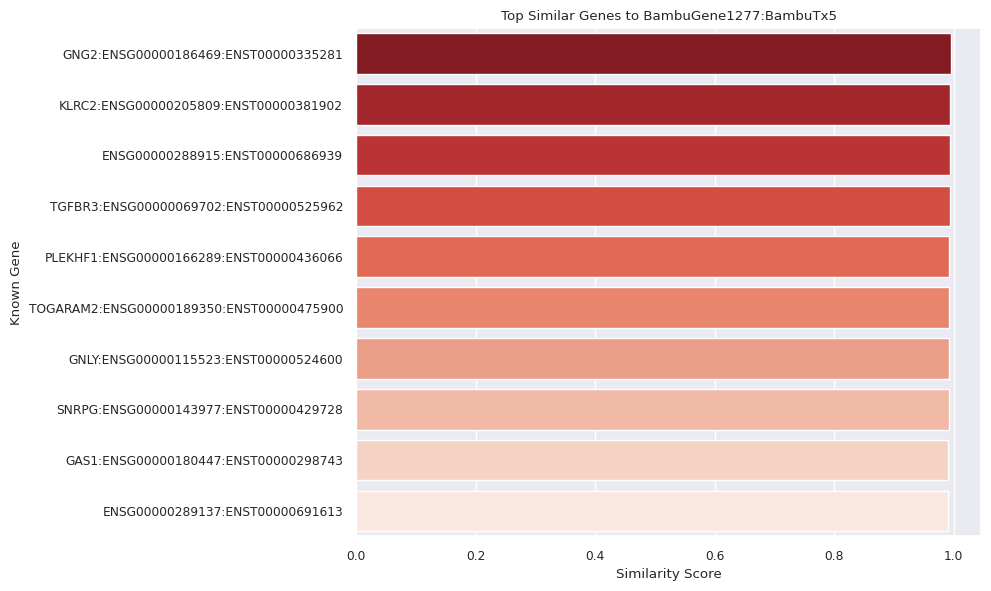

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


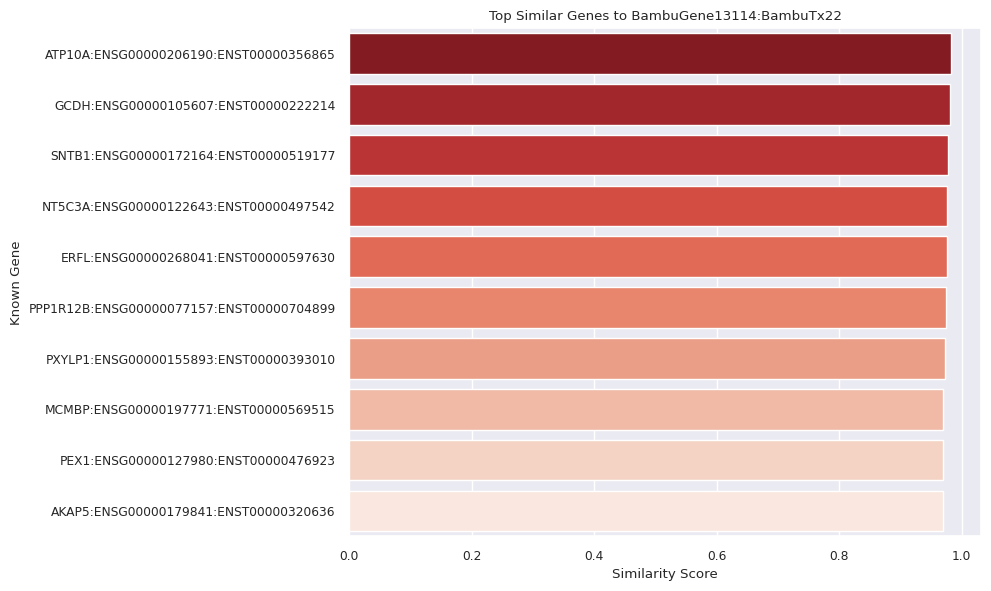

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


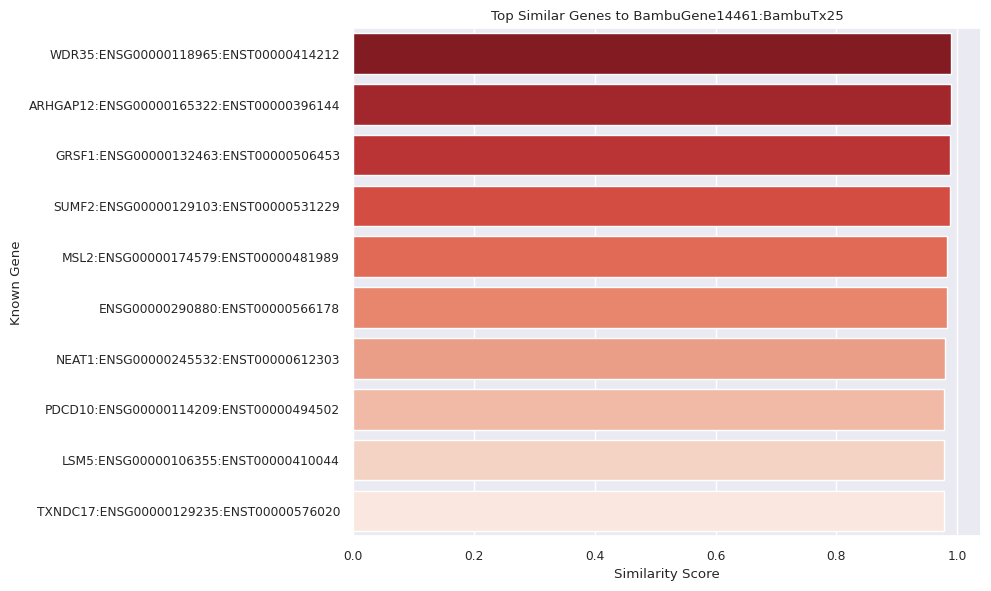

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


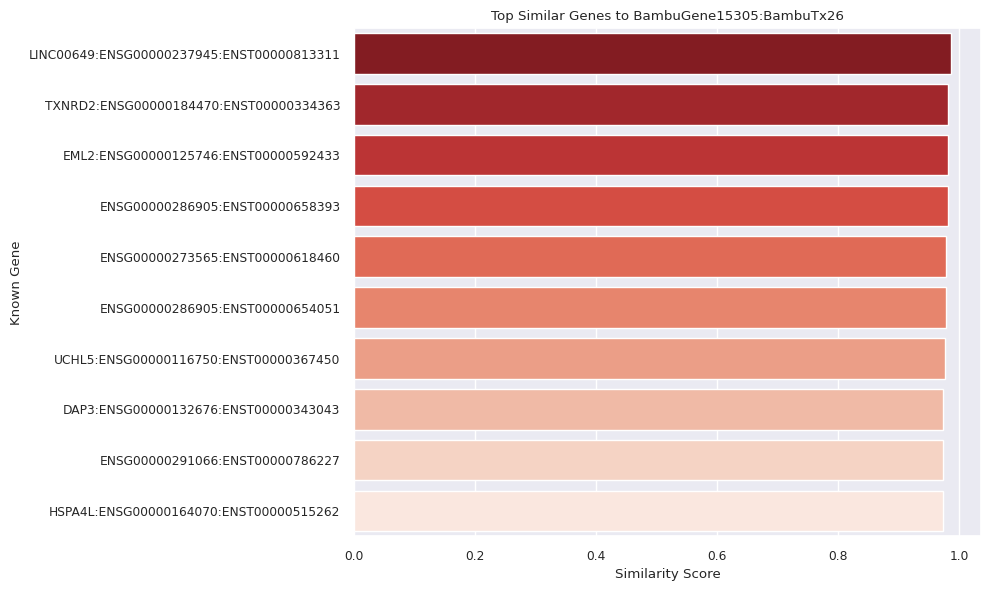

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


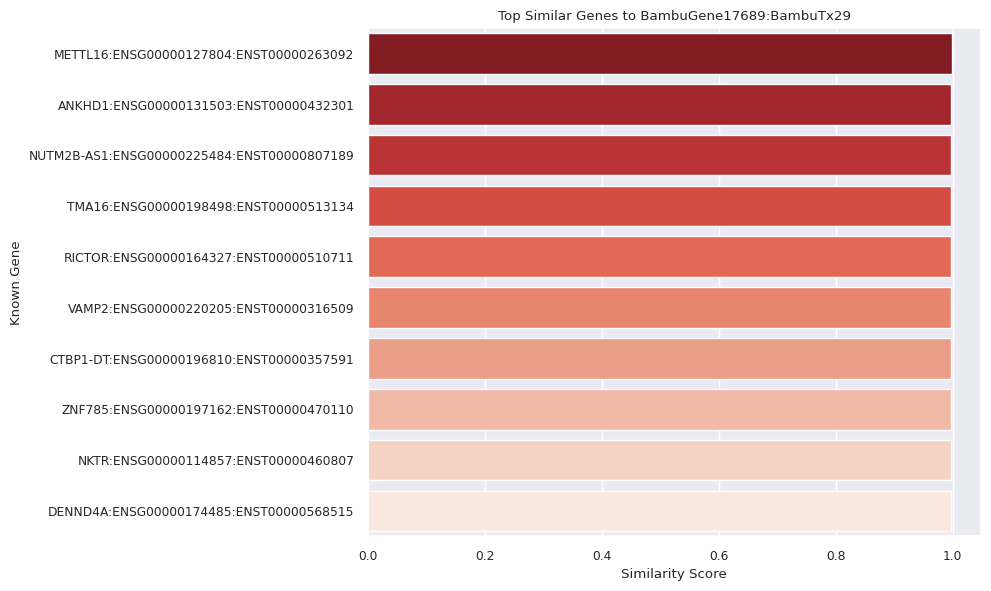

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


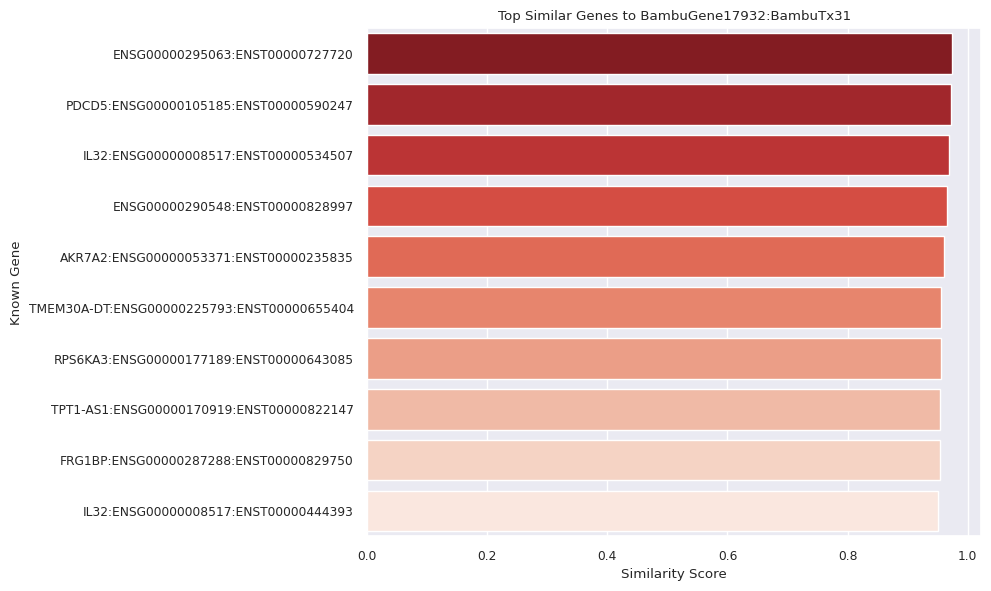

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


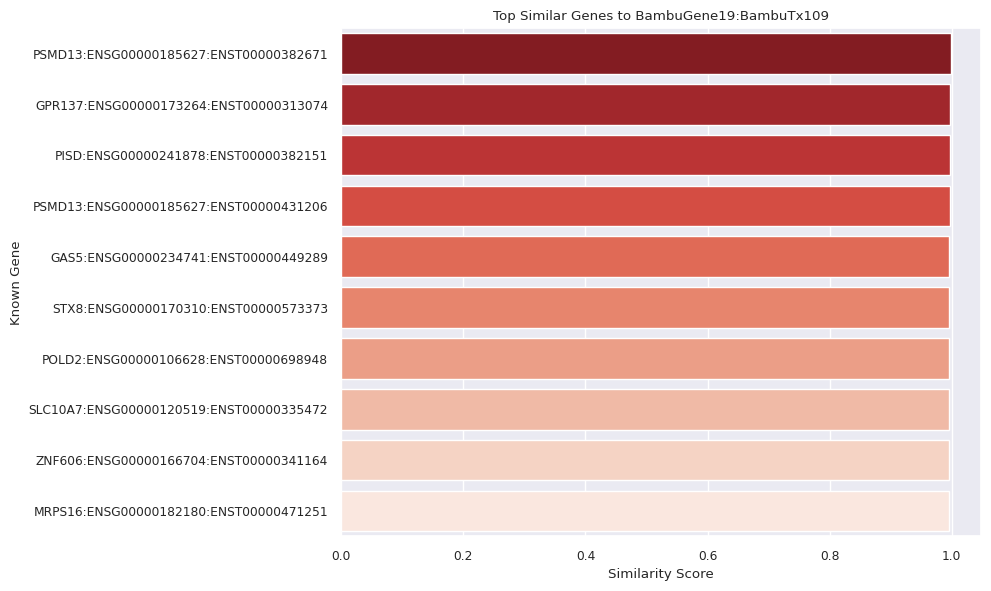

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


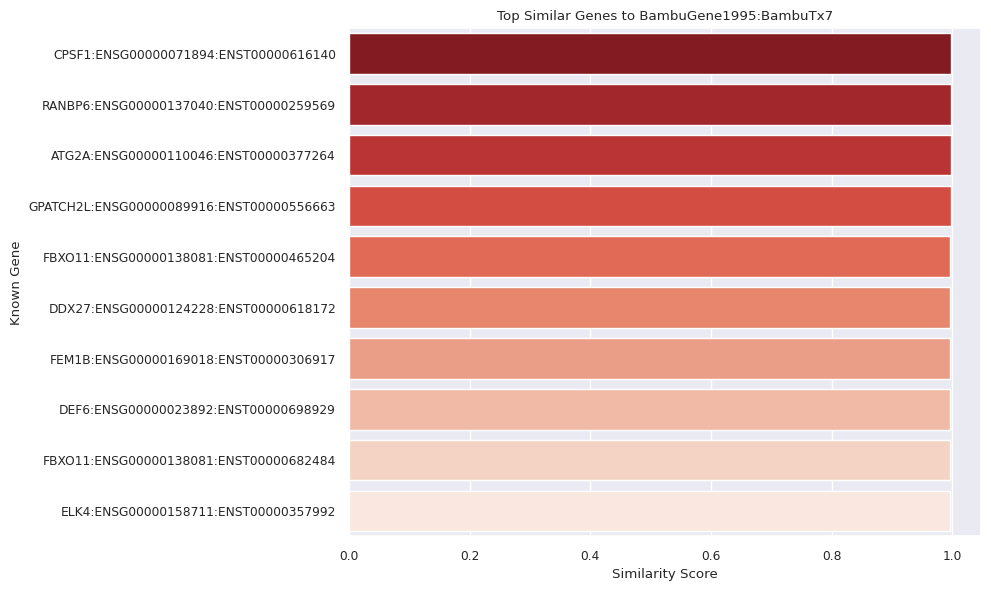

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


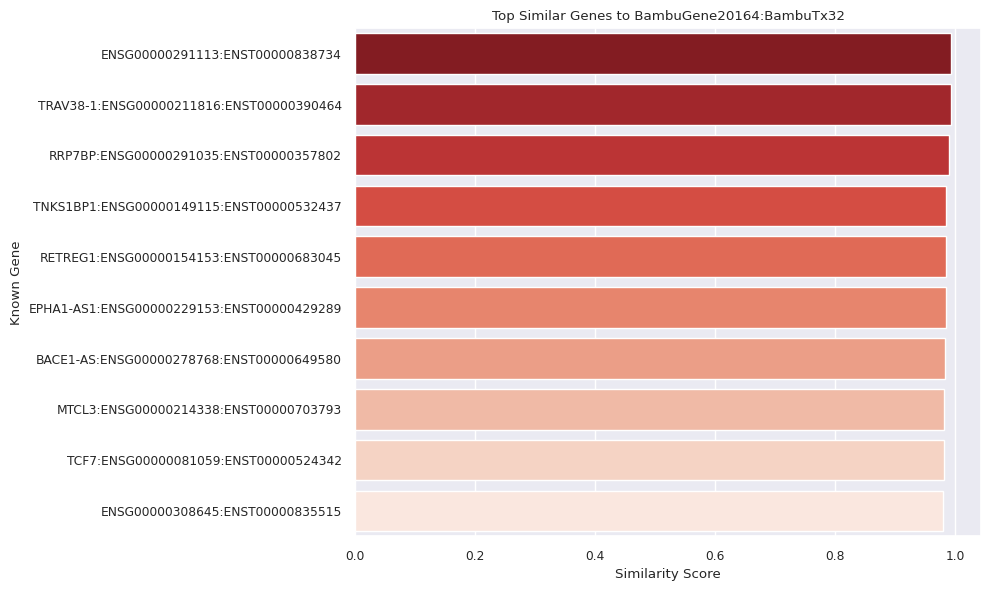

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


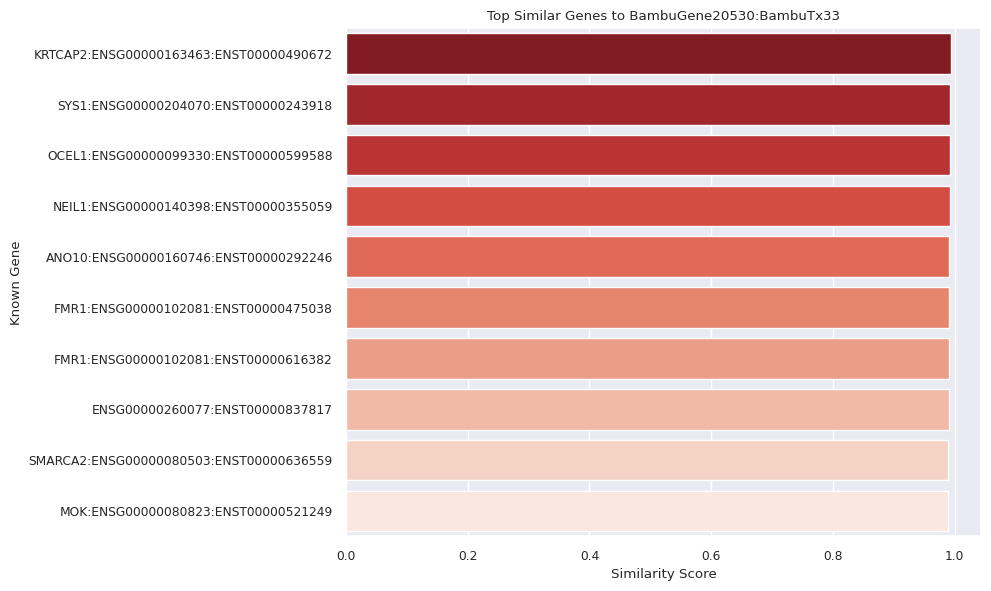

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


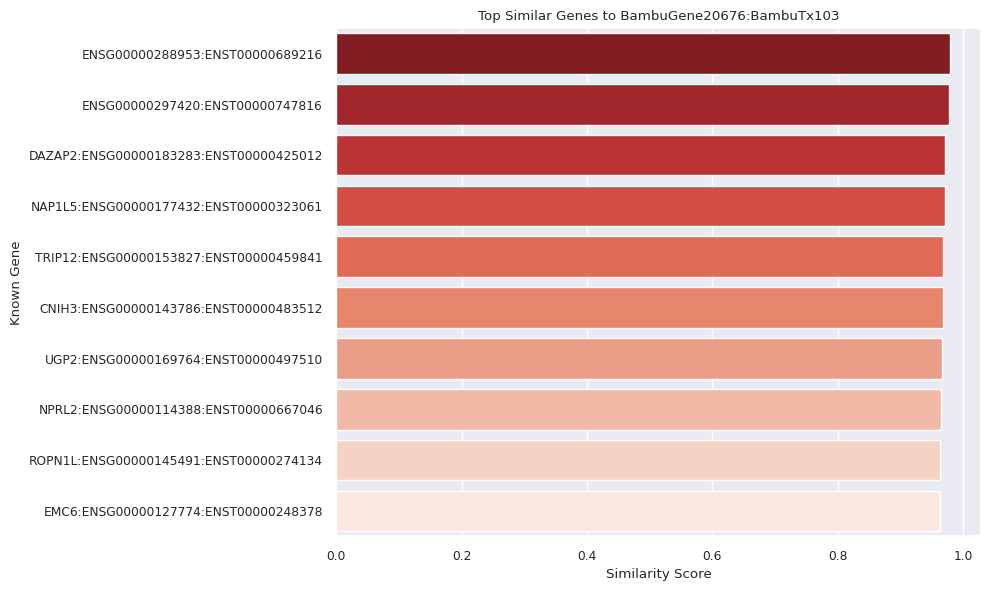

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


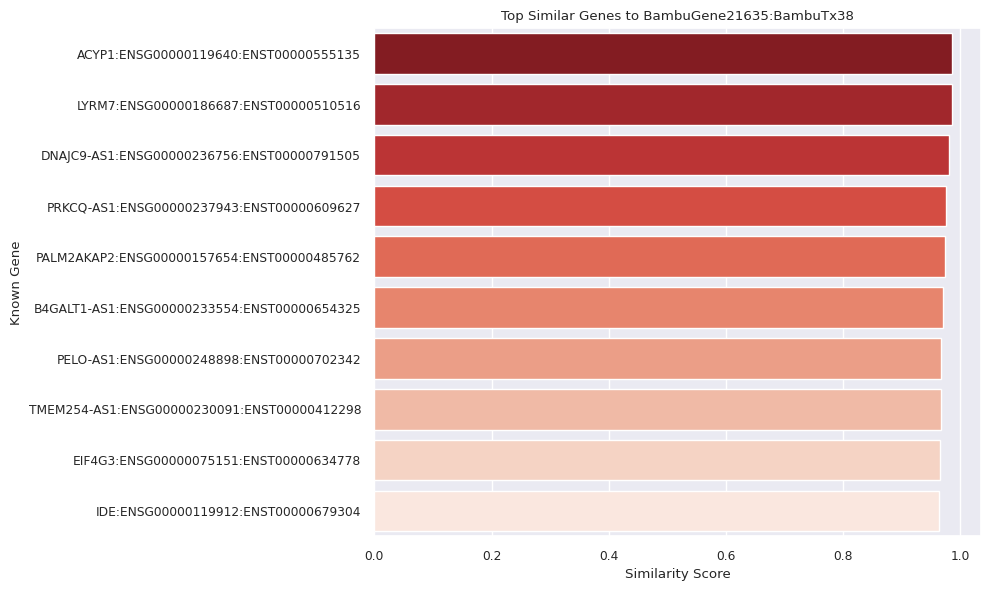

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


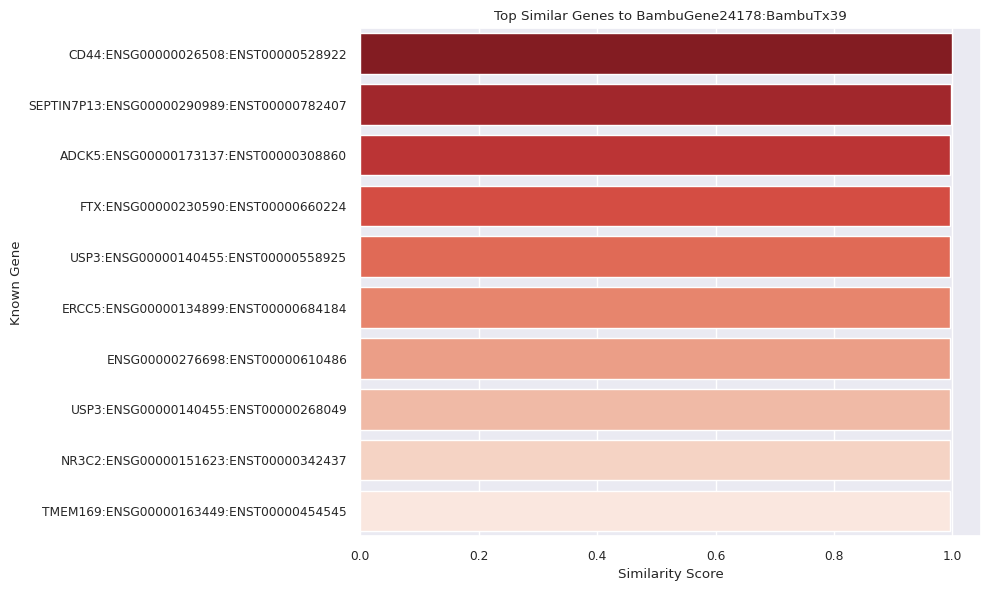

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


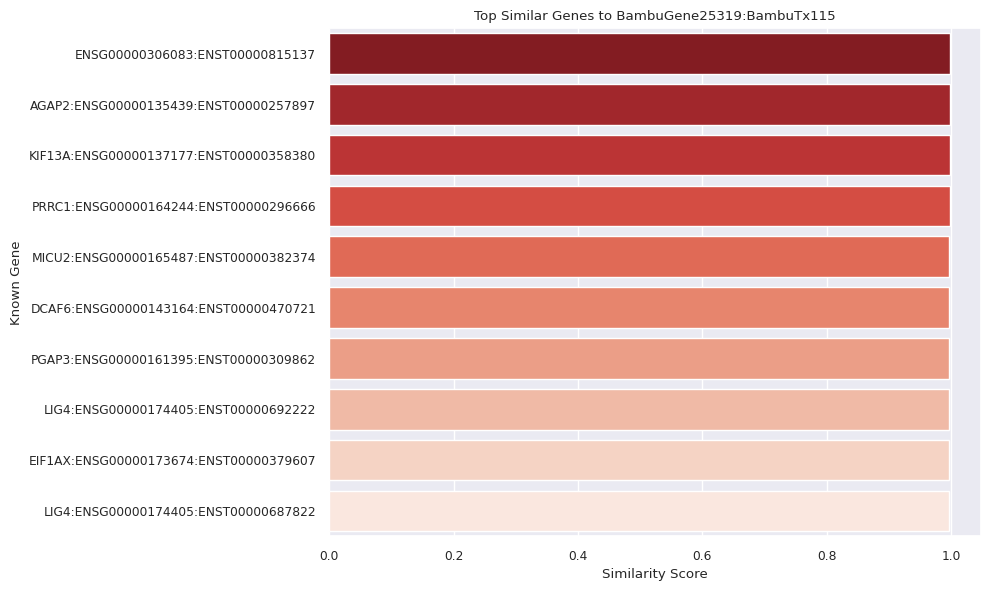

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


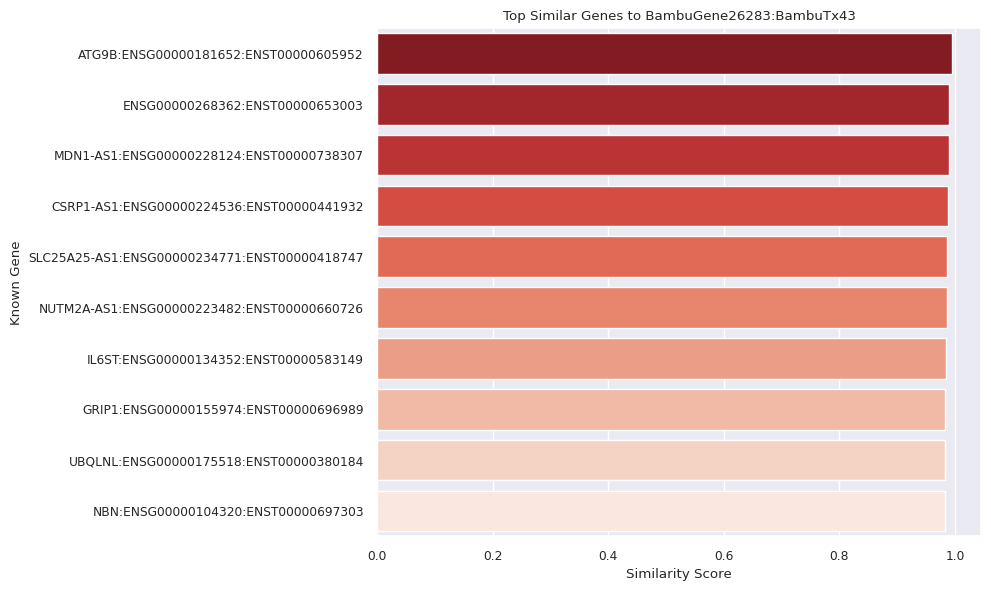

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


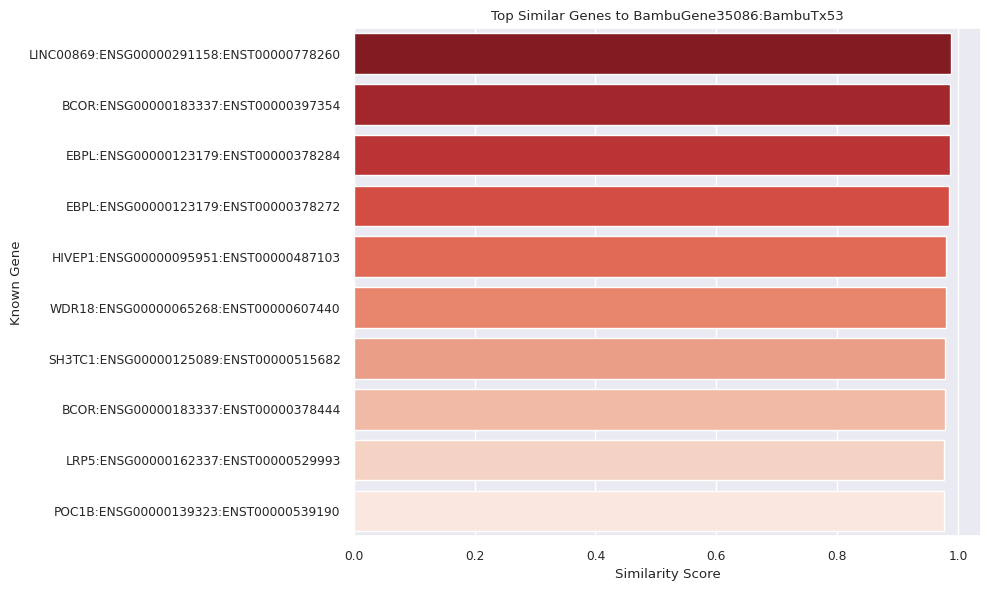

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


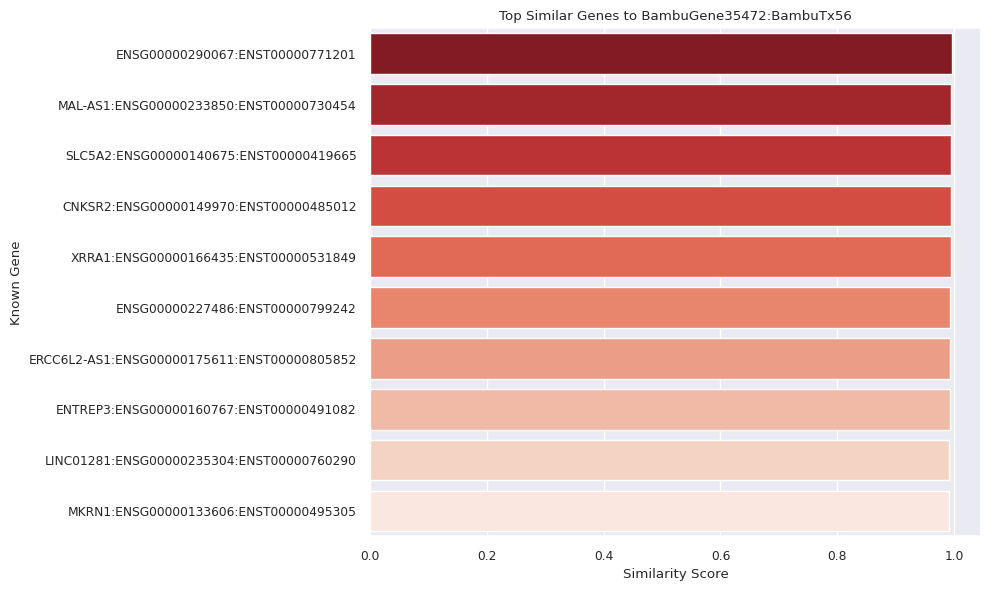

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


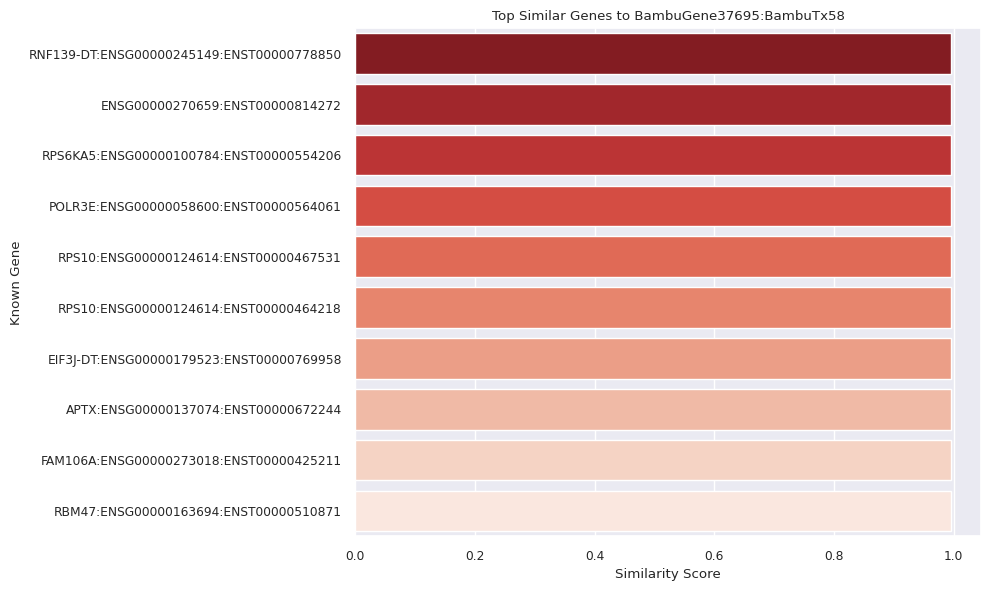

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


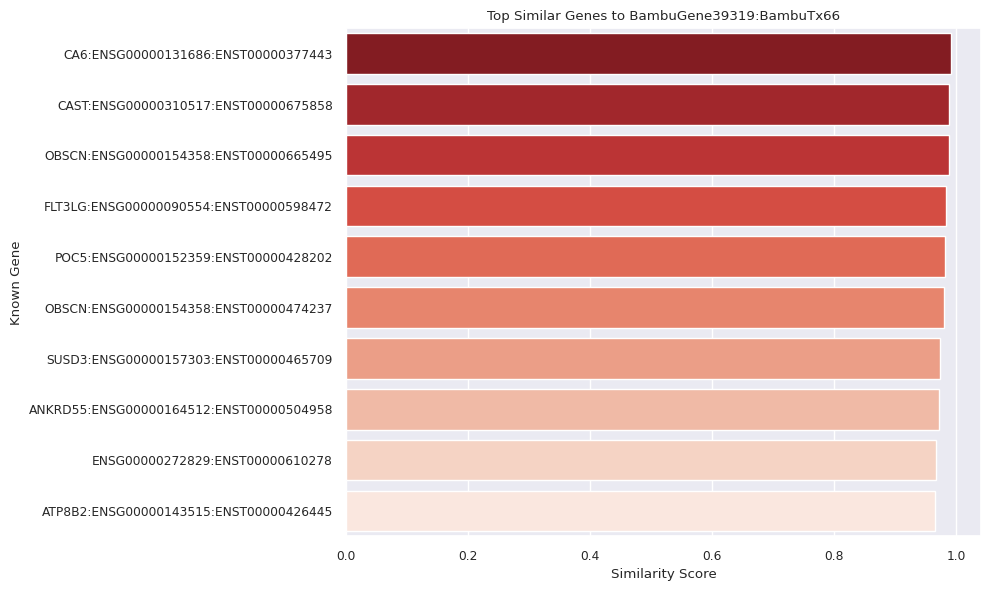

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


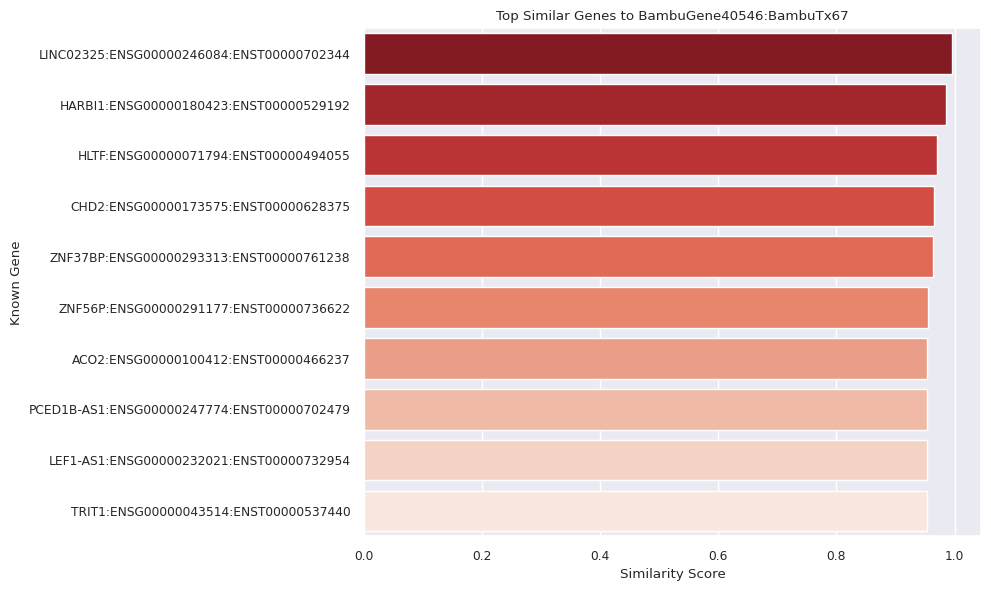

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


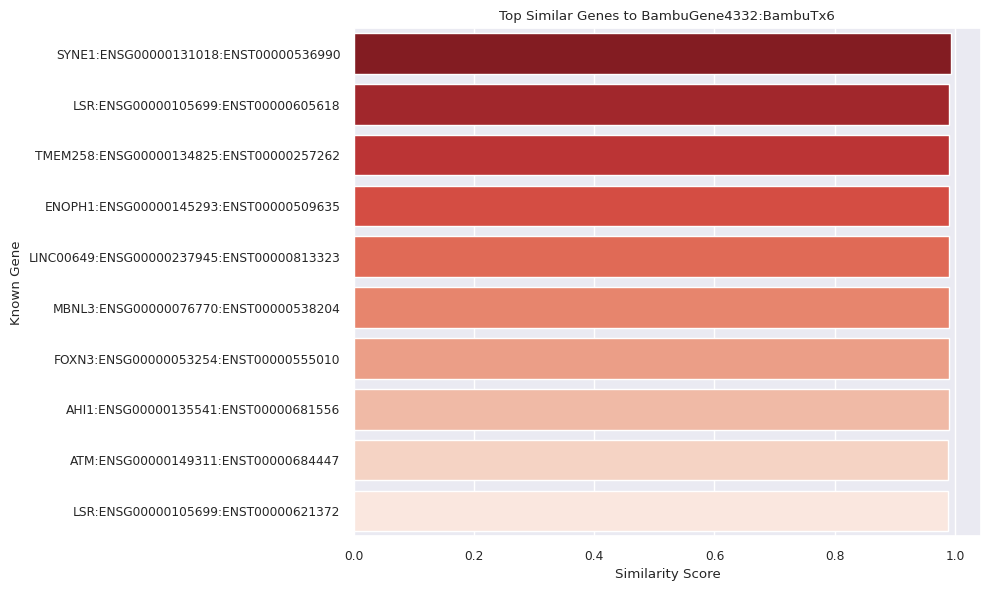

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


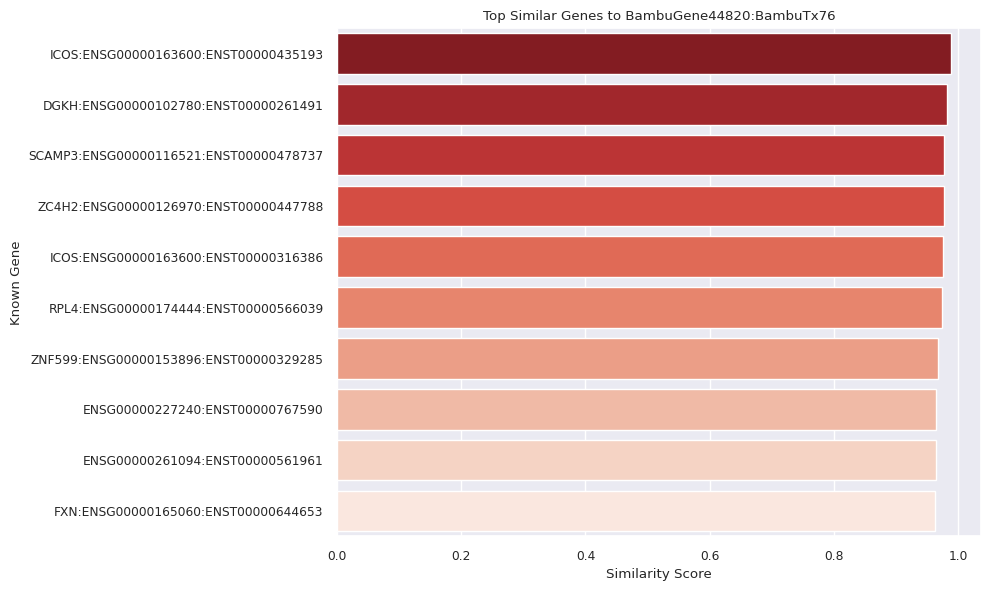

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


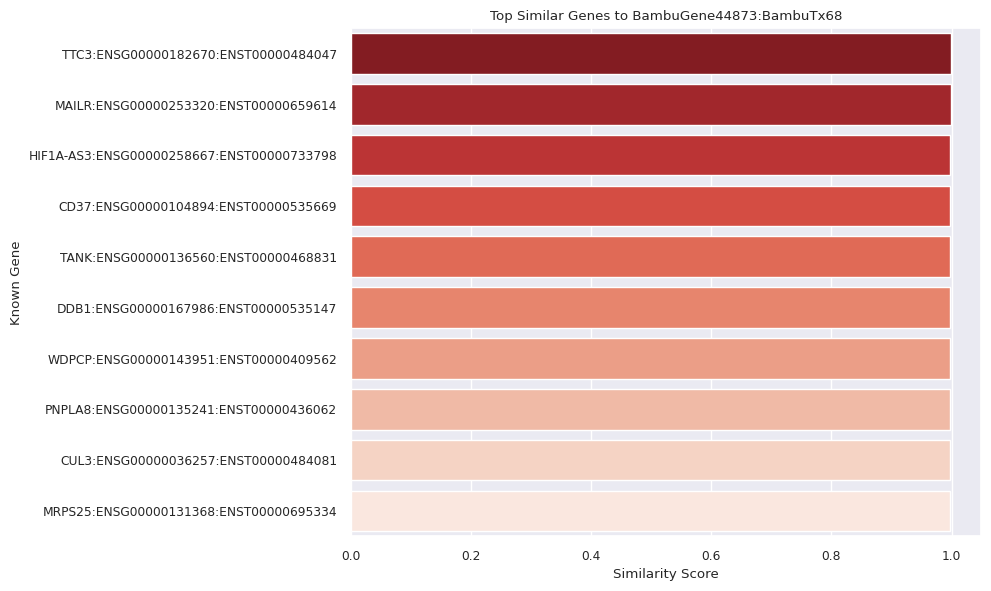

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


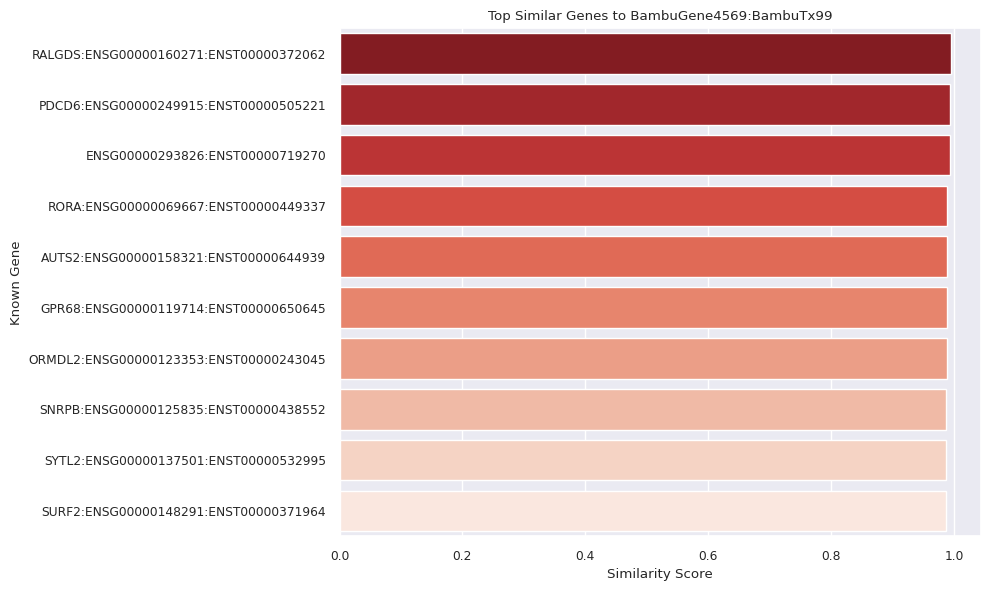

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


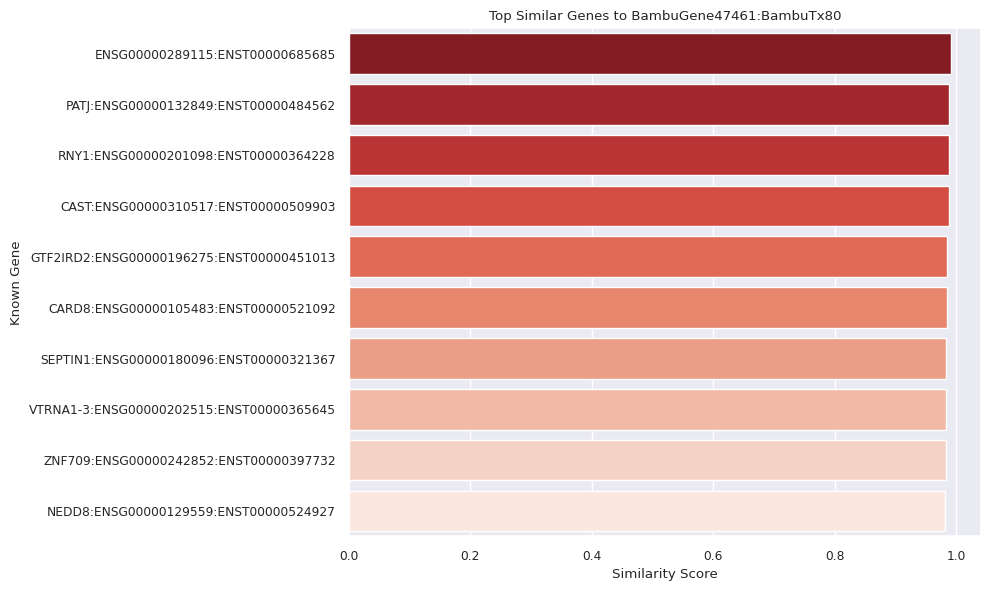

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


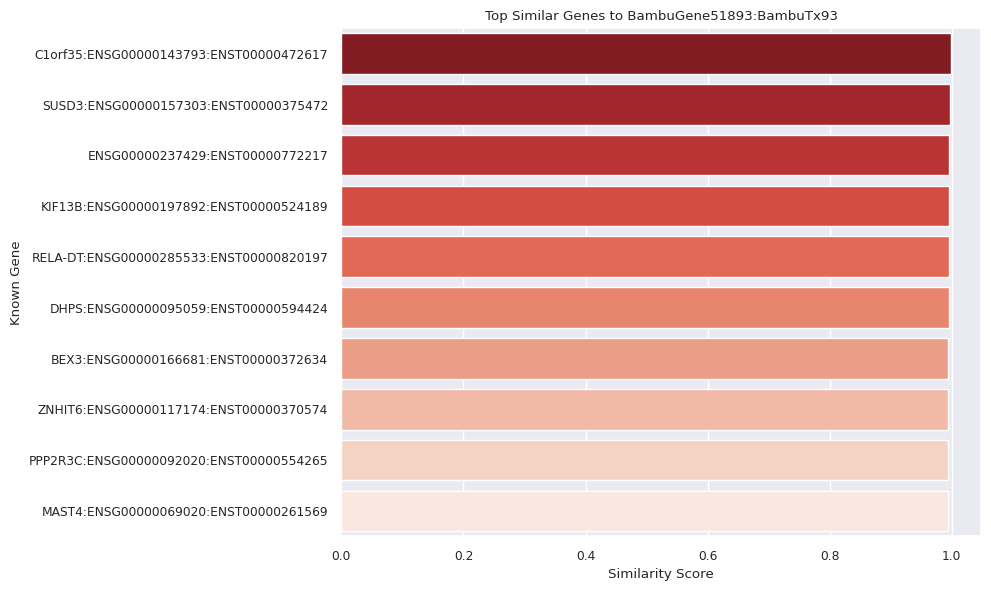

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


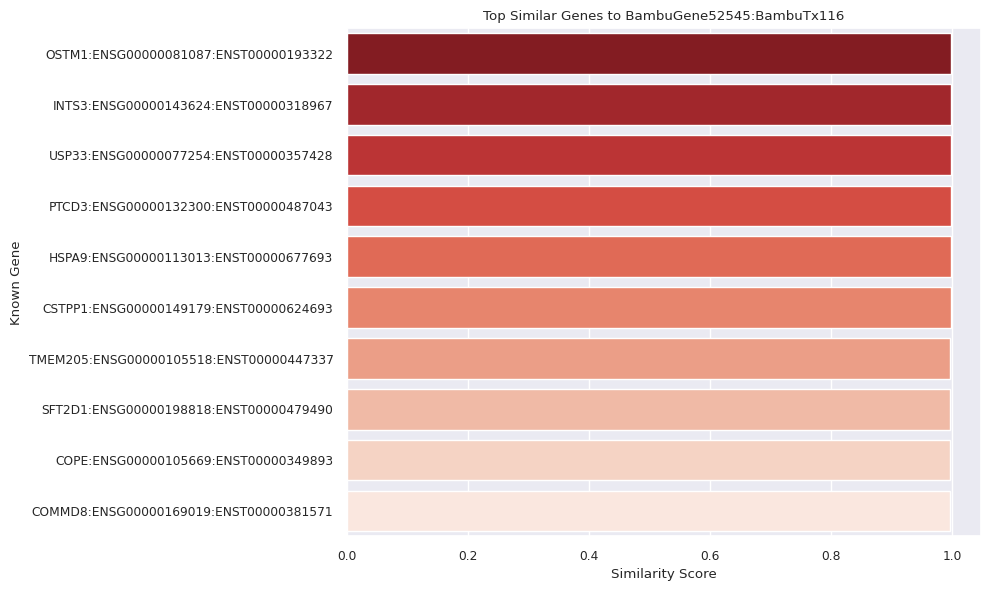

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


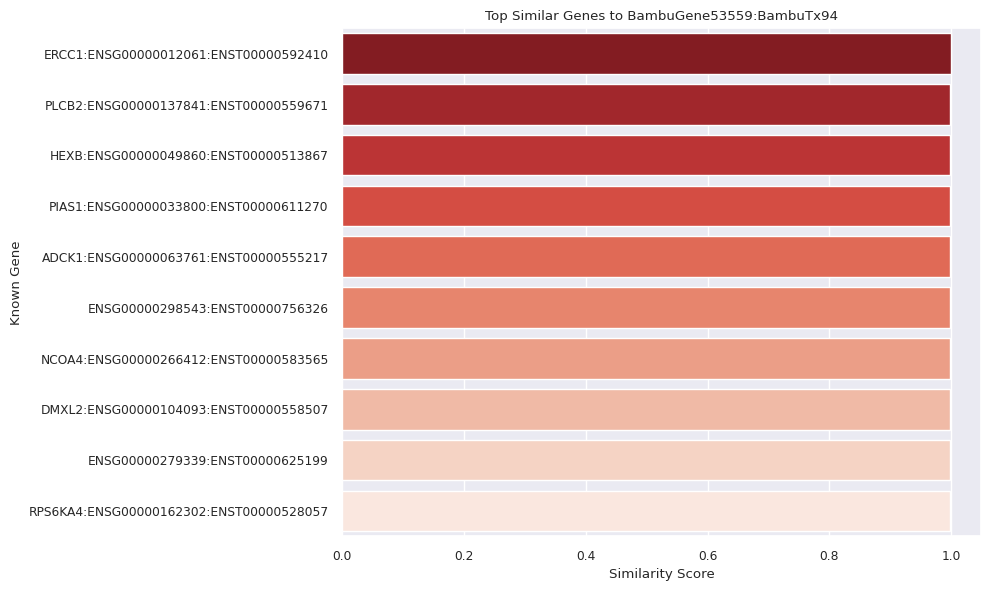

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


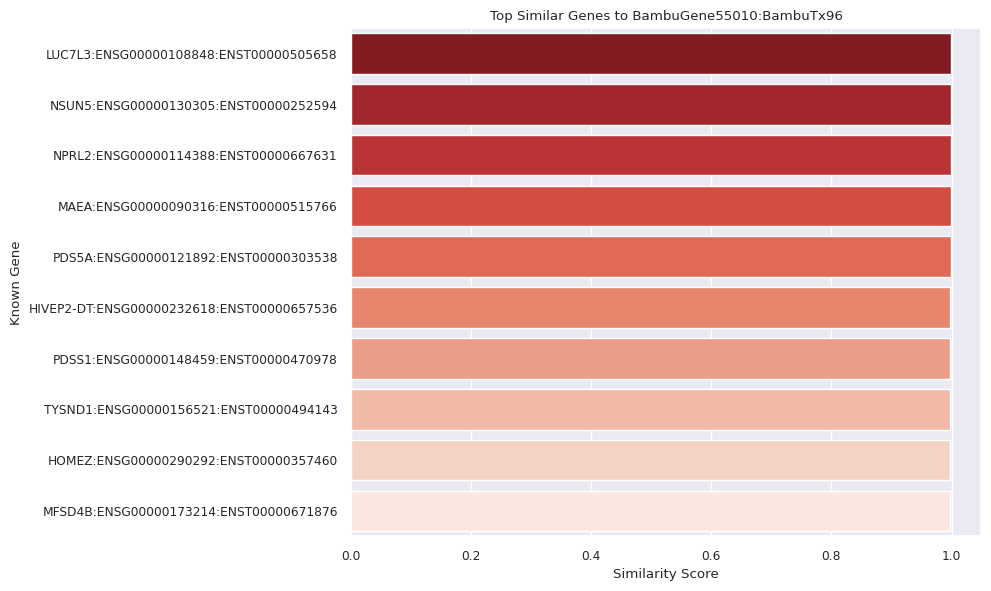

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


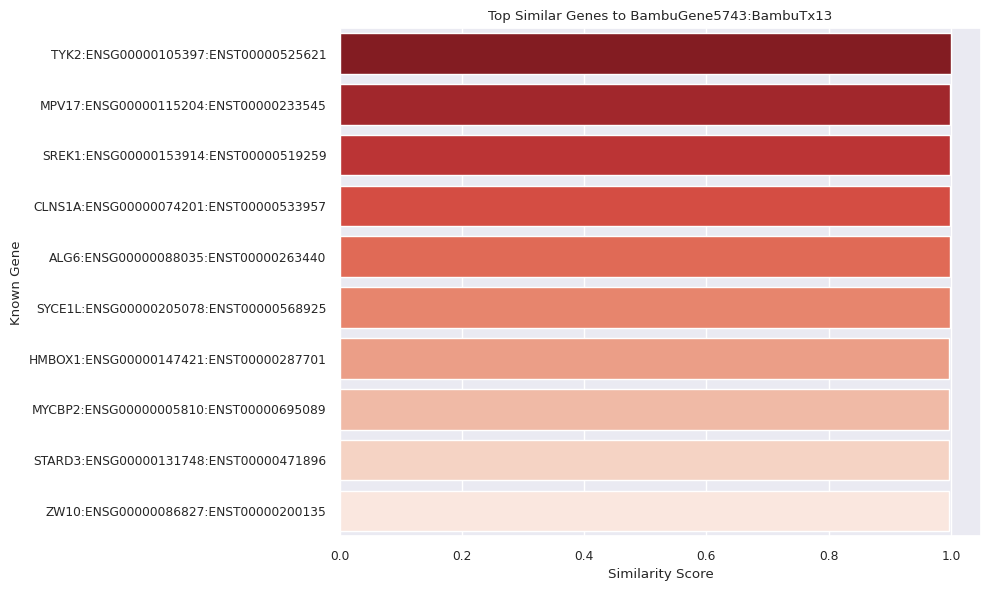

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


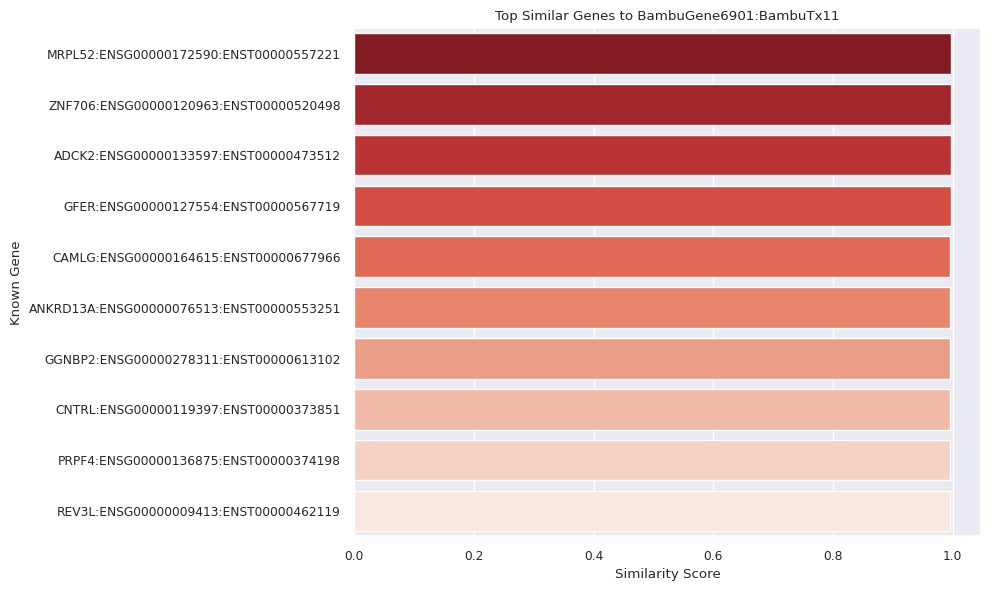

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


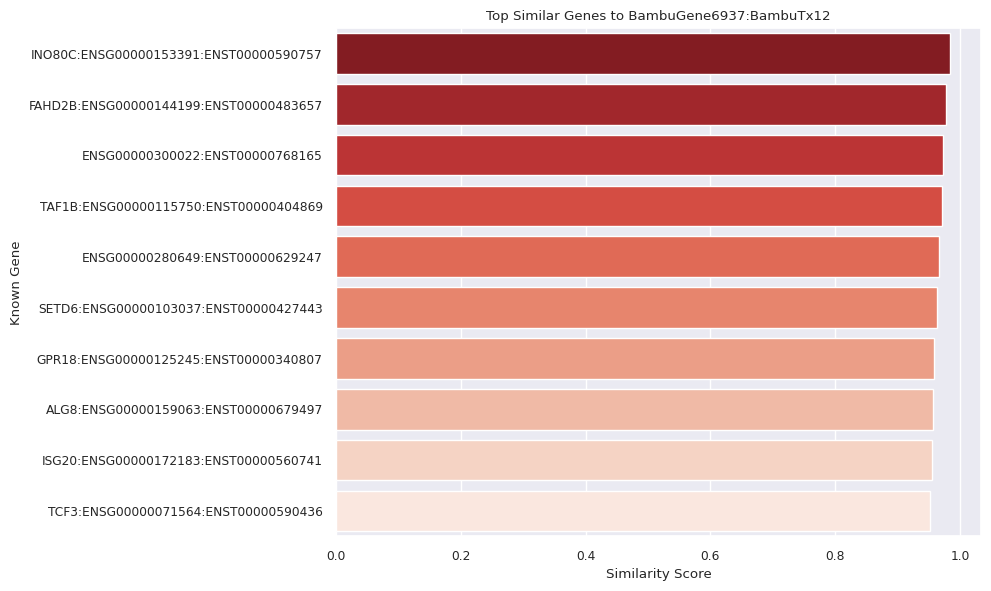

/tmp/ipykernel_3152855/1074319157.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")


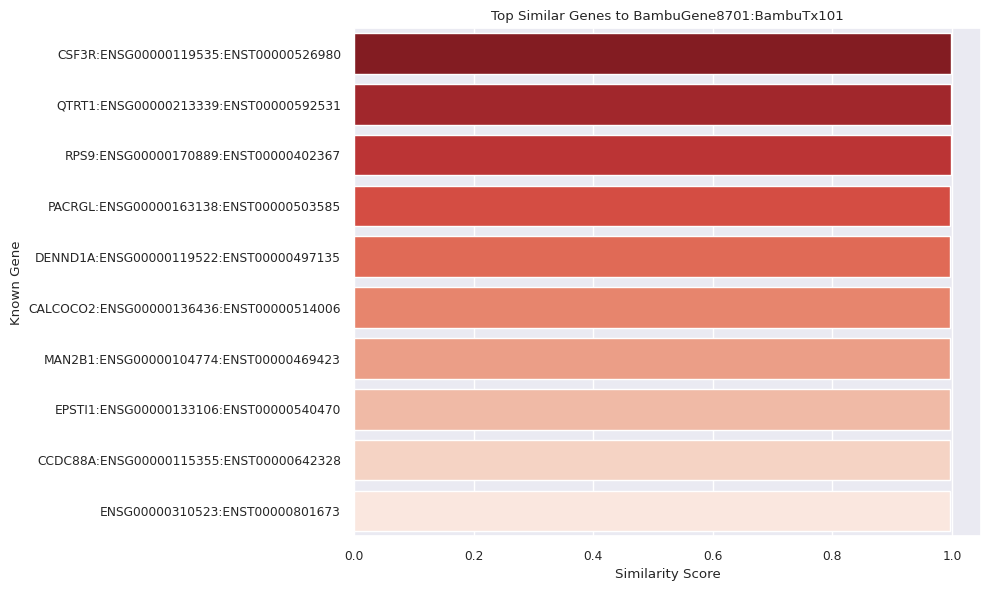

In [93]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot for Novel Genes
for novel_gene in df_novel_gene_similarities["NovelGene"].unique():
    subset = df_novel_gene_similarities[df_novel_gene_similarities["NovelGene"] == novel_gene]
    subset_sorted = subset.sort_values("Similarity", ascending=False)
    plt.figure(figsize=(10, 6))
    sns.barplot(data=subset_sorted, x="Similarity", y="KnownGene", palette="Reds_r")
    plt.xlabel("Similarity Score")
    plt.ylabel("Known Gene")
    plt.title(f"Top Similar Genes to {novel_gene}")
    plt.tight_layout()
    plt.show()

In [115]:
import pandas as pd
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming expr_avg is already defined elsewhere and contains expression data

# Calculate similarities for each novel isoform of known genes
similarity_results_novel_isoforms = []

# Filter for novel isoforms of known genes
novel_isoforms = [g for g in expr_avg.index if ("ENSG" in g and "BambuTx" in g)]

for novel_isoform in tqdm(novel_isoforms, desc="Calculating similarities for Novel Isoforms"):
    target_expr = expr_avg.loc[novel_isoform]
    
    # Filter for sibling isoforms (same gene ENSG part but different BambuTx)
    ensg_id = novel_isoform.split(":")[0]
    sibling_isoforms = [
        g for g in expr_avg.index 
        if (ensg_id in g) and (g != novel_isoform)
    ]
    sibling_expr = expr_avg.loc[sibling_isoforms]
    
    # Calculate Pearson correlation
    corr = sibling_expr.corrwith(target_expr, axis=1)
    
    # Select top 10 most similar (positive or negative)
    top_similar = corr.sort_values(ascending=False).head(10)
    
    # Save results
    for gene, score in top_similar.items():
        similarity_results_novel_isoforms.append({
            "NovelIsoform": novel_isoform,
            "SiblingIsoform": gene,
            "Similarity": score
        })

# Create DataFrame
df_novel_isoform_similarities = pd.DataFrame(similarity_results_novel_isoforms)

# Save to file
df_novel_isoform_similarities.to_csv("Intermediate_Files/NovelIsoforms_Similarities.tsv", sep="\t", index=False)
print("✅ Similarity analysis for novel isoforms complete and saved!")

Calculating similarities for Novel Isoforms: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 112.17it/s]

✅ Similarity analysis for novel isoforms complete and saved!



🔎 Novel Isoform: ENSG00000002822:BambuTx77
  - MAD1L1:ENSG00000002822:ENST00000406869 (Similarity=0.74)
  - MAD1L1:ENSG00000002822:ENST00000265854 (Similarity=0.72)
  - MAD1L1:ENSG00000002822:ENST00000399654 (Similarity=0.57)
  - MAD1L1:ENSG00000002822:ENST00000468372 (Similarity=0.42)
  - MAD1L1:ENSG00000002822:ENST00000402746 (Similarity=0.35)
  - MAD1L1:ENSG00000002822:ENST00000481633 (Similarity=0.34)
  - MAD1L1:ENSG00000002822:ENST00000496548 (Similarity=0.29)
  - MAD1L1:ENSG00000002822:ENST00000437877 (Similarity=-0.18)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000002822_BambuTx77_similarity.pdf


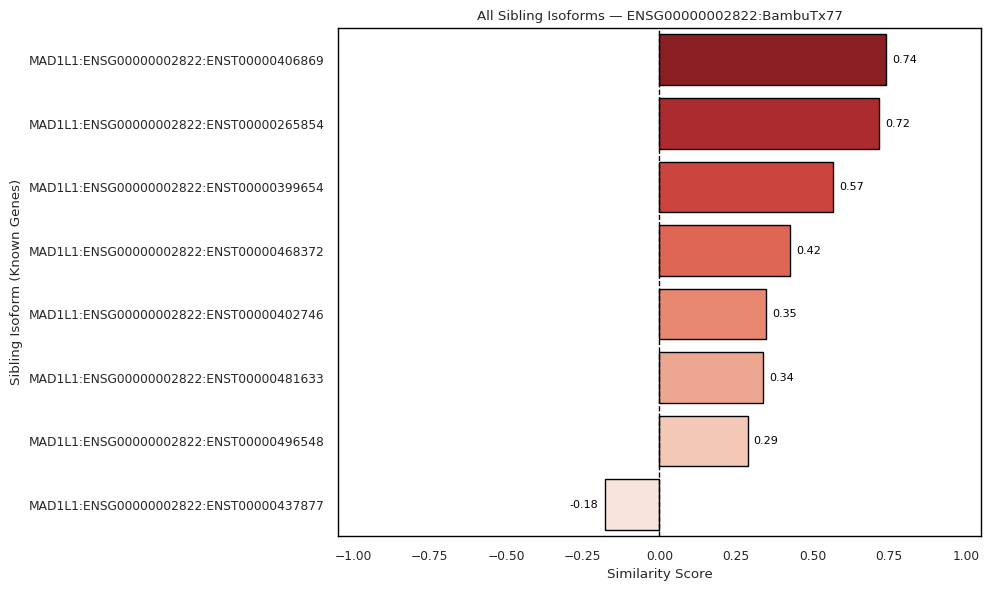


🔎 Novel Isoform: ENSG00000107014:BambuTx87
  - RLN2:ENSG00000107014:ENST00000416837 (Similarity=0.73)
  - RLN2:ENSG00000107014:ENST00000381627 (Similarity=0.67)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000107014_BambuTx87_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


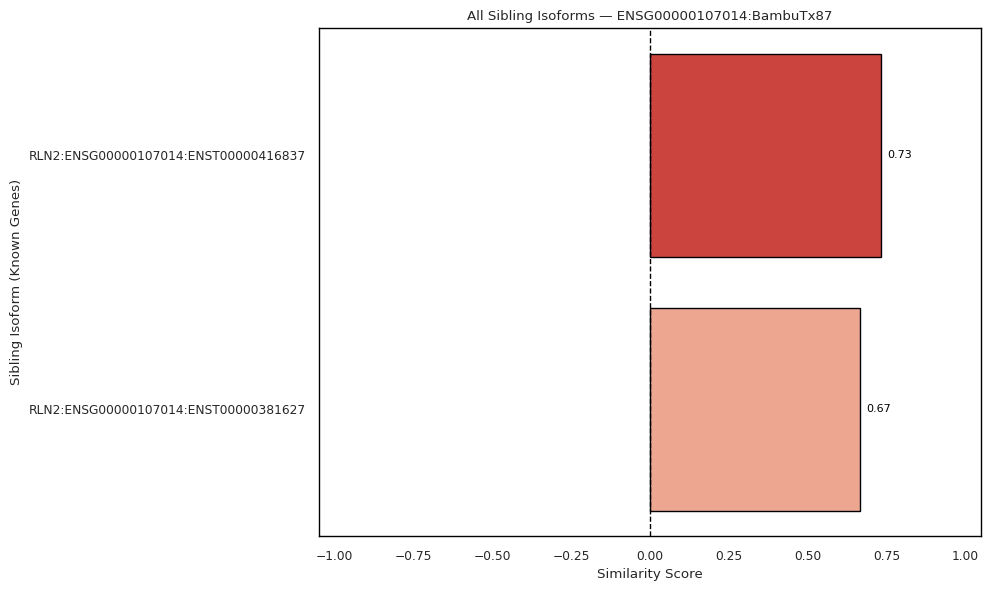

/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(



🔎 Novel Isoform: ENSG00000107018:BambuTx88
  - RLN1:ENSG00000107018:ENST00000487557 (Similarity=-0.72)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000107018_BambuTx88_similarity.pdf


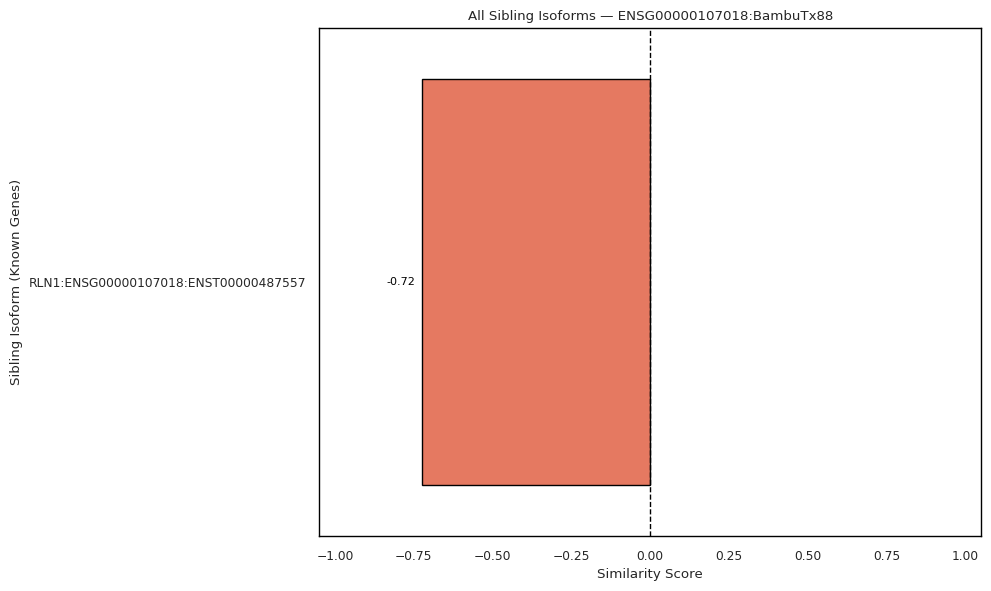


🔎 Novel Isoform: ENSG00000127249:BambuTx60
  - ATP13A4:ENSG00000127249:ENST00000342695 (Similarity=0.37)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000127249_BambuTx60_similarity.pdf


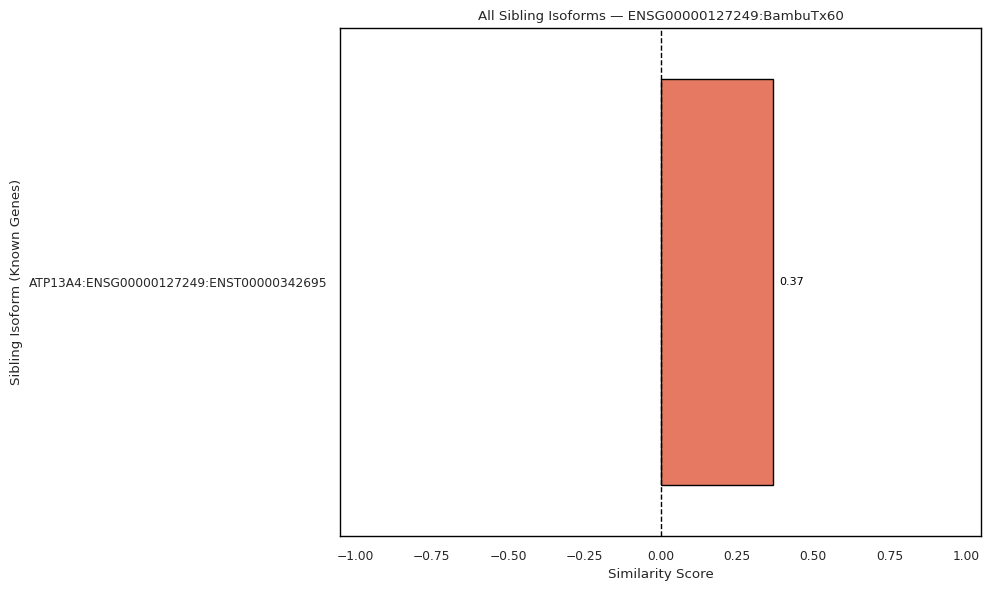


🔎 Novel Isoform: ENSG00000135951:BambuTx47
  - TSGA10:ENSG00000135951:ENST00000498097 (Similarity=0.57)
  - TSGA10:ENSG00000135951:ENST00000409564 (Similarity=0.49)
  - TSGA10:ENSG00000135951:ENST00000674128 (Similarity=0.45)
  - TSGA10:ENSG00000135951:ENST00000464459 (Similarity=0.38)
  - TSGA10:ENSG00000135951:ENST00000489348 (Similarity=0.20)
  - TSGA10:ENSG00000135951:ENST00000410001 (Similarity=0.08)
  - TSGA10:ENSG00000135951:ENST00000465216 (Similarity=0.07)
  - TSGA10:ENSG00000135951:ENST00000393482 (Similarity=0.00)
  - TSGA10:ENSG00000135951:ENST00000393483 (Similarity=0.00)
  - TSGA10:ENSG00000135951:ENST00000483914 (Similarity=-0.11)
  - TSGA10:ENSG00000135951:ENST00000355053 (Similarity=-0.13)
  - TSGA10:ENSG00000135951:ENST00000478090 (Similarity=-0.29)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000135951_BambuTx47_similarity.pdf


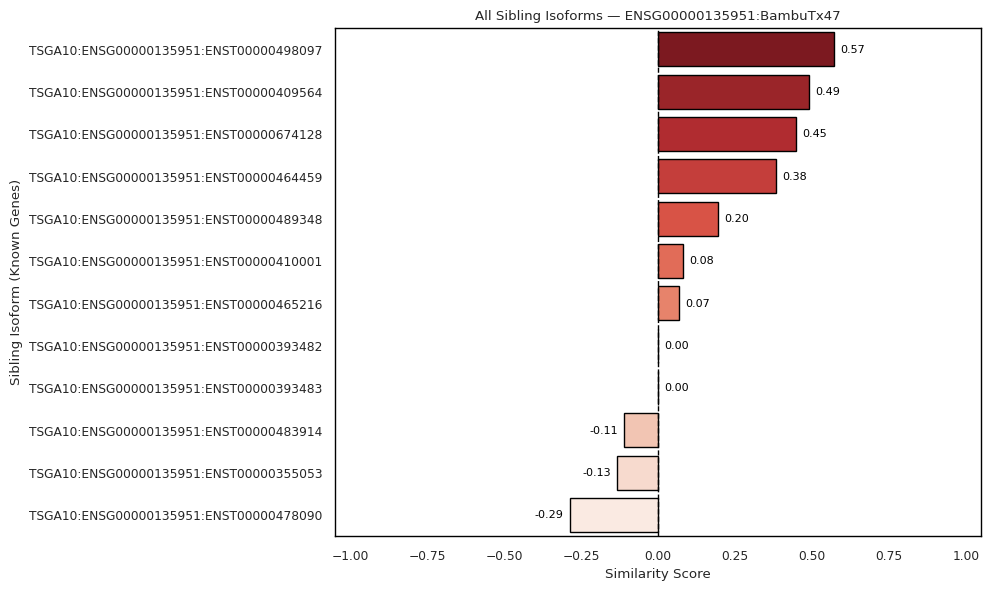


🔎 Novel Isoform: ENSG00000145220:BambuTx64
  - LYAR:ENSG00000145220:ENST00000343470 (Similarity=0.95)
  - LYAR:ENSG00000145220:ENST00000502917 (Similarity=0.70)
  - LYAR:ENSG00000145220:ENST00000452476 (Similarity=0.35)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000145220_BambuTx64_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


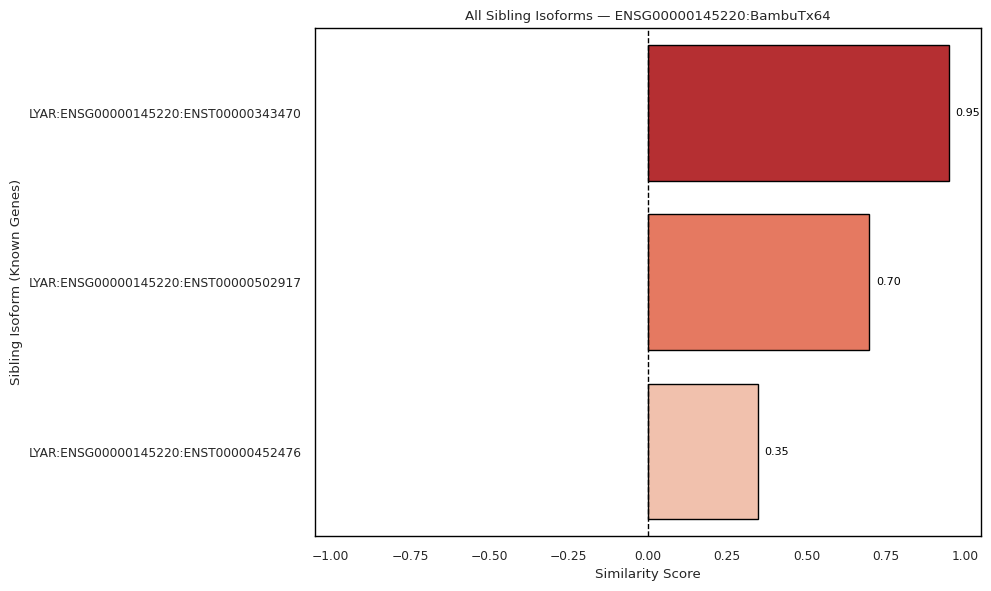


🔎 Novel Isoform: ENSG00000166295:BambuTx14
  - ENSG00000166295:BambuTx15 (Similarity=0.73)
  - ANAPC16:ENSG00000166295:ENST00000299381 (Similarity=0.69)
  - ANAPC16:ENSG00000166295:ENST00000478193 (Similarity=0.37)
  - ANAPC16:ENSG00000166295:ENST00000621663 (Similarity=0.34)
  - ANAPC16:ENSG00000166295:ENST00000470481 (Similarity=-0.34)
  - ANAPC16:ENSG00000166295:ENST00000615507 (Similarity=-0.35)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000166295_BambuTx14_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


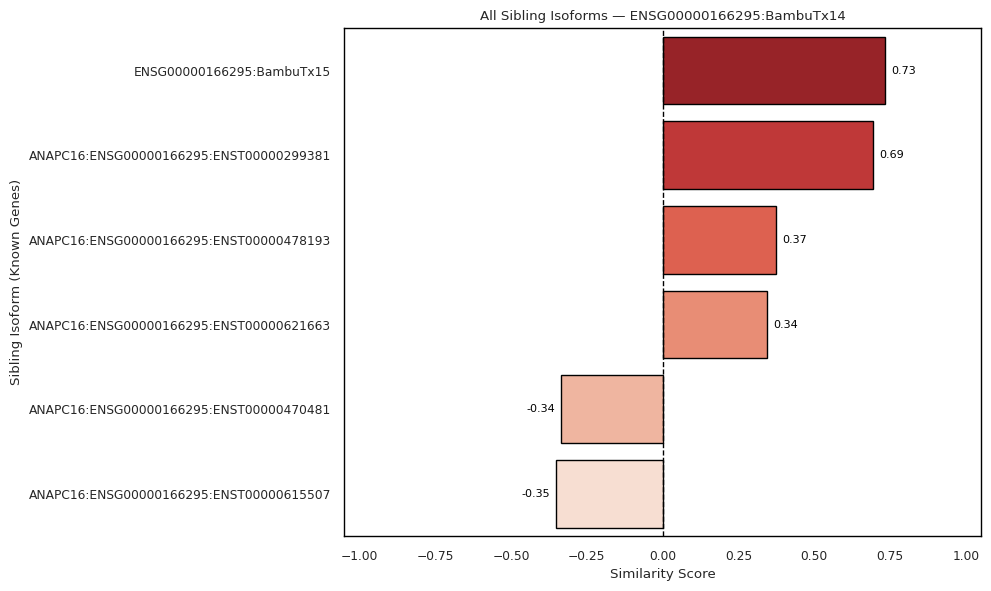


🔎 Novel Isoform: ENSG00000166295:BambuTx15
  - ANAPC16:ENSG00000166295:ENST00000299381 (Similarity=0.90)
  - ANAPC16:ENSG00000166295:ENST00000621663 (Similarity=0.87)
  - ENSG00000166295:BambuTx14 (Similarity=0.73)
  - ANAPC16:ENSG00000166295:ENST00000478193 (Similarity=0.66)
  - ANAPC16:ENSG00000166295:ENST00000470481 (Similarity=0.02)
  - ANAPC16:ENSG00000166295:ENST00000615507 (Similarity=-0.01)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000166295_BambuTx15_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


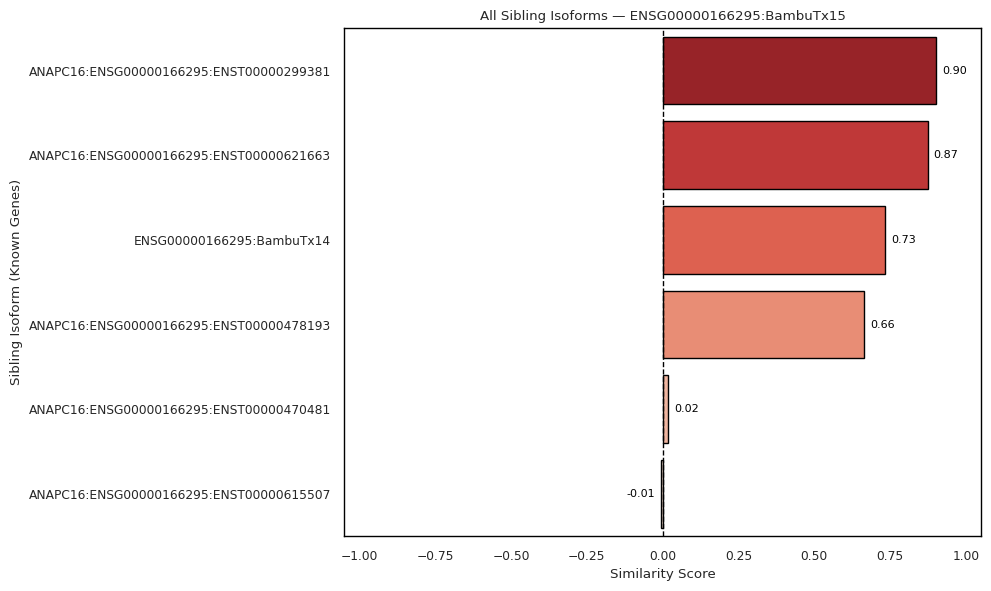


🔎 Novel Isoform: ENSG00000176160:BambuTx110
  - HSF5:ENSG00000176160:ENST00000323777 (Similarity=-0.30)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000176160_BambuTx110_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


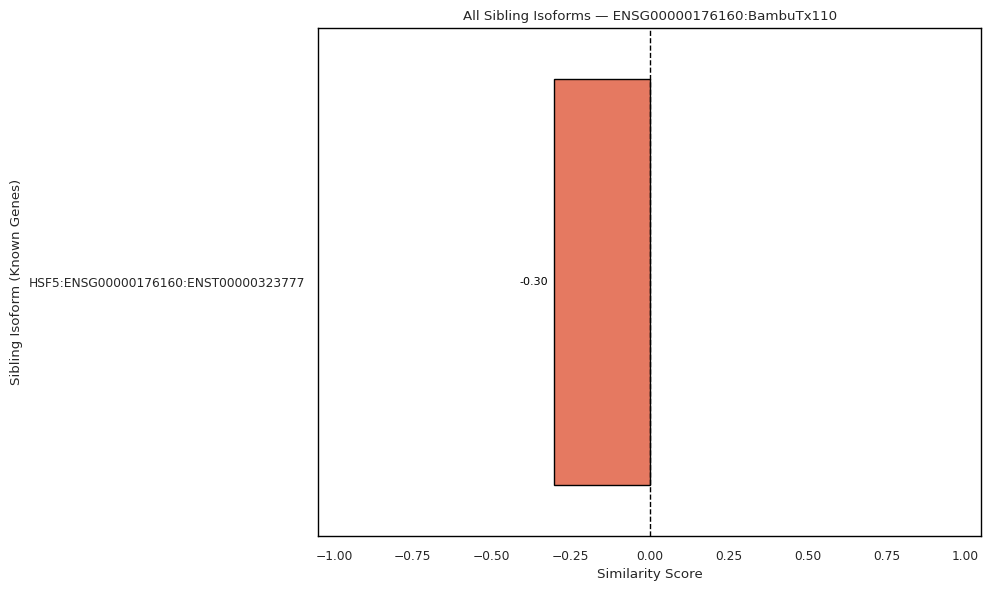


🔎 Novel Isoform: ENSG00000187118:BambuTx55
  - CMC1:ENSG00000187118:ENST00000482499 (Similarity=0.89)
  - CMC1:ENSG00000187118:ENST00000396610 (Similarity=0.86)
  - CMC1:ENSG00000187118:ENST00000468330 (Similarity=0.85)
  - CMC1:ENSG00000187118:ENST00000469102 (Similarity=0.82)
  - CMC1:ENSG00000187118:ENST00000423894 (Similarity=0.77)
  - CMC1:ENSG00000187118:ENST00000477739 (Similarity=0.63)
  - CMC1:ENSG00000187118:ENST00000418849 (Similarity=0.59)
  - CMC1:ENSG00000187118:ENST00000466830 (Similarity=0.56)
  - CMC1:ENSG00000187118:ENST00000334841 (Similarity=0.19)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000187118_BambuTx55_similarity.pdf


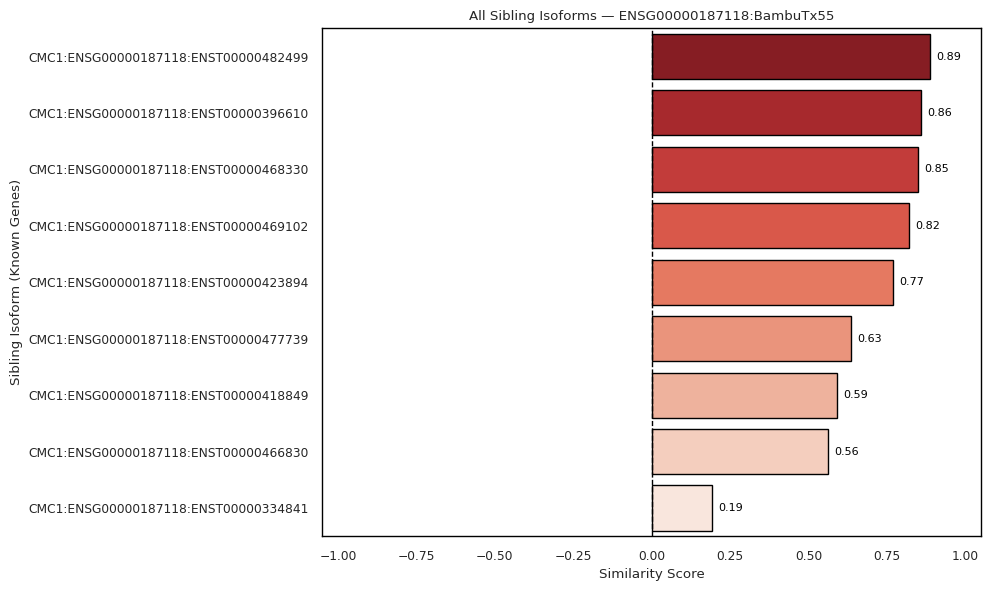


🔎 Novel Isoform: ENSG00000196236:BambuTx52
  - XPNPEP3:ENSG00000196236:ENST00000482652 (Similarity=-0.02)
  - XPNPEP3:ENSG00000196236:ENST00000428799 (Similarity=-0.27)
  - XPNPEP3:ENSG00000196236:ENST00000357137 (Similarity=-0.36)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000196236_BambuTx52_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


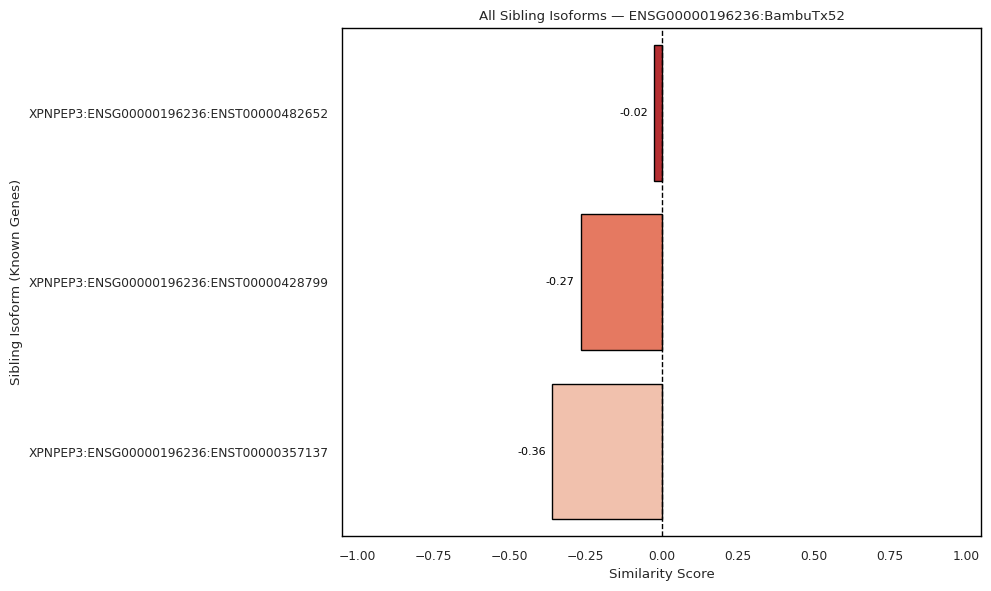


🔎 Novel Isoform: ENSG00000196284:BambuTx73
  - SUPT3H:ENSG00000196284:ENST00000371459 (Similarity=0.71)
  - SUPT3H:ENSG00000196284:ENST00000475057 (Similarity=0.56)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000196284_BambuTx73_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


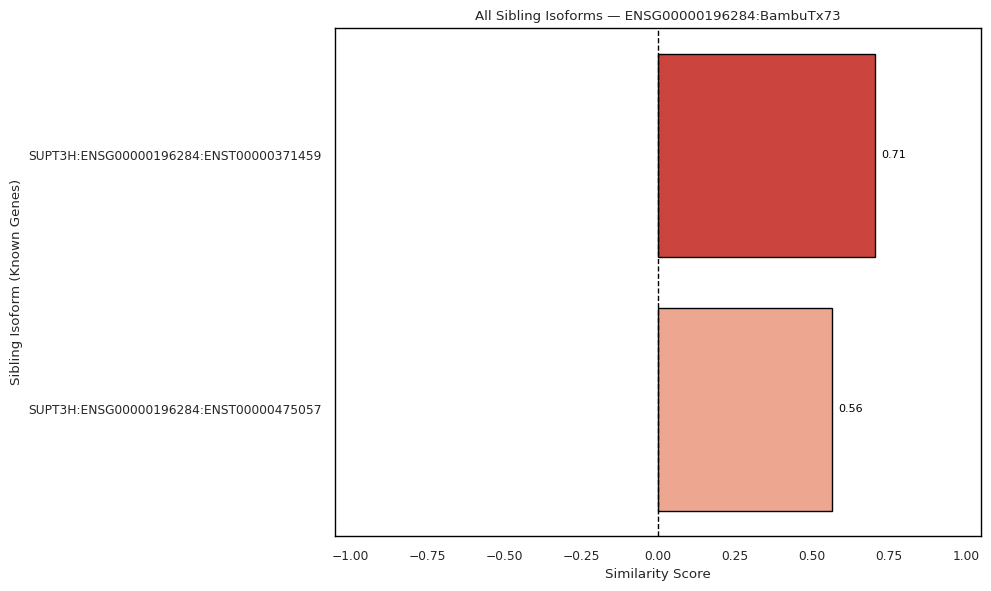

/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(



🔎 Novel Isoform: ENSG00000211677:BambuTx48
  - IGLC2:ENSG00000211677:ENST00000390323 (Similarity=0.98)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000211677_BambuTx48_similarity.pdf


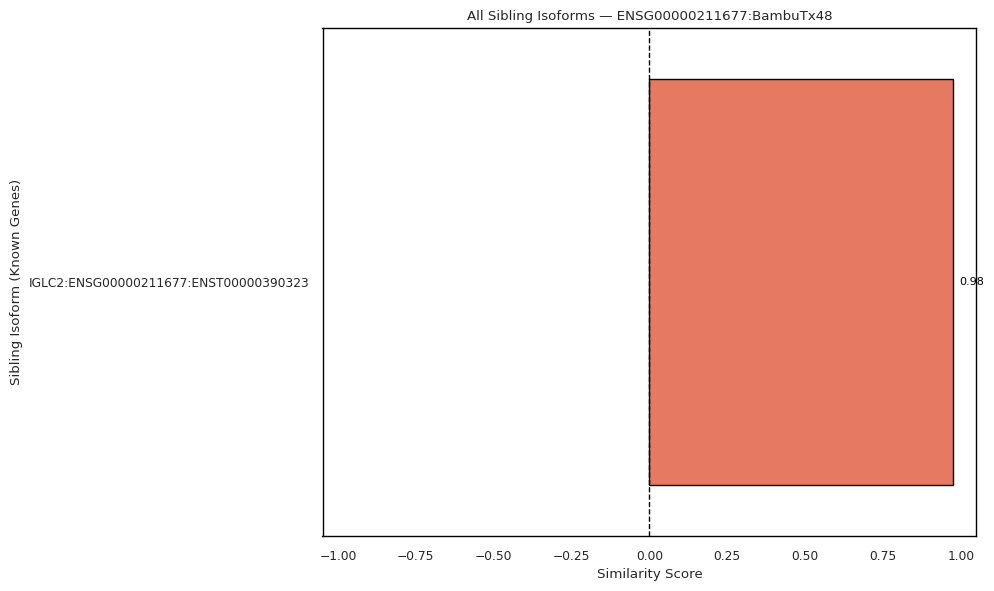


🔎 Novel Isoform: ENSG00000215375:BambuTx61
  - MYL5:ENSG00000215375:ENST00000503300 (Similarity=0.94)
  - MYL5:ENSG00000215375:ENST00000400159 (Similarity=0.79)
  - MYL5:ENSG00000215375:ENST00000506838 (Similarity=0.75)
  - MYL5:ENSG00000215375:ENST00000511290 (Similarity=0.72)
  - MYL5:ENSG00000215375:ENST00000503612 (Similarity=0.70)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000215375_BambuTx61_similarity.pdf


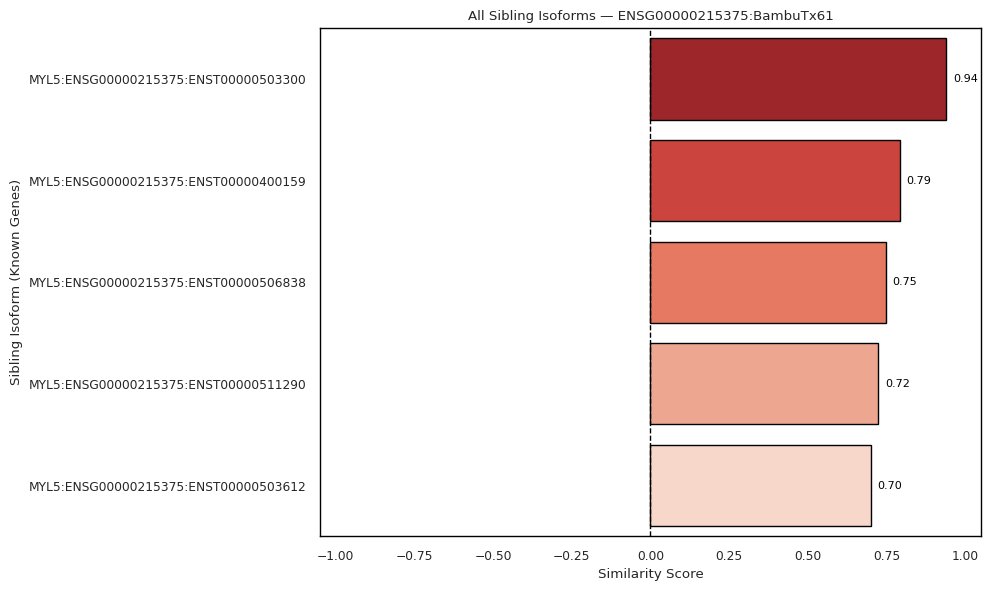


🔎 Novel Isoform: ENSG00000243449:BambuTx63
  - NICOL1:ENSG00000243449:ENST00000409248 (Similarity=0.49)
  - NICOL1:ENSG00000243449:ENST00000409860 (Similarity=0.47)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000243449_BambuTx63_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


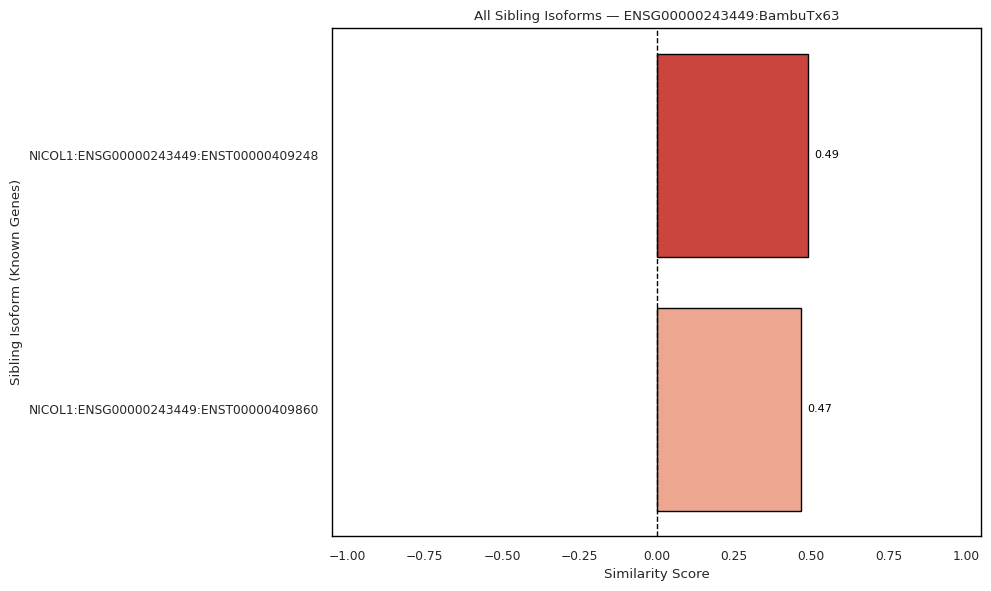

/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(



🔎 Novel Isoform: ENSG00000243829:BambuTx106
  - ENSG00000243829:BambuTx111 (Similarity=0.04)
  - ENSG00000243829:BambuTx113 (Similarity=-0.18)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000243829_BambuTx106_similarity.pdf


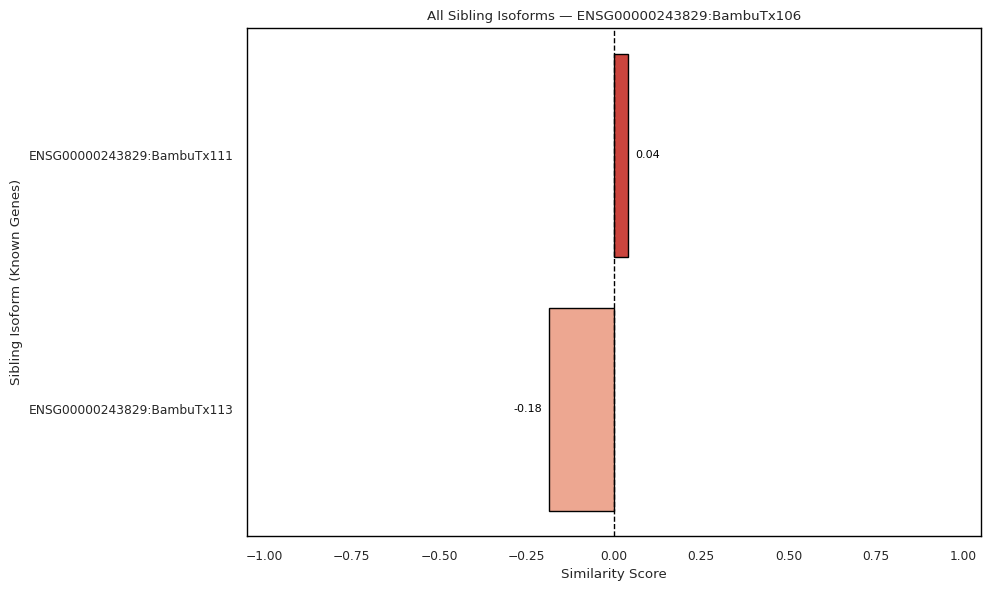

/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(



🔎 Novel Isoform: ENSG00000243829:BambuTx111
  - ENSG00000243829:BambuTx113 (Similarity=0.44)
  - ENSG00000243829:BambuTx106 (Similarity=0.04)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000243829_BambuTx111_similarity.pdf


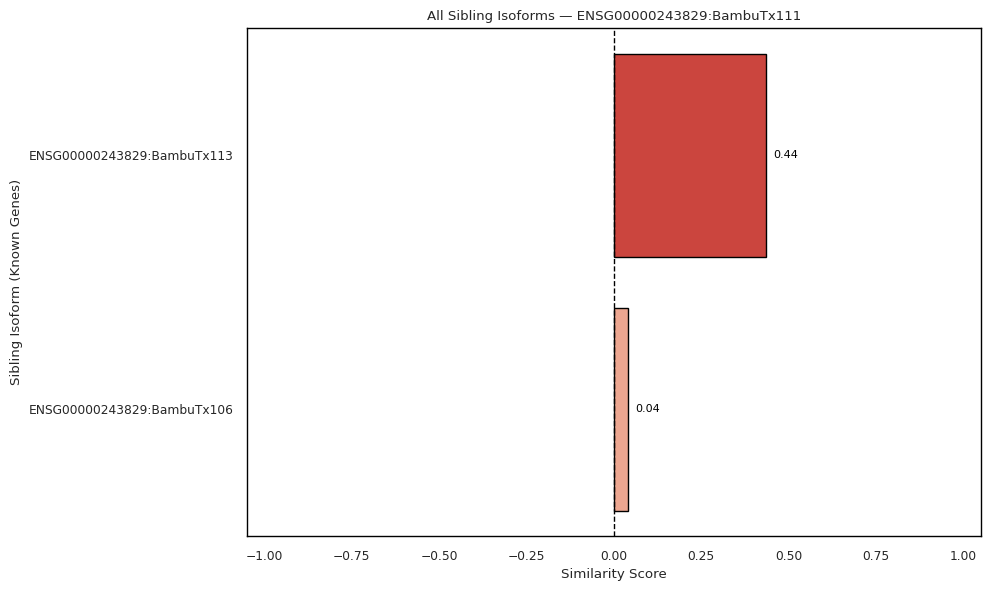

/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(



🔎 Novel Isoform: ENSG00000243829:BambuTx113
  - ENSG00000243829:BambuTx111 (Similarity=0.44)
  - ENSG00000243829:BambuTx106 (Similarity=-0.18)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000243829_BambuTx113_similarity.pdf


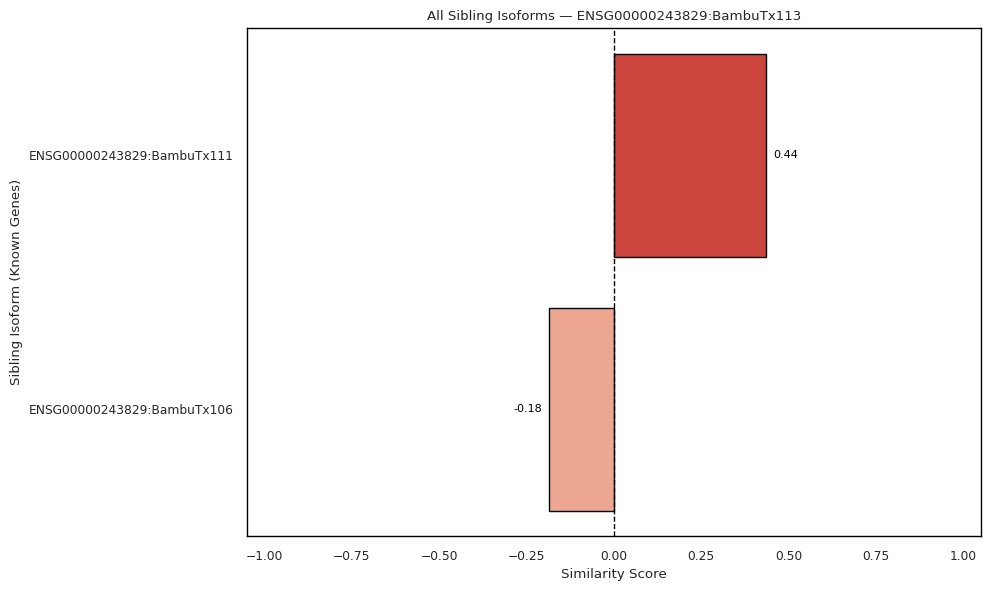


🔎 Novel Isoform: ENSG00000253409:BambuTx81
  - TRBV7-4:ENSG00000253409:ENST00000390369 (Similarity=1.00)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000253409_BambuTx81_similarity.pdf


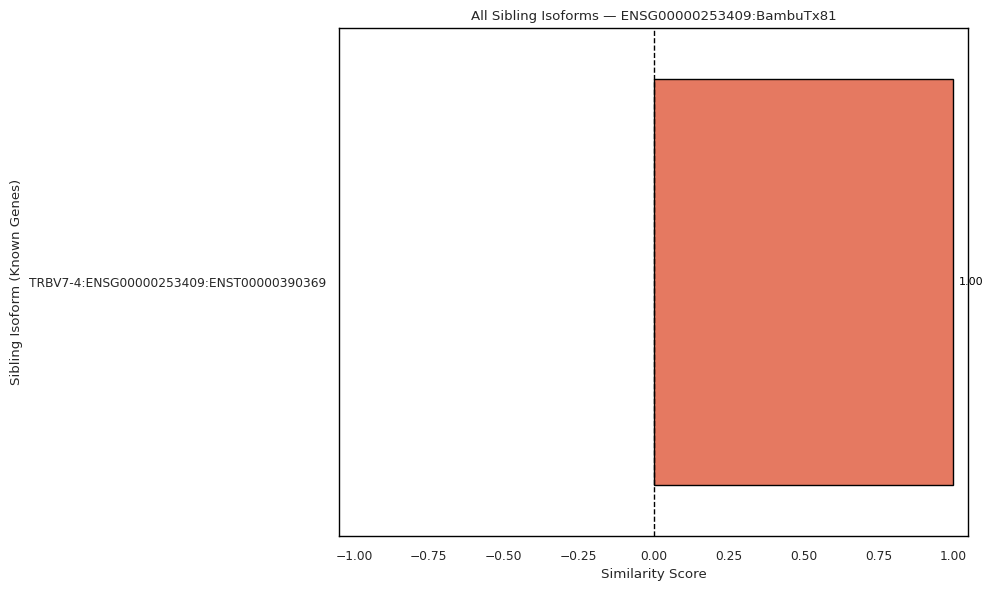


🔎 Novel Isoform: ENSG00000261351:BambuTx30
  - ENSG00000261351:ENST00000565387 (Similarity=0.49)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000261351_BambuTx30_similarity.pdf


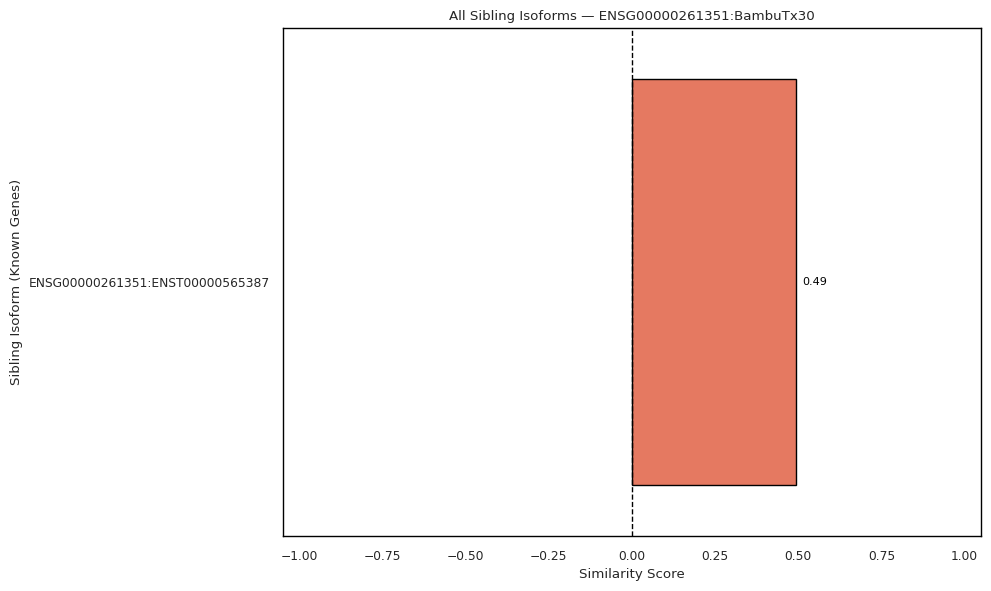


🔎 Novel Isoform: ENSG00000271447:BambuTx36
  - MMP28:ENSG00000271447:ENST00000605424 (Similarity=0.71)
  - MMP28:ENSG00000271447:ENST00000612672 (Similarity=-0.04)
  - MMP28:ENSG00000271447:ENST00000616383 (Similarity=-0.10)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000271447_BambuTx36_similarity.pdf


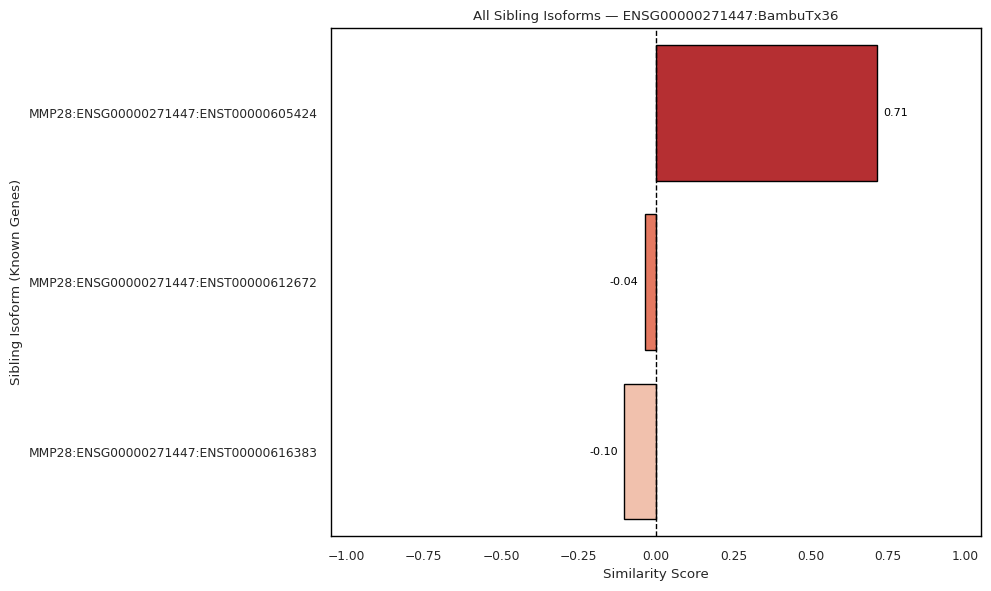


🔎 Novel Isoform: ENSG00000289746:BambuTx78
  - TARP:ENSG00000289746:ENST00000698248 (Similarity=0.89)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000289746_BambuTx78_similarity.pdf


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


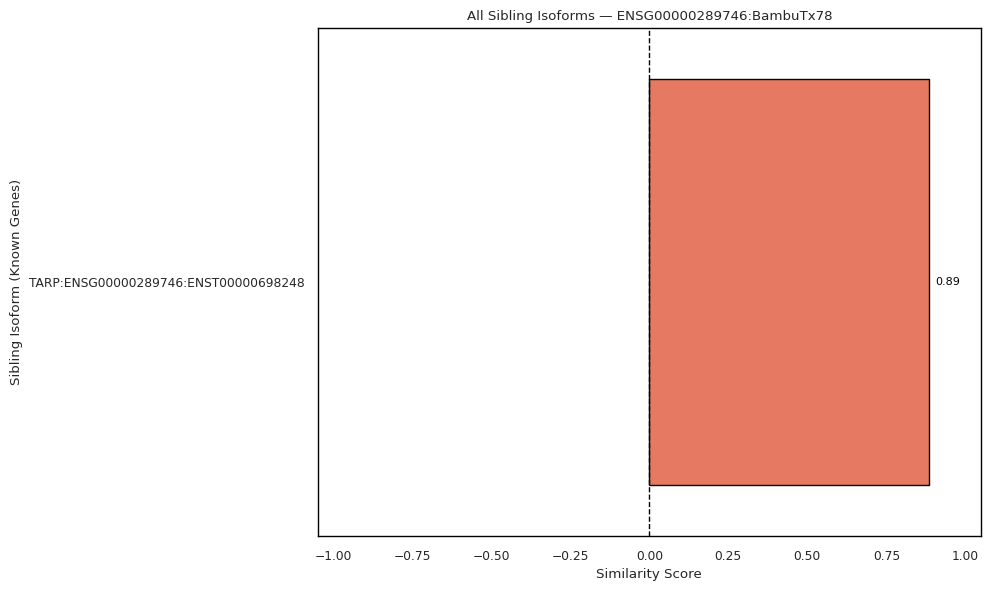


🔎 Novel Isoform: ENSG00000294968:BambuTx51
  - ENSG00000294968:ENST00000727103 (Similarity=0.46)
  - ENSG00000294968:ENST00000727104 (Similarity=0.09)
  - ENSG00000294968:ENST00000727105 (Similarity=0.07)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000294968_BambuTx51_similarity.pdf


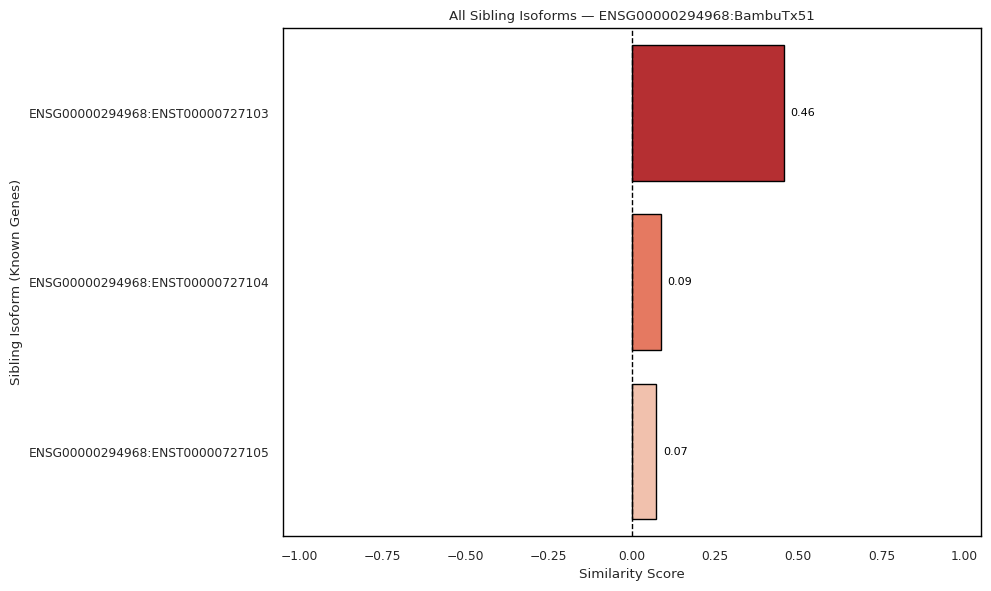

/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(



🔎 Novel Isoform: ENSG00000308813:BambuTx75
  - ENSG00000308813:ENST00000836544 (Similarity=0.08)
✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000308813_BambuTx75_similarity.pdf


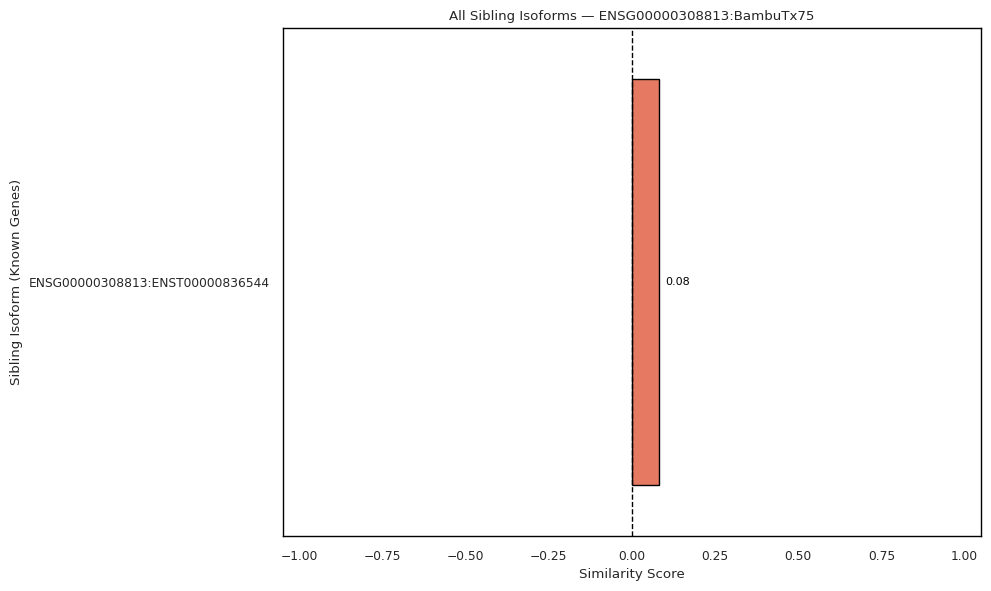


🔎 Novel Isoform: ENSG00000309098:BambuTx2
  - ENSG00000309098:ENST00000838594 (Similarity=0.75)


/tmp/ipykernel_3152855/2119223376.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


✅ Saved plot: Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_ENSG00000309098_BambuTx2_similarity.pdf


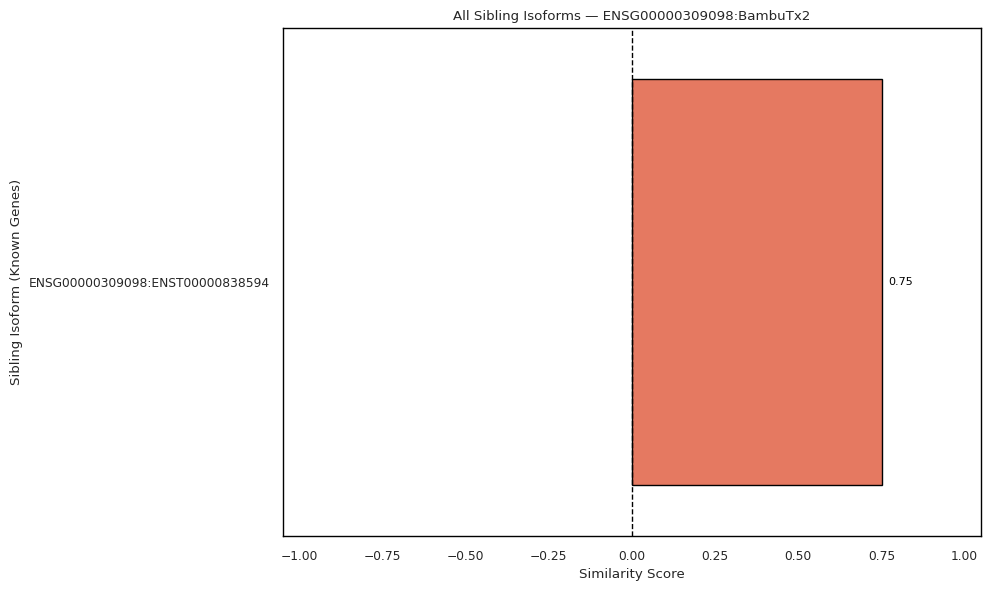

In [128]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Create output directory if it doesn't exist
output_dir = "Intermediate_Files/Paper_Figs/SimilarityPlots"
os.makedirs(output_dir, exist_ok=True)

for novel_isoform in df_novel_isoform_similarities["NovelIsoform"].unique():
    ensg_id = novel_isoform.split(":")[0]
    # Find all sibling isoforms (same ENSG)
    all_siblings = [g for g in expr_avg.index if ensg_id in g and g != novel_isoform]
    
    # Create a DataFrame with all siblings
    df_all_siblings = pd.DataFrame({"SiblingIsoform": all_siblings})
    df_all_siblings["NovelIsoform"] = novel_isoform
    
    # Merge with similarity scores (left join to keep all siblings)
    subset = df_all_siblings.merge(
        df_novel_isoform_similarities,
        on=["NovelIsoform", "SiblingIsoform"],
        how="left"
    ).fillna({"Similarity": 0})
    
    subset_sorted = subset.sort_values("Similarity", ascending=False)
    
    # Print results
    print(f"\n🔎 Novel Isoform: {novel_isoform}")
    for idx, row in subset_sorted.iterrows():
        print(f"  - {row['SiblingIsoform']} (Similarity={row['Similarity']:.2f})")
    
    fig, ax = plt.subplots(figsize=(10, 6), facecolor='white')
    ax.set_facecolor('white')
    
    barplot = sns.barplot(
        data=subset_sorted,
        x="Similarity",
        y="SiblingIsoform",
        palette="Reds_r",
        ax=ax,
        edgecolor='black'
    )
    
    ax.axvline(0, color='black', linewidth=1, linestyle='--')
    ax.set_xticks(np.arange(-1, 1.1, 0.25))
    ax.set_xlim(-1.05, 1.05)
    
    # Annotate each bar
    for p in barplot.patches:
        width = p.get_width()
        y = p.get_y() + p.get_height() / 2
        ha = 'left' if width >= 0 else 'right'
        offset = 0.02 if width >= 0 else -0.02
        ax.text(width + offset, y, f"{width:.2f}", ha=ha, va='center', 
                fontsize=8, color='black', clip_on=False)
    
    plt.xlabel("Similarity Score")
    plt.ylabel("Sibling Isoform (Known Genes)")
    plt.title(f"All Sibling Isoforms — {novel_isoform}")
    
    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color('black')
        spine.set_linewidth(1)
    
    plt.tight_layout()
    
    # Save the figure
    safe_name = novel_isoform.replace(":", "_")
    output_path = os.path.join(output_dir, f"NovelIsoform_{safe_name}_similarity.pdf")
    plt.savefig(output_path, dpi=600, transparent=True, bbox_inches="tight")
    print(f"✅ Saved plot: {output_path}")
    
    # Show the figure immediately
    plt.show()
    
    # Close the figure to avoid overlap
    plt.close()

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


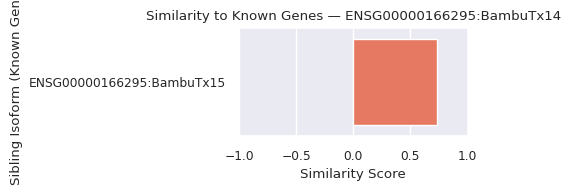

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


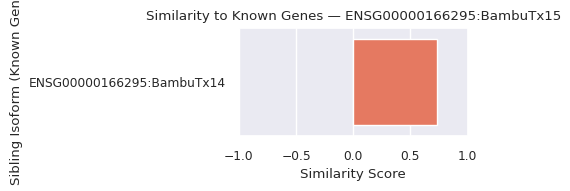

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


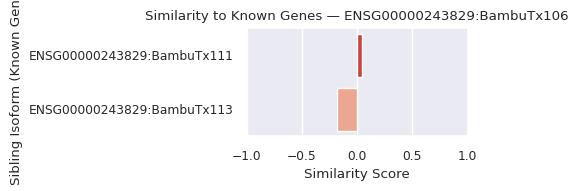

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


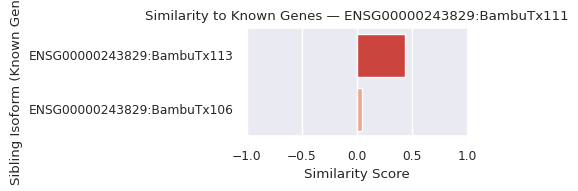

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


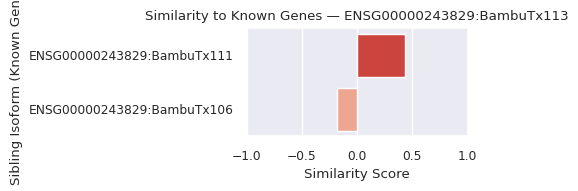

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


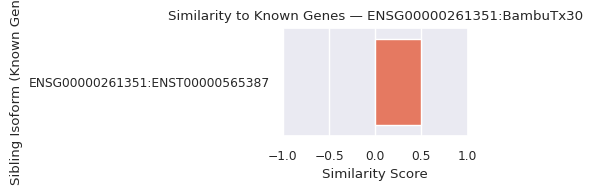

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


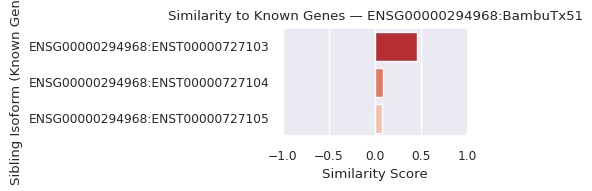

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


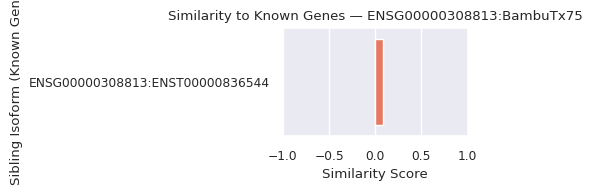

/tmp/ipykernel_3152855/595511113.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


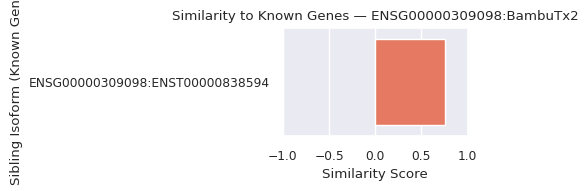

In [113]:
def is_known_gene(gene_id):
    # Return True if the gene ID contains 'ENSG' anywhere
    return "ENSG" in gene_id

# Filter known genes only
filtered_df = df_novel_isoform_similarities[
    df_novel_isoform_similarities["SiblingIsoform"].apply(is_known_gene)
]

# Plot for Novel Isoforms
for novel_isoform in filtered_df["NovelIsoform"].unique():
    subset = filtered_df[filtered_df["NovelIsoform"] == novel_isoform]
    subset_sorted = subset.sort_values("Similarity", ascending=False)
    plt.figure(figsize=(5, 2))
    sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")
    plt.xlabel("Similarity Score")
    plt.ylabel("Sibling Isoform (Known Genes)")
    plt.xlim(-1.0,1.0)
    plt.title(f"Similarity to Known Genes — {novel_isoform}")
    plt.tight_layout()
    plt.show()

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


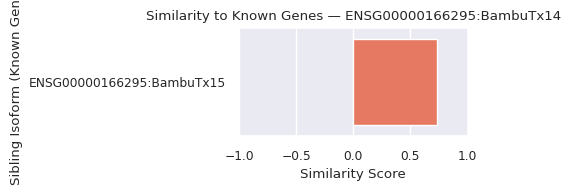

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


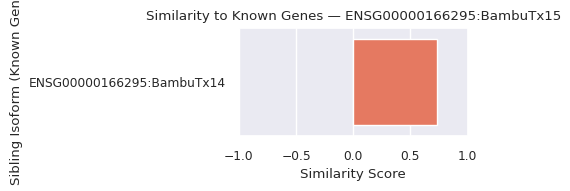

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


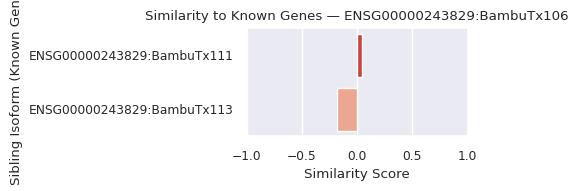

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


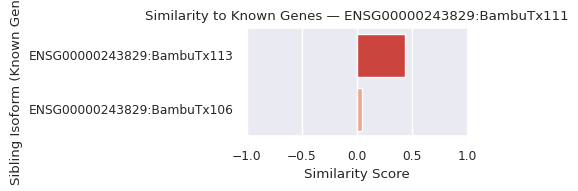

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


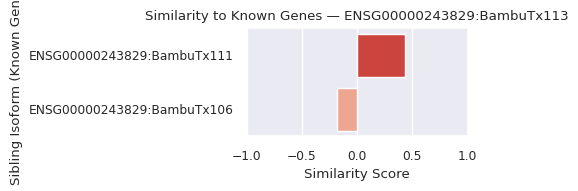

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


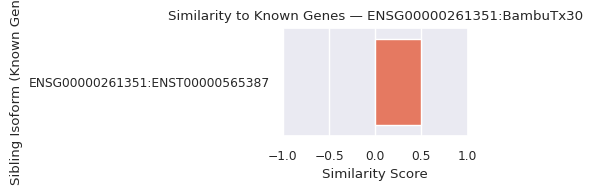

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


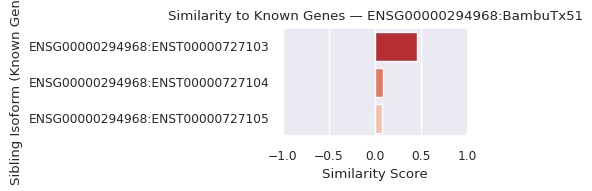

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


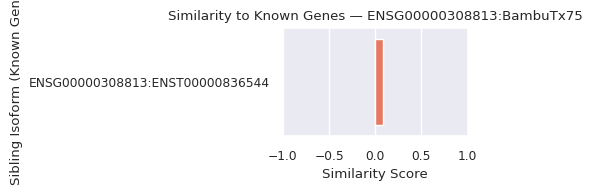

/tmp/ipykernel_3152855/2190326297.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")


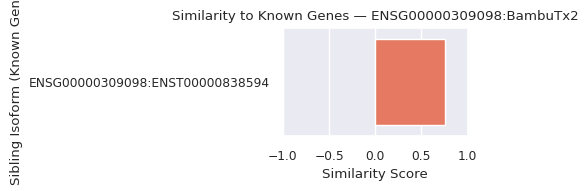

In [112]:
for novel_isoform in filtered_df["NovelIsoform"].unique():
    subset = filtered_df[filtered_df["NovelIsoform"] == novel_isoform]
    subset_sorted = subset.sort_values("Similarity", ascending=False)
    plt.figure(figsize=(5, 2))
    sns.barplot(data=subset_sorted, x="Similarity", y="SiblingIsoform", palette="Reds_r")
    plt.xlabel("Similarity Score")
    plt.ylabel("Sibling Isoform (Known Genes)")
    plt.xlim(-1.0,1.0)
    plt.title(f"Similarity to Known Genes — {novel_isoform}")
    plt.tight_layout()
    plt.show()    
    # Save plot
    safe_name = novel_isoform.replace(":", "_")
    plt.savefig(f"Intermediate_Files/Paper_Figs/SimilarityPlots/NovelIsoform_{safe_name}_similarity.pdf",
                dpi=600, transparent=True, bbox_inches="tight")
    plt.close()

In [89]:
similarity_results_novel_isoforms = []

for target_isoform in tqdm([g for g in expr_avg.index if "BambuTx" in g and g.startswith("ENSG")], desc="Calculating similarities for Novel Isoforms"):
    ensg_id = target_isoform.split(":")[0]
    siblings = [g for g in expr_avg.index if g.startswith(ensg_id) and g != target_isoform]
    
    if len(siblings) < 1:
        continue
    
    target_expr = expr_avg.loc[target_isoform]
    sibling_expr = expr_avg.loc[siblings]
    corr = sibling_expr.corrwith(target_expr, axis=1)
    
    for gene, score in corr.items():
        similarity_results_novel_isoforms.append({
            "NovelIsoform": target_isoform,
            "SiblingIsoform": gene,
            "Similarity": score
        })

df_novel_isoform_similarities = pd.DataFrame(similarity_results_novel_isoforms)

Calculating similarities for Novel Isoforms: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 99.81it/s]


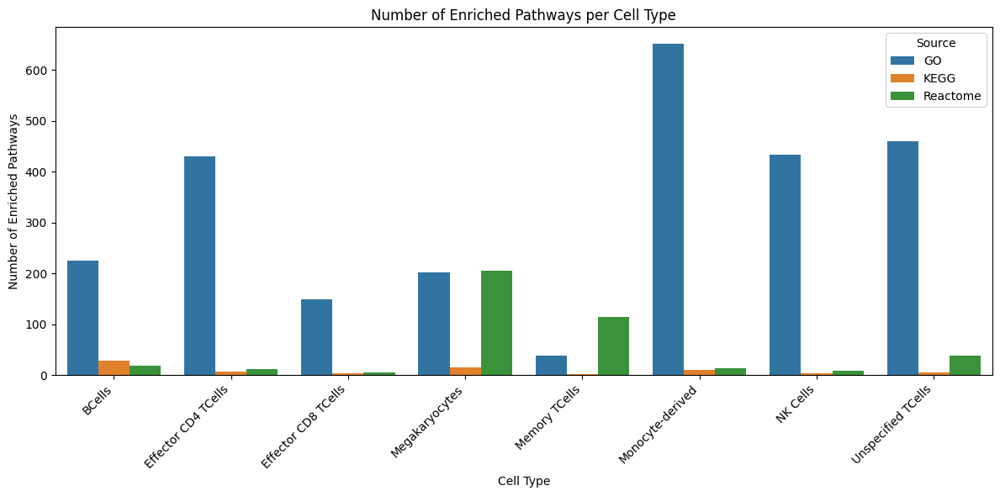

In [5]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the results
df_results = pd.read_csv("Intermediate_Files/CellType_Pathway_Enrichment_gProfiler.tsv", sep="\t")

# Filter to only Reactome, KEGG, and GO:BP
df_results = df_results[df_results["Source"].isin(["REAC", "KEGG", "GO:BP"])]

# Rename REAC to Reactome
df_results["Source"] = df_results["Source"].replace({
    "REAC": "Reactome",
    "GO:BP": "GO"  # collapse to "GO" to match your figure if needed
})

# Group by Cell Type and Source
summary = df_results.groupby(["Cell_Type", "Source"]).size().reset_index(name="Count")

# Plot
plt.figure(figsize=(12, 6))
sns.barplot(data=summary, x="Cell_Type", y="Count", hue="Source")
plt.title("Number of Enriched Pathways per Cell Type")
plt.xlabel("Cell Type")
plt.ylabel("Number of Enriched Pathways")
plt.xticks(rotation=45, ha='right')
plt.legend(title="Source")
plt.tight_layout()

plt.savefig("Intermediate_Files/Paper_Figs/enriched_pathways_per_cell_type.pdf",
            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

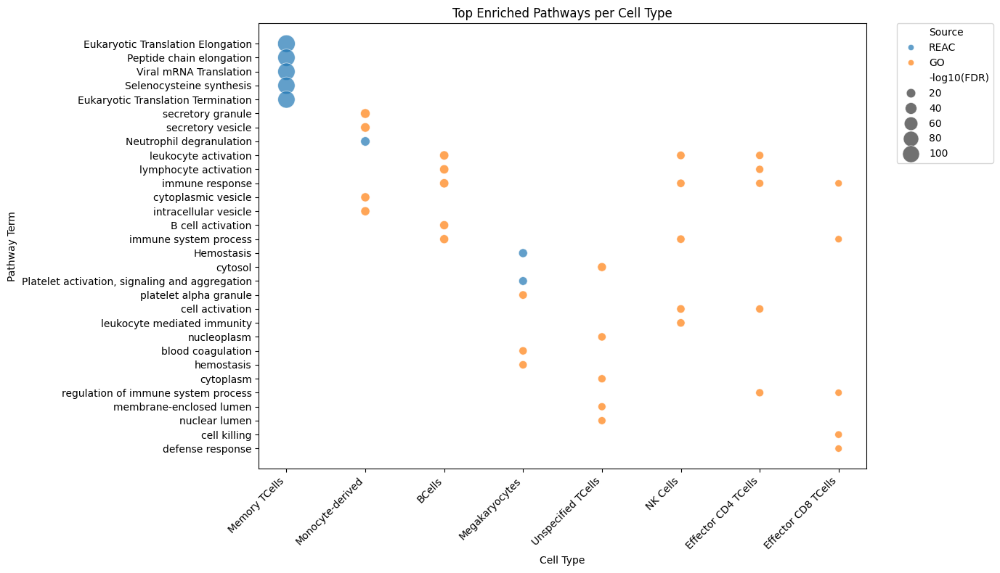

In [8]:
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Take top 5 pathways per cell type for readability
top_terms = df_results.sort_values("FDR").groupby("Cell_Type").head(5)

plt.figure(figsize=(14, 8))
sns.scatterplot(data=top_terms, x="Cell_Type", y="Term", size="-log10(FDR)", hue="Source",
                sizes=(50, 300), alpha=0.7)
plt.xlabel("Cell Type")
plt.ylabel("Pathway Term")
plt.title("Top Enriched Pathways per Cell Type")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

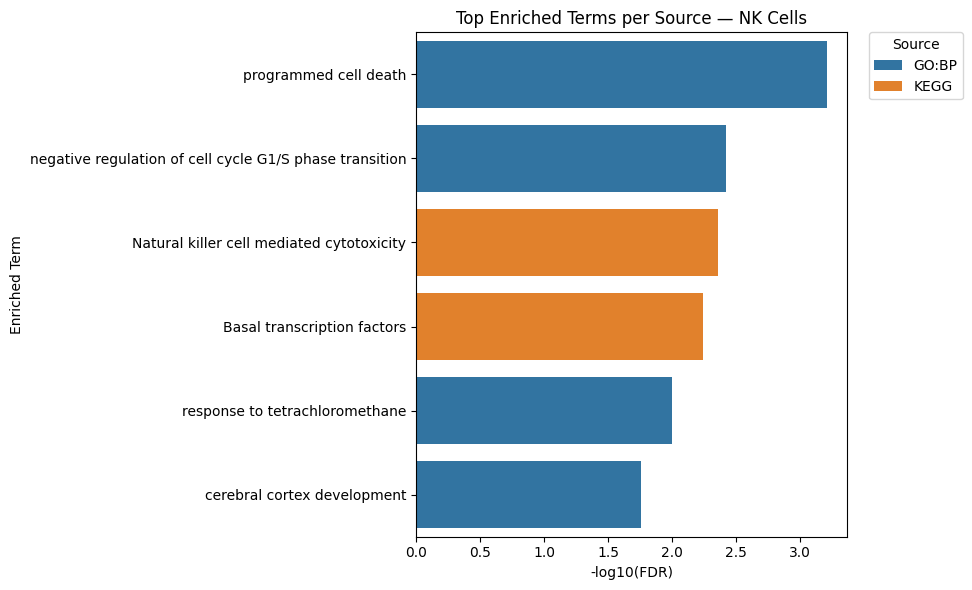

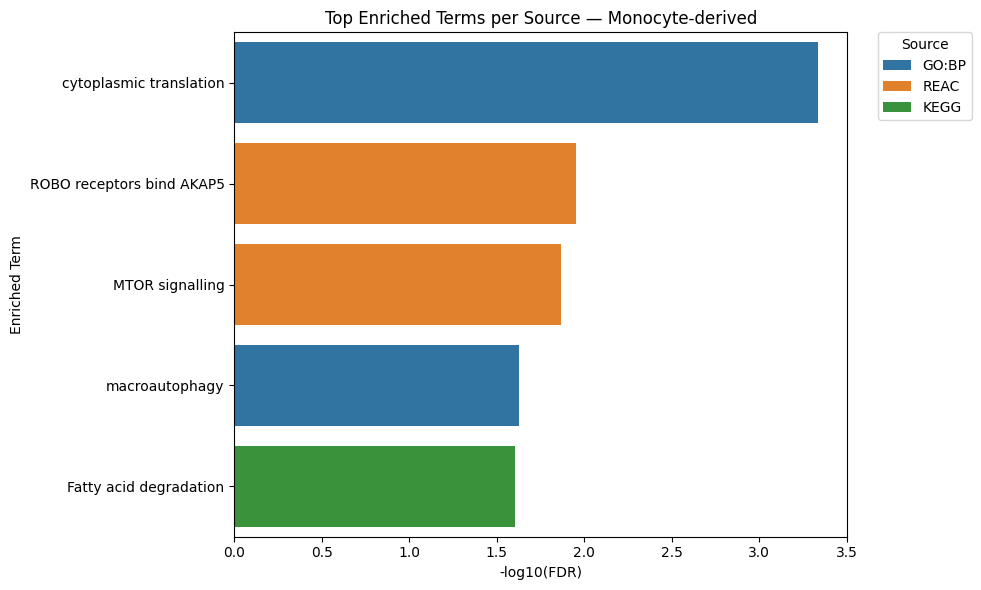

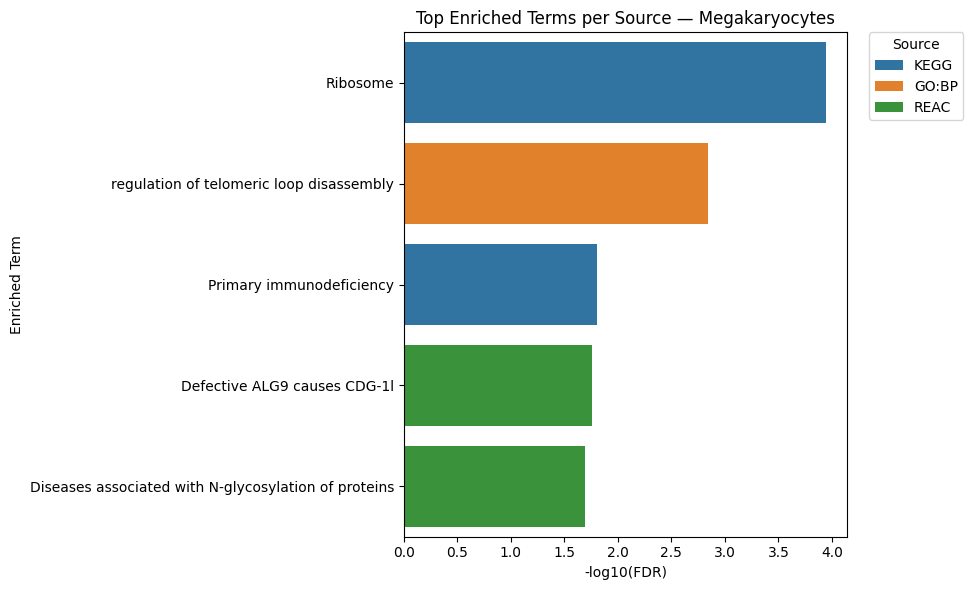

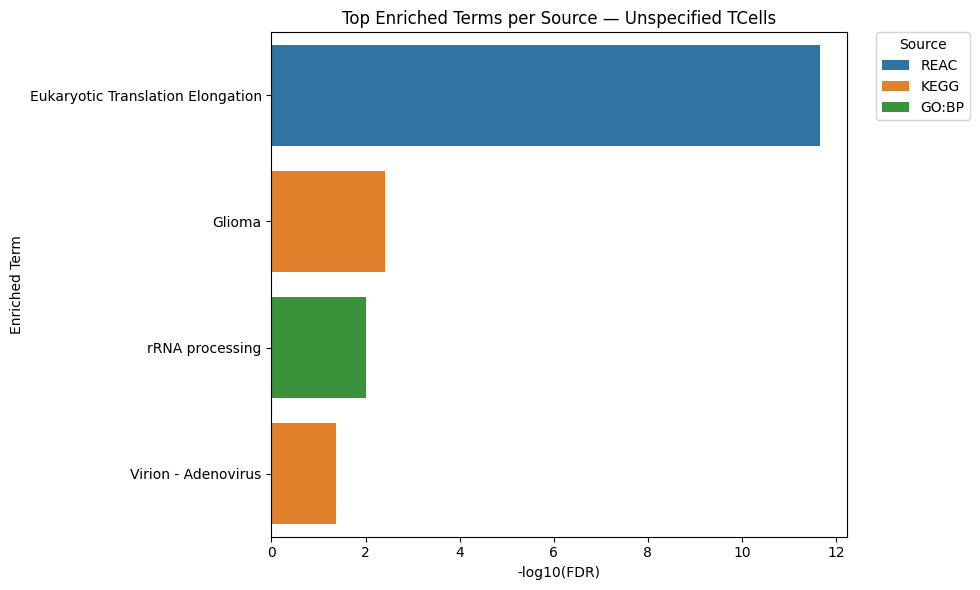

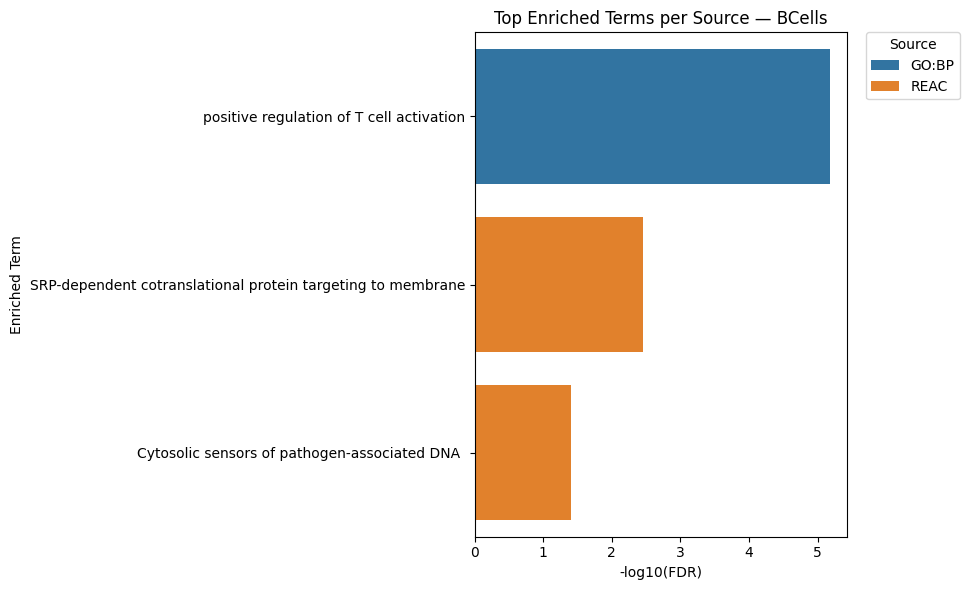

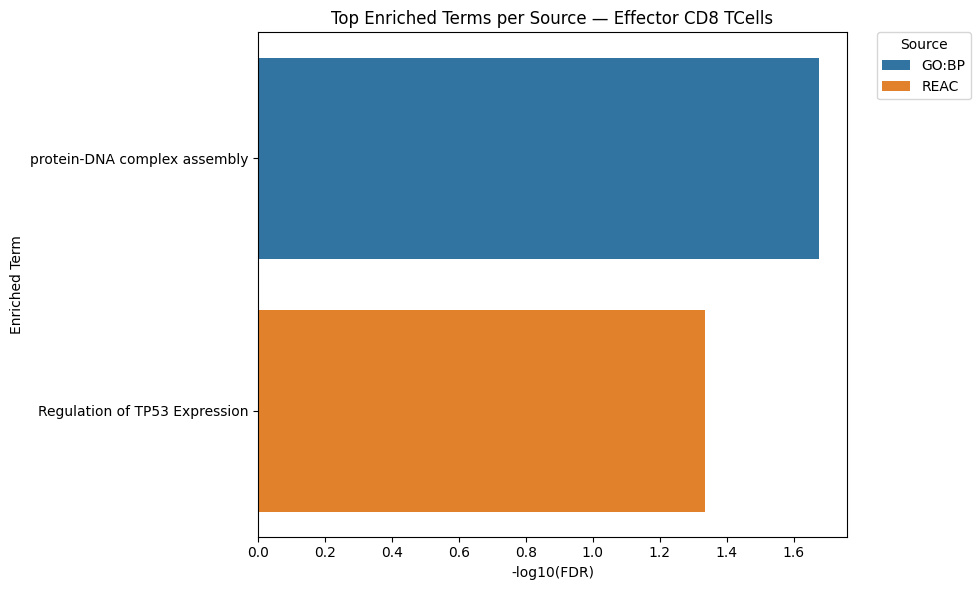

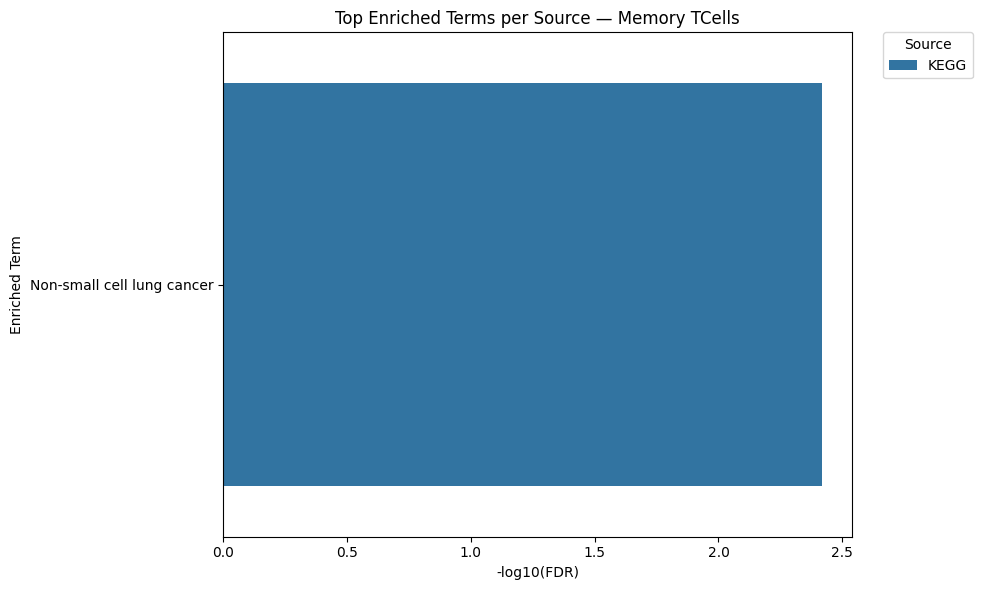

In [6]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Load gProfiler enrichment results
df_results = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Filter to only Reactome, KEGG, and GO:BP
df_results = df_results[df_results["Source"].isin(["REAC", "KEGG", "GO:BP"])]

# Calculate -log10(FDR) column
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Loop through unique cell types
for cell_type in df_results["Cell_Type"].unique():
    subset = df_results[df_results["Cell_Type"] == cell_type]

    # Select top 5 terms per source (GO, KEGG, Reactome)
    top_terms = (
        subset.sort_values("FDR")
        .groupby("Source", group_keys=False)
        .head(5)
    )

    # Order terms by ascending FDR (smaller = more significant)
    term_order = top_terms.sort_values("FDR")["Term"].unique()

    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=top_terms,
        y="Term",
        x="-log10(FDR)",
        hue="Source",
        order=term_order
    )
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.title(f"Top Enriched Terms per Source — {cell_type}")
    plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.tight_layout()
    plt.show()

/tmp/ipykernel_3042557/2183361728.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered["Source"] = df_filtered["Source"].replace({"REAC": "Reactome"})


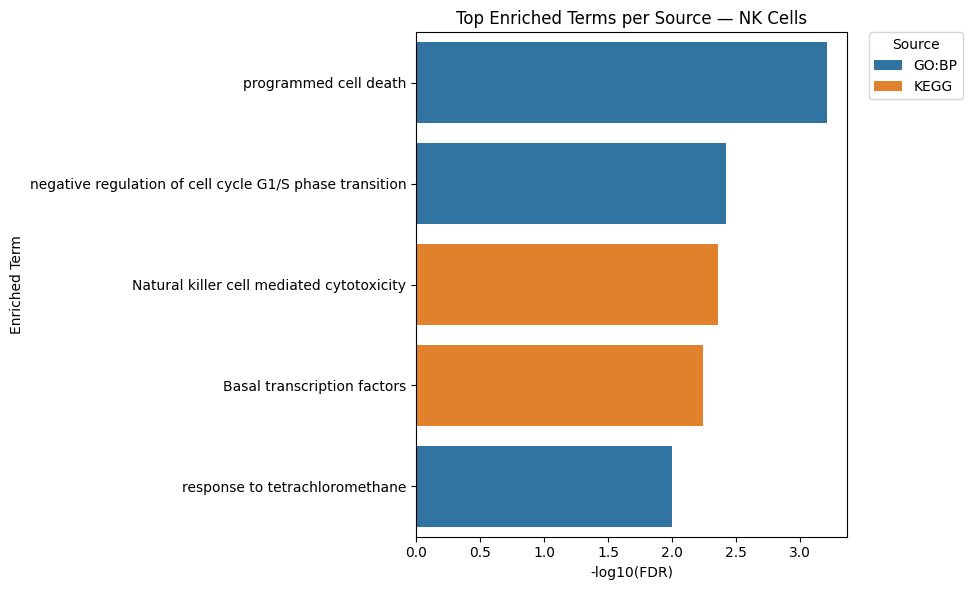

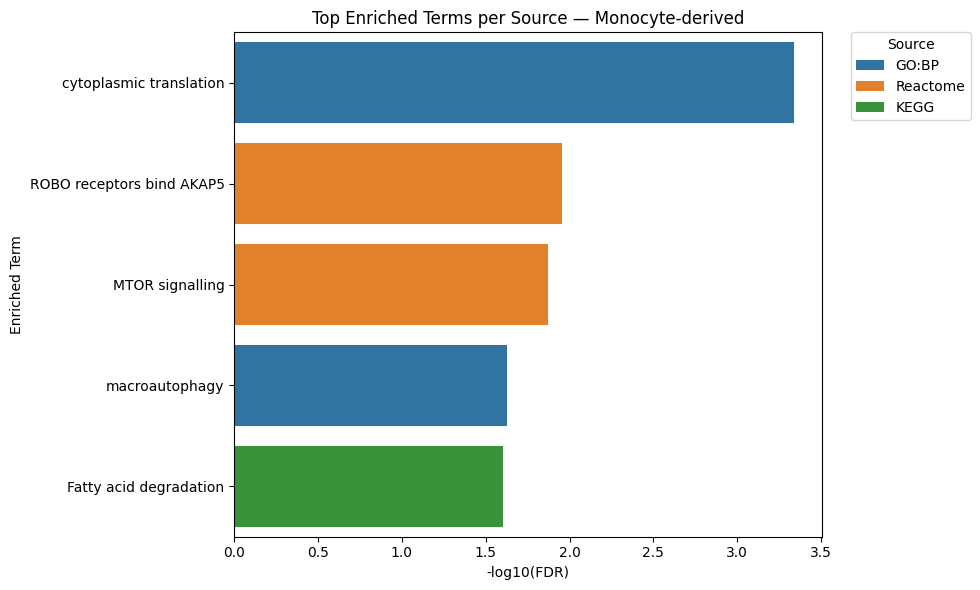

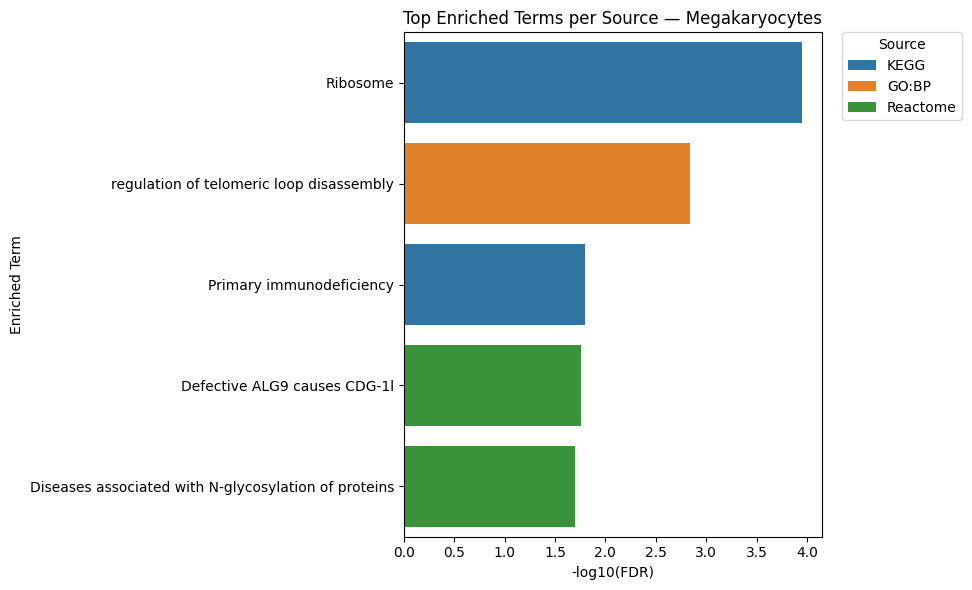

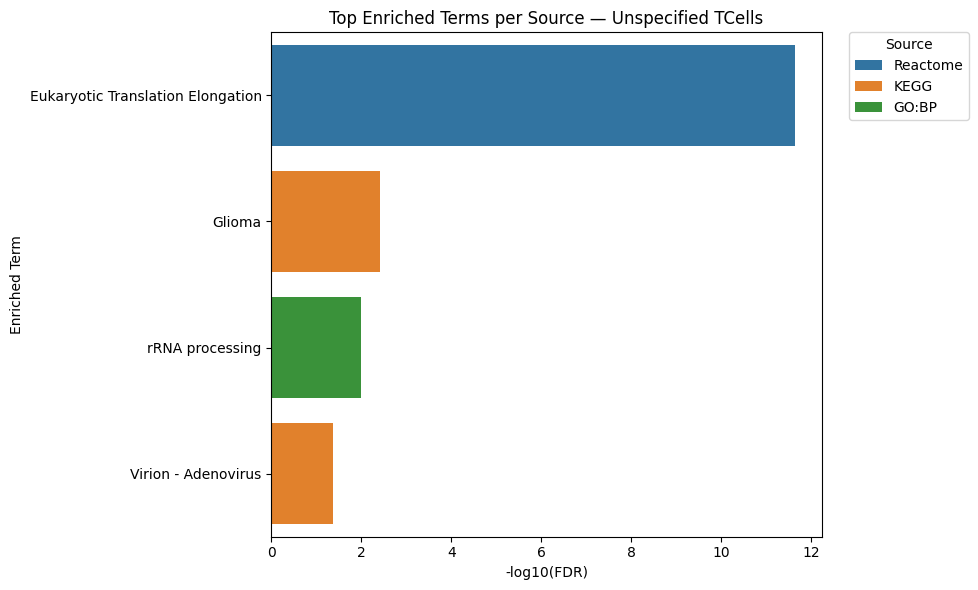

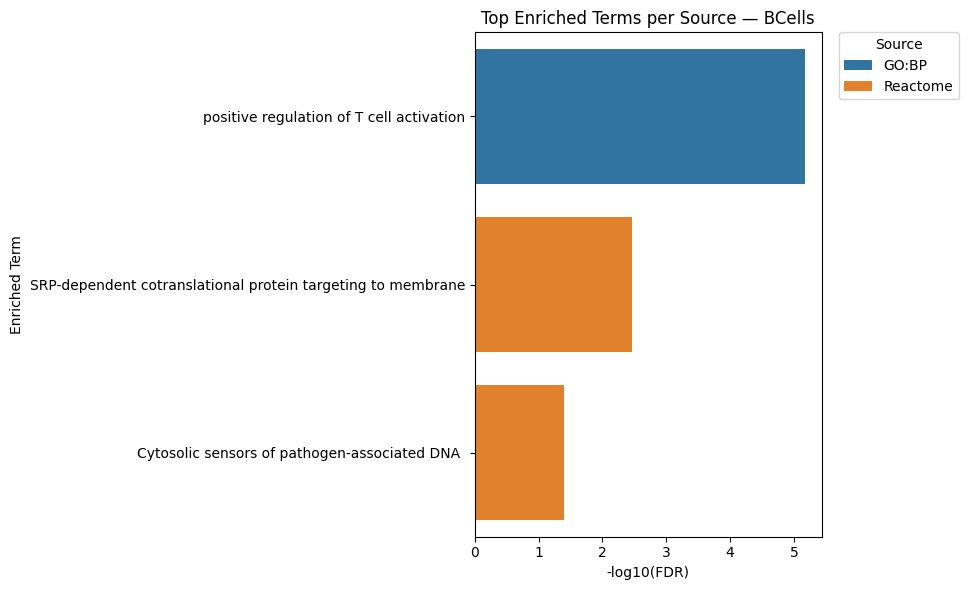

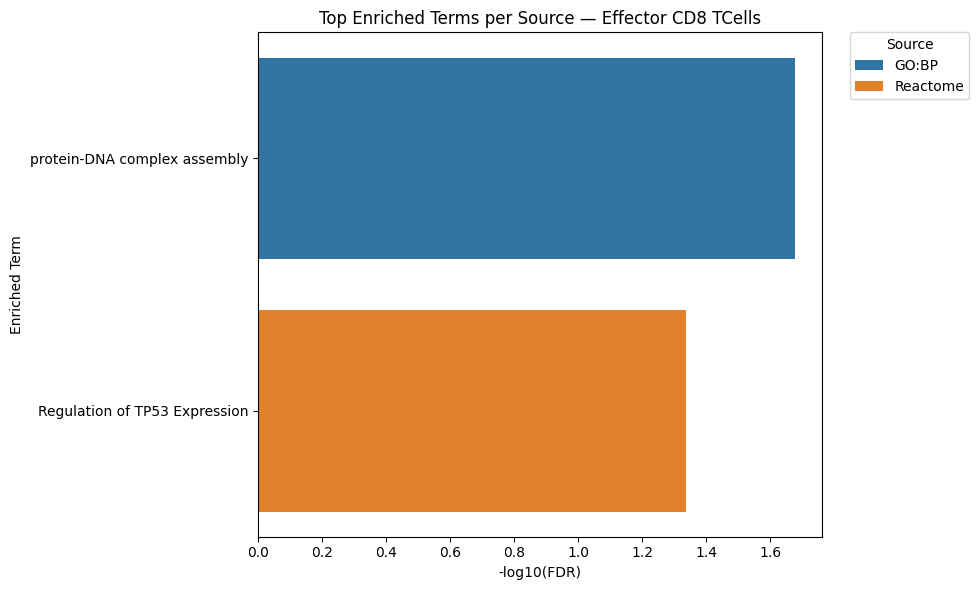

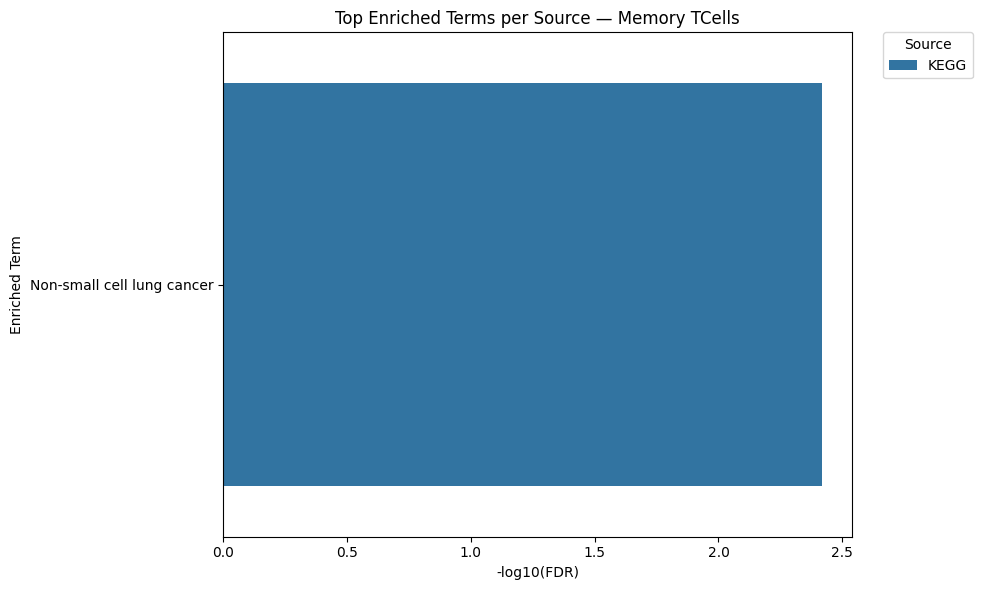

In [15]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Load gProfiler enrichment results
df_results = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Calculate -log10(FDR) column
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Filter to only GO:BP, KEGG, and Reactome
df_filtered = df_results[df_results["Source"].isin(["GO:BP", "KEGG", "REAC"])]

# Optional: rename REAC to Reactome for clarity
df_filtered["Source"] = df_filtered["Source"].replace({"REAC": "Reactome"})

# Loop through unique cell types
for cell_type in df_filtered["Cell_Type"].unique():
    subset = df_filtered[df_filtered["Cell_Type"] == cell_type]

    # Select top 5 terms per source (GO:BP, KEGG, Reactome)
    top_terms = (
        subset.sort_values("FDR")
        .groupby("Source", group_keys=False)
        .head(3)
    )

    # Order terms by ascending FDR (smaller = more significant)
    term_order = top_terms.sort_values("FDR")["Term"].unique()

    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=top_terms,
        y="Term",
        x="-log10(FDR)",
        hue="Source",
        order=term_order
    )
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.title(f"Top Enriched Terms per Source — {cell_type}")
    plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.tight_layout()
    plt.show()

/tmp/ipykernel_3042557/3500224454.py:8: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


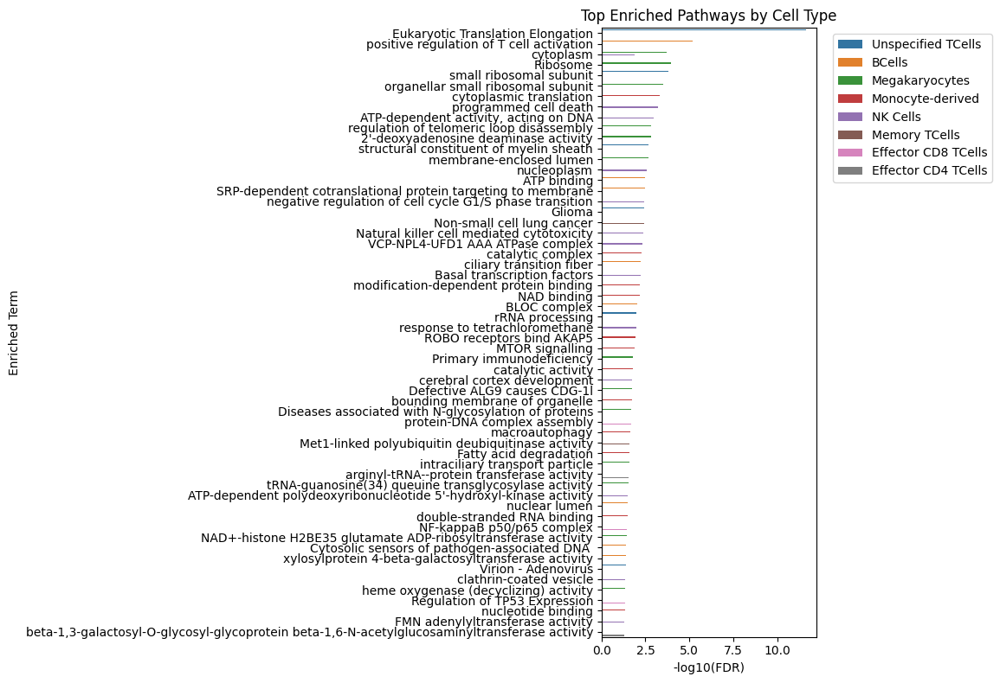

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))
top_terms = df_results.sort_values("FDR").groupby(["Cell_Type", "Source"]).head(5)

plt.figure(figsize=(12, 8))
sns.barplot(
    data=top_terms,
    x="-log10(FDR)",
    y="Term",
    hue="Cell_Type",
    ci=None
)
plt.xlabel("-log10(FDR)")
plt.ylabel("Enriched Term")
plt.title("Top Enriched Pathways by Cell Type")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

In [105]:
import pandas as pd
import numpy as np
import requests
import re
from tqdm import tqdm

# Step 1: Compute expression matrix (genes x cell types)
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X

expr_df = pd.DataFrame(X, 
                       columns=adata_i_filtered.var_names,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])
expr_avg = expr_df.groupby(expr_df.index, observed=False).mean().T  # genes x cell types

# Step 2: Z-score across cell types
z_expr = expr_avg.sub(expr_avg.mean(axis=1), axis=0).div(expr_avg.std(axis=1), axis=0).fillna(0)

# Step 3: Filter to query genes
query_genes = z_expr.index[z_expr.index.str.startswith("BambuGene") | z_expr.index.str.contains("BambuTx")]

# Step 4: Spearman correlation for similarity
corr = z_expr.T.corr(method="spearman")  # genes x genes
top_similar_genes = {}

for gene in query_genes:
    if gene not in corr.index:
        continue
    similar_genes = corr.loc[gene].drop(labels=[gene], errors='ignore').sort_values(ascending=False)
    standard_genes = [g for g in similar_genes.index if not g.startswith("BambuGene") and "BambuTx" not in g]
    top_similar_genes[gene] = standard_genes[:30]

# Step 5: Extract gene symbol
def extract_symbol(label):
    """Extract the gene symbol from GeneSymbol:ENSG:ENST or GeneSymbol format."""
    symbol = label.split(":")[0]
    return symbol if re.match(r"^[A-Z][A-Z0-9\-]*$", symbol) else None

# Step 6: Enrichment using g:Profiler (GO + KEGG + Reactome)
def query_gprofiler(gene_list):
    url = "https://biit.cs.ut.ee/gprofiler/api/gost/profile/"
    headers = {"Content-Type": "application/json"}
    payload = {
        "organism": "hsapiens",
        "query": gene_list,
        "sources": ["GO:BP", "GO:MF", "GO:CC", "KEGG", "REAC"],
        "user_threshold": 0.05,
        "significance_threshold_method": "fdr"
    }
    try:
        response = requests.post(url, headers=headers, json=payload)
        response.raise_for_status()
        return response.json()["result"]
    except Exception as e:
        print(f"⚠️ g:Profiler failed: {e}")
        return []

# Step 7: Run enrichment
results = []

for query_gene, neighbors in tqdm(top_similar_genes.items()):
    gene_list = [extract_symbol(g) for g in neighbors if extract_symbol(g)]
    if len(gene_list) < 5:
        print(f"⚠️ Skipping {query_gene}: <5 valid gene symbols.")
        continue

    enriched = query_gprofiler(gene_list)
    if enriched:
        top = enriched[0]
        results.append({
            "Query": query_gene,
            "Source": top["source"],
            "Term": top["name"],
            "P-value": top["p_value"],
            "FDR": top.get("p_value_fdr", top.get("p_value")),
            "Genes": ",".join(top.get("intersection", [])) if "intersection" in top else ""
        })


# Step 8: Save results
df_results = pd.DataFrame(results)
df_results["Gene_Type"] = df_results["Query"].apply(lambda x: "Novel" if "Bambu" in x else "Known")
# Optional: Define the dominant cell type where each query gene is most expressed
max_celltype = z_expr.loc[df_results["Query"].unique()].idxmax(axis=1)  # most enriched cell type per gene
df_results["Cell_Type"] = df_results["Query"].map(max_celltype)

df_results.to_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t", index=False)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 77/77 [00:42<00:00,  1.80it/s]


In [106]:
df_results.head(10)

,Query,Source,Term,P-value,FDR,Genes,Gene_Type,Cell_Type
0,BambuGene1277:BambuTx5,KEGG,Natural killer cell mediated cytotoxicity,0.004368,0.004368,,Novel,NK Cells
1,BambuGene13114:BambuTx22,REAC,ROBO receptors bind AKAP5,0.011100,0.011100,,Novel,Monocyte-derived
2,BambuGene14461:BambuTx25,GO:BP,regulation of telomeric loop disassembly,0.001446,0.001446,,Novel,Megakaryocytes
3,BambuGene15305:BambuTx26,GO:MF,heme oxygenase (decyclizing) activity,0.045187,0.045187,,Novel,Megakaryocytes
4,BambuGene17689:BambuTx29,GO:BP,cerebral cortex development,0.017391,0.017391,,Novel,NK Cells
5,BambuGene19:BambuTx109,GO:MF,double-stranded RNA binding,0.033661,0.033661,,Novel,Monocyte-derived
6,BambuGene1995:BambuTx7,GO:CC,cytoplasm,0.013585,0.013585,,Novel,NK Cells
7,BambuGene20530:BambuTx33,GO:MF,"ATP-dependent activity, acting on DNA",0.001066,0.001066,,Novel,NK Cells
8,BambuGene20676:BambuTx103,GO:CC,clathrin-coated vesicle,0.044962,0.044962,,Novel,NK Cells
9,BambuGene24178:BambuTx39,GO:MF,catalytic activity,0.016438,0.016438,,Novel,Monocyte-derived


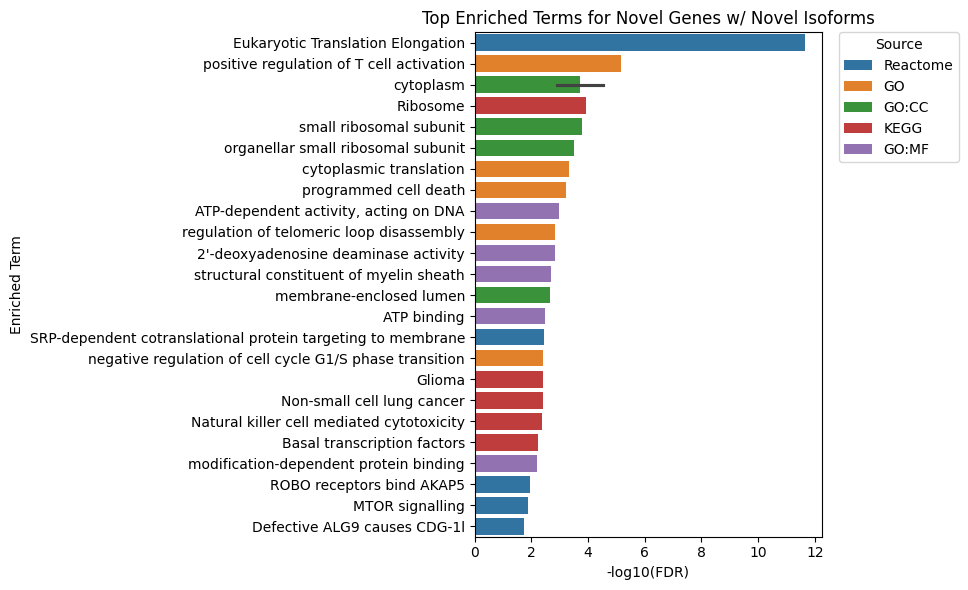

/tmp/ipykernel_3042557/2601007343.py:40: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)


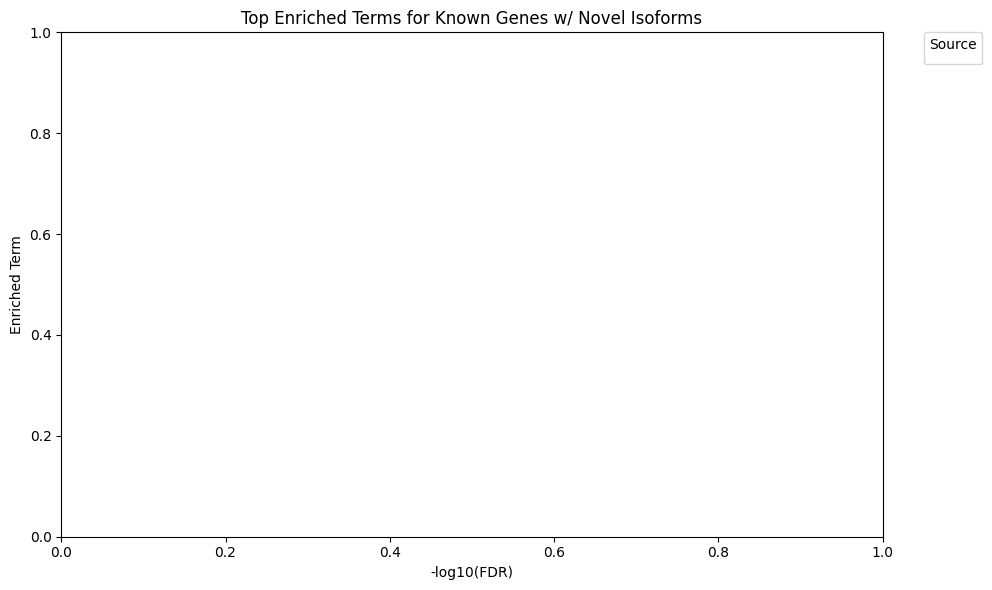

In [47]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load results
df_results = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Calculate -log10(FDR) safely
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Replace source labels for consistency (optional)
df_results["Source"] = df_results["Source"].replace({"GO:BP": "GO", "REAC": "Reactome"})

# Loop through gene types
for gene_type in ["Novel", "Known"]:
    subset = df_results[df_results["Gene_Type"] == gene_type]

    # Select top 5 terms per source
    top_terms = (
        subset.sort_values("FDR")
        .groupby("Source", group_keys=False)
        .head(5)
    )

    # Order terms by ascending FDR (smallest = most significant)
    term_order = top_terms.sort_values("FDR")["Term"].unique()

    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=top_terms,
        y="Term",
        x="-log10(FDR)",
        hue="Source",
        order=term_order
    )
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.title(f"Top Enriched Terms for {gene_type} Genes w/ Novel Isoforms")
    plt.legend(title="Source", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.tight_layout()
    plt.show()

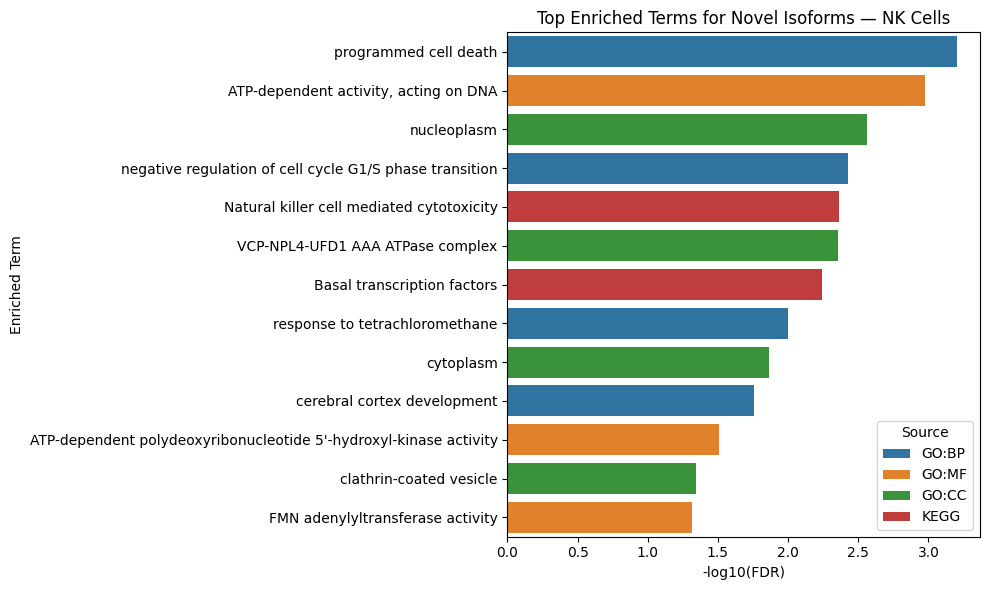

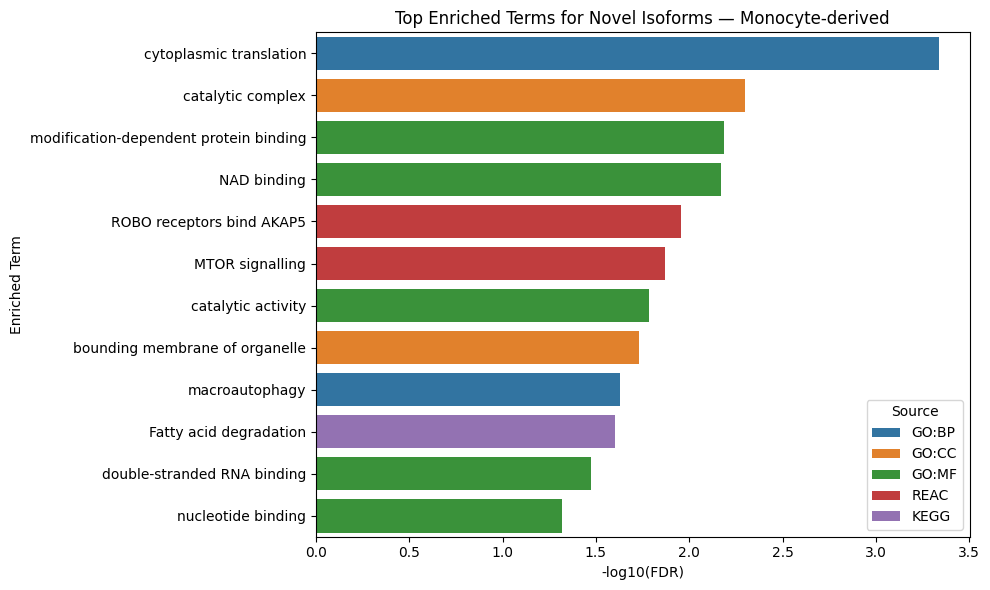

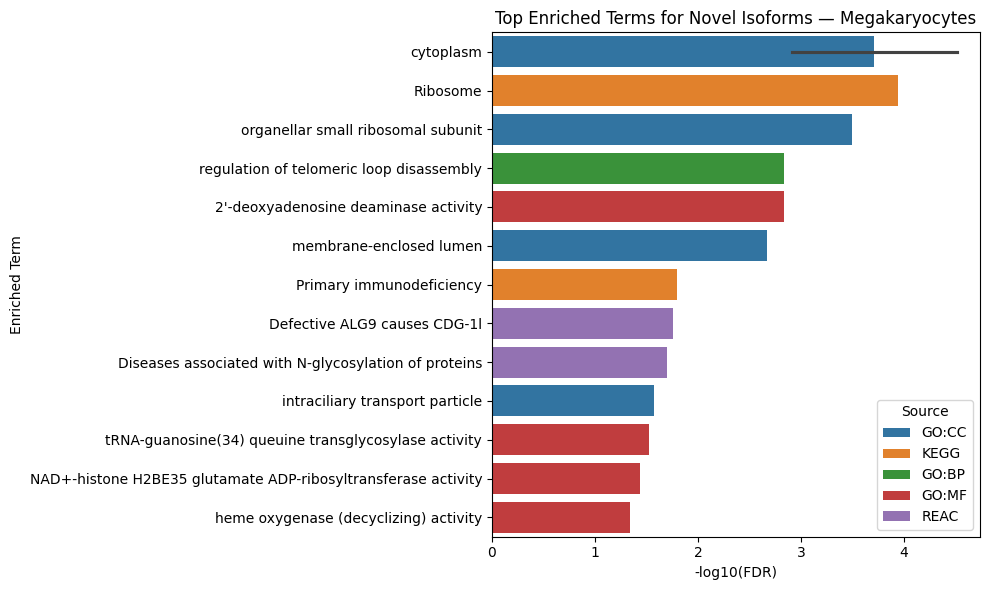

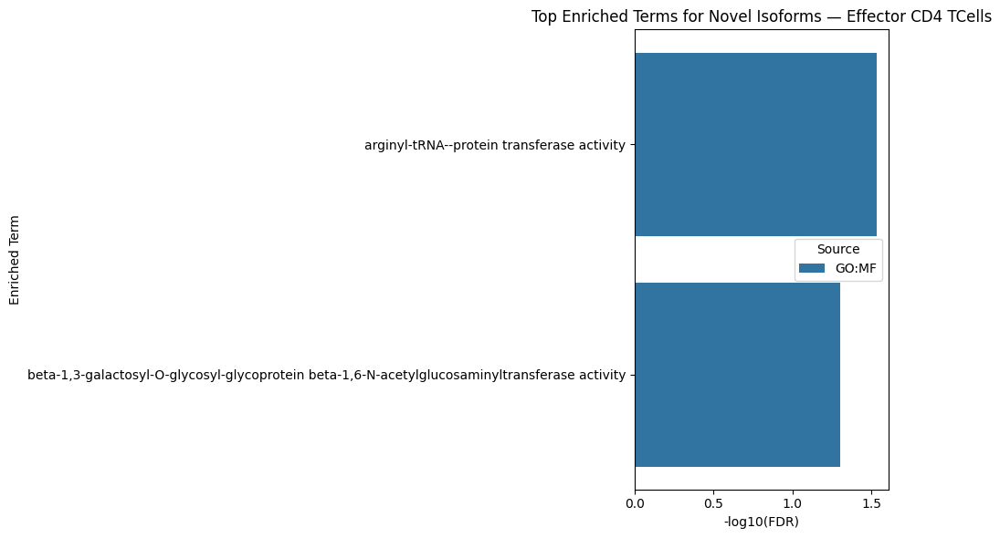

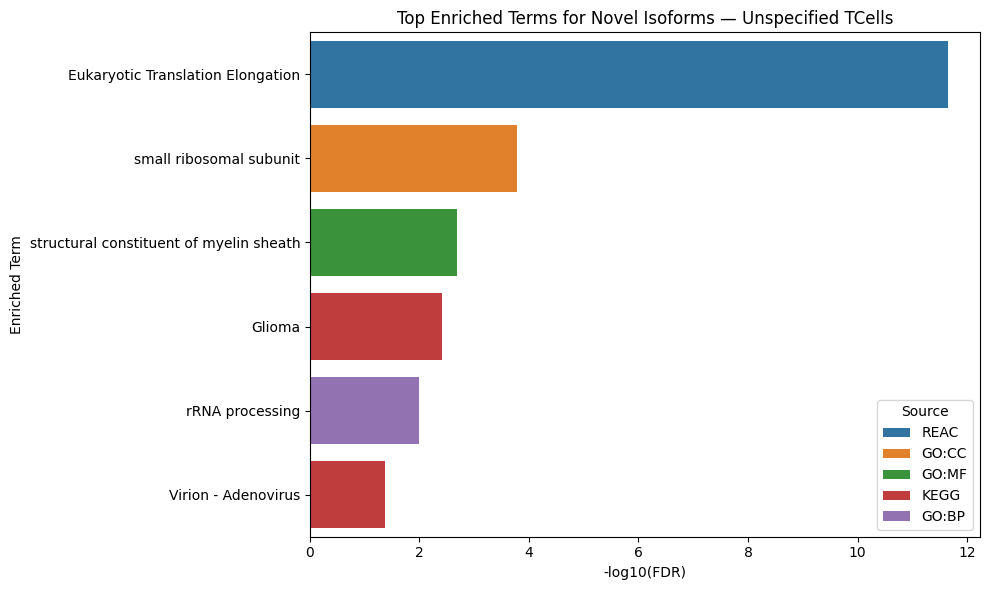

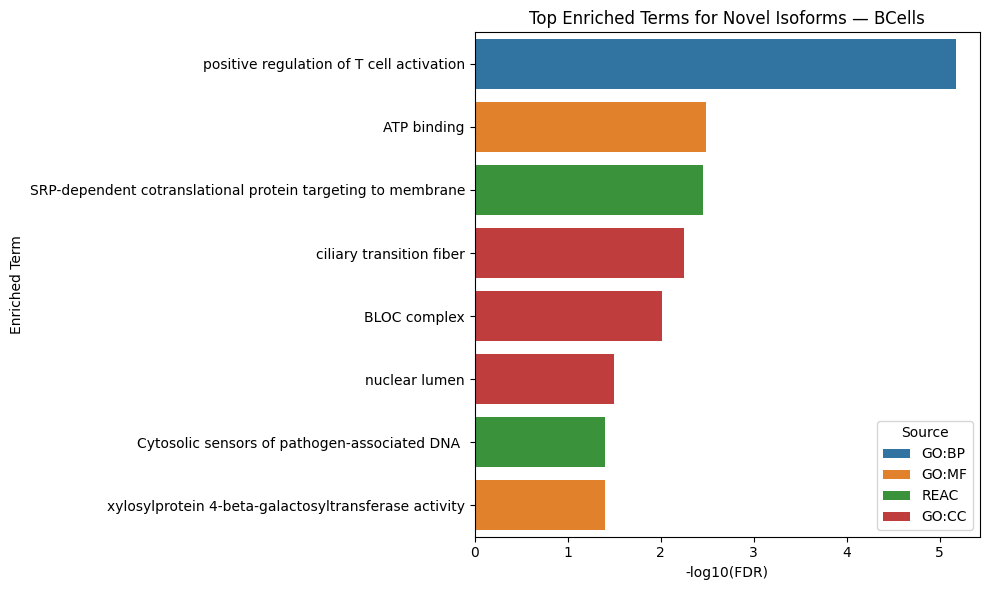

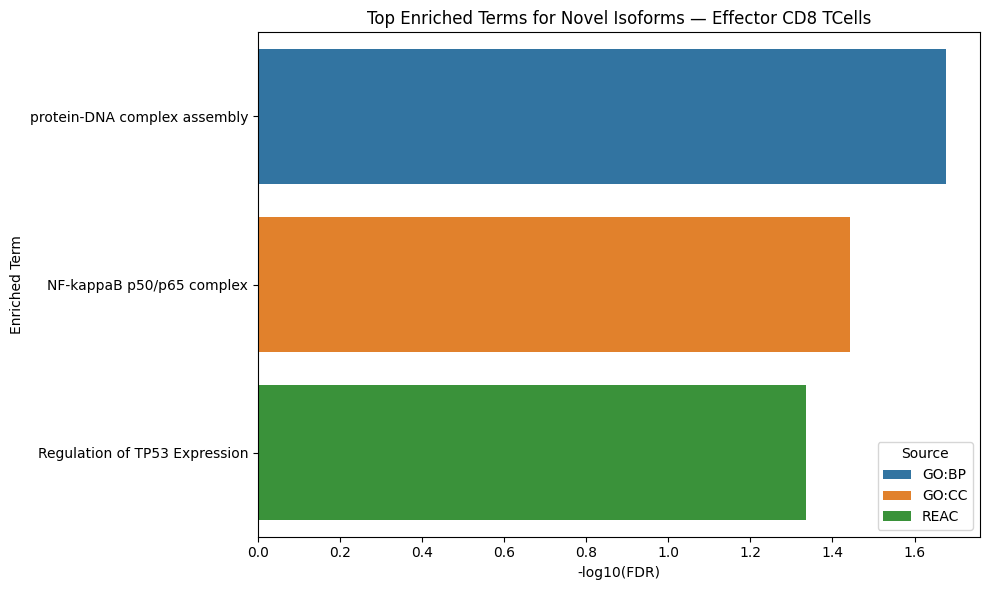

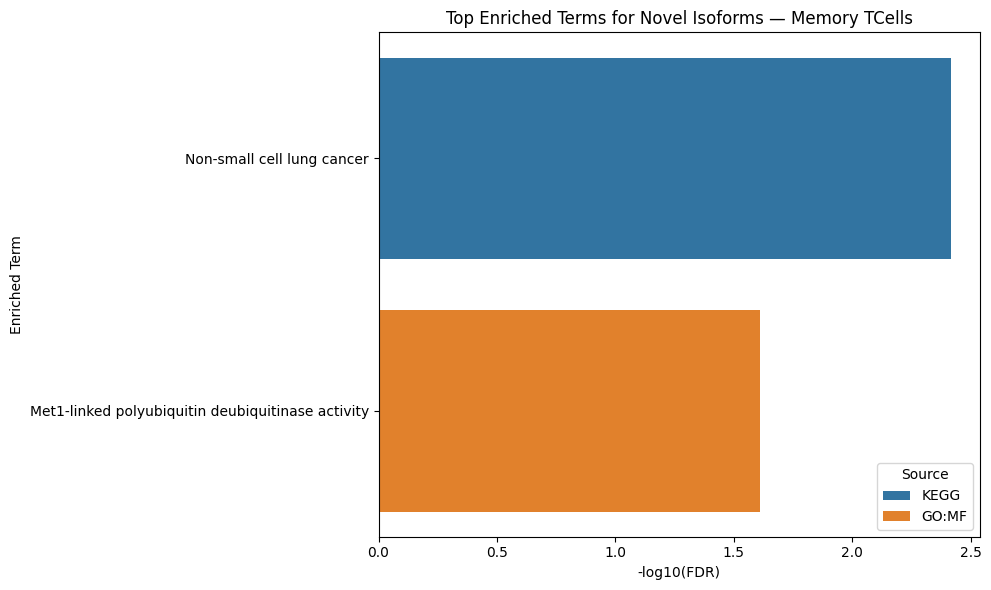

In [3]:
# Load gProfiler enrichment results
df_results = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Calculate -log10(FDR) column
df_results["-log10(FDR)"] = -np.log10(df_results["FDR"].replace(0, 1e-300))

# Loop through unique cell types
for cell_type in df_results["Cell_Type"].unique():
    subset = df_results[df_results["Cell_Type"] == cell_type]

    # Select top 5 terms per source (GO:BP, KEGG, REAC, etc.)
    top_terms = subset.sort_values("FDR").groupby("Source").head(5)

    # Plot
    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=top_terms, 
        y="Term", 
        x="-log10(FDR)", 
        hue="Source",
        order=top_terms.sort_values("FDR")["Term"]
    )
    plt.xlabel("-log10(FDR)")
    plt.ylabel("Enriched Term")
    plt.title(f"Top Enriched Terms for Novel Isoforms — {cell_type}")
    plt.tight_layout()
    plt.show()

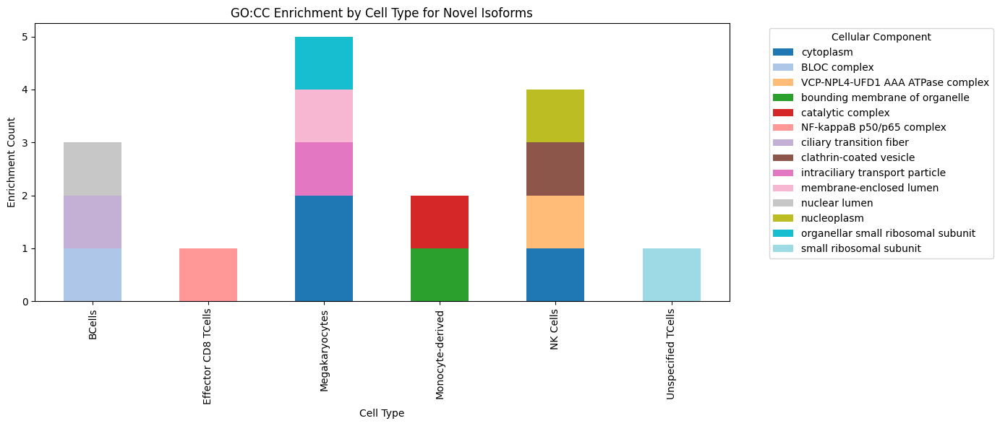

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load gProfiler enrichment results
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Filter to GO:CC only
go_cc = df[df["Source"] == "GO:CC"].copy()

# Clean term names for grouping if needed
go_cc["Term"] = go_cc["Term"].str.strip()

# Count number of times each GO:CC term appears per cell type
cc_counts = (
    go_cc.groupby(["Cell_Type", "Term"])
    .size()
    .unstack(fill_value=0)
)

# Sort terms by total abundance
term_order = cc_counts.sum(axis=0).sort_values(ascending=False).index
cc_counts = cc_counts[term_order]

# Plot stacked bar chart
ax = cc_counts.plot(kind="bar", stacked=True, figsize=(14, 6), colormap="tab20")
ax.set_title("GO:CC Enrichment by Cell Type for Novel Isoforms")
ax.set_ylabel("Enrichment Count")
ax.set_xlabel("Cell Type")
ax.legend(title="Cellular Component", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

In [88]:
isoform_to_term = df_results.groupby("Query")["Term"].apply(list)

In [89]:
summary = (
    df_results.groupby("GO_Cluster")
    .agg(
        Top_Terms=("Term", lambda x: ", ".join(x.value_counts().head(3).index)),
        Num_Unique_Terms=("Term", "nunique"),
        Num_Isoforms=("Query", "nunique")
    )
    .reset_index()
)

print(summary)

KeyError: 'GO_Cluster'

In [114]:
print(df["Source"].unique())

['KEGG' 'REAC' 'GO:BP' 'GO:MF' 'GO:CC']


In [113]:
print(df["Term"].head(20))

0             Natural killer cell mediated cytotoxicity
1                             ROBO receptors bind AKAP5
2              regulation of telomeric loop disassembly
3                 heme oxygenase (decyclizing) activity
4                           cerebral cortex development
5                           double-stranded RNA binding
6                                             cytoplasm
7                 ATP-dependent activity, acting on DNA
8                               clathrin-coated vesicle
9                                    catalytic activity
10    beta-1,3-galactosyl-O-glycosyl-glycoprotein be...
11                                          NAD binding
12    tRNA-guanosine(34) queuine transglycosylase ac...
13                               Fatty acid degradation
14              structural constituent of myelin sheath
15    ATP-dependent polydeoxyribonucleotide 5'-hydro...
16                             Primary immunodeficiency
17                     FMN adenylyltransferase a

In [115]:
import pandas as pd
from goatools.obo_parser import GODag

# Load your enrichment results
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Load GO ontology
go_dag = GODag("go-basic.obo")  # assumes you already have this file

# Build name-to-id dictionary (lowercased for robustness)
name_to_id = {term.name.lower(): go_id for go_id, term in go_dag.items()}

# Map term names to GO IDs (if possible)
df["GO_ID"] = df["Term"].str.lower().map(name_to_id)

# Drop terms that could not be mapped
df_mapped = df.dropna(subset=["GO_ID"])

# Check mapping success
print(f"Mapped {df_mapped.shape[0]} of {df.shape[0]} terms.")
print(df_mapped[["Term", "GO_ID"]].drop_duplicates().head(10))

go-basic.obo: fmt(1.2) rel(2025-03-16) 43,544 Terms
Mapped 47 of 60 terms.
                                                 Term       GO_ID
0           Natural killer cell mediated cytotoxicity  GO:0042267
2            regulation of telomeric loop disassembly  GO:1904533
3               heme oxygenase (decyclizing) activity  GO:0004392
4                         cerebral cortex development  GO:0021987
5                         double-stranded RNA binding  GO:0003725
6                                           cytoplasm  GO:0005737
7               ATP-dependent activity, acting on DNA  GO:0004011
8                             clathrin-coated vesicle  GO:0030136
9                                  catalytic activity  GO:0003824
10  beta-1,3-galactosyl-O-glycosyl-glycoprotein be...  GO:0003829


/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  self._figure.tight_layout(*args, **kwargs)


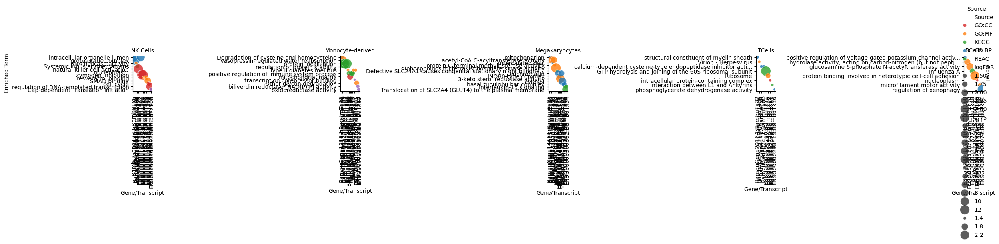

In [92]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load your results
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Preprocess: compute -log10(FDR) and drop any missing values
df["logFDR"] = -np.log10(df["FDR"].replace(0, 1e-300))
df = df.dropna(subset=["logFDR", "Query", "Term", "Gene_Type", "Cell_Type", "Source"])

# Optional: filter top terms or genes if needed
# df = df[df["logFDR"] > threshold]

# Clean/shorten long GO/Reactome names for visualization (optional)
df["Short_Term"] = df["Term"].apply(lambda x: x[:60] + "..." if len(x) > 60 else x)

# Create bubble plot
g = sns.FacetGrid(
    df,
    row="Gene_Type",
    col="Cell_Type",
    margin_titles=True,
    sharex=False,
    sharey=False,
    height=4,
    aspect=1.2
)
g.map_dataframe(
    sns.scatterplot,
    x="Query",
    y="Short_Term",
    size="logFDR",
    hue="Source",
    alpha=0.8,
    sizes=(20, 300)
)

g.set_titles(row_template="{row_name}", col_template="{col_name}")
g.set_axis_labels("Gene/Transcript", "Enriched Term")
g.add_legend(title="Source")
for ax in g.axes.flatten():
    ax.tick_params(axis='x', rotation=90)
plt.tight_layout()
plt.show()

In [93]:
# Load your enrichment file
df_results = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Infer gene type
def categorize_gene(query):
    if query.startswith("BambuTx"):
        return "New Isoform"
    elif query.startswith("BambuGene"):
        return "New Gene"
    else:
        return "Known"

df_results["Gene_Type"] = df_results["Query"].apply(categorize_gene)

# Find cell type with highest expression
max_celltype = z_expr.loc[df_results["Query"]].idxmax(axis=1)
df_results["Cell_Type"] = max_celltype.values

# Save this for plotting
df_results.to_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler_CellType.tsv", sep="\t", index=False)

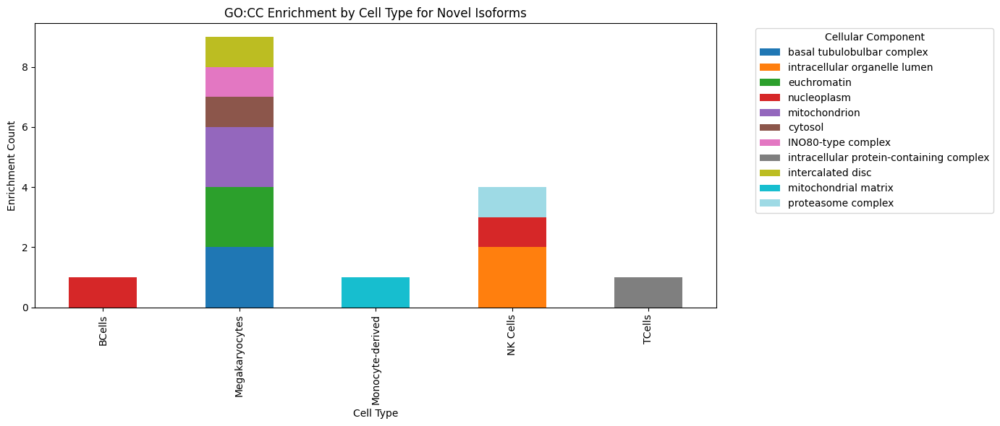

In [104]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load gProfiler enrichment results
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Filter to GO:CC only
go_cc = df[df["Source"] == "GO:CC"].copy()

# Clean term names for grouping if needed
go_cc["Term"] = go_cc["Term"].str.strip()

# Count number of times each GO:CC term appears per cell type
cc_counts = (
    go_cc.groupby(["Cell_Type", "Term"])
    .size()
    .unstack(fill_value=0)
)

# Sort terms by total abundance
term_order = cc_counts.sum(axis=0).sort_values(ascending=False).index
cc_counts = cc_counts[term_order]

# Plot stacked bar chart
ax = cc_counts.plot(kind="bar", stacked=True, figsize=(14, 6), colormap="tab20")
ax.set_title("GO:CC Enrichment by Cell Type for Novel Isoforms")
ax.set_ylabel("Enrichment Count")
ax.set_xlabel("Cell Type")
ax.legend(title="Cellular Component", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()

In [100]:
import pandas as pd
import numpy as np
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import pairwise_distances
from scipy.spatial.distance import squareform
from ast import literal_eval

# Load enrichment file
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler_CellType.tsv", sep="\t")

# Convert comma-separated gene strings to sets
df["Gene_Set"] = df["Genes"].apply(lambda x: set(x.split(",")) if pd.notna(x) else set())

# Filter rows with at least 1 gene
df = df[df["Gene_Set"].apply(len) > 0].reset_index(drop=True)

# Compute Jaccard distance matrix
n = len(df)
jaccard_matrix = np.zeros((n, n))

for i in range(n):
    for j in range(i, n):
        set_i = df.loc[i, "Gene_Set"]
        set_j = df.loc[j, "Gene_Set"]
        if not set_i and not set_j:
            dist = 1.0
        else:
            intersection = len(set_i & set_j)
            union = len(set_i | set_j)
            dist = 1 - (intersection / union) if union != 0 else 1.0
        jaccard_matrix[i, j] = jaccard_matrix[j, i] = dist

# Cluster terms using Agglomerative Clustering
clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.6, metric='precomputed', linkage='average')
labels = clustering.fit_predict(jaccard_matrix)
df["Jaccard_Cluster"] = labels

# Save updated results
df.to_csv("Intermediate_Files/Bambu_Enrichment_With_Jaccard_Clusters.tsv", sep="\t", index=False)

# Optional: print cluster summaries
summary = (
    df.groupby("Jaccard_Cluster")
    .agg(
        Top_Terms=("Term", lambda x: ", ".join(x.value_counts().head(3).index)),
        Num_Unique_Terms=("Term", "nunique"),
        Num_Isoforms=("Query", "nunique")
    )
    .reset_index()
)
print(summary)

ValueError: Found array with 0 sample(s) (shape=(0, 0)) while a minimum of 2 is required by AgglomerativeClustering.


=== New Gene w/ New Isoform Pathway Cluster Summary ===
                                                          Top_Term  Num_Terms  \
Pathway_Cluster                                                                 
43                                            protein localization          1   
16                        Vasopressin-regulated water reabsorption          1   
40                                              proteasome complex          1   
34                                  natural killer cell activation          1   
18                           acetyl-CoA C-acyltransferase activity          1   
29                                   intracellular organelle lumen          1   
48                         structural constituent of myelin sheath          1   
32                                            mitochondrial matrix          1   
38                    positive regulation of immune system process          1   
21               calcium-dependent cysteine-type end

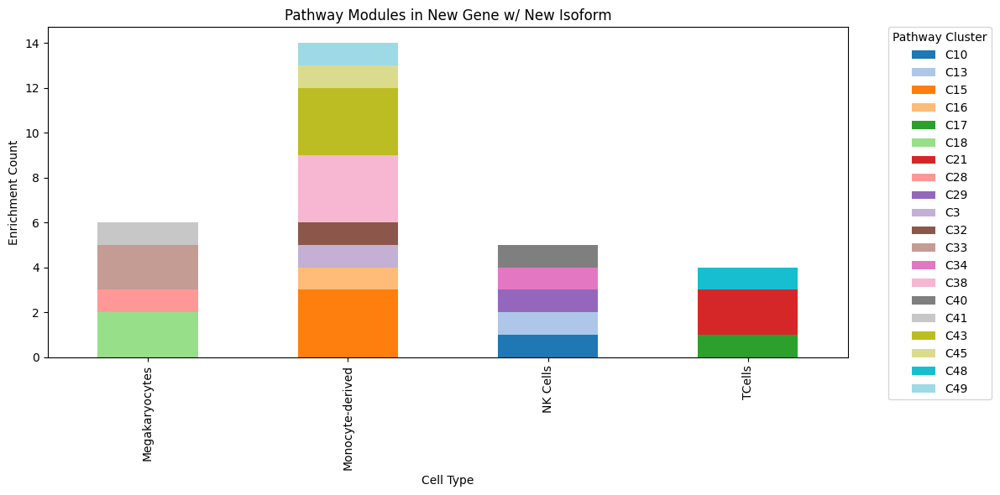

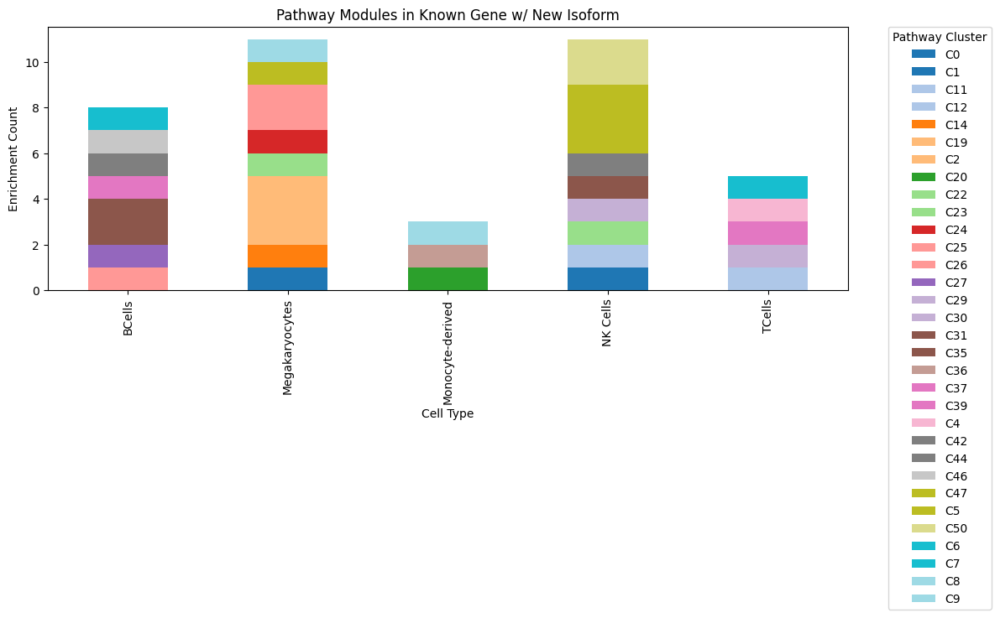

In [98]:
import pandas as pd
import matplotlib.pyplot as plt

# Load enrichment results
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler_CellType.tsv", sep="\t")

# Categorize gene class
df["Gene_Class"] = df["Query"].apply(
    lambda x: "New Gene w/ New Isoform" if x.startswith("BambuGene") else "Known Gene w/ New Isoform"
)

# Assign unique pathway clusters across all sources
df["Pathway_Cluster"] = df.groupby("Term").ngroup()
df["Cluster_Label"] = "C" + df["Pathway_Cluster"].astype(str)

# Summarize cluster significance per gene class
for gene_class in df["Gene_Class"].unique():
    print(f"\n=== {gene_class} Pathway Cluster Summary ===")
    subset = df[df["Gene_Class"] == gene_class]

    summary = (
        subset.groupby("Pathway_Cluster")
        .agg(
            Top_Term=("Term", lambda x: x.value_counts().idxmax()),
            Num_Terms=("Term", "nunique"),
            Num_Isoforms=("Query", "nunique"),
            Num_Cell_Types=("Cell_Type", "nunique"),
            Min_FDR=("FDR", "min"),
            Median_FDR=("FDR", "median")
        )
        .sort_values("Min_FDR")
    )
    print(summary.head(10))  # top 10 clusters
    
# Plot one per gene class
for gene_class in df["Gene_Class"].unique():
    subset = df[df["Gene_Class"] == gene_class]

    if subset.empty:
        continue

    counts = subset.groupby(["Cell_Type", "Cluster_Label"]).size().unstack(fill_value=0)
    counts = counts.reindex(sorted(counts.columns), axis=1)

    ax = counts.plot(kind="bar", stacked=True, colormap="tab20", figsize=(12, 6))
    ax.set_title(f"Pathway Modules in {gene_class}")
    ax.set_ylabel("Enrichment Count")
    ax.set_xlabel("Cell Type")
    ax.legend(title="Pathway Cluster", bbox_to_anchor=(1.05, 1), loc="upper left", borderaxespad=0.)
    plt.tight_layout()
    plt.show()

Cluster 0:
  - natural killer cell activation
  - cell cycle
Cluster 1:
  - Degradation of cysteine and homocysteine
  - Other glycan degradation
Cluster 2:
  - Type II diabetes mellitus
Cluster 3:
  - inhibition of cysteine-type endopeptidase activity
Cluster 4:
  - positive regulation of type 2 immune response
  - positive regulation of immune system process
Cluster 5:
  - Cap-dependent Translation Initiation
Cluster 6:
  - regulation of xenophagy
Cluster 7:
  - Interaction between L1 and Ankyrins
Cluster 8:
  - DNA-templated transcription
Cluster 9:
  - protein localization
Cluster 10:
  - trans-Golgi Network Vesicle Budding
Cluster 11:
  - Interleukin-15 signaling
Cluster 12:
  - vesicle transport along actin filament
Cluster 13:
  - immunological synapse formation
Cluster 14:
  - Purine salvage
Cluster 15:
  - positive regulation of voltage-gated potassium channel activity
Cluster 16:
  - Synthesis of IPs in the nucleus
Cluster 17:
  - Systemic lupus erythematosus
Cluster 18:
  - 

/tmp/ipykernel_1089799/3743080823.py:47: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


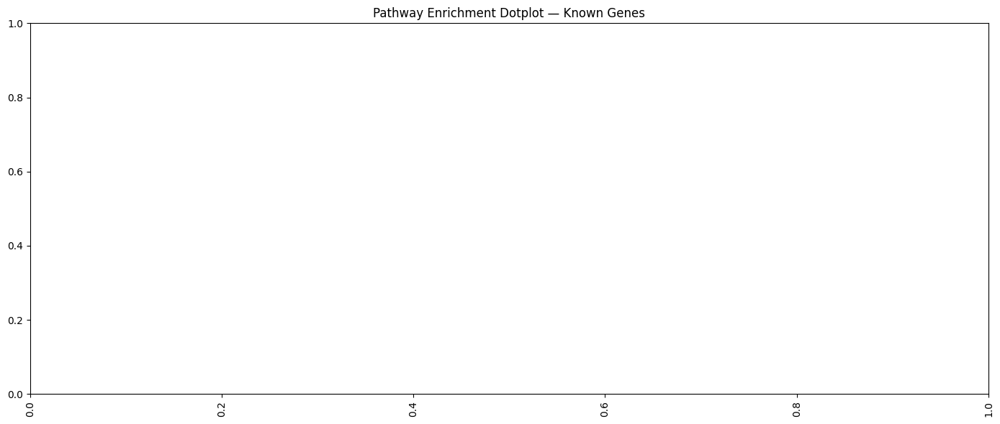

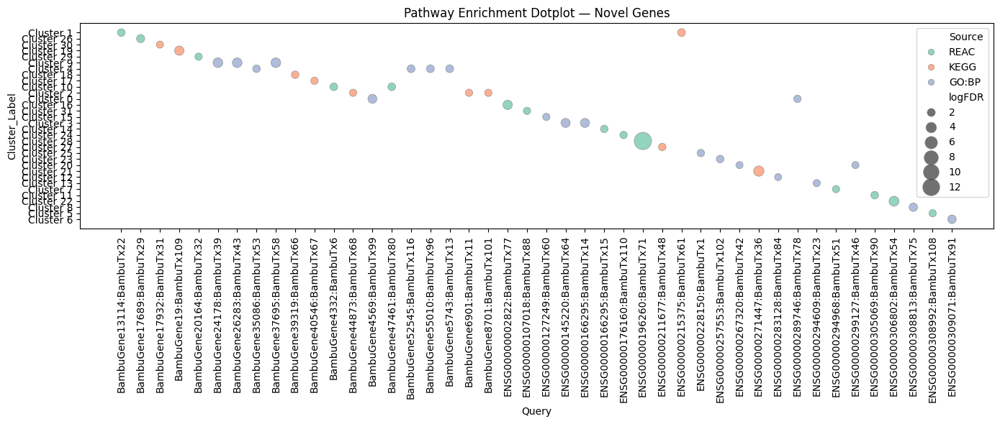

In [59]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import AgglomerativeClustering

# Load results
df = pd.read_csv("Intermediate_Files/Bambu_TopSimilar_Gene_Enrichment_gProfiler.tsv", sep="\t")

# Clean FDR values for plotting
df['logFDR'] = -np.log10(df['FDR'].replace(0, 1e-300))  # avoid -inf

# Label novel vs known genes
df["Gene_Type"] = df["Query"].apply(lambda x: "Novel" if "Bambu" in x else "Known")

# Cluster terms by semantic similarity
vectorizer = TfidfVectorizer(stop_words="english")
X = vectorizer.fit_transform(df["Term"])
cos_sim = cosine_similarity(X)

clustering = AgglomerativeClustering(n_clusters=None, distance_threshold=0.7, linkage='average', metric='precomputed')
labels = clustering.fit_predict(1 - cos_sim)
df["Term_Cluster"] = labels

# Optional: print what terms belong to each cluster
for cl in sorted(df["Term_Cluster"].unique()):
    terms = df[df["Term_Cluster"] == cl]["Term"].unique()
    print(f"Cluster {cl}:")
    for t in terms:
        print(f"  - {t}")

# Build cluster labels for plotting
cluster_labels = {i: f"Cluster {i}" for i in sorted(df["Term_Cluster"].unique())}
df["Cluster_Label"] = df["Term_Cluster"].map(cluster_labels)

# Generate color palette from unique sources
unique_sources = df["Source"].unique()
default_colors = sns.color_palette("Set2", len(unique_sources))
palette = dict(zip(unique_sources, default_colors))

# --- DOTPLOT SPLIT BY GENE TYPE ---
for gene_type in ["Known", "Novel"]:
    subset = df[df["Gene_Type"] == gene_type]
    plt.figure(figsize=(14, 6))
    sns.scatterplot(
        data=subset,
        x="Query",
        y="Cluster_Label",
        size="logFDR",
        hue="Source",
        alpha=0.7,
        palette=palette,
        sizes=(50, 300),
        edgecolor="gray"
    )
    plt.title(f"Pathway Enrichment Dotplot — {gene_type} Genes")
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.show()

# --- OPTIONAL: SAVE TO FILE ---
# plt.savefig(f"dotplot_{gene_type.lower()}_genes.png", dpi=300)

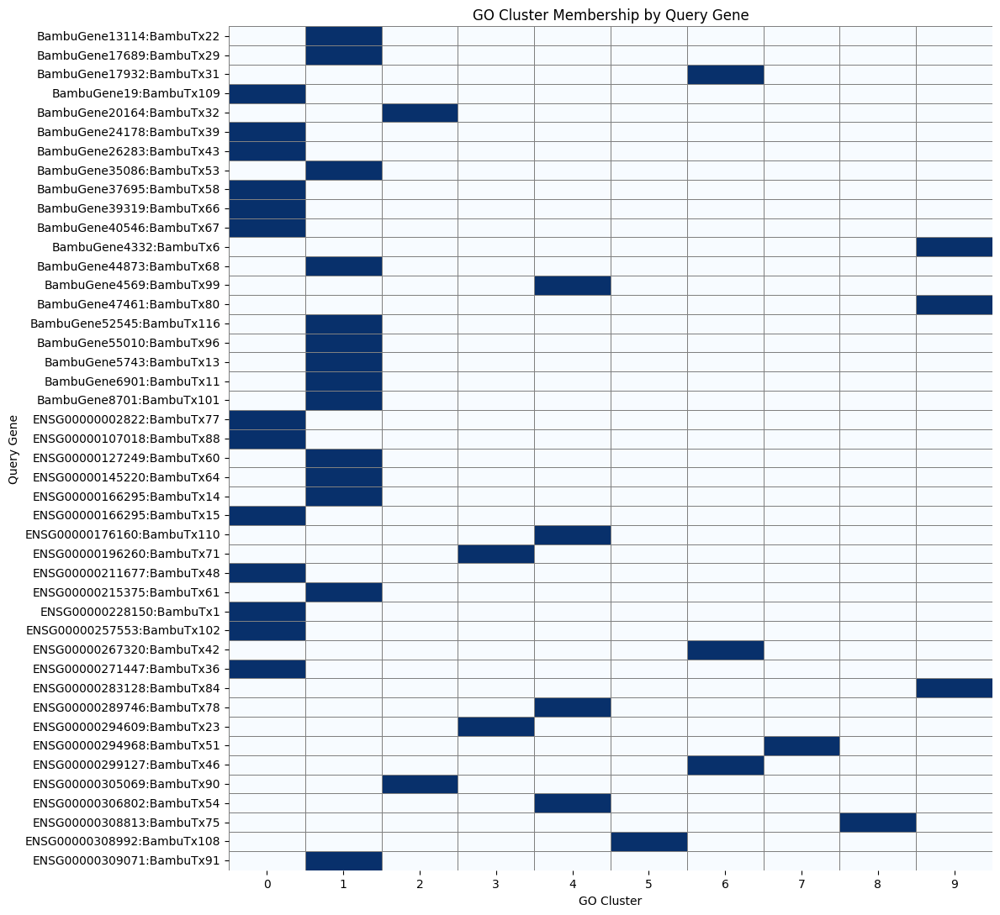

In [46]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import AgglomerativeClustering

# Extract terms
terms = df_results["Term"].fillna("").astype(str)

# TF-IDF vectorization
vectorizer = TfidfVectorizer(stop_words="english")
X = vectorizer.fit_transform(terms)

# Agglomerative clustering with cosine distance
clustering = AgglomerativeClustering(n_clusters=10, metric='cosine', linkage='average')
clusters = clustering.fit_predict(X.toarray())

# Add to df_results
df_results["Cluster"] = clusters

# Prepare binary matrix of isoforms vs cluster
rows = [(row["Query"], f'Cluster {row["Cluster"]}') for _, row in df_results.iterrows()]
df_bin = pd.DataFrame(rows, columns=["Query", "Cluster"])
heatmap_data = pd.crosstab(df_bin["Query"], df_bin["Cluster"])

# Create a binary matrix (rows = genes, cols = GO clusters)
df_bin = pd.crosstab(df_results["Query"], df_results["Cluster"])

# Sort genes by cluster for cleaner display
df_bin = df_bin.loc[df_bin.sum(axis=1).sort_values(ascending=False).index]

# Plot heatmap
plt.figure(figsize=(12, max(6, len(df_bin) * 0.25)))  # Auto height scaling
sns.heatmap(df_bin, cmap="Blues", cbar=False, linewidths=0.5, linecolor='gray')
plt.title("GO Cluster Membership by Query Gene")
plt.ylabel("Query Gene")
plt.xlabel("GO Cluster")
plt.tight_layout()
plt.show()

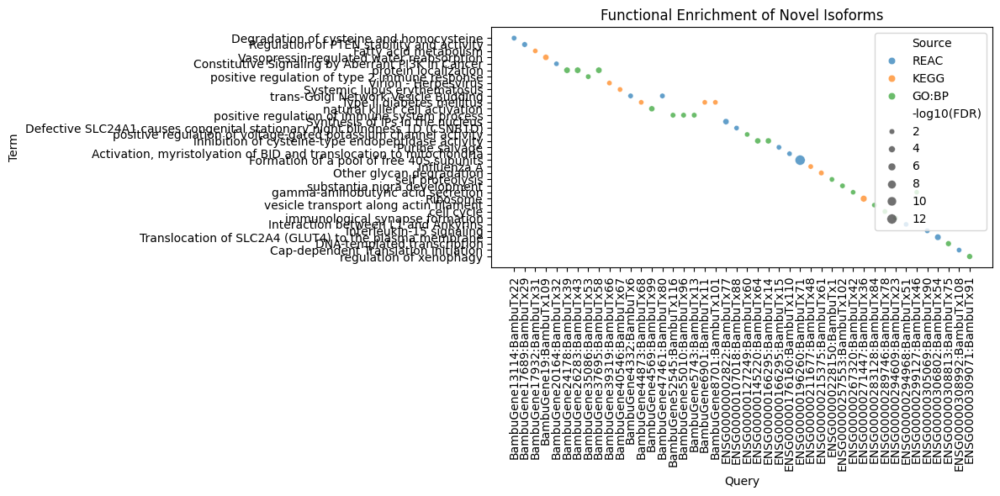

In [43]:
df_plot = df_results.copy()
df_plot["-log10(FDR)"] = -np.log10(df_plot["FDR"])
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df_plot, x="Query", y="Term", size="-log10(FDR)", hue="Source", legend="brief", alpha=0.7)
plt.xticks(rotation=90)
plt.title("Functional Enrichment of Novel Isoforms")
plt.tight_layout()
plt.show()

In [39]:
from wordcloud import WordCloud

for clust in df_results["GO_Cluster"].unique():
    terms = df_results[df_results["GO_Cluster"] == clust]["Term"]
    text = " ".join(terms)
    wc = WordCloud(width=800, height=400, background_color="white").generate(text)
    
    plt.figure(figsize=(10, 5))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"GO Cluster {clust}")
    plt.show()

ModuleNotFoundError: No module named 'wordcloud'

In [2]:
# Load the mdata object from the file
output_dir = 'Intermediate_Files/Clustering_05012025'

from scanpy import read_h5ad
adata_g_filtered = read_h5ad(os.path.join(output_dir, "PBMC_gene_AutoZI_clustered_celltypes_reannotated_AutoZILatent_05112025.h5mu"))
adata_i_filtered = read_h5ad(os.path.join(output_dir, "PBMC_iso_AutoZI_clustered_celltypes_reannotated_AutoZILatent_05112025.h5mu"))

✅ Found 24 isoforms:
   MALAT1:ENSG00000251562:ENST00000508832
   MALAT1:ENSG00000251562:ENST00000534336
   MALAT1:ENSG00000251562:ENST00000544868
   MALAT1:ENSG00000251562:ENST00000610851
   MALAT1:ENSG00000251562:ENST00000616691
   MALAT1:ENSG00000251562:ENST00000618132
   MALAT1:ENSG00000251562:ENST00000619449
   MALAT1:ENSG00000251562:ENST00000620902
   MALAT1:ENSG00000251562:ENST00000710847
   MALAT1:ENSG00000251562:ENST00000710848
   MALAT1:ENSG00000251562:ENST00000710852
   MALAT1:ENSG00000251562:ENST00000710855
   MALAT1:ENSG00000251562:ENST00000710858
   MALAT1:ENSG00000251562:ENST00000710862
   MALAT1:ENSG00000251562:ENST00000710866
   MALAT1:ENSG00000251562:ENST00000710875
   MALAT1:ENSG00000251562:ENST00000710927
   MALAT1:ENSG00000251562:ENST00000710937
   MALAT1:ENSG00000251562:ENST00000710938
   MALAT1:ENSG00000251562:ENST00000710940
   MALAT1:ENSG00000251562:ENST00000710946
   MALAT1:ENSG00000251562:ENST00000710950
   MALAT1:ENSG00000251562:ENST00000710951
   ENSG000002

/tmp/ipykernel_3648124/2434154857.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = df_expr.groupby(df_expr.index).mean()


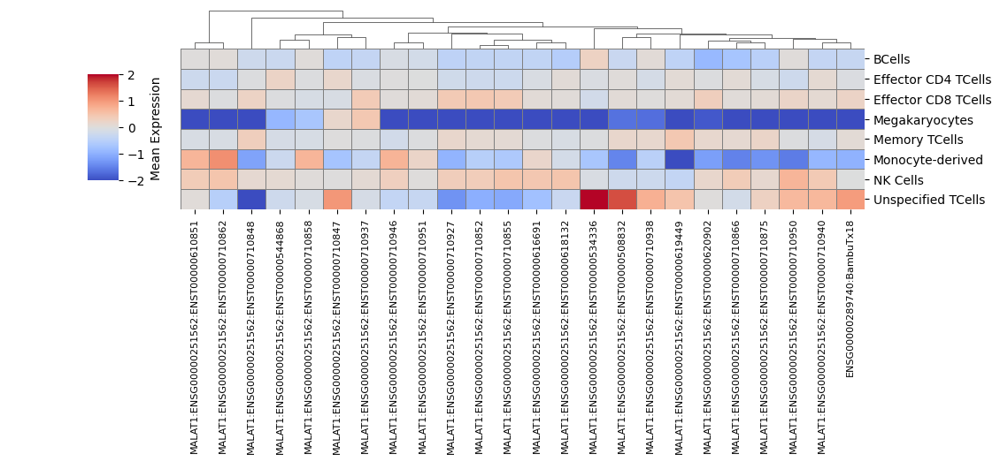

In [26]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Step 1: Define ENSG IDs for MALAT1 and TALAM1
target_ensgs = ["ENSG00000251562", "ENSG00000289740"]
isoform_matches = [gene for gene in adata_i_filtered.var_names if any(ensg in gene for ensg in target_ensgs)]

print(f"✅ Found {len(isoform_matches)} isoforms:")
for g in isoform_matches:
    print("  ", g)

# Step 2: Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
iso_indices = [adata_i_filtered.var_names.get_loc(i) for i in isoform_matches]

df_expr = pd.DataFrame(X[:, iso_indices],
                       columns=isoform_matches,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])

# Step 3: Mean expression per cell type
mean_expr = df_expr.groupby(df_expr.index).mean()

# Step 4: Set symmetric vmin/vmax for centered colormap
abs_max = np.abs(mean_expr.values).max()
norm = TwoSlopeNorm(vmin=-2, vcenter=0, vmax=2)

# Step 5: Plot
g = sns.clustermap(mean_expr,
                   cmap="coolwarm", linewidths=0.5, linecolor="gray",
                   figsize=(len(mean_expr.columns) * 0.4 + 2, len(mean_expr.index) * 0.5 + 2),
                   col_cluster=True, row_cluster=False,
                   cbar_kws={"label": "Mean Expression"},
                   norm=TwoSlopeNorm(vmin=-2, vcenter=0, vmax=2),
                  cbar_pos=(0.09, 0.65, 0.03, 0.2))

g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=90, fontsize=8)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0)
g.ax_heatmap.set_xlabel("")
g.ax_heatmap.set_ylabel("")
g.ax_heatmap.set_title("", pad=20)

g.savefig("Intermediate_Files/Paper_Figs/MALAT1_TALAM1_isoform_expression_clustermap.pdf",
          dpi=600, bbox_inches="tight", transparent=True)
plt.show()

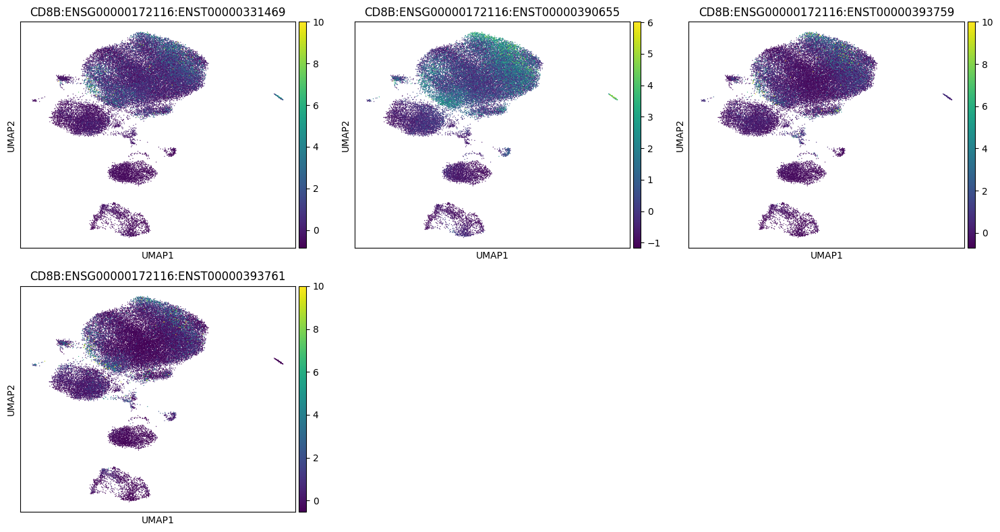

In [20]:
# Extract all gene names that start with "Bambu"
isos_CD8B = [gene for gene in adata_i_filtered.var_names if "ENSG00000172116" in gene]

# Determine grid size: adjust ncols as needed.
n_genes = len(isos_CD8B)
ncols = 3
nrows = (n_genes + ncols - 1) // ncols

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 5, nrows * 4))
axes = axes.flatten()

# Loop through each bambu gene and plot UMAP colored by its expression.
for i, gene in enumerate(isos_CD8B):
    sc.pl.umap(
        adata_i_filtered, 
        color=gene, 
        use_raw=False, 
        title=f"{gene}", 
        cmap="viridis", 
        show=False, 
        ax=axes[i],
        #vmax = 1
    )

# Hide any extra subplots (if nrows*ncols > number of genes)
for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

/tmp/ipykernel_3648124/2264973605.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_long.groupby(["cell_type", "isoform"]).agg(


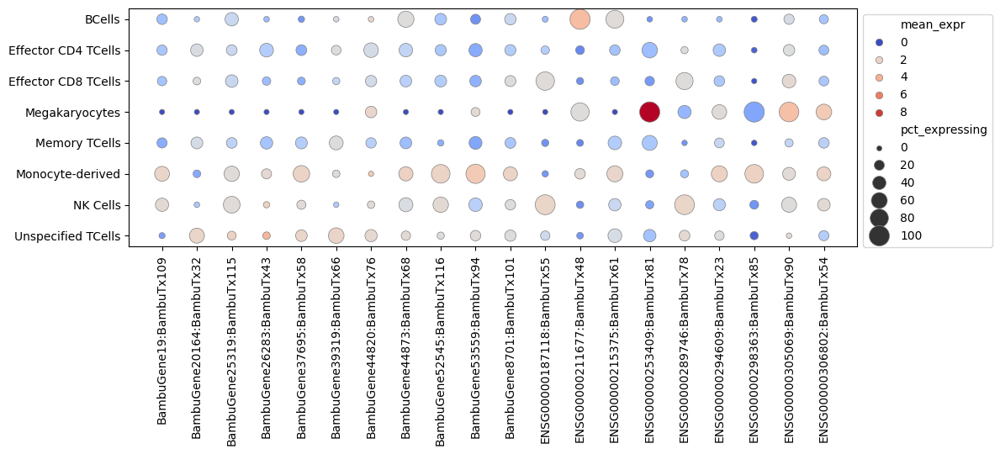

In [48]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Get all novel isoforms (BambuTx)
novel_isoforms = [i for i in adata_i_filtered.var_names if "BambuTx" in i]

# Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
expr_df = pd.DataFrame(X[:, [adata_i_filtered.var_names.get_loc(i) for i in novel_isoforms]],
                       columns=novel_isoforms,
                       index=adata_i_filtered.obs_names)

# Add cell type annotation
expr_df["cell_type"] = adata_i_filtered.obs["gen_cell_type_reannotated"]

# Step 2: Melt to long format
df_long = expr_df.melt(id_vars="cell_type", var_name="isoform", value_name="expression")

# Step 3: Compute % expressing and mean expression per isoform per cell type
summary = df_long.groupby(["cell_type", "isoform"]).agg(
    pct_expressing = ("expression", lambda x: (x > 0).mean() * 100),
    mean_expr = ("expression", lambda x: x[x > 0].mean() if any(x > 0) else 0)
).reset_index()

# Step 4: Optional — filter top isoforms by expression or specificity
top_isoforms = (
    summary.groupby("isoform")["mean_expr"]
    .max()
    .sort_values(ascending=False)
    .head(20)
    .index
)
plot_df = summary[summary["isoform"].isin(top_isoforms)]

from matplotlib.colors import TwoSlopeNorm

# Step 5: Plot with centered colormap
vmin = plot_df["mean_expr"].min()
vmax = plot_df["mean_expr"].max()
vcenter = plot_df["mean_expr"].mean()  # Set center to actual mean

norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)

plt.figure(figsize=(len(top_isoforms) * 0.5 + 2, 5.5))
sns.scatterplot(data=plot_df,
                x="isoform", y="cell_type",
                size="pct_expressing", hue="mean_expr",
                sizes=(20, 300), palette="coolwarm",
                edgecolor="gray", linewidth=0.5, hue_norm=norm)

plt.xticks(rotation=90)
plt.xlabel("")
plt.ylabel("")
plt.title("")
plt.legend(bbox_to_anchor=(1.0, 1), loc='upper left')

plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/novel_isoform_specificity_dotplot.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

/tmp/ipykernel_3648124/1964934279.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_long.groupby(["cell_type", "isoform", "gene_type"]).agg(


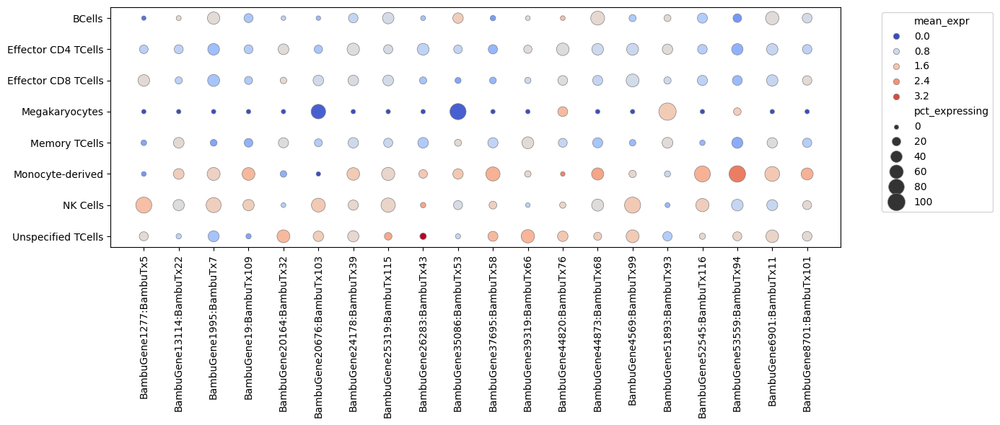

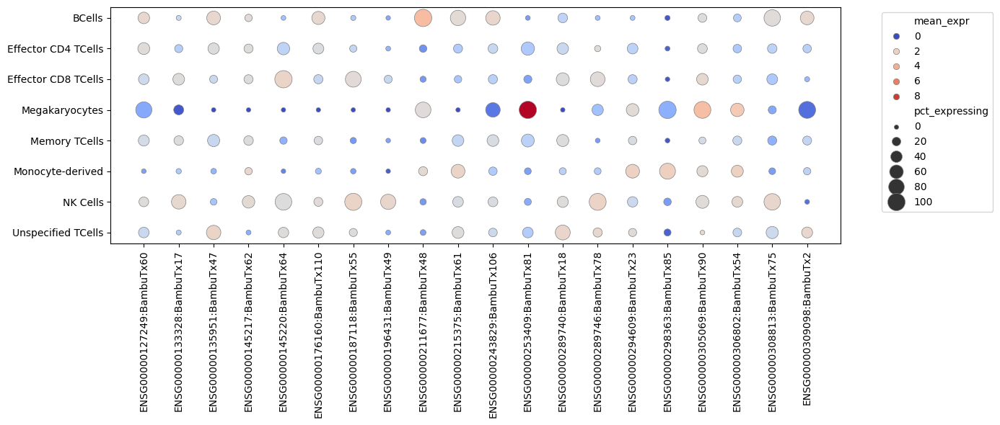

In [54]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Step 1: Get all novel isoforms (BambuTx)
novel_isoforms = [i for i in adata_i_filtered.var_names if "BambuTx" in i]

# Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
expr_df = pd.DataFrame(X[:, [adata_i_filtered.var_names.get_loc(i) for i in novel_isoforms]],
                       columns=novel_isoforms,
                       index=adata_i_filtered.obs_names)

# Add cell type annotation
expr_df["cell_type"] = adata_i_filtered.obs["gen_cell_type_reannotated"]

# Step 2: Melt to long format
df_long = expr_df.melt(id_vars="cell_type", var_name="isoform", value_name="expression")

# Add gene type annotation (Novel vs Known)
df_long["gene_type"] = df_long["isoform"].str.extract(r"^(BambuGene|ENSG)")
df_long["gene_type"] = df_long["gene_type"].map({"BambuGene": "Novel", "ENSG": "Known"}).fillna("Other")

# Step 3: Compute % expressing and mean expression per isoform per cell type
summary = df_long.groupby(["cell_type", "isoform", "gene_type"]).agg(
    pct_expressing=("expression", lambda x: (x > 0).mean() * 100),
    mean_expr=("expression", lambda x: x[x > 0].mean() if any(x > 0) else 0)
).reset_index()

# Step 4–5: Process and plot each gene type separately
for gene_type in ["Novel", "Known"]:
    sub_df = summary[summary["gene_type"] == gene_type]
    if sub_df.empty:
        continue  # skip if no data for this type

    # Top 20 isoforms for this group
    top_isoforms = (
        sub_df.groupby("isoform")["mean_expr"]
        .max()
        .sort_values(ascending=False)
        .head(20)
        .index
    )
    plot_df = sub_df[sub_df["isoform"].isin(top_isoforms)]

    # Center colormap
    vmin = plot_df["mean_expr"].min()
    vmax = plot_df["mean_expr"].max()
    vcenter = plot_df["mean_expr"].mean()
    norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)

    # Plot
    plt.figure(figsize=(len(top_isoforms) * 0.6 + 2, 6))
    sns.scatterplot(data=plot_df,
                    x="isoform", y="cell_type",
                    size="pct_expressing", hue="mean_expr",
                    sizes=(20, 300), palette="coolwarm",
                    edgecolor="gray", linewidth=0.5, hue_norm=norm)

    plt.xticks(rotation=90)
    plt.xlabel(f"")
    plt.ylabel("")
    plt.title(f"")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="")

    plt.tight_layout()
    plt.savefig(f"Intermediate_Files/Paper_Figs/{gene_type.lower()}_isoform_specificity_dotplot.pdf",
                dpi=600, bbox_inches="tight", transparent=True)
    plt.show()

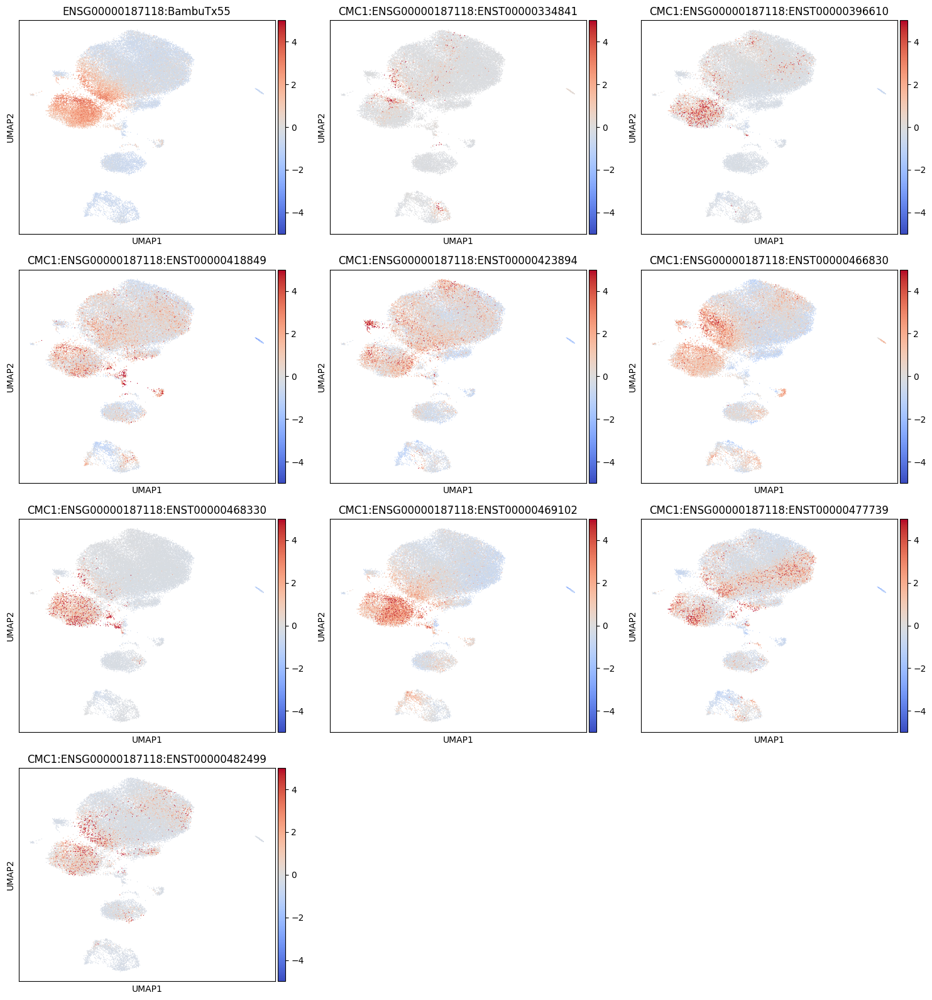

In [24]:
# Extract all gene names that start with "Bambu"
isos_CMC1 = [gene for gene in adata_i_filtered.var_names if "ENSG00000187118" in gene]

# Determine grid size: adjust ncols as needed.
n_genes = len(isos_CMC1)
ncols = 3
nrows = (n_genes + ncols - 1) // ncols

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 5, nrows * 4))
axes = axes.flatten()

# Loop through each bambu gene and plot UMAP colored by its expression.
for i, gene in enumerate(isos_CMC1):
    sc.pl.umap(
        adata_i_filtered, 
        color=gene, 
        use_raw=False, 
        title=f"{gene}", 
        cmap="coolwarm", 
        show=False, 
        ax=axes[i],
        vmax = 5,
        vmin = -5
    )

# Hide any extra subplots (if nrows*ncols > number of genes)
for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

✅ Found 10 isoforms:
   ENSG00000187118:BambuTx55
   CMC1:ENSG00000187118:ENST00000334841
   CMC1:ENSG00000187118:ENST00000396610
   CMC1:ENSG00000187118:ENST00000418849
   CMC1:ENSG00000187118:ENST00000423894
   CMC1:ENSG00000187118:ENST00000466830
   CMC1:ENSG00000187118:ENST00000468330
   CMC1:ENSG00000187118:ENST00000469102
   CMC1:ENSG00000187118:ENST00000477739
   CMC1:ENSG00000187118:ENST00000482499


/tmp/ipykernel_3648124/3147334769.py:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = df_expr.groupby(df_expr.index).mean()


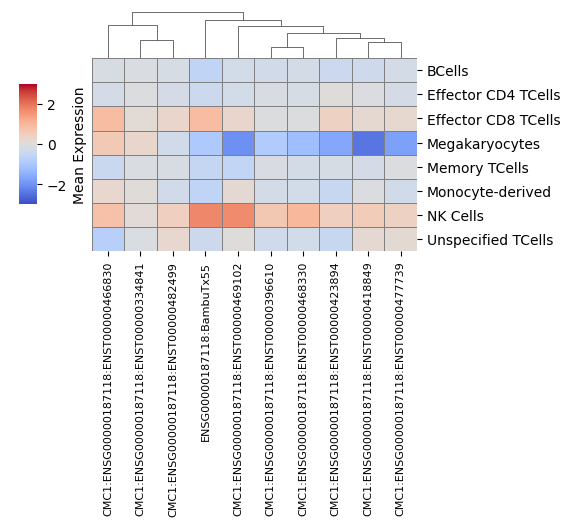

In [32]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Step 1: Define ENSG IDs for MALAT1 and TALAM1
target_ensgs = ["ENSG00000187118"]
isoform_matches = [gene for gene in adata_i_filtered.var_names if any(ensg in gene for ensg in target_ensgs)]

print(f"✅ Found {len(isoform_matches)} isoforms:")
for g in isoform_matches:
    print("  ", g)

# Step 2: Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
iso_indices = [adata_i_filtered.var_names.get_loc(i) for i in isoform_matches]

df_expr = pd.DataFrame(X[:, iso_indices],
                       columns=isoform_matches,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])

# Step 3: Mean expression per cell type
mean_expr = df_expr.groupby(df_expr.index).mean()

# Step 4: Set symmetric vmin/vmax for centered colormap
abs_max = np.abs(mean_expr.values).max()
norm = TwoSlopeNorm(vmin=-2, vcenter=0, vmax=2)

# Step 5: Plot
g = sns.clustermap(mean_expr,
                   cmap="coolwarm", linewidths=0.5, linecolor="gray",
                   figsize=(len(mean_expr.columns) * 0.4 + 2, len(mean_expr.index) * 0.5 + 2),
                   col_cluster=True, row_cluster=False,
                   cbar_kws={"label": "Mean Expression"},
                   norm=TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3),
                  cbar_pos=(0.04, 0.65, 0.03, 0.2))

g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=90, fontsize=8)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0)
g.ax_heatmap.set_xlabel("")
g.ax_heatmap.set_ylabel("")
g.ax_heatmap.set_title("", pad=20)

g.savefig("Intermediate_Files/Paper_Figs/CMC1_isoform_expression_clustermap.pdf",
          dpi=600, bbox_inches="tight", transparent=True)
plt.show()

✅ Found 10 isoforms:
   ENSG00000187118:BambuTx55
   CMC1:ENSG00000187118:ENST00000334841
   CMC1:ENSG00000187118:ENST00000396610
   CMC1:ENSG00000187118:ENST00000418849
   CMC1:ENSG00000187118:ENST00000423894
   CMC1:ENSG00000187118:ENST00000466830
   CMC1:ENSG00000187118:ENST00000468330
   CMC1:ENSG00000187118:ENST00000469102
   CMC1:ENSG00000187118:ENST00000477739
   CMC1:ENSG00000187118:ENST00000482499


/tmp/ipykernel_3079175/3998692909.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_long.groupby(["cell_type", "isoform"]).agg(


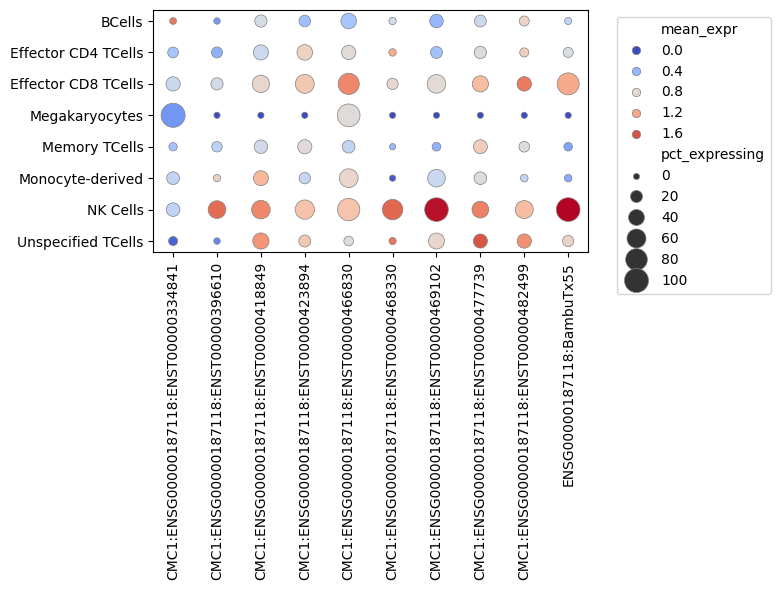

In [13]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Step 1: Define ENSG ID for CMC1
target_ensgs = ["ENSG00000187118"]
isoform_matches = [gene for gene in adata_i_filtered.var_names if any(ensg in gene for ensg in target_ensgs)]

print(f"✅ Found {len(isoform_matches)} isoforms:")
for g in isoform_matches:
    print("  ", g)

# Step 2: Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
iso_indices = [adata_i_filtered.var_names.get_loc(i) for i in isoform_matches]

df_expr = pd.DataFrame(X[:, iso_indices],
                       columns=isoform_matches,
                       index=adata_i_filtered.obs_names)

# Add cell type annotation
df_expr["cell_type"] = adata_i_filtered.obs["gen_cell_type_reannotated"]

# Step 3: Melt to long format
df_long = df_expr.melt(id_vars="cell_type", var_name="isoform", value_name="expression")

# Step 4: Compute % expressing and mean expression per isoform per cell type
summary = df_long.groupby(["cell_type", "isoform"]).agg(
    pct_expressing=("expression", lambda x: (x > 0).mean() * 100),
    mean_expr=("expression", lambda x: x[x > 0].mean() if any(x > 0) else 0)
).reset_index()

# Step 5: Set colormap centering
vmin = summary["mean_expr"].min()
vmax = summary["mean_expr"].max()
vcenter = summary["mean_expr"].mean()
norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)

# Step 6: Plot
plt.figure(figsize=(len(isoform_matches) * 0.6 + 2, 6))
sns.scatterplot(data=summary,
                x="isoform", y="cell_type",
                size="pct_expressing", hue="mean_expr",
                sizes=(20, 300), palette="coolwarm",
                edgecolor="gray", linewidth=0.5, hue_norm=norm)

plt.xticks(rotation=90)
plt.xlabel("")
plt.ylabel("")
plt.title("")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/CMC1_isoform_expression_dotplot.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

✅ Found 10 isoforms:
   ENSG00000187118:BambuTx55
   CMC1:ENSG00000187118:ENST00000334841
   CMC1:ENSG00000187118:ENST00000396610
   CMC1:ENSG00000187118:ENST00000418849
   CMC1:ENSG00000187118:ENST00000423894
   CMC1:ENSG00000187118:ENST00000466830
   CMC1:ENSG00000187118:ENST00000468330
   CMC1:ENSG00000187118:ENST00000469102
   CMC1:ENSG00000187118:ENST00000477739
   CMC1:ENSG00000187118:ENST00000482499


/tmp/ipykernel_3079175/2596023358.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = df_expr.groupby(df_expr.index).mean()


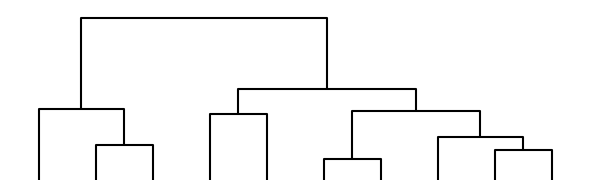

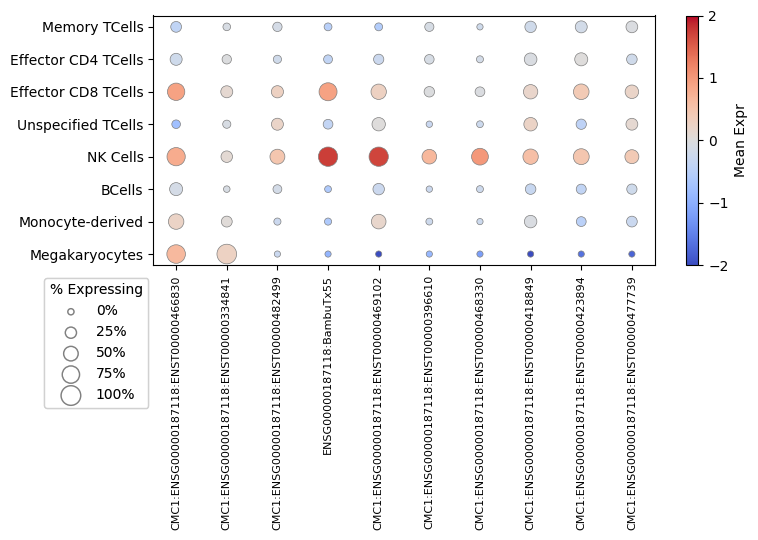

In [106]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list

# 1️⃣ Define target gene(s)
target_ensgs = ["ENSG00000187118"]
isoform_matches = [gene for gene in adata_i_filtered.var_names if any(ensg in gene for ensg in target_ensgs)]

print(f"✅ Found {len(isoform_matches)} isoforms:")
for g in isoform_matches:
    print("  ", g)

# 2️⃣ Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
iso_indices = [adata_i_filtered.var_names.get_loc(i) for i in isoform_matches]

df_expr = pd.DataFrame(X[:, iso_indices],
                       columns=isoform_matches,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])

# 3️⃣ Calculate mean expression per cell type for dendrogram
mean_expr = df_expr.groupby(df_expr.index).mean()

# 4️⃣ Hierarchical clustering on isoforms (columns)
linkage_matrix = linkage(mean_expr.T, method="ward")
ordered_cols = mean_expr.columns[leaves_list(linkage_matrix)]

# 5️⃣ Save Dendrogram Figure
fig, ax = plt.subplots(figsize=(len(isoform_matches) * 0.4 + 2, 2))
dendro = dendrogram(linkage_matrix,
                    labels=ordered_cols,
                    orientation='top',
                    color_threshold=0,
                    above_threshold_color='black')
ax.set_xticks([])
ax.set_yticks([])
ax.spines[['right', 'left', 'top', 'bottom']].set_visible(False)
plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/CMC1_isoform_dendrogram.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

# 6️⃣ Prepare single-cell level data for % expressing
df_expr_long = df_expr.copy()
df_expr_long["cell_type"] = df_expr_long.index
df_long = df_expr_long.melt(id_vars="cell_type", var_name="isoform", value_name="expression")

summary_pct = df_long.groupby(["cell_type", "isoform"], observed=False).agg(
    pct_expressing=("expression", lambda x: (x > 0).mean() * 100)
).reset_index()

# 7️⃣ Calculate mean expression per isoform per cell type
summary_mean = df_long.groupby(["cell_type", "isoform"], observed=False).agg(
    mean_expr=("expression", "mean")
).reset_index()

# 8️⃣ Merge mean expression and % expressing
summary = pd.merge(summary_mean, summary_pct, on=['cell_type', 'isoform'], how='left')

# 9️⃣ Order isoforms and cell types
summary["isoform"] = pd.Categorical(summary["isoform"], categories=ordered_cols, ordered=True)
desired_cell_order = [
    "Memory TCells",
    "Effector CD4 TCells",
    "Effector CD8 TCells",
    "Unspecified TCells",
    "NK Cells",
    "BCells",
    "Monocyte-derived",
    "Megakaryocytes"
]
summary["cell_type"] = pd.Categorical(summary["cell_type"], categories=desired_cell_order, ordered=True)

# 🔟 Save Dotplot Figure with consistent color scale and size legend
fig, ax = plt.subplots(figsize=(len(isoform_matches) * 0.4 + 4, 5.5))

# Explicitly fix the color scale
norm = TwoSlopeNorm(vmin=-2, vcenter=0, vmax=2)

# Plot scatter without automatic legend
scatter = sns.scatterplot(data=summary,
                          x="isoform", y="cell_type",
                          size="pct_expressing", hue="mean_expr",
                          sizes=(20, 200), palette="coolwarm",
                          edgecolor="gray", linewidth=0.5, hue_norm=norm,
                          ax=ax, legend=False)

# Fix x-axis tick labels
ax.set_xticks(range(len(ordered_cols)))
ax.set_xticklabels(ordered_cols, rotation=90, fontsize=8)

ax.set_xlabel("")
ax.set_ylabel("")

# Add colorbar
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label("Mean Expr")
cbar.set_ticks([-2, -1, 0, 1, 2])

# Add manual size legend
size_values = [0, 25, 50, 75, 100]
size_legend = [plt.scatter([], [], s=np.interp(v, [0, 100], [20, 200]),
                           edgecolors='gray', facecolors='none') for v in size_values]
labels = [f"{v}%" for v in size_values]

legend2 = ax.legend(size_legend, labels, title="% Expressing",
                    loc='upper right', bbox_to_anchor=(-0.01, -0.05 ), borderaxespad=0.)
ax.add_artist(legend2)

plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/CMC1_isoform_expression_dotplot.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

✅ Found 3 isoforms:
   GATA3:ENSG00000107485:ENST00000346208
   GATA3:ENSG00000107485:ENST00000379328
   GATA3:ENSG00000107485:ENST00000461472


/tmp/ipykernel_3079175/1655353616.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = df_expr.groupby(df_expr.index).mean()


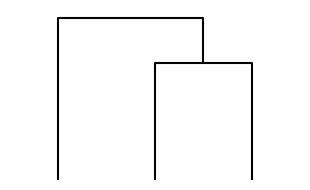

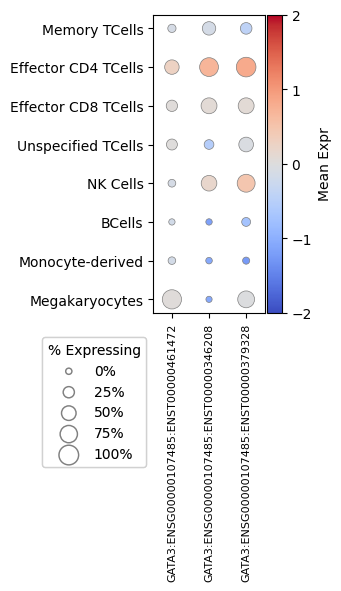

In [100]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list

# 1️⃣ Define target gene(s)
target_ensgs = ["ENSG00000107485"]
isoform_matches = [gene for gene in adata_i_filtered.var_names if any(ensg in gene for ensg in target_ensgs)]

print(f"✅ Found {len(isoform_matches)} isoforms:")
for g in isoform_matches:
    print("  ", g)

# 2️⃣ Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
iso_indices = [adata_i_filtered.var_names.get_loc(i) for i in isoform_matches]

df_expr = pd.DataFrame(X[:, iso_indices],
                       columns=isoform_matches,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])

# 3️⃣ Calculate mean expression per cell type for dendrogram
mean_expr = df_expr.groupby(df_expr.index).mean()

# 4️⃣ Hierarchical clustering on isoforms (columns)
linkage_matrix = linkage(mean_expr.T, method="ward")
ordered_cols = mean_expr.columns[leaves_list(linkage_matrix)]

# 5️⃣ Save Dendrogram Figure
fig, ax = plt.subplots(figsize=(len(isoform_matches) * 0.4 + 2, 2))
dendro = dendrogram(linkage_matrix,
                    labels=ordered_cols,
                    orientation='top',
                    color_threshold=0,
                    above_threshold_color='black')
ax.set_xticks([])
ax.set_yticks([])
ax.spines[['right', 'left', 'top', 'bottom']].set_visible(False)
plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/GATA3_isoform_dendrogram.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

# 6️⃣ Prepare single-cell level data for % expressing
df_expr_long = df_expr.copy()
df_expr_long["cell_type"] = df_expr_long.index
df_long = df_expr_long.melt(id_vars="cell_type", var_name="isoform", value_name="expression")

summary_pct = df_long.groupby(["cell_type", "isoform"], observed=False).agg(
    pct_expressing=("expression", lambda x: (x > 0).mean() * 100)
).reset_index()

# 7️⃣ Calculate mean expression per isoform per cell type
summary_mean = df_long.groupby(["cell_type", "isoform"], observed=False).agg(
    mean_expr=("expression", "mean")
).reset_index()

# 8️⃣ Merge mean expression and % expressing
summary = pd.merge(summary_mean, summary_pct, on=['cell_type', 'isoform'], how='left')

# 9️⃣ Order isoforms and cell types
summary["isoform"] = pd.Categorical(summary["isoform"], categories=ordered_cols, ordered=True)
desired_cell_order = [
    "Memory TCells",
    "Effector CD4 TCells",
    "Effector CD8 TCells",
    "Unspecified TCells",
    "NK Cells",
    "BCells",
    "Monocyte-derived",
    "Megakaryocytes"
]
summary["cell_type"] = pd.Categorical(summary["cell_type"], categories=desired_cell_order, ordered=True)

# 🔟 Save Dotplot Figure with consistent color scale and size legend
fig_width = min(len(isoform_matches) * 0.6 + 1.5, 6)  # keep width reasonable
fig_height = len(desired_cell_order) * 0.6 + 1

fig, ax = plt.subplots(figsize=(fig_width, fig_height), constrained_layout=True)

# Color scale
norm = TwoSlopeNorm(vmin=-2, vcenter=0, vmax=2)

# Plot
scatter = sns.scatterplot(data=summary,
                          x="isoform", y="cell_type",
                          size="pct_expressing", hue="mean_expr",
                          sizes=(20, 200), palette="coolwarm",
                          edgecolor="gray", linewidth=0.5, hue_norm=norm,
                          ax=ax, legend=False)

# X-axis
ax.set_xticks(range(len(ordered_cols)))
ax.set_xticklabels(ordered_cols, rotation=90, fontsize=8)
ax.set_xlim(-0.5, len(ordered_cols) - 0.5)
ax.set_xlabel("")
ax.set_ylabel("")

# Colorbar
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, pad=0.02)
cbar.set_label("Mean Expr")
cbar.set_ticks([-2, -1, 0, 1, 2])

# Size legend
size_values = [0, 25, 50, 75, 100]
size_legend = [plt.scatter([], [], s=np.interp(v, [0, 100], [20, 200]),
                           edgecolors='gray', facecolors='none') for v in size_values]
labels = [f"{v}%" for v in size_values]

legend2 = ax.legend(size_legend, labels, title="% Expressing",
                    loc='center left', bbox_to_anchor=(-1, -0.3), borderaxespad=0.)
ax.add_artist(legend2)

# Save
plt.savefig("Intermediate_Files/Paper_Figs/GATA3_isoform_expression_dotplot.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

✅ Found 3 isoforms:
   CCR7:ENSG00000126353:ENST00000246657
   CCR7:ENSG00000126353:ENST00000578085
   CCR7:ENSG00000126353:ENST00000579344


/tmp/ipykernel_3079175/1499556937.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr = df_expr.groupby(df_expr.index).mean()


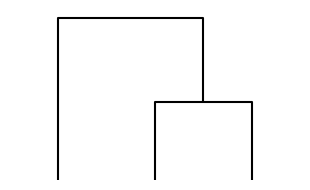

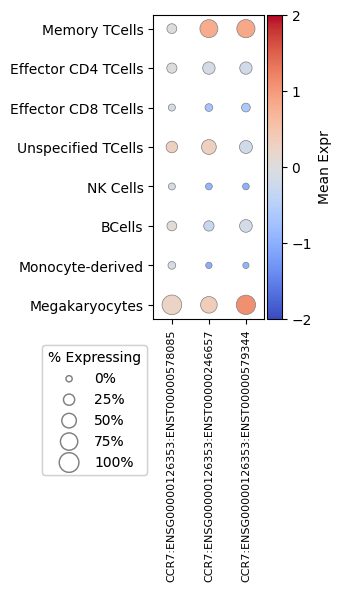

In [99]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list

# 1️⃣ Define target gene(s)
target_ensgs = ["ENSG00000126353"]
isoform_matches = [gene for gene in adata_i_filtered.var_names if any(ensg in gene for ensg in target_ensgs)]

print(f"✅ Found {len(isoform_matches)} isoforms:")
for g in isoform_matches:
    print("  ", g)

# 2️⃣ Extract expression matrix
X = adata_i_filtered.X.toarray() if hasattr(adata_i_filtered.X, "toarray") else adata_i_filtered.X
iso_indices = [adata_i_filtered.var_names.get_loc(i) for i in isoform_matches]

df_expr = pd.DataFrame(X[:, iso_indices],
                       columns=isoform_matches,
                       index=adata_i_filtered.obs["gen_cell_type_reannotated"])

# 3️⃣ Calculate mean expression per cell type for dendrogram
mean_expr = df_expr.groupby(df_expr.index).mean()

# 4️⃣ Hierarchical clustering on isoforms (columns)
linkage_matrix = linkage(mean_expr.T, method="ward")
ordered_cols = mean_expr.columns[leaves_list(linkage_matrix)]

# 5️⃣ Save Dendrogram Figure
fig, ax = plt.subplots(figsize=(len(isoform_matches) * 0.4 + 2, 2))
dendro = dendrogram(linkage_matrix,
                    labels=ordered_cols,
                    orientation='top',
                    color_threshold=0,
                    above_threshold_color='black')
ax.set_xticks([])
ax.set_yticks([])
ax.spines[['right', 'left', 'top', 'bottom']].set_visible(False)
plt.tight_layout()
plt.savefig("Intermediate_Files/Paper_Figs/CCR7_isoform_dendrogram.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

# 6️⃣ Prepare single-cell level data for % expressing
df_expr_long = df_expr.copy()
df_expr_long["cell_type"] = df_expr_long.index
df_long = df_expr_long.melt(id_vars="cell_type", var_name="isoform", value_name="expression")

summary_pct = df_long.groupby(["cell_type", "isoform"], observed=False).agg(
    pct_expressing=("expression", lambda x: (x > 0).mean() * 100)
).reset_index()

# 7️⃣ Calculate mean expression per isoform per cell type
summary_mean = df_long.groupby(["cell_type", "isoform"], observed=False).agg(
    mean_expr=("expression", "mean")
).reset_index()

# 8️⃣ Merge mean expression and % expressing
summary = pd.merge(summary_mean, summary_pct, on=['cell_type', 'isoform'], how='left')

# 9️⃣ Order isoforms and cell types
summary["isoform"] = pd.Categorical(summary["isoform"], categories=ordered_cols, ordered=True)
desired_cell_order = [
    "Memory TCells",
    "Effector CD4 TCells",
    "Effector CD8 TCells",
    "Unspecified TCells",
    "NK Cells",
    "BCells",
    "Monocyte-derived",
    "Megakaryocytes"
]
summary["cell_type"] = pd.Categorical(summary["cell_type"], categories=desired_cell_order, ordered=True)

# 🔟 Save Dotplot Figure with consistent color scale and size legend
fig_width = min(len(isoform_matches) * 0.6 + 1.5, 6)  # keep width reasonable
fig_height = len(desired_cell_order) * 0.6 + 1

fig, ax = plt.subplots(figsize=(fig_width, fig_height), constrained_layout=True)

# Color scale
norm = TwoSlopeNorm(vmin=-2, vcenter=0, vmax=2)

# Plot
scatter = sns.scatterplot(data=summary,
                          x="isoform", y="cell_type",
                          size="pct_expressing", hue="mean_expr",
                          sizes=(20, 200), palette="coolwarm",
                          edgecolor="gray", linewidth=0.5, hue_norm=norm,
                          ax=ax, legend=False)

# X-axis
ax.set_xticks(range(len(ordered_cols)))
ax.set_xticklabels(ordered_cols, rotation=90, fontsize=8)
ax.set_xlim(-0.5, len(ordered_cols) - 0.5)
ax.set_xlabel("")
ax.set_ylabel("")

# Colorbar
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax, pad=0.02)
cbar.set_label("Mean Expr")
cbar.set_ticks([-2, -1, 0, 1, 2])

# Size legend
size_values = [0, 25, 50, 75, 100]
size_legend = [plt.scatter([], [], s=np.interp(v, [0, 100], [20, 200]),
                           edgecolors='gray', facecolors='none') for v in size_values]
labels = [f"{v}%" for v in size_values]

legend2 = ax.legend(size_legend, labels, title="% Expressing",
                    loc='center left', bbox_to_anchor=(-1, -0.3), borderaxespad=0.)
ax.add_artist(legend2)

# Save
plt.savefig("Intermediate_Files/Paper_Figs/CCR7_isoform_expression_dotplot.pdf",
            dpi=600, bbox_inches="tight", transparent=True)
plt.show()

In [17]:
# Exclude megakaryocytes from adata
adata_no_mk = adata_i_filtered[adata_i_filtered.obs["gen_cell_type"] != "Megakaryocyte"]

# Then re-run your analysis to see if results stabilize or improve

/tmp/ipykernel_534167/1488889440.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()


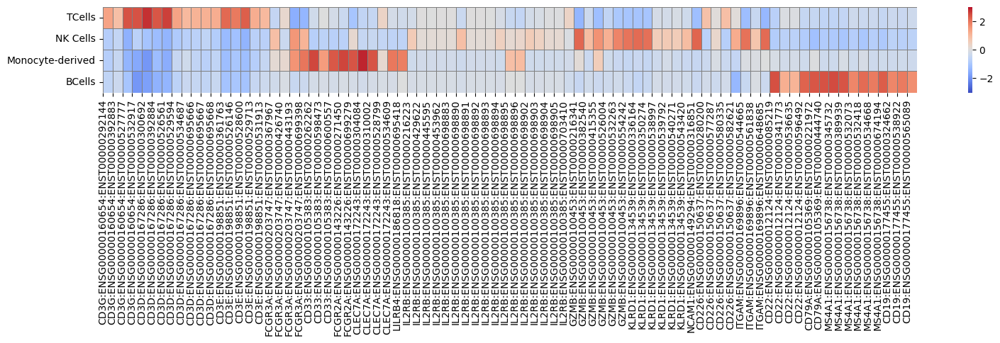

In [19]:
marker_groups_to_include = ["TCells", "Natural Killer", "BCell", "Monocyte-derived"]

# Build gene -> group mapping (only for selected groups)
gene_to_group = {}
matched_isoforms = []

for group, genes in marker_genes.items():
    if group not in marker_groups_to_include:
        continue  # skip unwanted groups
    matches = find_matching_genes(genes, adata_no_mk.var_names)
    matched_isoforms.extend(matches)
    for isoform in matches:
        gene_to_group[isoform] = group

# Get expression matrix for matched isoforms
iso_expr = pd.DataFrame(adata_no_mk[:, matched_isoforms].X.toarray(), 
                        columns=matched_isoforms, 
                        index=adata_no_mk.obs["gen_cell_type"])

# Calculate mean expression per cluster
mean_expr_iso = iso_expr.groupby(iso_expr.index).mean()

# Scale expression (z-score per isoform)
scaled_expr_iso = (mean_expr_iso - mean_expr_iso.mean(axis=1).values[:, None]) / mean_expr_iso.std(axis=1).values[:, None]

plot_df_iso = scaled_expr_iso.copy()
celltype_order = ["TCells", "NK Cells", "Monocyte-derived", "BCells"]
plot_df_iso = plot_df_iso.loc[celltype_order]
plot_df_iso = plot_df_iso.fillna(0)

from matplotlib.colors import TwoSlopeNorm

# Normalize: vmin/vmax
norm = TwoSlopeNorm(vmin=-3, vcenter=0, vmax=3)

# Remove duplicated isoform columns
plot_df_iso = plot_df_iso.loc[:, ~plot_df_iso.columns.duplicated()]

# Sort isoform columns by their marker group
isoform_to_group = {iso: gene_to_group[iso] for iso in plot_df_iso.columns if iso in gene_to_group}
group_rank = {group: i for i, group in enumerate(celltype_order)}
ordered_cols = sorted(plot_df_iso.columns, key=lambda x: group_rank.get(isoform_to_group.get(x, ""), 999))
plot_df_iso = plot_df_iso[ordered_cols]

plt.figure(figsize=(16, 5))
sns.heatmap(plot_df_iso, cmap="coolwarm", linewidths=0.7, linecolor='gray',
            cbar_kws={"label": ""}, square=False,
            norm=norm)

plt.xlabel("")
plt.ylabel("")
plt.xticks(ticks=np.arange(plot_df_iso.shape[1]), labels=plot_df_iso.columns, rotation=90)
plt.yticks(rotation=0)

plt.tight_layout()
#plt.savefig("Intermediate_Files/Paper_Figs/Markers/celltype_marker_isoform_heatmap.pdf",
#            dpi=600, transparent=True, bbox_inches="tight")
plt.show()

In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load GTF cleanly
gtf_file = "Homo_sapiens.GRCh38.113.gtf"

gtf = pd.read_csv(
    gtf_file, 
    sep="\t", 
    comment="#", 
    header=None, 
    names=["chrom", "source", "feature", "start", "end", "score", "strand", "frame", "attribute"],
    dtype=str
)

# Parse attributes
gtf["transcript_id"] = gtf["attribute"].str.extract('transcript_id "([^"]+)"')
gtf["gene_id"] = gtf["attribute"].str.extract('gene_id "([^"]+)"')
gtf["gene_name"] = gtf["attribute"].str.extract('gene_name "([^"]+)"')

# Build mapping transcript_id -> gene_name (or gene_id fallback)
gtf_mapping = gtf.drop_duplicates("transcript_id").set_index("transcript_id")["gene_name"].fillna(gtf["gene_id"])

# Build isoform dataframe
isoform_df = pd.DataFrame(adata_no_mk.var.index)
isoform_df.columns = ["transcript_id"]

# Determine new isoforms
isoform_df["is_new_isoform"] = isoform_df["transcript_id"].str.contains("BambuTx")

# Add gene names
isoform_df["gene_name"] = isoform_df["transcript_id"].map(gtf_mapping)

# Make clean names
isoform_df["clean_name"] = np.where(
    isoform_df["gene_name"].notnull(),
    isoform_df["gene_name"] + ":" + isoform_df["transcript_id"],
    isoform_df["transcript_id"]
)

# Only new isoforms
new_isoform_df = isoform_df[isoform_df["is_new_isoform"]].copy()

# Get integer index for new isoforms (important fix!)
new_isoform_indices = new_isoform_df.index.to_numpy()

# Extract expression
X = adata_i_filtered.X
if hasattr(X, "toarray"):
    X = X.toarray()

In [27]:
# Subset expression
new_isoform_expr = X[:, new_isoform_indices]

# Build dataframe with correct names (FIXED)
df = pd.DataFrame(new_isoform_expr, 
                  columns=new_isoform_df["clean_name"].values, 
                  index=adata_i_filtered.obs_names)

# Add cell type
df["cell_type"] = adata_i_filtered.obs["gen_cell_type_reannotated"].values

In [28]:
# Melt
df_long = df.melt(id_vars="cell_type", var_name="isoform", value_name="expression")
df_long["expressed"] = df_long["expression"] > 0

# Calculate % of cells expressing
summary = df_long.groupby(["cell_type", "isoform"])["expressed"].mean().unstack(fill_value=0) * 100

# Sort isoforms alphabetically
summary = summary[sorted(summary.columns)]

/tmp/ipykernel_534167/2803979613.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_long.groupby(["cell_type", "isoform"])["expressed"].mean().unstack(fill_value=0) * 100


In [29]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# --- (same up to df_long and summary) ---

# Classify isoforms based on transcript ID
new_isoform_df["is_novel_gene"] = new_isoform_df["transcript_id"].str.startswith("Bambu")

# Add classification to melted dataframe
df_long["is_novel_gene"] = df_long["isoform"].map(
    new_isoform_df.set_index("clean_name")["is_novel_gene"]
)

# Add clean_name mapping
df_long["clean_name"] = df_long["isoform"]

# Split data
df_known = df_long[df_long["is_novel_gene"] == False]  # ENSG → known gene
df_novel = df_long[df_long["is_novel_gene"] == True]   # Bambu → novel gene

/tmp/ipykernel_534167/2341708283.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)


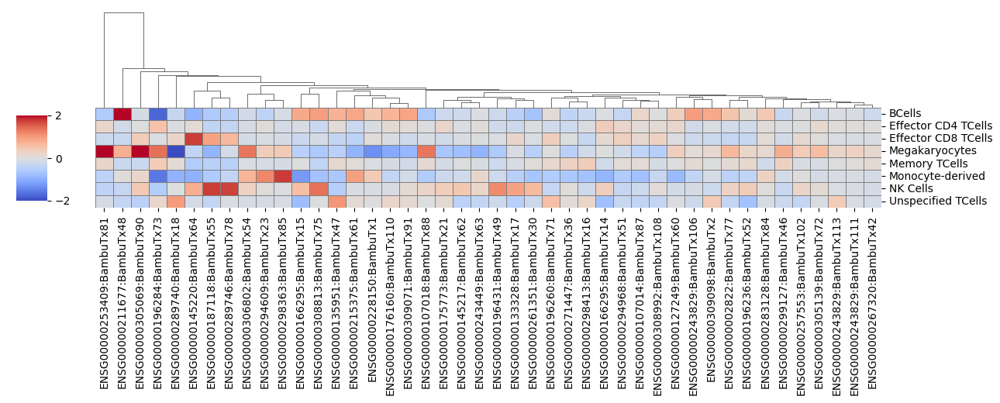

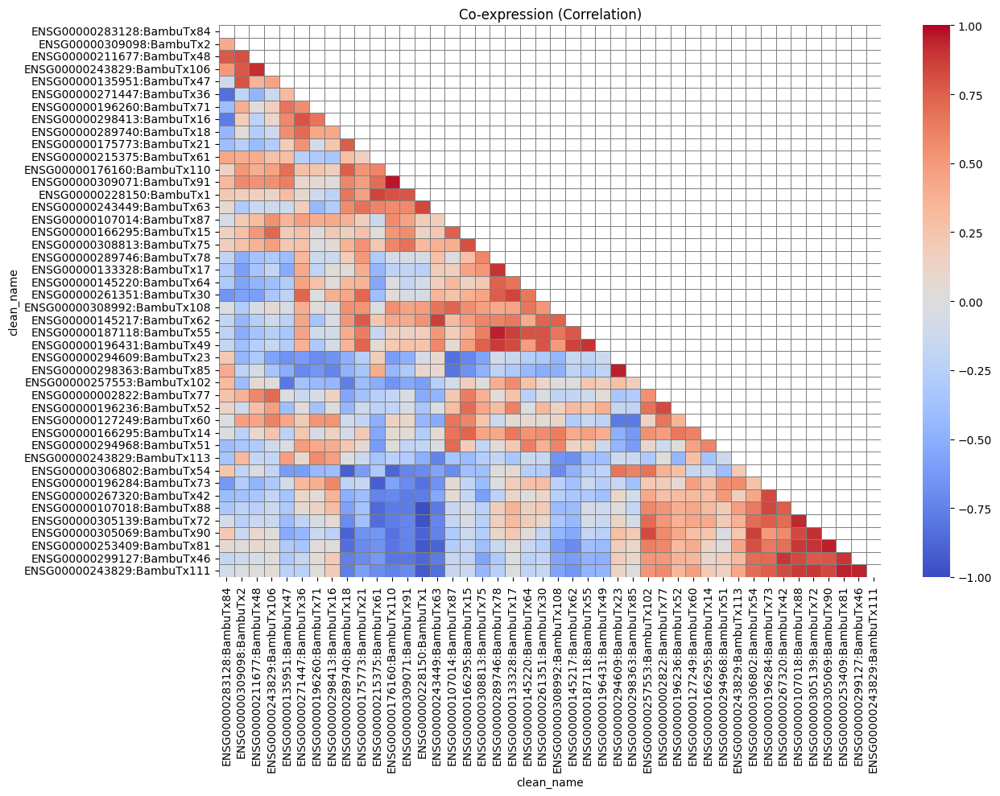

/tmp/ipykernel_534167/2341708283.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)


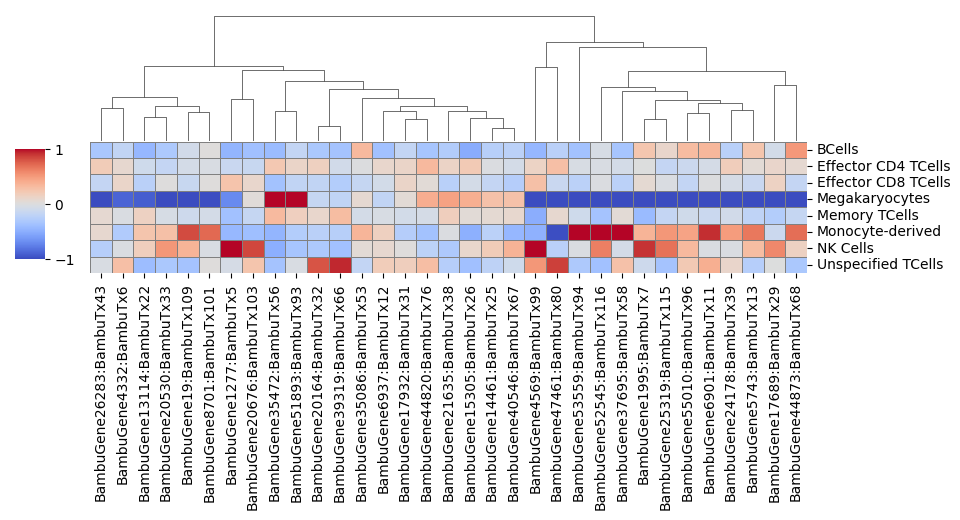

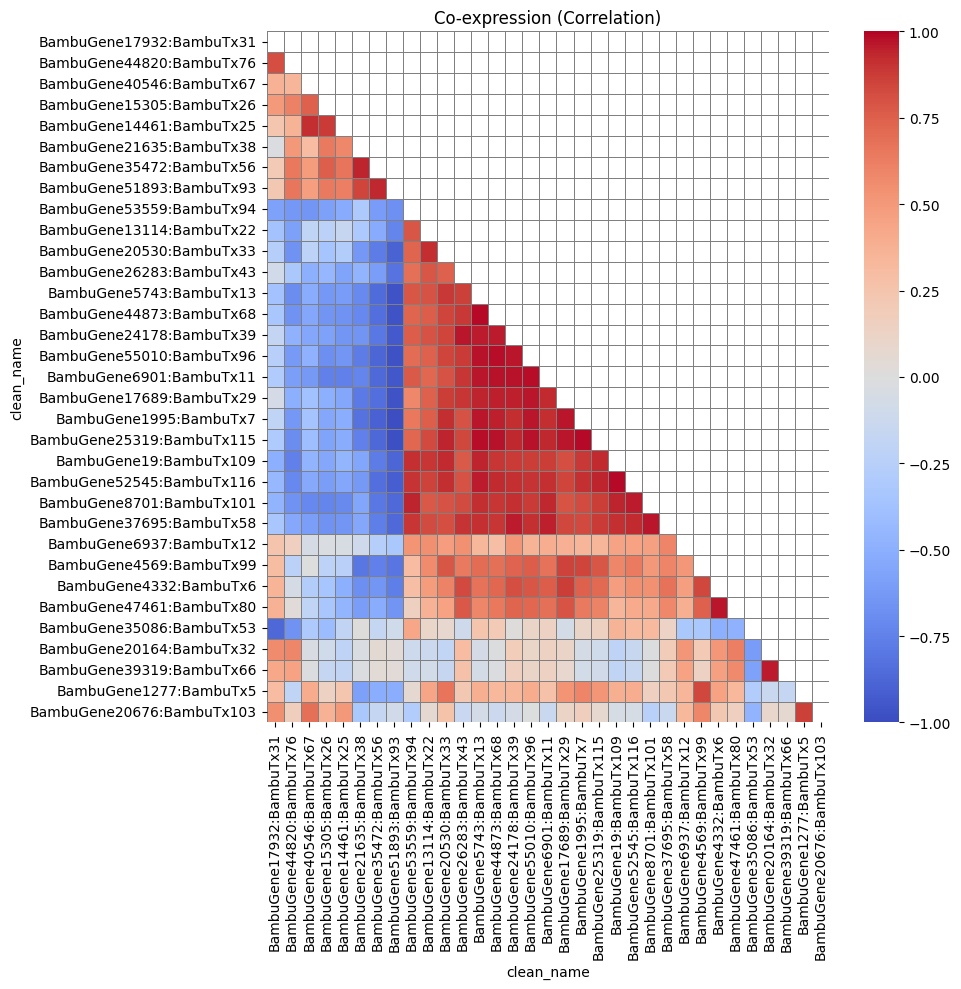

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, leaves_list

def plot_clustermap_with_coexpression(df_subset, filename, vmax):
    # Step 1: Prepare mean expression matrix
    summary = df_subset.groupby(["cell_type", "clean_name"])["expression"].mean().unstack(fill_value=0)
    summary = summary[sorted(summary.columns)]

    # Step 2: Expression clustermap
    g = sns.clustermap(summary, cmap="coolwarm",
                       linewidths=0.5, linecolor='gray',
                       vmin=-vmax, vmax=vmax, center=0,
                       figsize=(len(summary.columns) * 0.3, 5.5),
                       row_cluster=False, col_cluster=True,
                       cbar_kws={"label": ""},
                       dendrogram_ratio=(0.1, 0.5),
                       cbar_pos=(0.02, 0.52, 0.03, 0.2))

    g.ax_heatmap.set_xlabel("")
    g.ax_heatmap.set_ylabel("", labelpad=20)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=90)
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), rotation=0, ha='right', va='center', fontsize=10)

    for label in g.ax_heatmap.get_yticklabels():
        label.set_horizontalalignment('left')
        pos = label.get_position()
        label.set_position((pos[0], pos[1] - 0.3))

    g.ax_heatmap.figure.canvas.draw()

    # Step 3: Correlation matrix
    summary_reordered = summary[[summary.columns[i] for i in g.dendrogram_col.reordered_ind]]
    corr = summary_reordered.corr()

    # Step 4: Cluster the correlation matrix manually
    d = pdist(corr)
    linkage_matrix = linkage(d, method='average')
    idx = leaves_list(linkage_matrix)
    corr = corr.iloc[idx, :].iloc[:, idx]

    # Step 5: Apply mask for upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Step 6: Plot triangle-only heatmap
    plt.figure(figsize=(len(corr.columns) * 0.3, 10))
    sns.heatmap(corr, cmap="coolwarm", linewidths=0.5, linecolor='gray',
                vmin=-1, vmax=1, center=0,
                xticklabels=True, yticklabels=True,
                mask=mask)

    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.title("Co-expression (Correlation)")
    plt.tight_layout()

    # Save both figures
    g.savefig(filename.replace(".pdf", "_dendrogram.pdf"), dpi=600, transparent=True, bbox_inches="tight")
    plt.savefig(filename.replace(".pdf", "_coexpression.pdf"), dpi=600, transparent=True, bbox_inches="tight")
    plt.show()
    
plot_clustermap_with_coexpression(df_known, 
    "Intermediate_Files/Paper_Figs/new_isoform_known_subcelltype_heatmap_clustered_coexpression.pdf",
    vmax=2)

plot_clustermap_with_coexpression(df_novel, 
    "Intermediate_Files/Paper_Figs/new_isoform_novel_subcelltype_heatmap_clustered_coexpression.pdf",
    vmax=1)

In [18]:
import pandas as pd
import re

# Load the GTF file
gtf_file = "PBMC_FEB_28_2025_extended_annotations.gtf"  # update this path

gtf_data = pd.read_csv(
    gtf_file,
    sep="\t",
    comment="#",
    header=None,
    names=["seqname", "source", "feature", "start", "end", "score", "strand", "frame", "attribute"]
)

# Filter to exons or transcripts depending on GTF
if "exon" in gtf_data["feature"].unique():
    transcripts = gtf_data[gtf_data["feature"] == "exon"].copy()
else:
    transcripts = gtf_data[gtf_data["feature"] == "transcript"].copy()

# Extract transcript_id and gene_id
def extract_transcript_id(attr):
    match = re.search(r'transcript_id "([^"]+)"', attr)
    return match.group(1) if match else None

def extract_gene_id(attr):
    match = re.search(r'gene_id "([^"]+)"', attr)
    return match.group(1) if match else None

transcripts["transcript_id"] = transcripts["attribute"].apply(extract_transcript_id)
transcripts["gene_id"] = transcripts["attribute"].apply(extract_gene_id)

# For exon-based GTFs, sum exon lengths per transcript
if "exon" in transcripts["feature"].unique():
    transcripts["length"] = transcripts["end"] - transcripts["start"] + 1
    transcript_lengths = transcripts.groupby("transcript_id")["length"].sum().reset_index()
else:
    transcripts["length"] = transcripts["end"] - transcripts["start"] + 1
    transcript_lengths = transcripts[["transcript_id", "length"]].drop_duplicates()

print(transcript_lengths.head())

/tmp/ipykernel_3042557/443935572.py:7: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  gtf_data = pd.read_csv(


  transcript_id  length
0      BambuTx1     235
1     BambuTx10     271
2    BambuTx100    2086
3    BambuTx101     344
4    BambuTx102     343


In [19]:
# Extract transcript IDs from var_names
var_names = adata_i_filtered.var_names.to_series()

# Regex to find ENST IDs
var_names_transcript_ids = var_names.apply(
    lambda x: re.search(r'(ENST\d+)', x).group(1) if re.search(r'(ENST\d+)', x) else None
)

# Map transcript lengths
transcript_lengths = transcript_lengths.set_index("transcript_id")["length"]

# Map lengths to var_names
lengths = var_names_transcript_ids.map(transcript_lengths).fillna(0).values

In [40]:
X = adata_i_filtered.X
if hasattr(X, "toarray"):
    X = X.toarray()
X = np.maximum(X, 0)  # Clip to non-negative values

cell_types = adata_i_filtered.obs["gen_cell_type_reannotated"]

weighted_lengths = X * lengths
total_lengths = weighted_lengths.sum(axis=1)
total_expression = X.sum(axis=1)

mean_length_per_cell = total_lengths / (total_expression + 1e-10)

df = pd.DataFrame({
    "Cell_Type": cell_types,
    "Mean_Transcript_Length": mean_length_per_cell
})

summary = df.groupby("Cell_Type").agg(
    mean_length=("Mean_Transcript_Length", "mean"),
    median_length=("Mean_Transcript_Length", "median")
).reset_index()

print(summary)

             Cell_Type  mean_length  median_length
0               BCells  2872.193997    2885.930750
1  Effector CD4 TCells  2616.083168    2616.303743
2  Effector CD8 TCells  2612.254364    2618.954214
3       Megakaryocytes  2701.475389    2666.412329
4        Memory TCells  2467.836878    2465.120983
5     Monocyte-derived  2822.532564    2827.809730
6             NK Cells  2825.405069    2819.077050
7   Unspecified TCells  2714.089245    2700.910255


/tmp/ipykernel_3042557/4114501035.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary = df.groupby("Cell_Type").agg(


In [42]:
df["Mean_Transcript_Length_Capped"] = df["Mean_Transcript_Length"].clip(upper=200000)

/tmp/ipykernel_3042557/481363433.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(


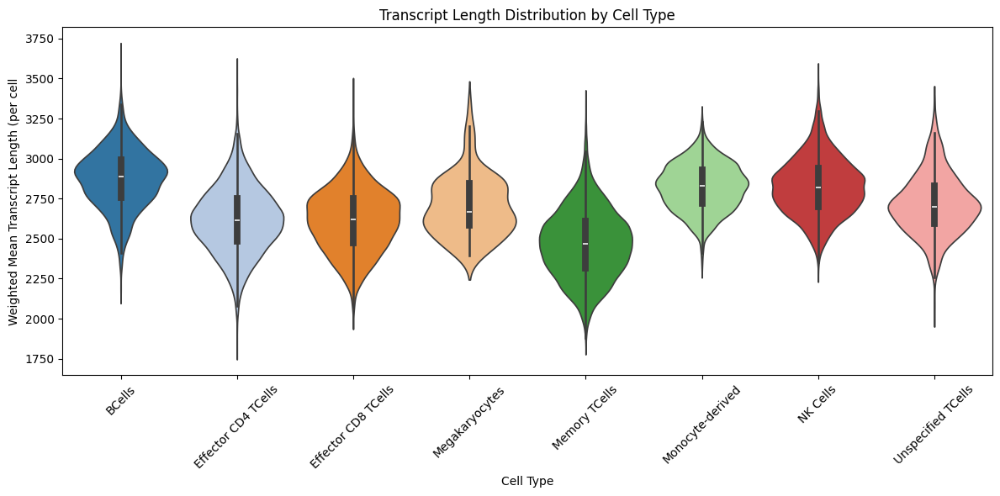

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.violinplot(
    data=df, 
    x="Cell_Type", 
    y="Mean_Transcript_Length_Capped", 
    palette="tab20", 
    inner="box"
)
plt.xlabel("Cell Type")
plt.ylabel("Weighted Mean Transcript Length (per cell")
plt.title("Transcript Length Distribution by Cell Type")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()